# GUC Clustering Project 

In [ ]:
#! pip install plotnine

**Objective:** 
The objective of this project teach students how to apply clustering to real data sets

The projects aims to teach student: 
* Which clustering approach to use
* Compare between Kmeans, Hierarchal, DBScan, and Gaussian Mixtures  
* How to tune the parameters of each data approach
* What is the effect of different distance functions (optional) 
* How to evaluate clustering approachs 
* How to display the output
* What is the effect of normalizing the data 

Students in this project will use ready-made functions from Sklearn, plotnine, numpy and pandas 
 



In [ ]:
# if plotnine is not installed in Jupter then use the following command to install it 


Running this project require the following imports 

In [1]:
import warnings
warnings.filterwarnings('ignore')
import seaborn as sns 
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import sklearn.preprocessing as prep
from sklearn.datasets import make_blobs
#! pip install plotnine
from plotnine import *   
# StandardScaler is a function to normalize the data 
# You may also check MinMaxScaler and MaxAbsScaler 
#from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import NearestNeighbors

from sklearn.cluster import DBSCAN


from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture

from sklearn.metrics import silhouette_score

%matplotlib inline

In [2]:
# helper function that allows us to display data in 2 dimensions an highlights the clusters
def display_cluster(X,km=[],num_clusters=0):
    color = 'brgcmyk'  #List colors
    alpha = 0.5  #color obaque
    s = 20
    if num_clusters == 0:
        plt.scatter(X[:,0],X[:,1],c = color[0],alpha = alpha,s = s)
    else:
        for i in range(num_clusters):
            plt.scatter(X[km.labels_==i,0],X[km.labels_==i,1],c = color[i],alpha = alpha,s=s)
            plt.scatter(km.cluster_centers_[i][0],km.cluster_centers_[i][1],c = color[i], marker = 'x', s = 100)

## Multi Blob Data Set 
* The Data Set generated below has 6 cluster with varying number of users and varing densities
* Cluster the data set below using 



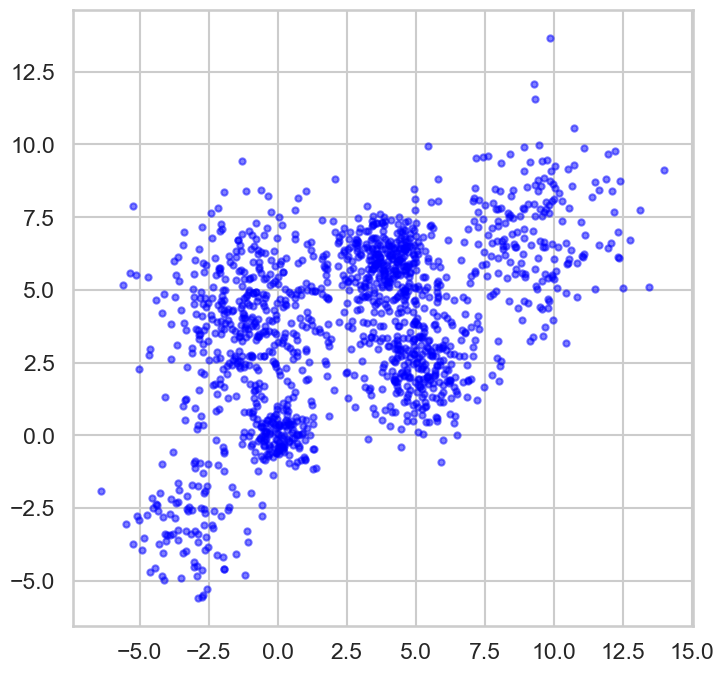

In [99]:
plt.rcParams['figure.figsize'] = [8,8]
sns.set_style("whitegrid")
sns.set_context("talk")

n_bins = 6  
centers = [(-3, -3), (0, 0), (5,2.5),(-1, 4), (4, 6), (9,7)]
Multi_blob_Data, y = make_blobs(n_samples=[100,150, 300, 400,300, 200], n_features=2, cluster_std=[1.3,0.6, 1.2, 1.7,0.9,1.7],
                  centers=centers, shuffle=False, random_state=42)
display_cluster(Multi_blob_Data)

### Kmeans 
* Use Kmeans with different values of K to cluster the above data 
* Display the outcome of each value of K 
* Plot distortion function versus K and choose the approriate value of k 
* Plot the silhouette_score versus K and use it to choose the best K 
* Store the silhouette_score for the best K for later comparison with other clustering techniques. 

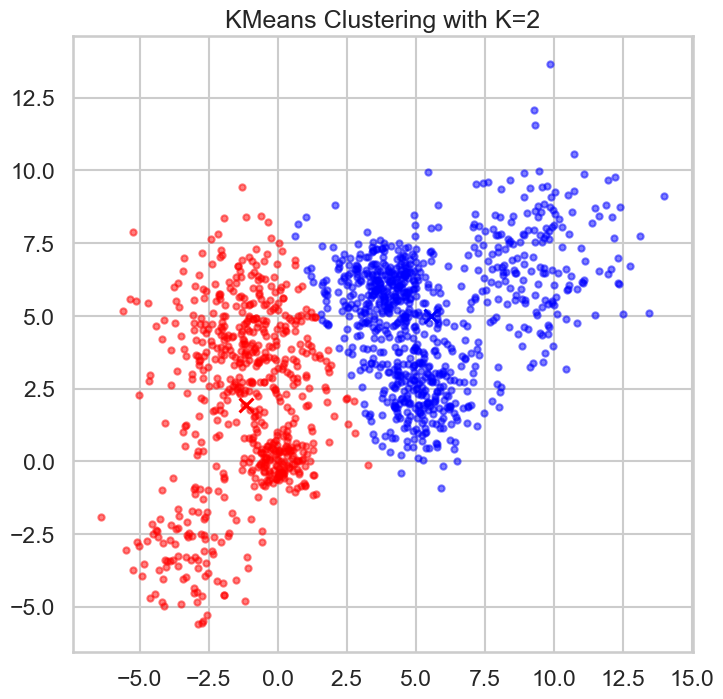

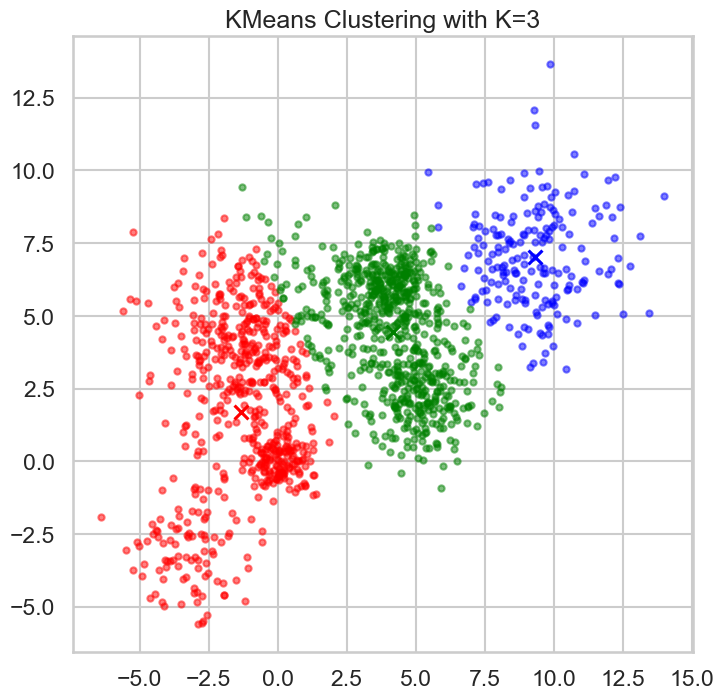

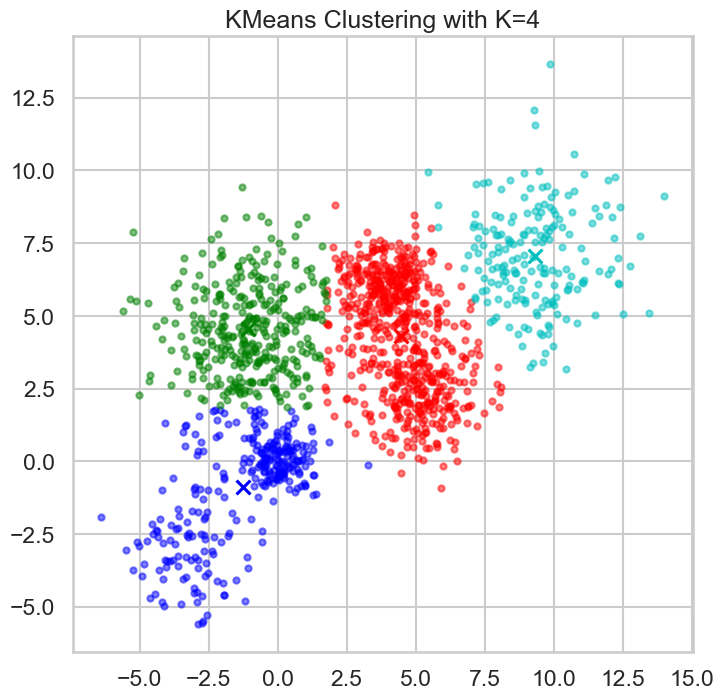

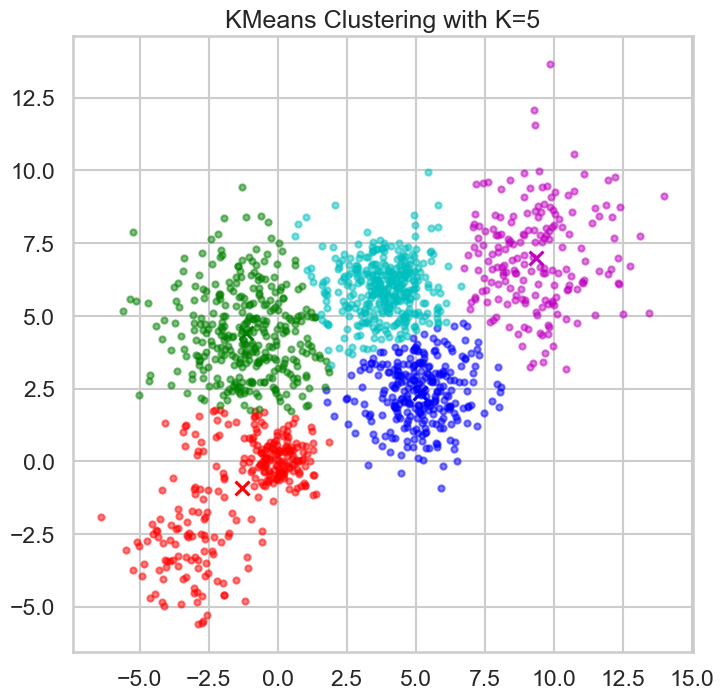

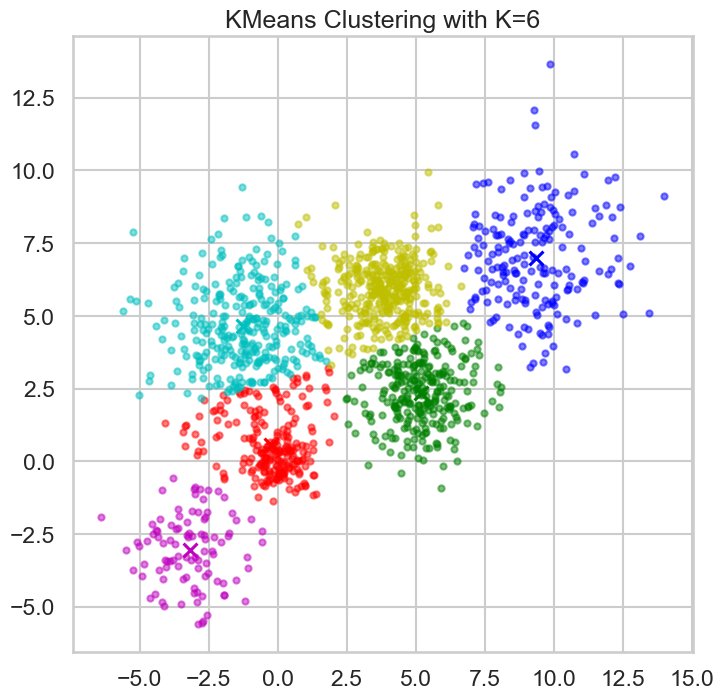

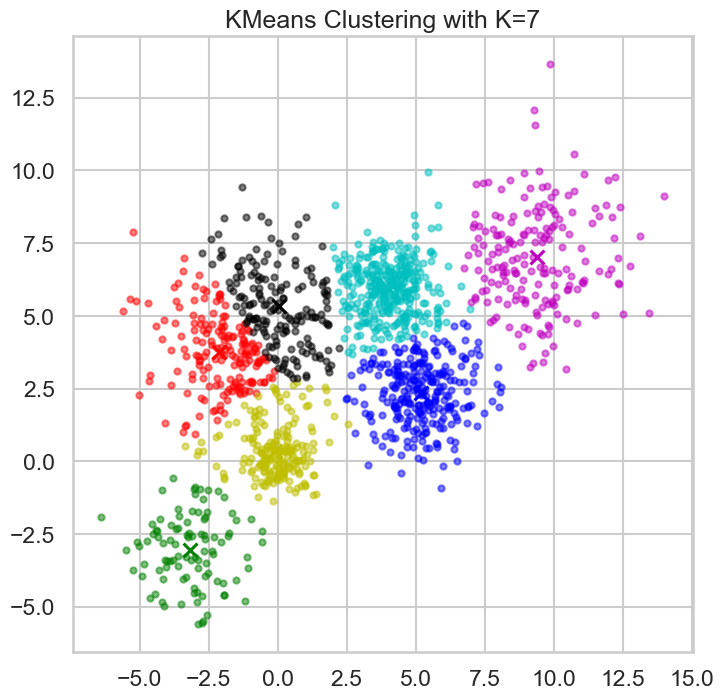

In [75]:
k_values=[2,3,4,5,6,7]
for k in k_values:
    km=KMeans(n_clusters=k, random_state=42)
    km.fit(Multi_blob_Data)
    plt.figure()
    display_cluster(Multi_blob_Data, km, k)
    plt.title(f"KMeans Clustering with K={k}")
    plt.show()
    

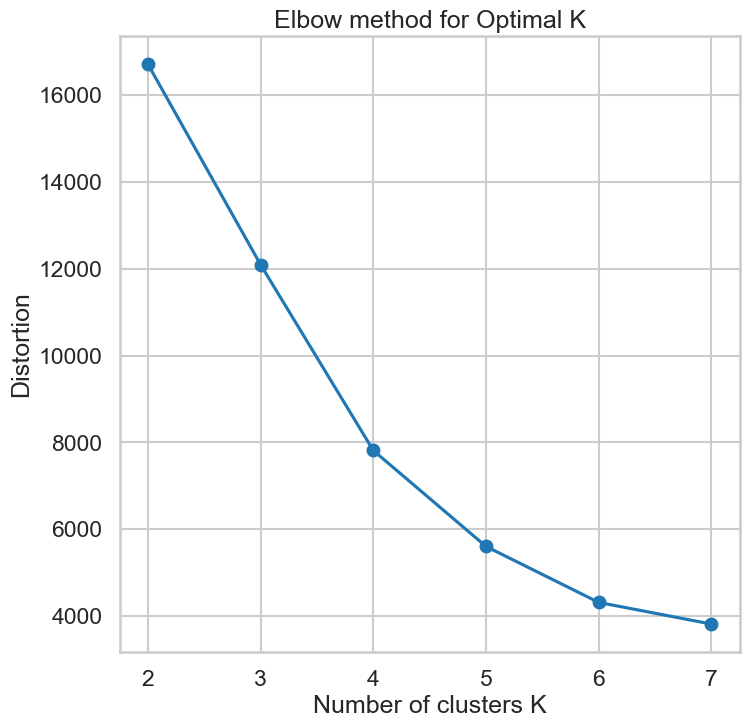

In [76]:
distortions =[]
k_values=[2,3,4,5,6,7]
for k in k_values:
    km=KMeans(n_clusters=k, random_state=42)
    km.fit(Multi_blob_Data)
    distortions.append(km.inertia_)

plt.plot(k_values, distortions, marker='o')
plt.xlabel('Number of clusters K')
plt.ylabel('Distortion')
plt.title("Elbow method for Optimal K")
plt.show()

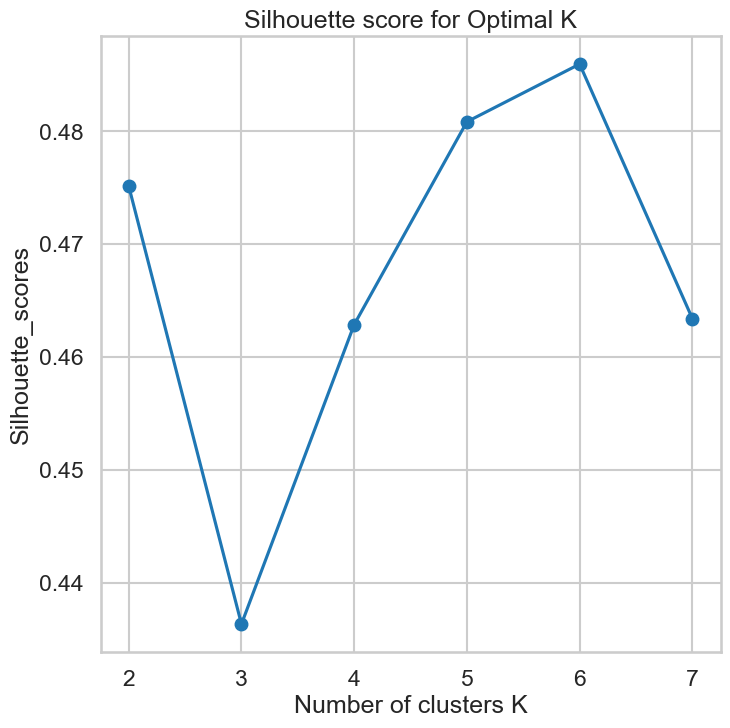

In [77]:
silhouette_scores =[]
k_values=[2,3,4,5,6,7]
for k in k_values:
    km=KMeans(n_clusters=k, random_state=42)
    km.fit(Multi_blob_Data)
    silhouette_scores.append(silhouette_score(Multi_blob_Data,km.labels_))

plt.plot(k_values, silhouette_scores, marker='o')
plt.xlabel('Number of clusters K')
plt.ylabel('Silhouette_scores')
plt.title("Silhouette score for Optimal K")
plt.show()

In [79]:
best_k= k_values[silhouette_scores.index(max(silhouette_scores))]
print(f'Best K: {best_k}, Best silhouette score: {max(silhouette_scores)}')


Best K: 6, Best silhouette score: 0.4859737366910219


### Hierarchal Clustering
* Use AgglomerativeClustering function to  to cluster the above data 
* In the  AgglomerativeClustering change the following parameters 
    * Affinity (use euclidean, manhattan and cosine)
    * Linkage( use average and single )
    * Distance_threshold (try different)
* For each of these trials plot the Dendograph , calculate the silhouette_score and display the resulting clusters  
* Find the set of paramters that would find result in the best silhouette_score and store this score for later comparison with other clustering techniques. 
* Record your observation 

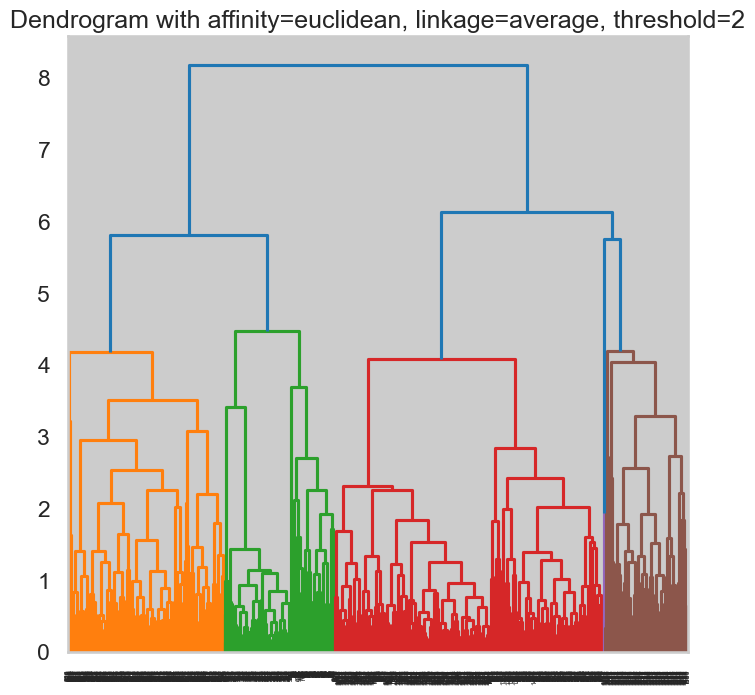

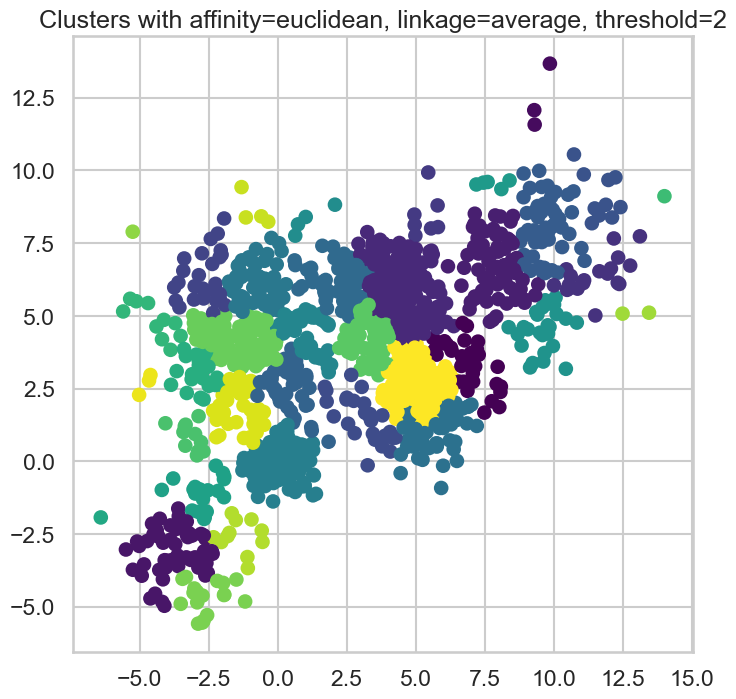

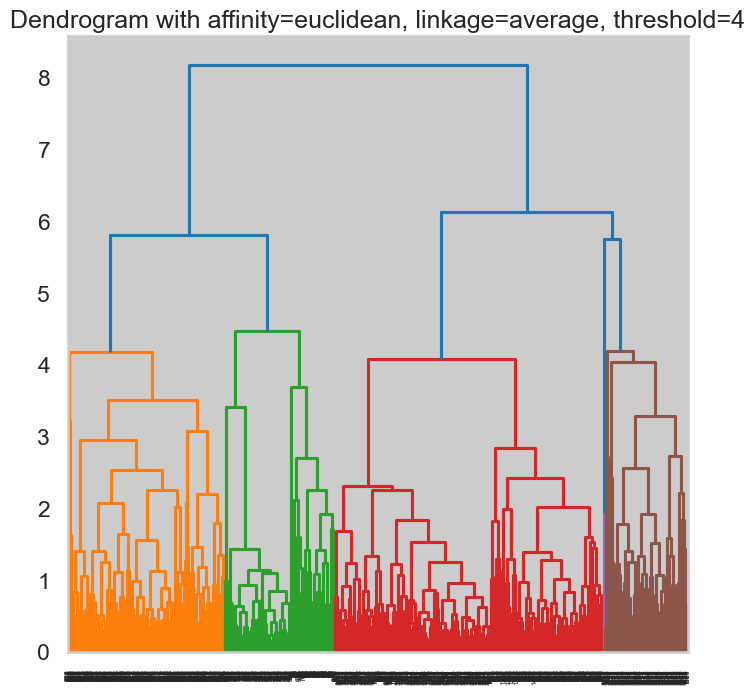

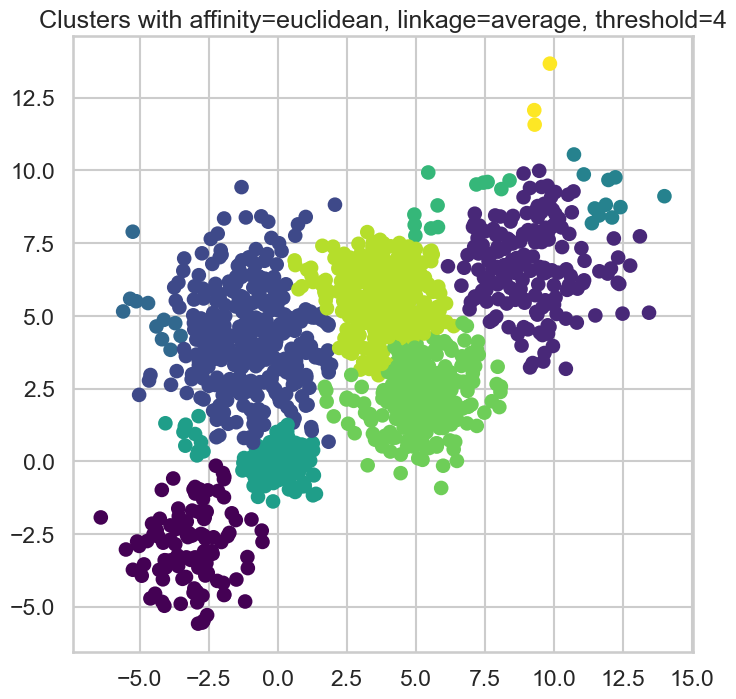

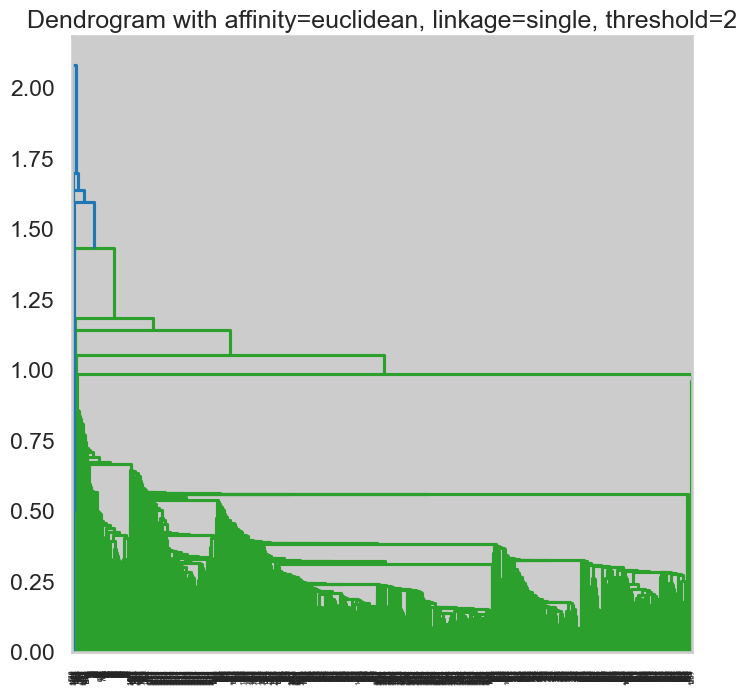

...

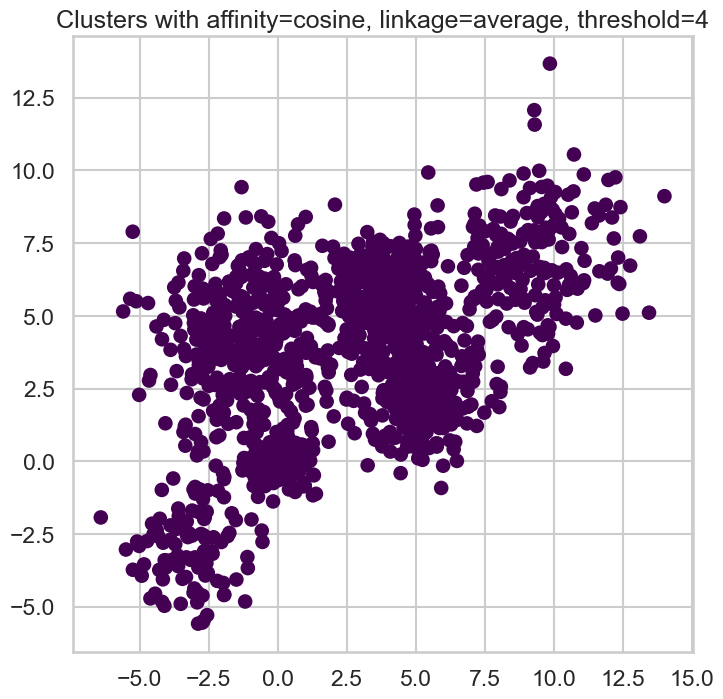

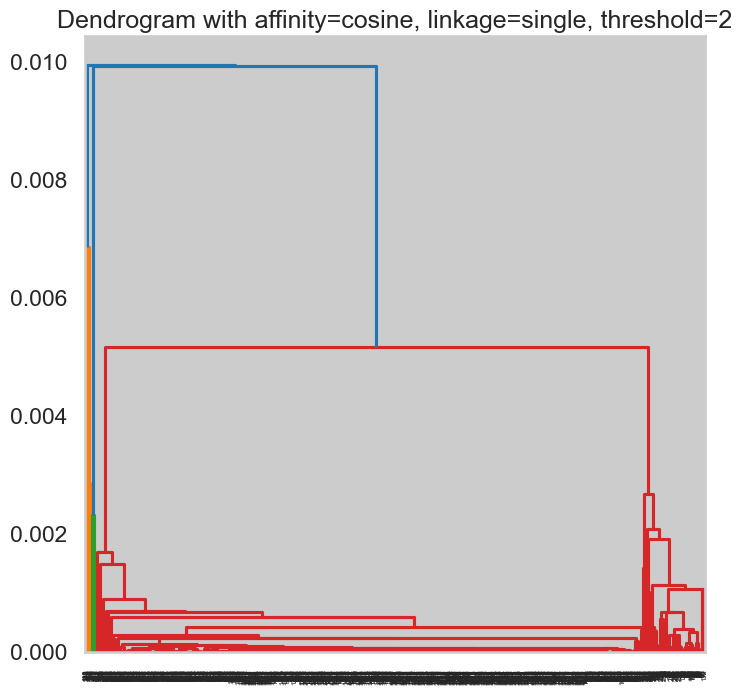

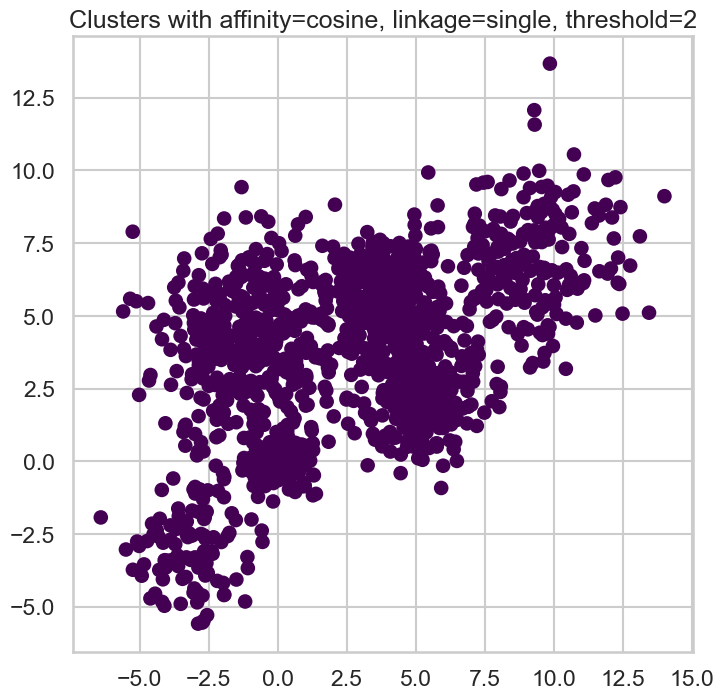

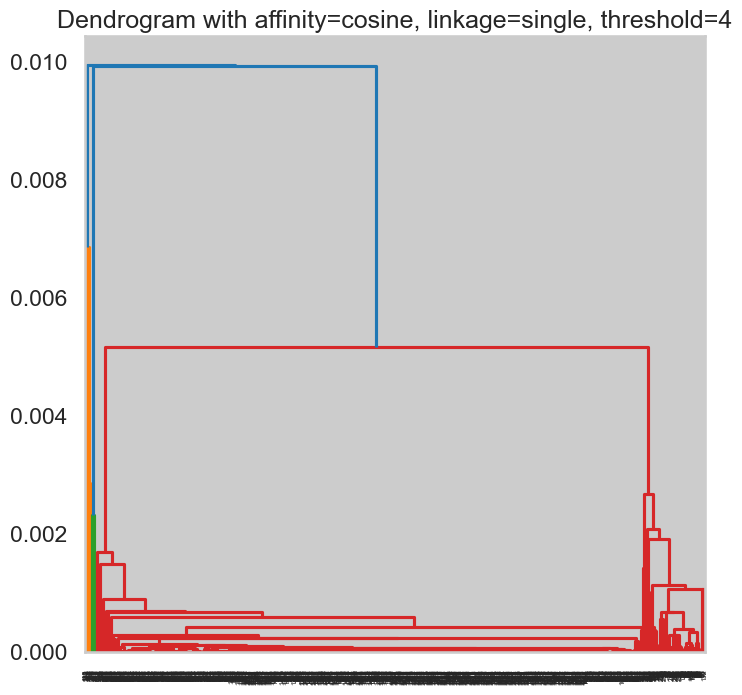

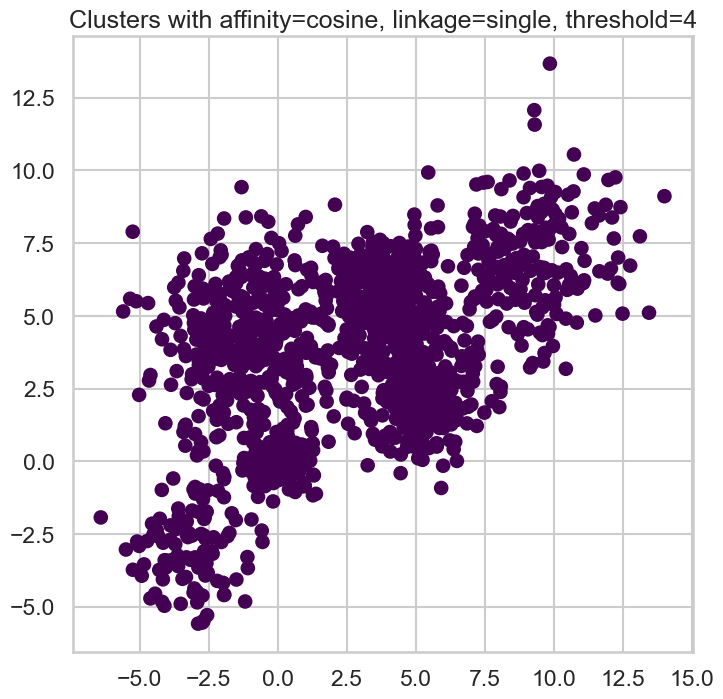

Best silhouette score: 0.37378418096239385 with params: ('euclidean', 'average', 4)


In [8]:
from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.metrics import silhouette_score
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.datasets import make_blobs

def display_cluster_new(data, model):
    plt.scatter(data[:, 0], data[:, 1], c=model.labels_, cmap='viridis')

plt.rcParams['figure.figsize'] = [8, 8]
sns.set_style("whitegrid")
sns.set_context("talk")



#affinities = ['euclidean','manhattan', 'cosine']
affinities = ['euclidean', 'cityblock', 'cosine']

linkages = ['average', 'single']
distance_thresholds = [2, 4]

best_silhouette_score = -1
best_params = None

for affinity in affinities:
    for linkage_method in linkages:
        for threshold in distance_thresholds:
            model = AgglomerativeClustering(n_clusters=None, affinity=affinity, linkage=linkage_method, distance_threshold=threshold)
            cluster_labels = model.fit_predict(Multi_blob_Data)
            if len(set(cluster_labels)) > 1:  # Check if there is more than one cluster
                silhouette_avg = silhouette_score(Multi_blob_Data, cluster_labels)
                if silhouette_avg > best_silhouette_score:
                    best_silhouette_score = silhouette_avg
                    best_params = (affinity, linkage_method, threshold)

            plt.figure()
            dendrogram(linkage(Multi_blob_Data, method=linkage_method, metric=affinity))
            plt.title(f"Dendrogram with affinity={affinity}, linkage={linkage_method}, threshold={threshold}")

            plt.figure()
            display_cluster_new(Multi_blob_Data, model)
            plt.title(f"Clusters with affinity={affinity}, linkage={linkage_method}, threshold={threshold}")
            plt.show()

print(f"Best silhouette score: {best_silhouette_score} with params: {best_params}")



#

**1) Single linkage tends to form long, elongated clusters because it merges clusters based on the minimum distance between points in the clusters. While the 'average' linkage gives way more balanced dendrograms.**

**2) As distance threshold approaches 3 & 4, the entire data compacts into a single cluster with the "single" linkage.**

**3) 8 clusters, which is more than that of the Kmeans.**

### DBScan
* Use DBScan function to  to cluster the above data 
* In the  DBscan change the following parameters 
    * EPS (from 0.1 to 3)
    * Min_samples (from 5 to 25)
* Plot the silhouette_score versus the variation in the EPS and the min_samples
* Plot the resulting Clusters in this case 
* Find the set of paramters that would find result in the best silhouette_score and store this score for later comparison with other clustering techniques. 
* Record your observations and comments 

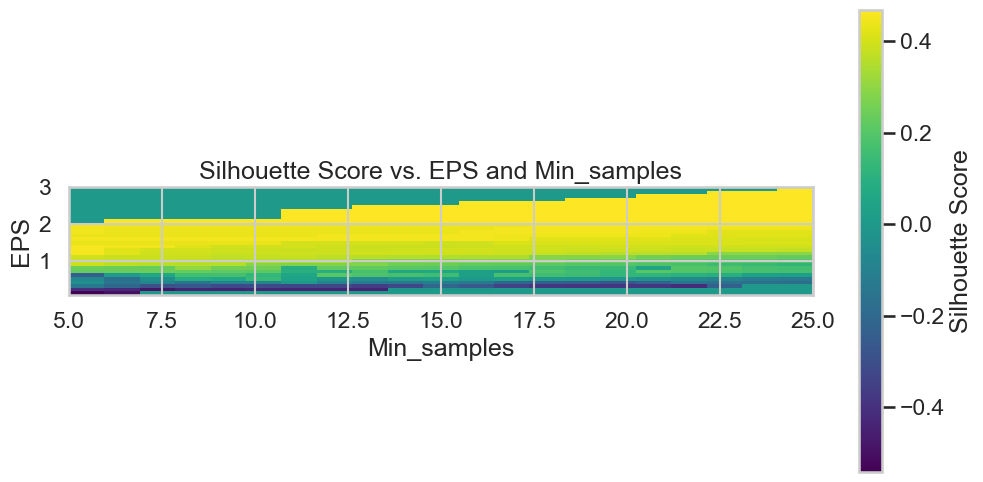

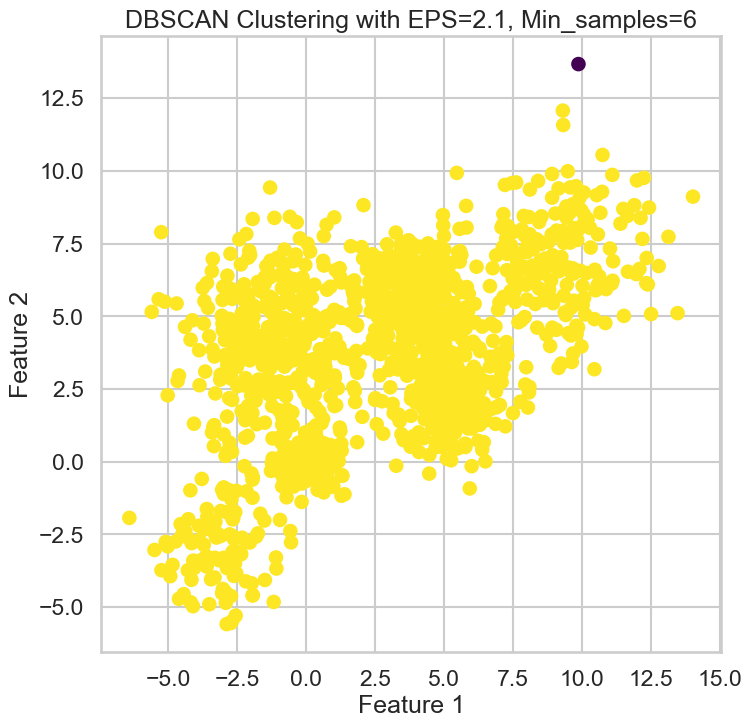

Best Silhouette Score: 0.4685207355522043
Best EPS: 2.1, Best Min_samples: 6


In [71]:
import matplotlib.pyplot as plt
import numpy as np
from sklearn.cluster import DBSCAN
from sklearn.metrics import silhouette_score
from sklearn.datasets import make_blobs



eps_range = np.arange(0.1, 3.1, 0.1)
min_samples_range = range(5, 26)
silhouette_scores = np.zeros((len(eps_range), len(min_samples_range)))

for i, eps in enumerate(eps_range):
    for j, min_samples in enumerate(min_samples_range):
        dbscan = DBSCAN(eps=eps, min_samples=min_samples)
        cluster_labels = dbscan.fit_predict(Multi_blob_Data)
        if len(np.unique(cluster_labels)) > 1:  # Check if more than one cluster (excluding noise) is found
            silhouette_scores[i, j] = silhouette_score(Multi_blob_Data, cluster_labels)

plt.figure(figsize=(12, 6))
plt.imshow(silhouette_scores, cmap='viridis', origin='lower', extent=[5, 25, 0.1, 3])
plt.colorbar(label='Silhouette Score')
plt.xlabel('Min_samples')
plt.ylabel('EPS')
plt.title('Silhouette Score vs. EPS and Min_samples')
plt.show()

best_eps, best_min_samples = np.unravel_index(np.argmax(silhouette_scores), silhouette_scores.shape)
best_dbscan = DBSCAN(eps=eps_range[best_eps], min_samples=min_samples_range[best_min_samples])
best_cluster_labels = best_dbscan.fit_predict(Multi_blob_Data)

plt.figure(figsize=(8, 8))
plt.scatter(Multi_blob_Data[:, 0], Multi_blob_Data[:, 1], c=best_cluster_labels, cmap='viridis')
plt.xlabel('Feature 1')
plt.ylabel('Feature 2')
plt.title(f'DBSCAN Clustering with EPS={eps_range[best_eps]}, Min_samples={min_samples_range[best_min_samples]}')
plt.show()

best_score = silhouette_scores[best_eps, best_min_samples]
print(f"Best Silhouette Score: {best_score}")
print(f"Best EPS: {eps_range[best_eps]}, Best Min_samples: {min_samples_range[best_min_samples]}")


#
<h1> Another representation of Epsilon VS Min Samples figure </h1>

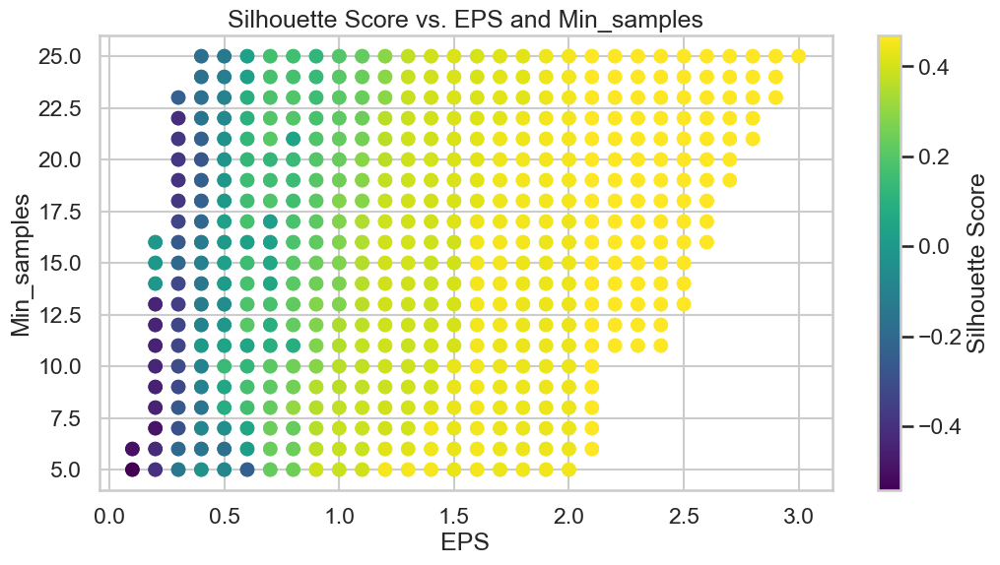

Best silhouette score: 0.4685207355522043 with params: (2.1, 6)


In [68]:
silhouette_scores = []
best_silhouette_score = -1
best_params = None

for eps in np.arange(0.1, 3.1, 0.1):
    for min_samples in range(5, 26):
        dbscan = DBSCAN(eps=eps, min_samples=min_samples)
        cluster_labels = dbscan.fit_predict(Multi_blob_Data)
        if len(np.unique(cluster_labels)) > 1:  # Check if more than one cluster (excluding noise) is found
            silhouette_avg = silhouette_score(Multi_blob_Data, cluster_labels)
            silhouette_scores.append((eps, min_samples, silhouette_avg))
            if silhouette_avg > best_silhouette_score:
                best_silhouette_score = silhouette_avg
                best_params = (eps, min_samples)

silhouette_scores = np.array(silhouette_scores)

fig, ax = plt.subplots(figsize=(12, 6))
ax.scatter(silhouette_scores[:, 0], silhouette_scores[:, 1], c=silhouette_scores[:, 2], cmap='viridis')
ax.set_xlabel('EPS')
ax.set_ylabel('Min_samples')
ax.set_title('Silhouette Score vs. EPS and Min_samples')
plt.colorbar(ax.scatter(silhouette_scores[:, 0], silhouette_scores[:, 1], c=silhouette_scores[:, 2], cmap='viridis'), label='Silhouette Score')
plt.show()

print(f"Best silhouette score: {best_silhouette_score} with params: {best_params}")


**This algorithm couldn't have been worse!!! The entire data is assigned to the same cluster except for one point.**

### Gaussian Mixture
* Use GaussianMixture function to cluster the above data 
* In GMM change the covariance_type and check the difference in the resulting proabability fit 
* Use a 2D contour plot to plot the resulting distribution (the components of the GMM) as well as the total Gaussian mixture 

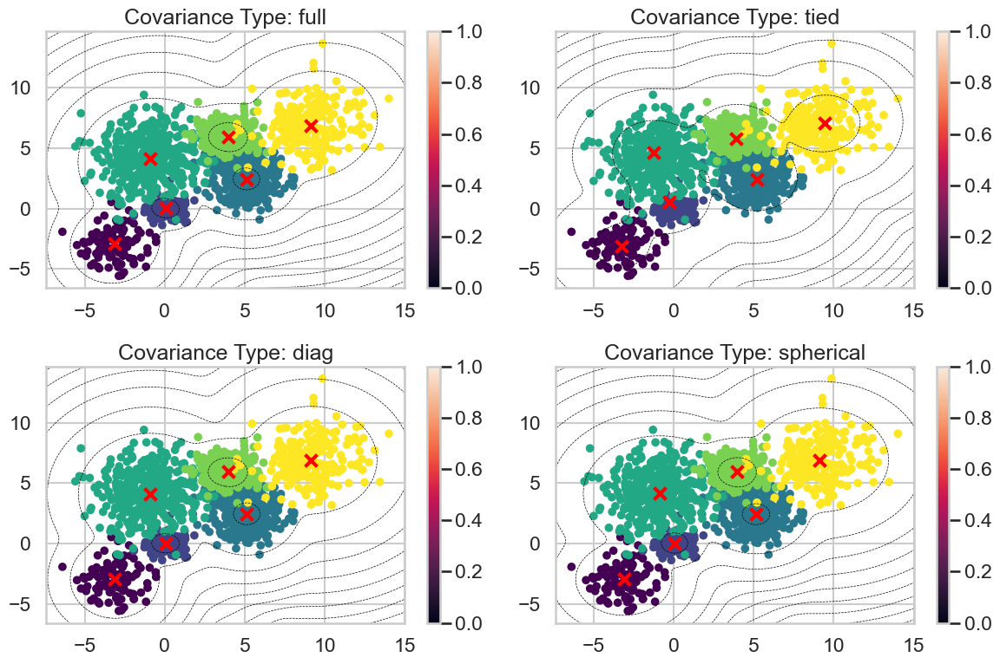

In [103]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.datasets import make_blobs
from sklearn.mixture import GaussianMixture


n_bins = 6
centers = [(-3, -3), (0, 0), (5, 2.5), (-1, 4), (4, 6), (9, 7)]
Multi_blob_Data, y = make_blobs(n_samples=[100, 150, 300, 400, 300, 200], n_features=2,
                                 cluster_std=[1.3, 0.6, 1.2, 1.7, 0.9, 1.7], centers=centers,
                                 shuffle=False, random_state=42)


covariance_types = ['full', 'tied', 'diag', 'spherical']
plt.figure(figsize=(12, 8))
for i, cov_type in enumerate(covariance_types):
    gmm = GaussianMixture(n_components=n_bins, covariance_type=cov_type, random_state=42)
    gmm.fit(Multi_blob_Data)
    centers = gmm.means_

    # Creating a 2D contour plot
    x_min, x_max = Multi_blob_Data[:, 0].min() - 1, Multi_blob_Data[:, 0].max() + 1
    y_min, y_max = Multi_blob_Data[:, 1].min() - 1, Multi_blob_Data[:, 1].max() + 1
    xx, yy = np.meshgrid(np.linspace(x_min, x_max, 500), np.linspace(y_min, y_max, 500))
    Z = gmm.score_samples(np.c_[xx.ravel(), yy.ravel()])
    Z = Z.reshape(xx.shape)

    plt.subplot(2, 2, i + 1)
    plt.scatter(Multi_blob_Data[:, 0], Multi_blob_Data[:, 1], c=y, s=30, cmap='viridis')
    plt.contour(xx, yy, Z, levels=10, linewidths=0.5, colors='black')
    plt.scatter(centers[:, 0], centers[:, 1], marker='x', s=100, linewidths=3, color='r', zorder=10)
    plt.title(f'Covariance Type: {cov_type}')
    plt.colorbar()

plt.tight_layout()
plt.show()


**6 clusters**

#
<h1> Another Representation </h1>

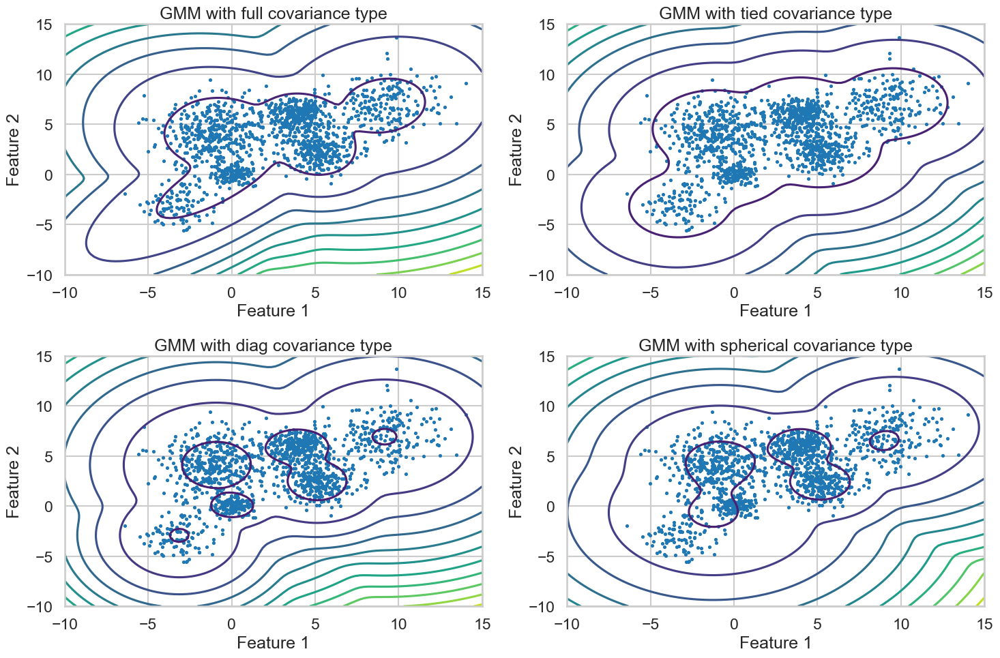

In [9]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.mixture import GaussianMixture


n_bins = 6
centers = [(-3, -3), (0, 0), (5, 2.5), (-1, 4), (4, 6), (9, 7)]
Multi_blob_Data, y = make_blobs(n_samples=[100, 150, 300, 400, 300, 200], n_features=2,
                                 cluster_std=[1.3, 0.6, 1.2, 1.7, 0.9, 1.7], centers=centers,
                                 shuffle=False, random_state=42)


n_components = len(centers)
covariance_types = ['full', 'tied', 'diag', 'spherical']
plt.figure(figsize=(15, 10))
for i, covariance_type in enumerate(covariance_types):
    gmm = GaussianMixture(n_components=n_components, covariance_type=covariance_type)
    gmm.fit(Multi_blob_Data)
    
    # Creating a meshgrid to plot the distributions
    x = np.linspace(-10, 15, 100)
    y = np.linspace(-10, 15, 100)
    X, Y = np.meshgrid(x, y)
    XX = np.array([X.ravel(), Y.ravel()]).T
    Z = -gmm.score_samples(XX)
    Z = Z.reshape(X.shape)
    
 
    plt.subplot(2, 2, i+1)
    plt.scatter(Multi_blob_Data[:, 0], Multi_blob_Data[:, 1], s=5)
    plt.contour(X, Y, Z, levels=10, cmap='viridis')
    plt.title(f'GMM with {covariance_type} covariance type')
    plt.xlabel('Feature 1')
    plt.ylabel('Feature 2')

plt.tight_layout()
plt.show()


<h1>Observations on the 4 algorithms:</h1>

**Both the KMeans and the Gaussian gave us 6 clusters.**

**Dbscan has almost failed to cluster the Multi-blob-data.**

**The Agglomerative Clustering did well "8 clusters", yet it was obviously sensitive to the outliers.**

**The KMeans gave the highest silhouette followed by the dbscan which is kinda weird.**

**However, we can easily say that the KMeans performed the best on the Multi-blob-data.**

**----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------**

## iris data set 
The iris data set is test data set that is part of the Sklearn module 
which contains 150 records each with 4 features. All the features are represented by real numbers 

The data represents three classes 


In [10]:
from sklearn.datasets import load_iris
iris_data = load_iris()
iris_data.target[[10, 25, 50]]
#array([0, 0, 1])
list(iris_data.target_names)
['setosa', 'versicolor', 'virginica']


['setosa', 'versicolor', 'virginica']

* Repeat all the above clustering approaches and steps on the above data 
* Normalize the data then repeat all the above steps 
* Compare between the different clustering approaches 

#
<h1>Visualising the KMeans on the first 2 features of the Iris data</h1>

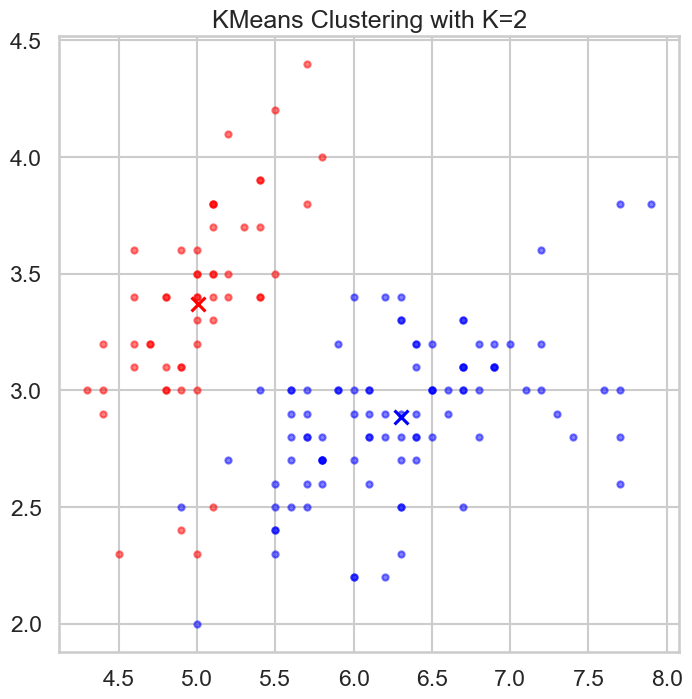

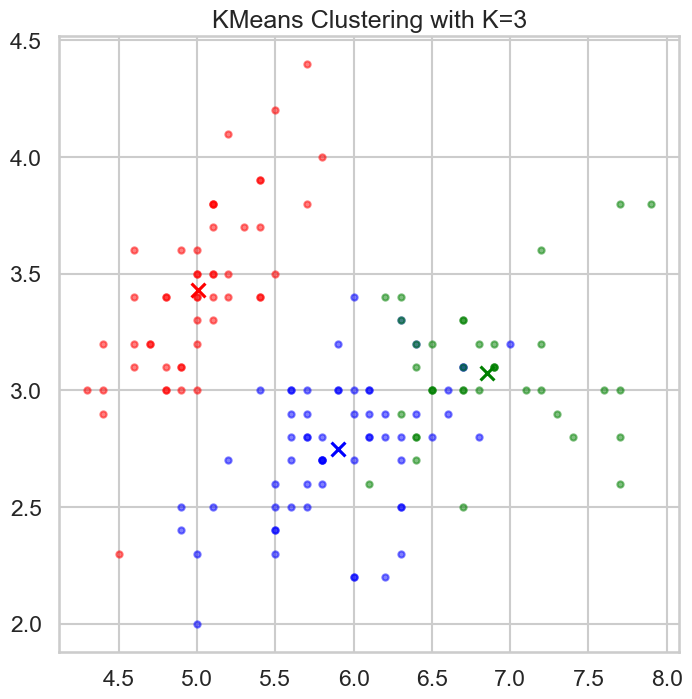

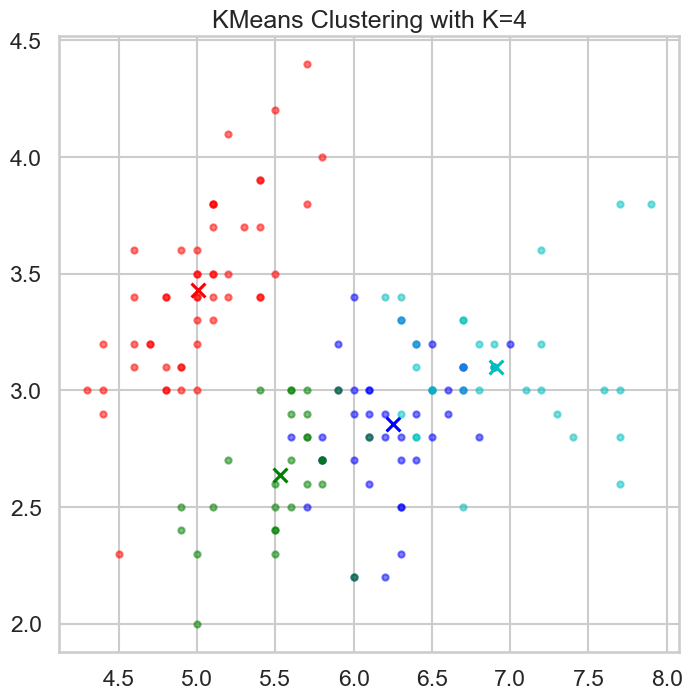

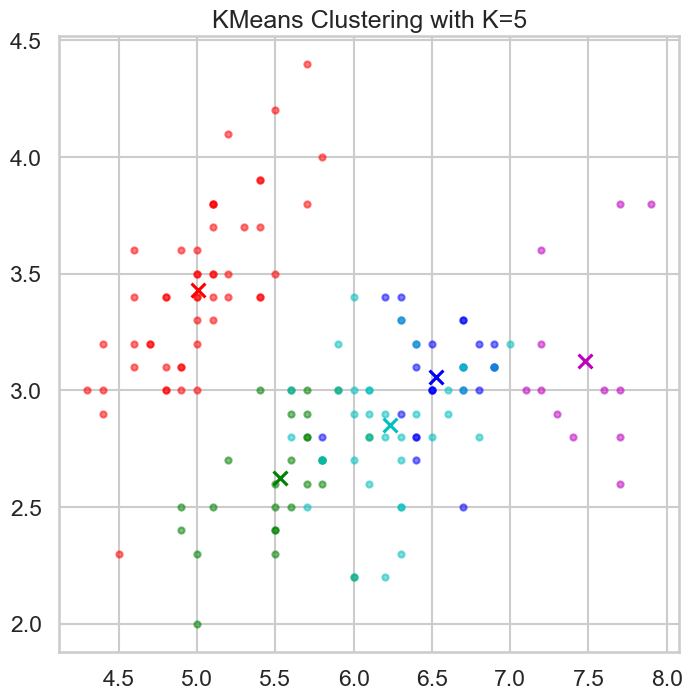

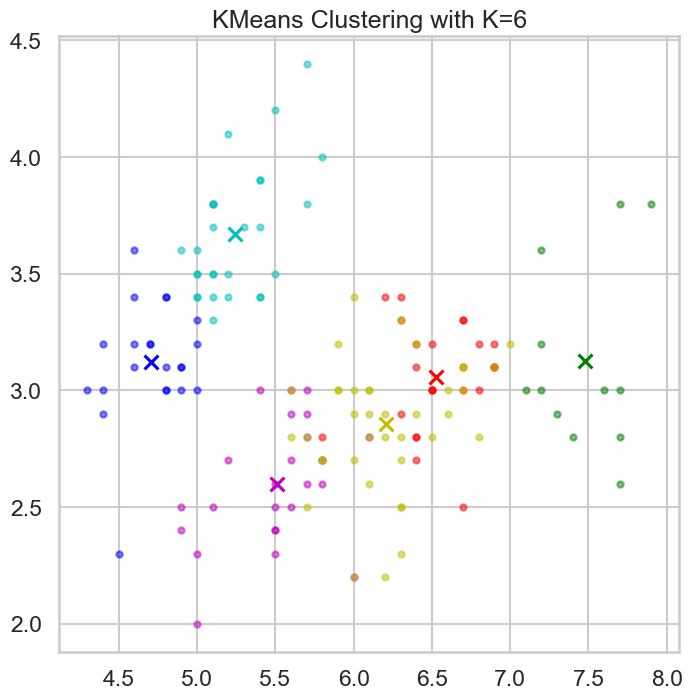

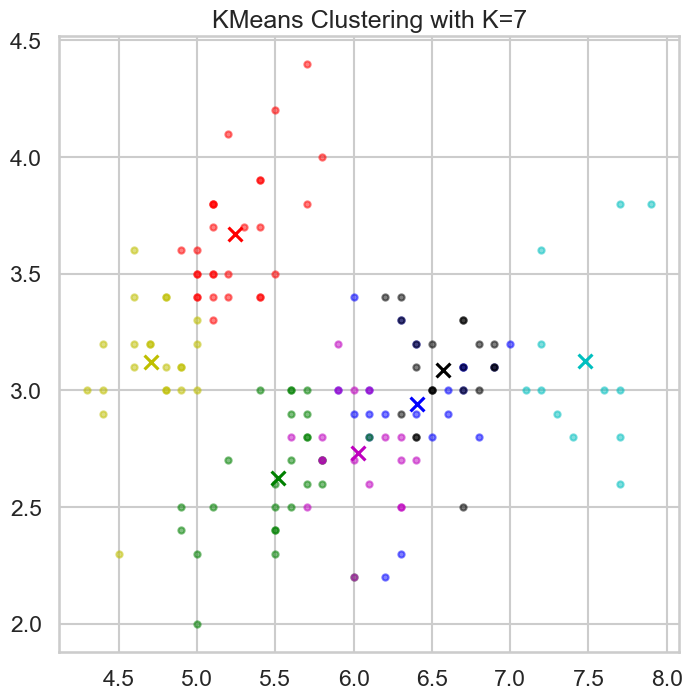

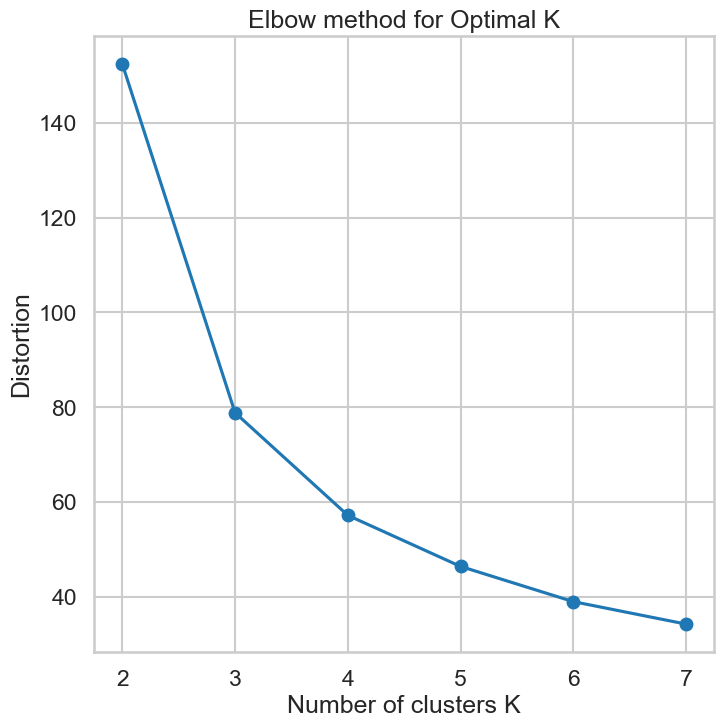

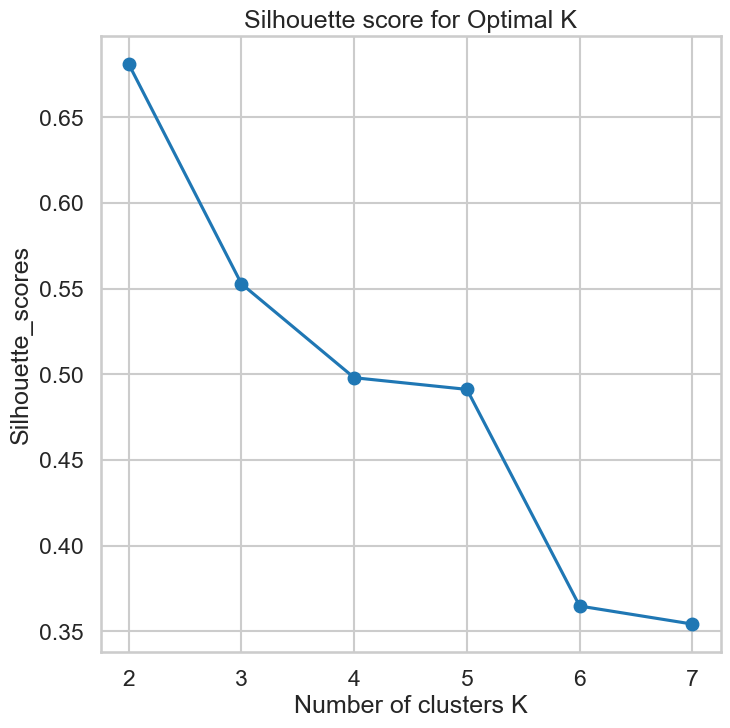

Best K: 2, Best silhouette score: 0.6810461692117462


In [46]:
iris_data = load_iris()


k_values = [2, 3, 4, 5, 6, 7]
for k in k_values:
    km = KMeans(n_clusters=k, random_state=42)
    km.fit(iris_data.data)
    plt.figure()
    display_cluster(iris_data.data, km, k)
    plt.title(f"KMeans Clustering with K={k}")
    plt.show()

# Elbow method for optimal K
distortions = []
for k in k_values:
    km = KMeans(n_clusters=k, random_state=42)
    km.fit(iris_data.data)
    distortions.append(km.inertia_)

plt.plot(k_values, distortions, marker='o')
plt.xlabel('Number of clusters K')
plt.ylabel('Distortion')
plt.title("Elbow method for Optimal K")
plt.show()

# Silhouette score for optimal K
silhouette_scores = []
for k in k_values:
    km = KMeans(n_clusters=k, random_state=42)
    km.fit(iris_data.data)
    silhouette_scores.append(silhouette_score(iris_data.data, km.labels_))

plt.plot(k_values, silhouette_scores, marker='o')
plt.xlabel('Number of clusters K')
plt.ylabel('Silhouette_scores')
plt.title("Silhouette score for Optimal K")
plt.show()

# Finding the best K and its silhouette score
best_k = k_values[silhouette_scores.index(max(silhouette_scores))]
print(f'Best K: {best_k}, Best silhouette score: {max(silhouette_scores)}')


<h1>Visualizing all features of the Iris data in pairs </h1>

<Figure size 800x800 with 0 Axes>

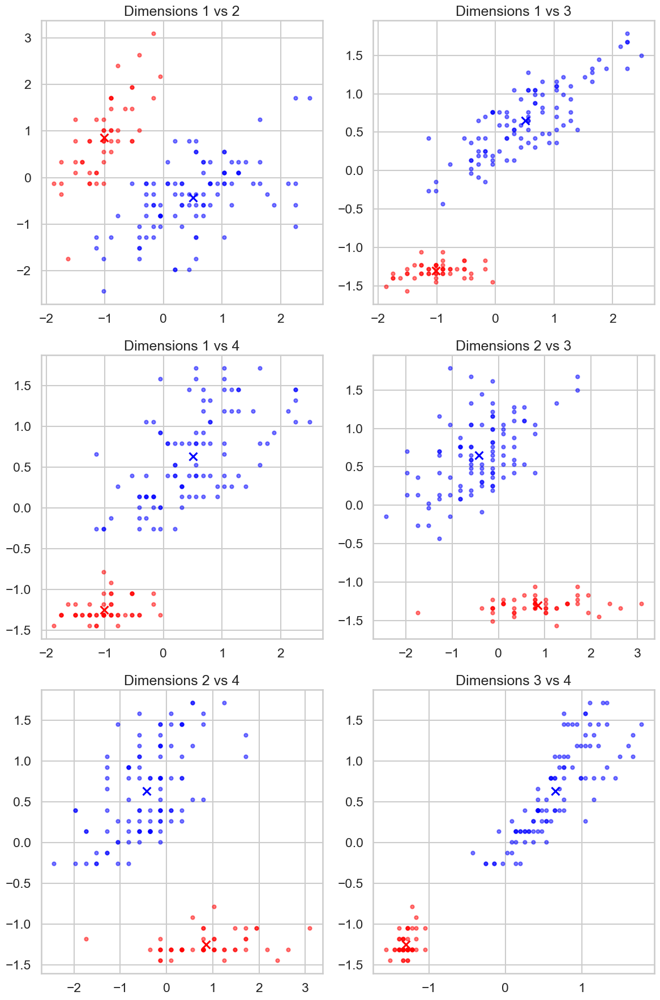

<Figure size 800x800 with 0 Axes>

<Figure size 800x800 with 0 Axes>

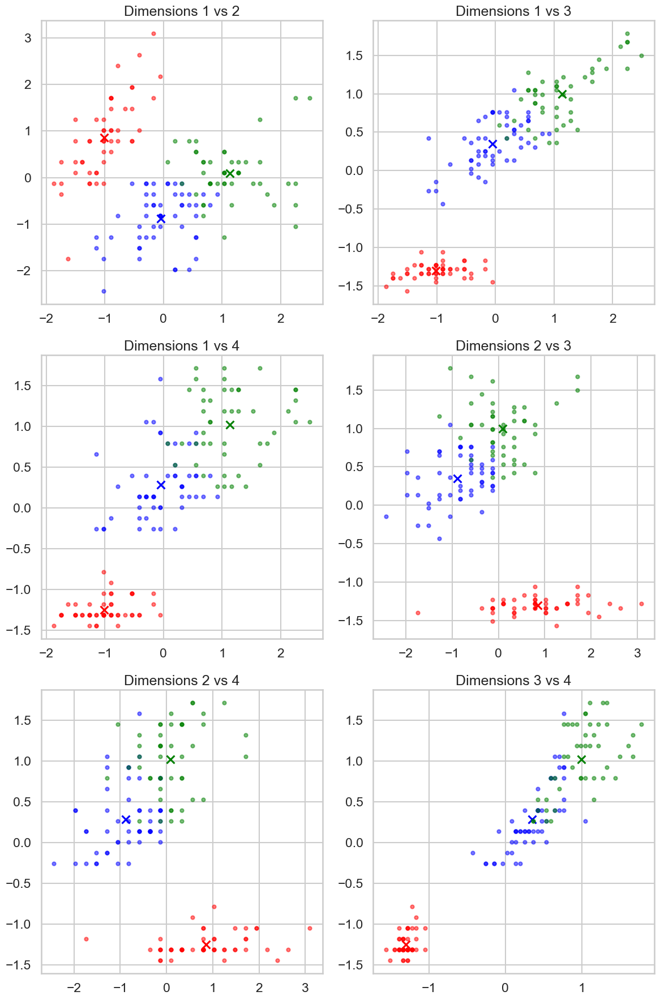

<Figure size 800x800 with 0 Axes>

<Figure size 800x800 with 0 Axes>

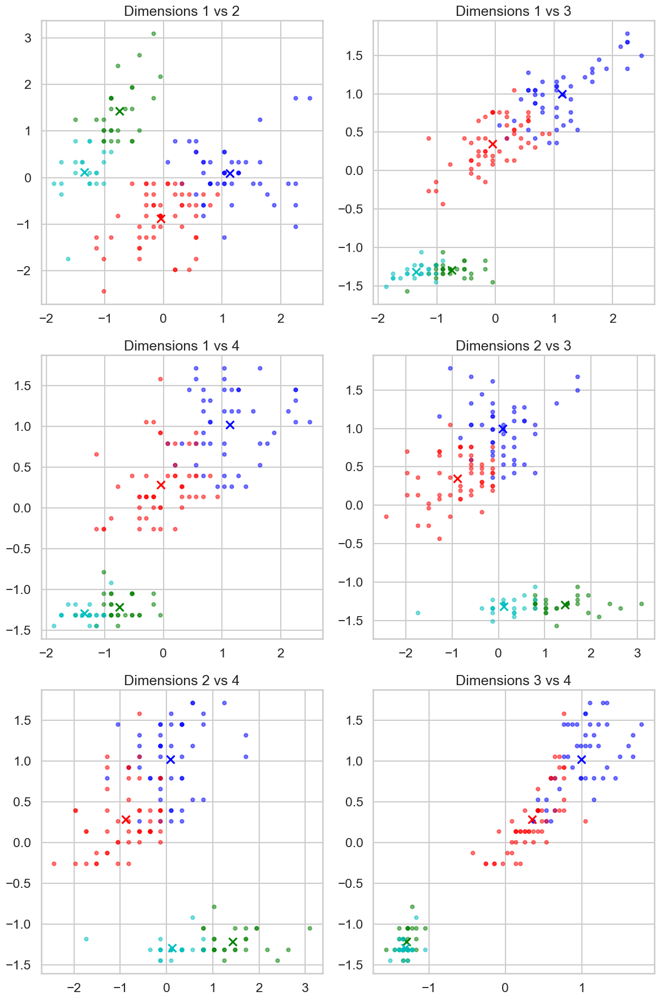

<Figure size 800x800 with 0 Axes>

<Figure size 800x800 with 0 Axes>

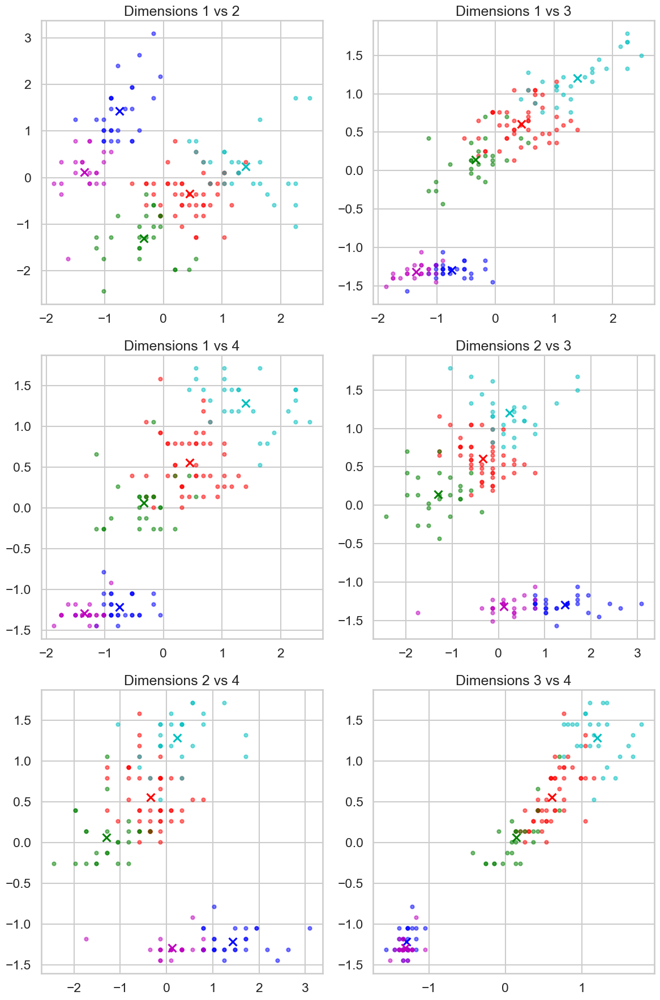

<Figure size 800x800 with 0 Axes>

<Figure size 800x800 with 0 Axes>

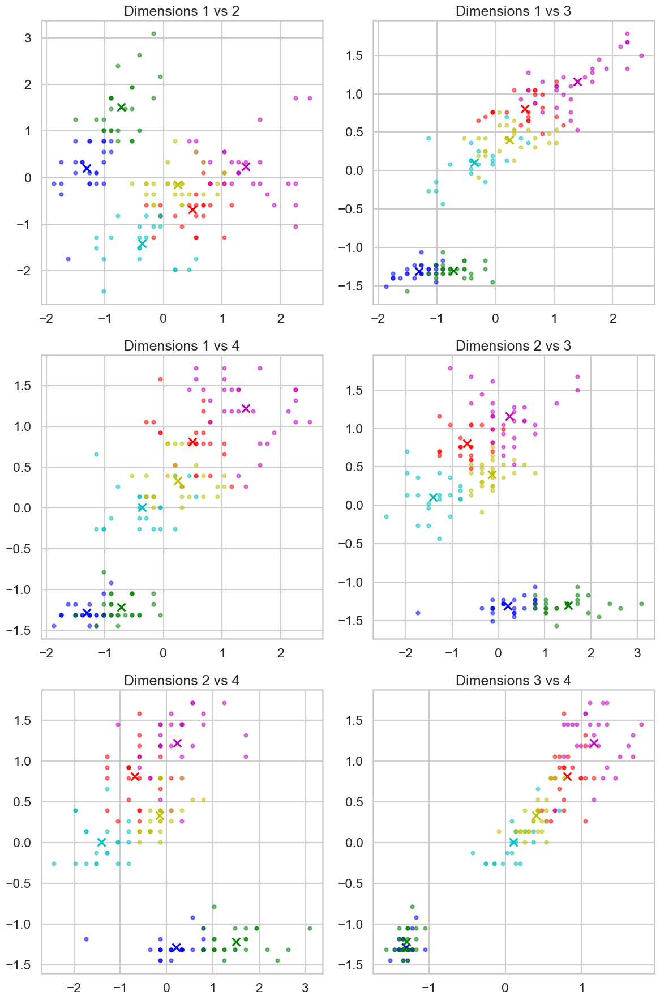

<Figure size 800x800 with 0 Axes>

<Figure size 800x800 with 0 Axes>

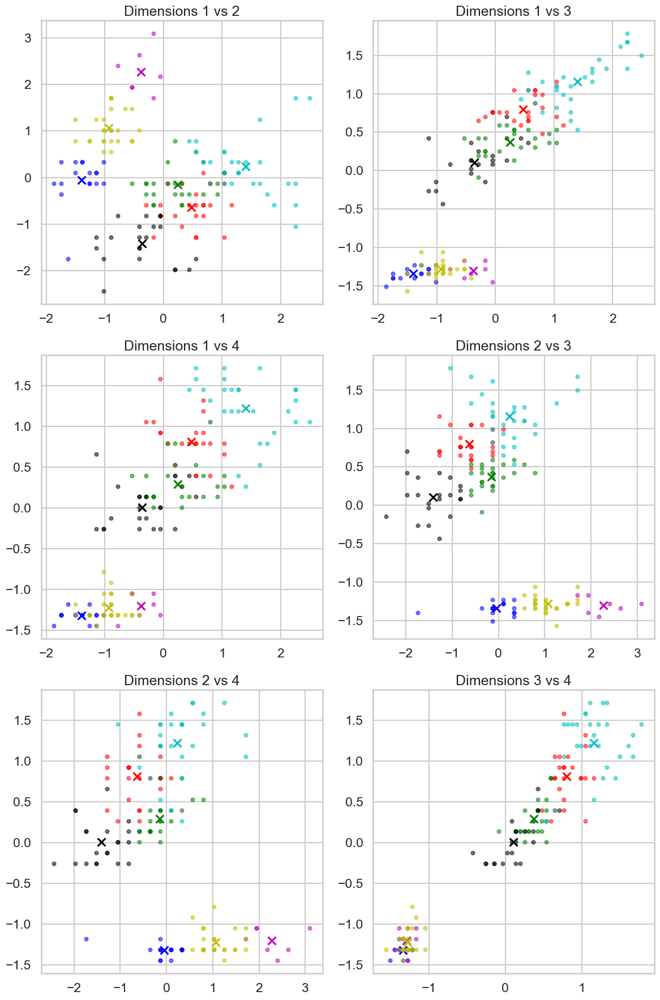

<Figure size 800x800 with 0 Axes>

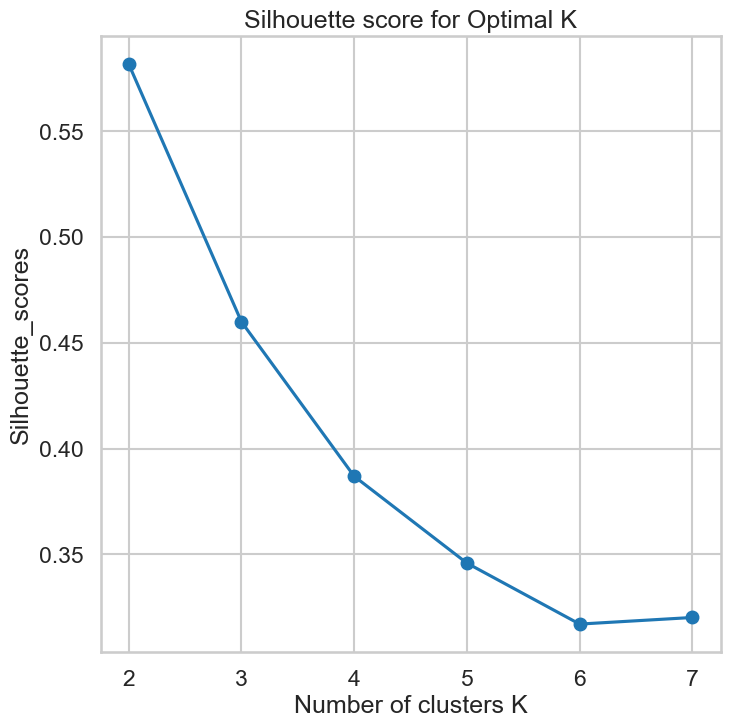

Best K: 2, Best silhouette score: 0.5817500491982808


In [49]:
from sklearn.datasets import make_blobs
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler

def display_cluster_ND(X, cluster_assignments=[], centroids=[], num_clusters=0):
    color = 'brgcmyk'
    alpha = 0.5
    s = 20

    num_dimensions = X.shape[1]
    num_plots = num_dimensions * (num_dimensions - 1) // 2

    fig, axs = plt.subplots(num_plots // 2, 2, figsize=(12, 6 * (num_plots // 2)))

    plot_index = 0
    for i in range(num_dimensions):
        for j in range(i + 1, num_dimensions):
            ax = axs[plot_index // 2, plot_index % 2] if num_plots > 1 else axs
            plot_index += 1
            ax.set_title(f'Dimensions {i + 1} vs {j + 1}')

            if num_clusters == 0:
                ax.scatter(X[:, i], X[:, j], c=color[0], alpha=alpha, s=s)
            else:
                for k in range(num_clusters):
                    ax.scatter(X[cluster_assignments == k, i], X[cluster_assignments == k, j], c=color[k], alpha=alpha, s=s)
                    ax.scatter(centroids[k][i], centroids[k][j], c=color[k], marker='x', s=100)

    plt.tight_layout()
    plt.show()




from sklearn.datasets import load_iris
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt

# Load the Iris dataset
iris_data = load_iris()
X = iris_data.data

# Standardize the data
scaler = StandardScaler()
X_normalized = scaler.fit_transform(X)

# Fit KMeans with different values of K
k_values = [2, 3, 4, 5, 6, 7]
silhouette_scores = []
for k in k_values:
    km = KMeans(n_clusters=k, random_state=42)
    km.fit(X_normalized)
    silhouette_scores.append(silhouette_score(X_normalized, km.labels_))

    centroids = km.cluster_centers_
    plt.figure()
    display_cluster_ND(X_normalized, km.labels_, centroids, k)
    plt.suptitle(f"KMeans Clustering with K={k}", y=1.02)
    plt.show()

plt.plot(k_values, silhouette_scores, marker='o')
plt.xlabel('Number of clusters K')
plt.ylabel('Silhouette_scores')
plt.title("Silhouette score for Optimal K")
plt.show()

# Find the best K and its silhouette score
best_k = k_values[silhouette_scores.index(max(silhouette_scores))]
print(f'Best K: {best_k}, Best silhouette score: {max(silhouette_scores)}')


**Both gave us 2 clusters.**

<h1> Agglomerative Clustering</h1>

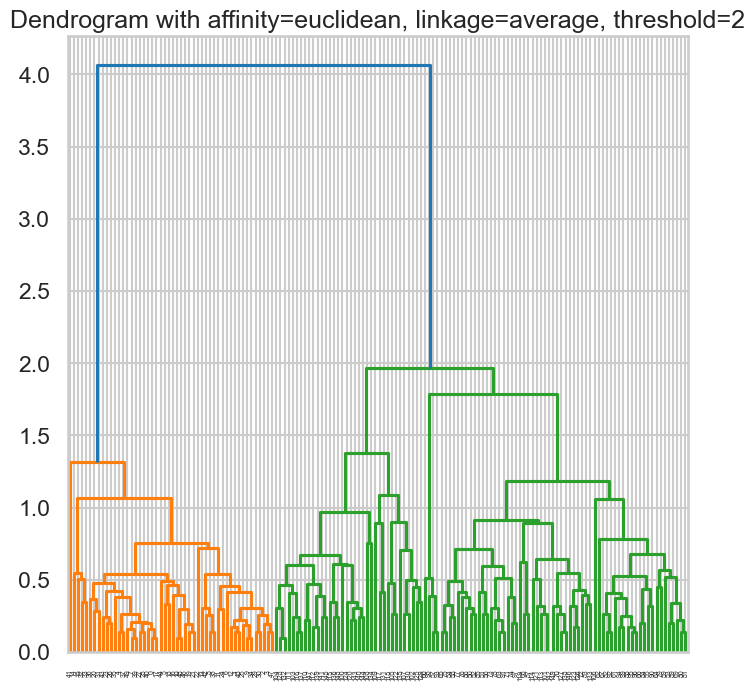

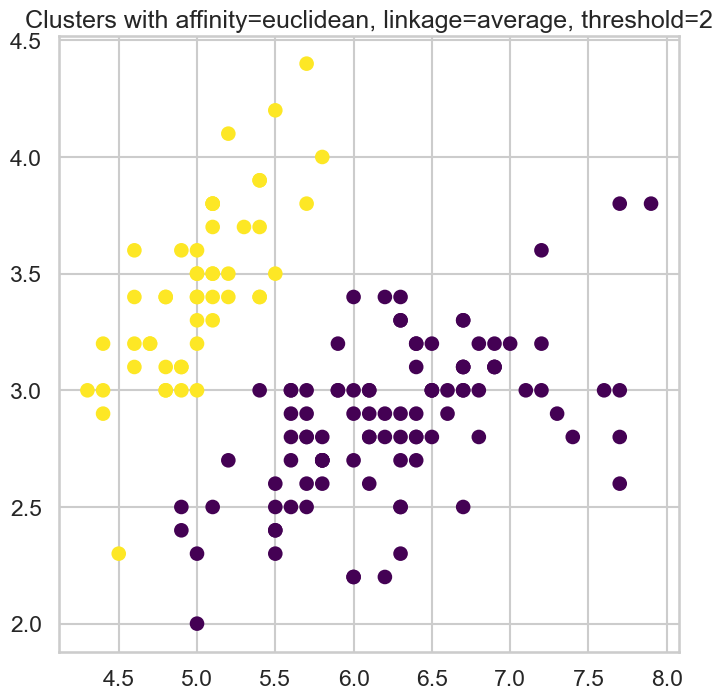

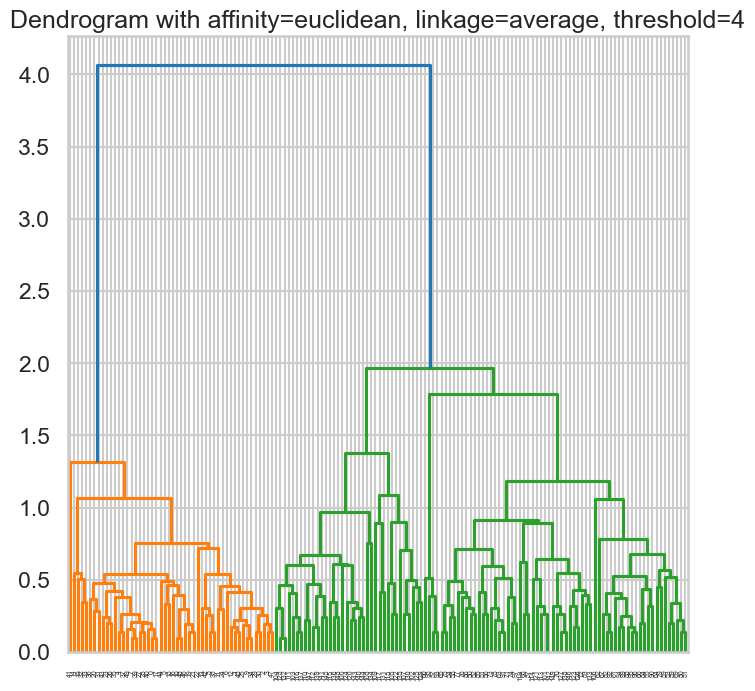

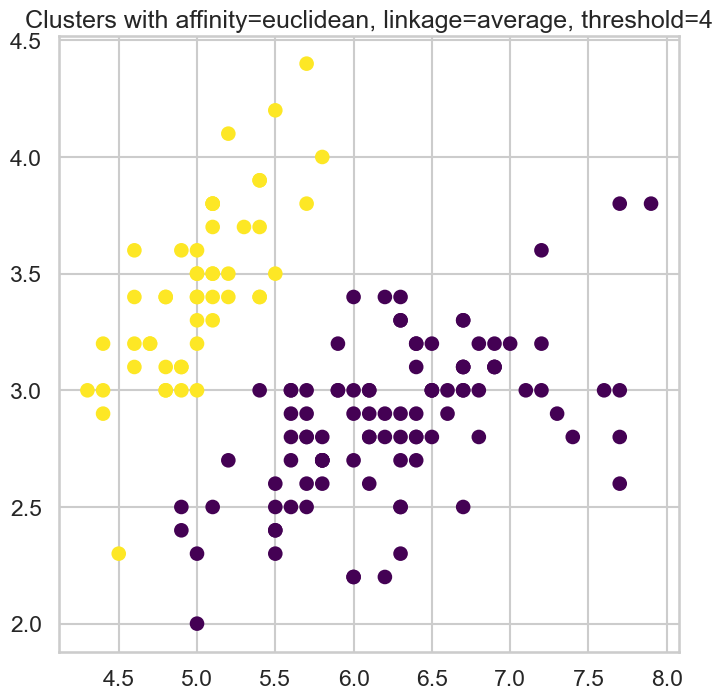

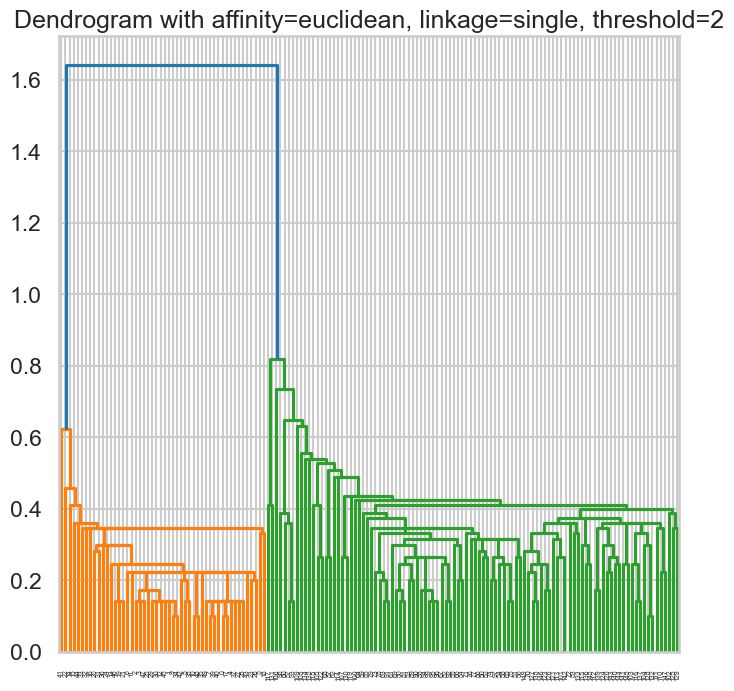

...

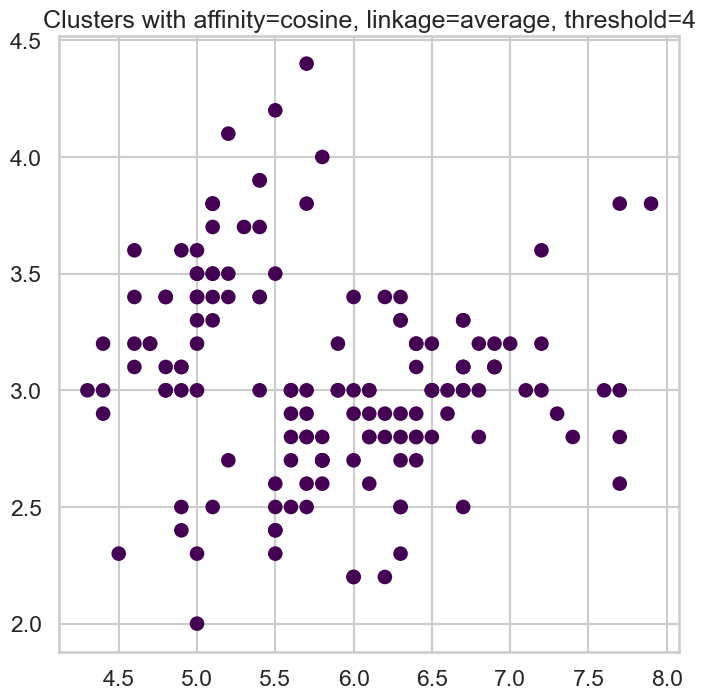

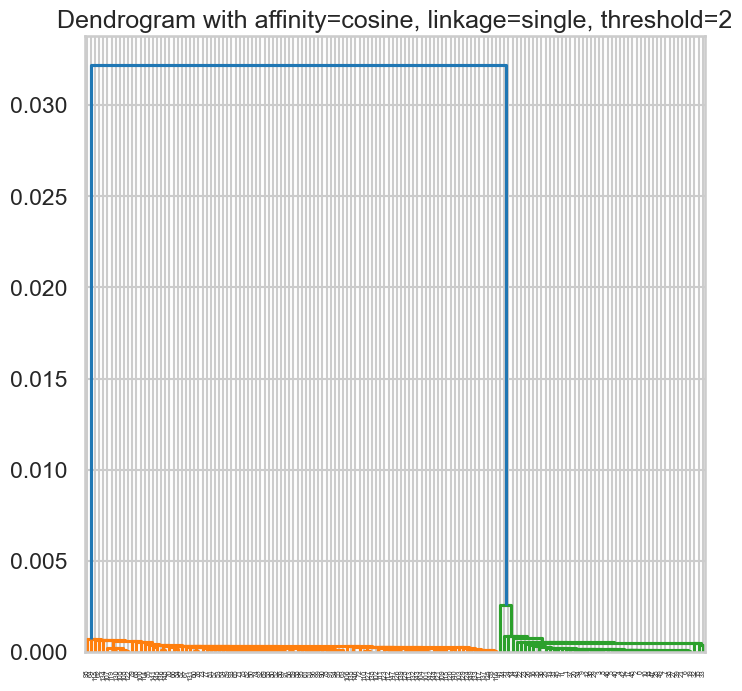

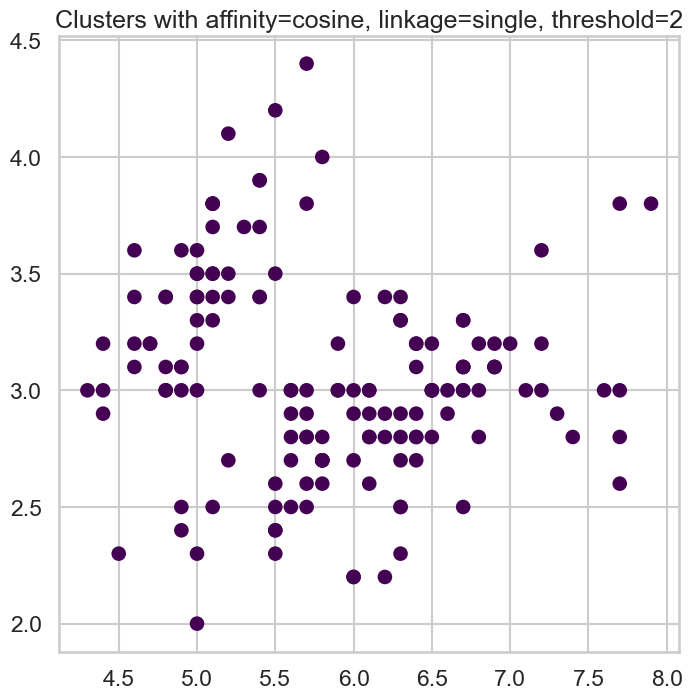

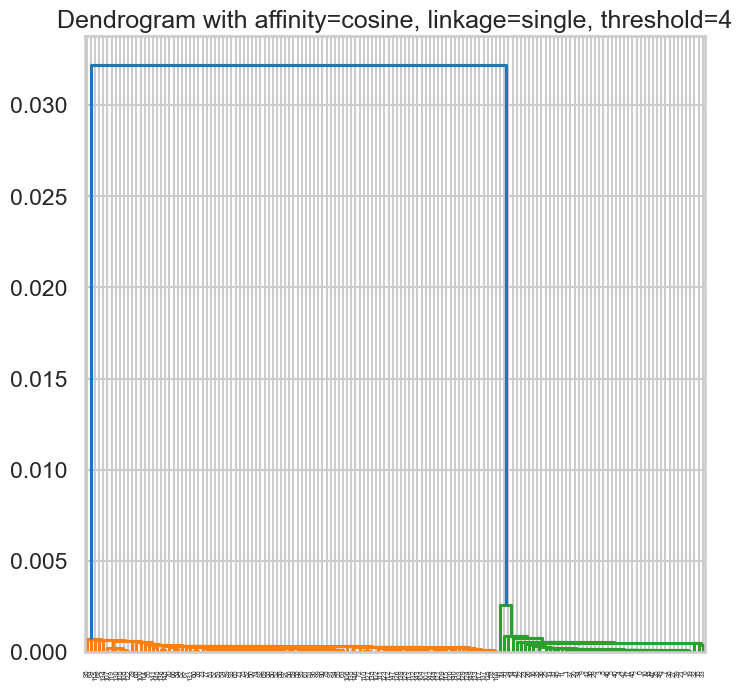

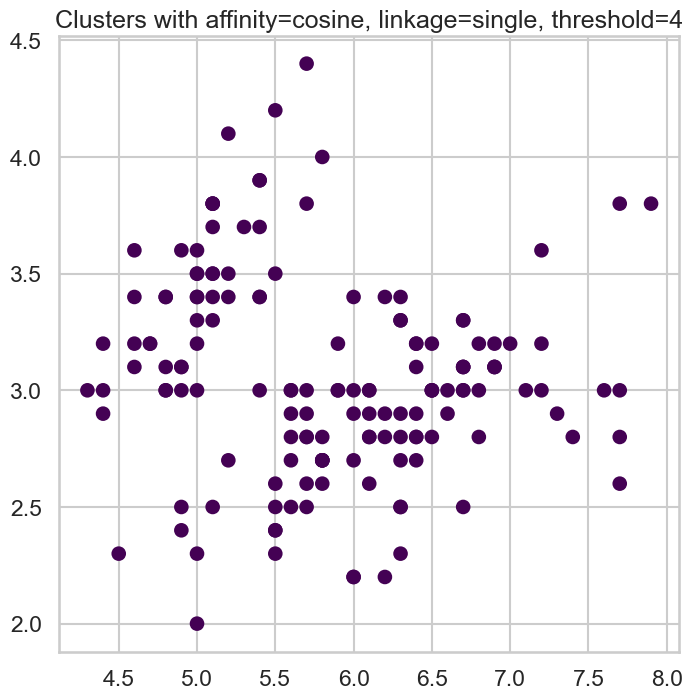

Best silhouette score: 0.6867350732769777 with params: ('euclidean', 'average', 2)


In [13]:
from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.metrics import silhouette_score
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.datasets import load_iris

def display_cluster_new(data, model):
    plt.scatter(data[:, 0], data[:, 1], c=model.labels_, cmap='viridis')

plt.rcParams['figure.figsize'] = [8, 8]
sns.set_style("whitegrid")
sns.set_context("talk")

iris_data = load_iris()
X = iris_data.data

affinities = ['euclidean', 'cityblock', 'cosine']
linkages = ['average', 'single']
distance_thresholds = [2, 4]

best_silhouette_score = -1
best_params = None

for affinity in affinities:
    for linkage_method in linkages:
        for threshold in distance_thresholds:
            model = AgglomerativeClustering(n_clusters=None, affinity=affinity, linkage=linkage_method, distance_threshold=threshold)
            cluster_labels = model.fit_predict(X)
            if len(set(cluster_labels)) > 1:  # Check if there is more than one cluster
                silhouette_avg = silhouette_score(X, cluster_labels)
                if silhouette_avg > best_silhouette_score:
                    best_silhouette_score = silhouette_avg
                    best_params = (affinity, linkage_method, threshold)

            plt.figure()
            dendrogram(linkage(X, method=linkage_method, metric=affinity))
            plt.title(f"Dendrogram with affinity={affinity}, linkage={linkage_method}, threshold={threshold}")

            plt.figure()
            display_cluster_new(X, model)
            plt.title(f"Clusters with affinity={affinity}, linkage={linkage_method}, threshold={threshold}")
            plt.show()

print(f"Best silhouette score: {best_silhouette_score} with params: {best_params}")


<h1>Displaying all features in pairs using the Agglomerative Clustering </h1>

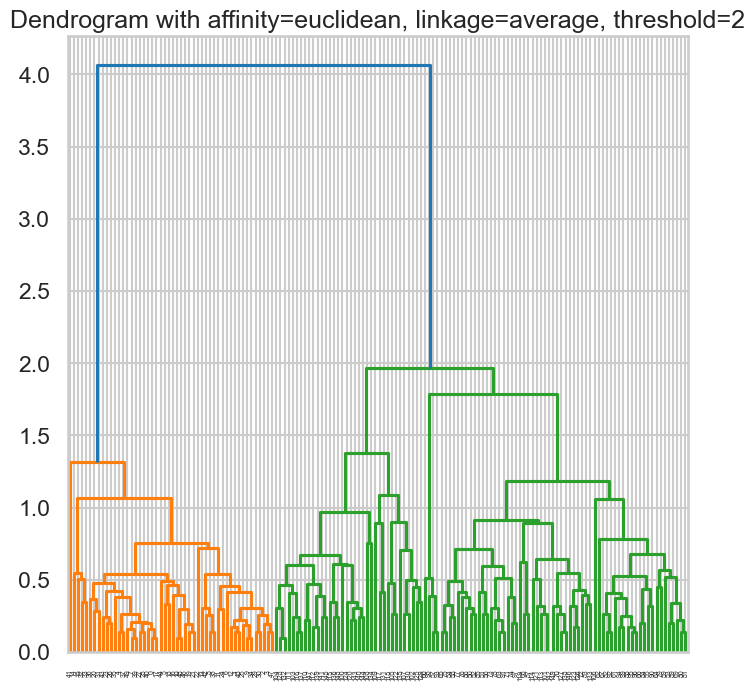

<Figure size 800x800 with 0 Axes>

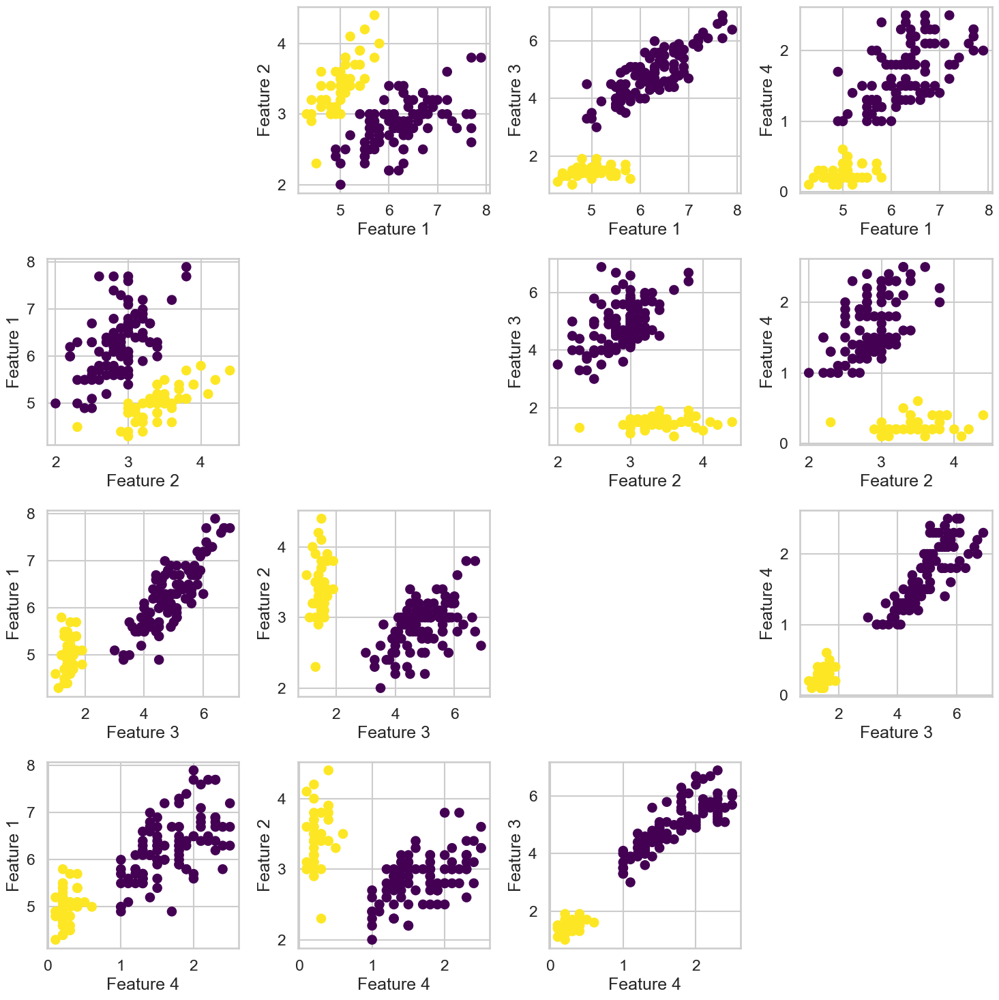

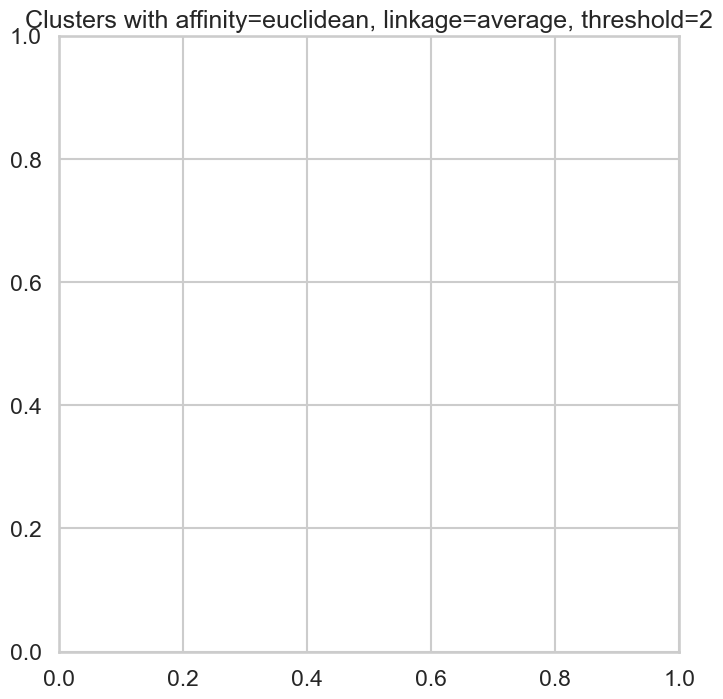

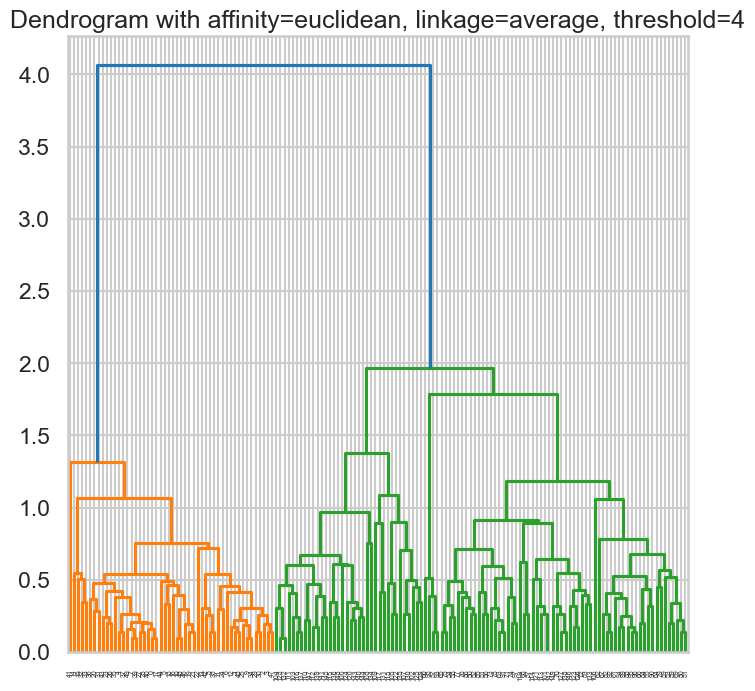

<Figure size 800x800 with 0 Axes>

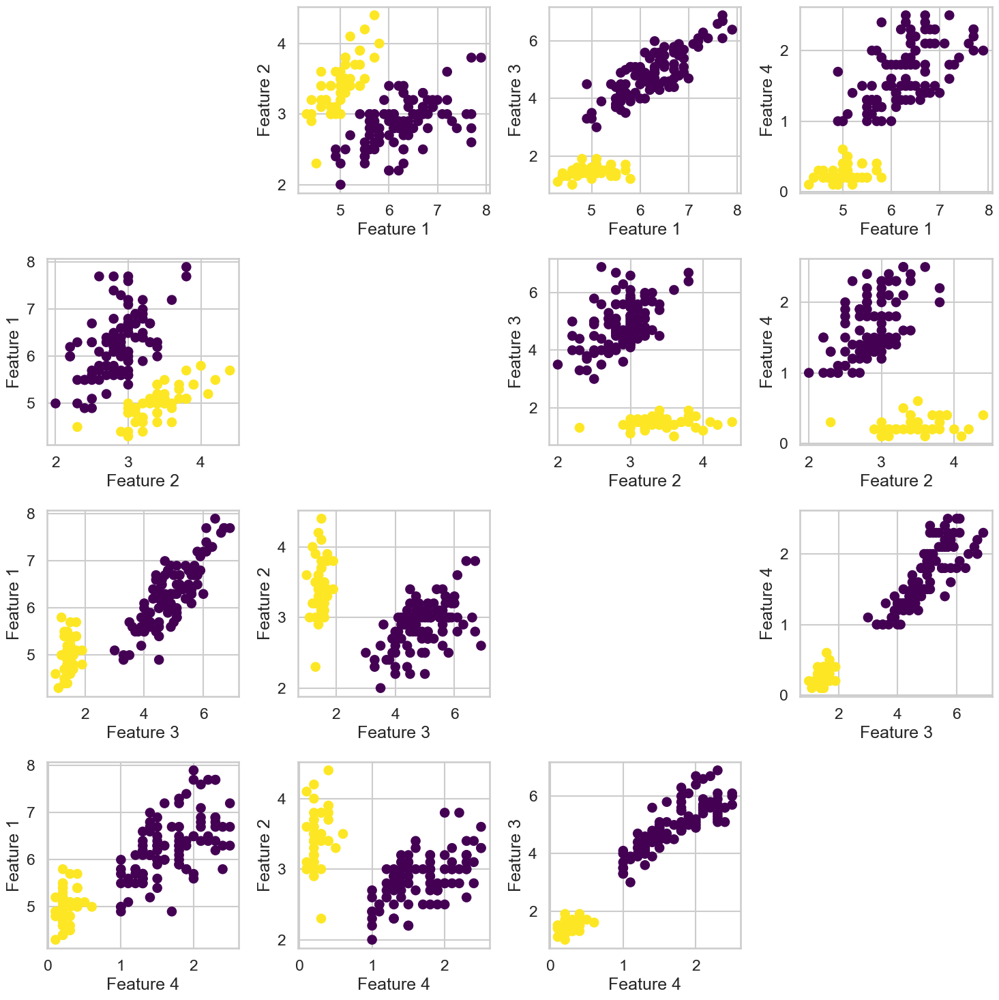

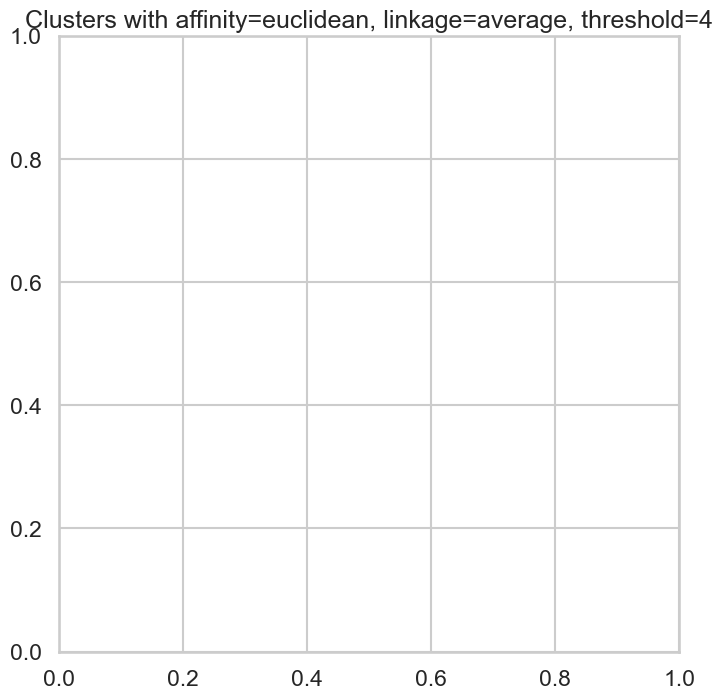

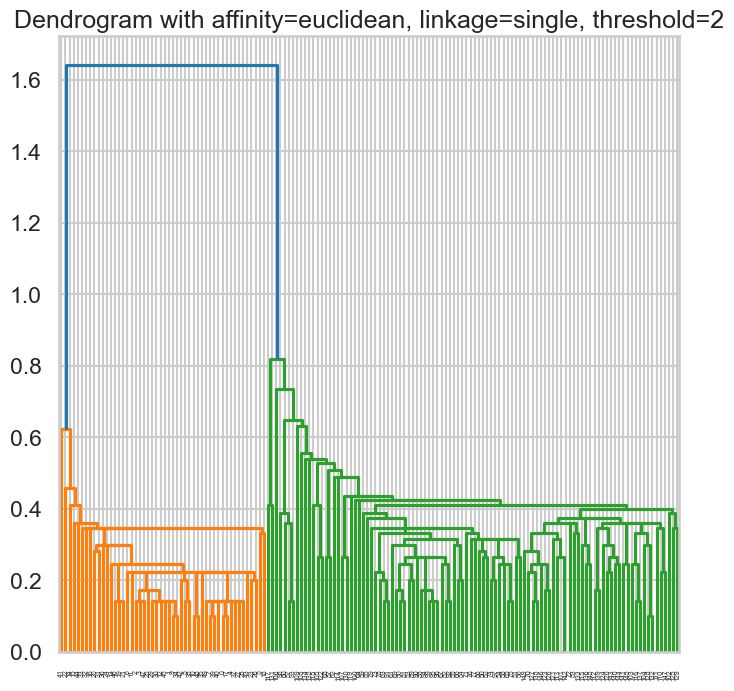

<Figure size 800x800 with 0 Axes>

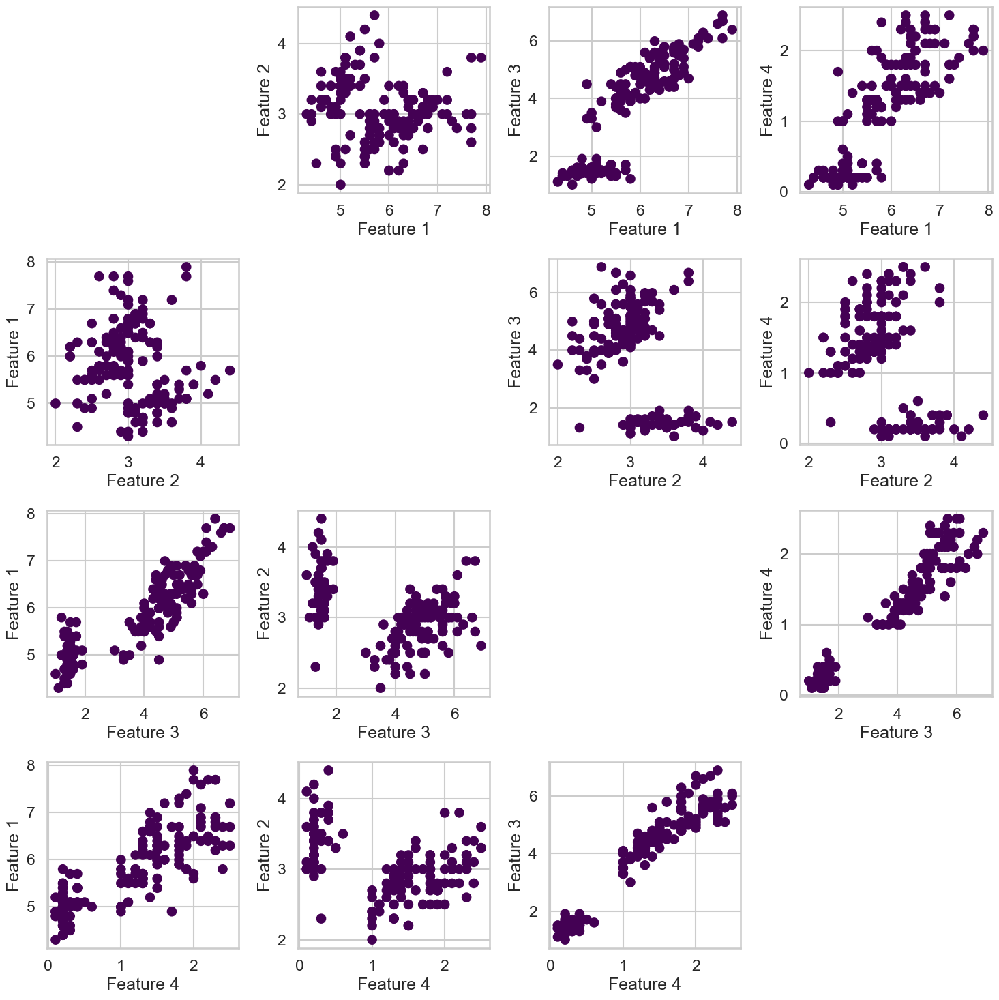

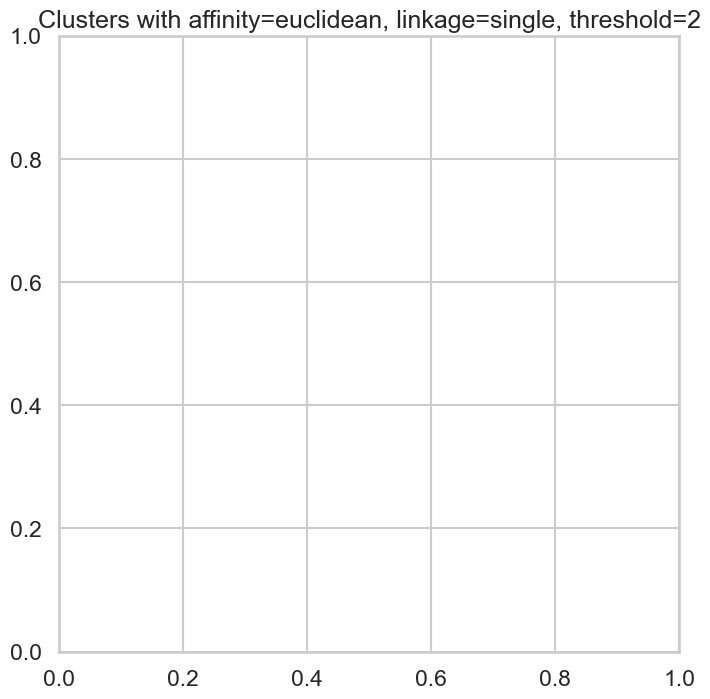

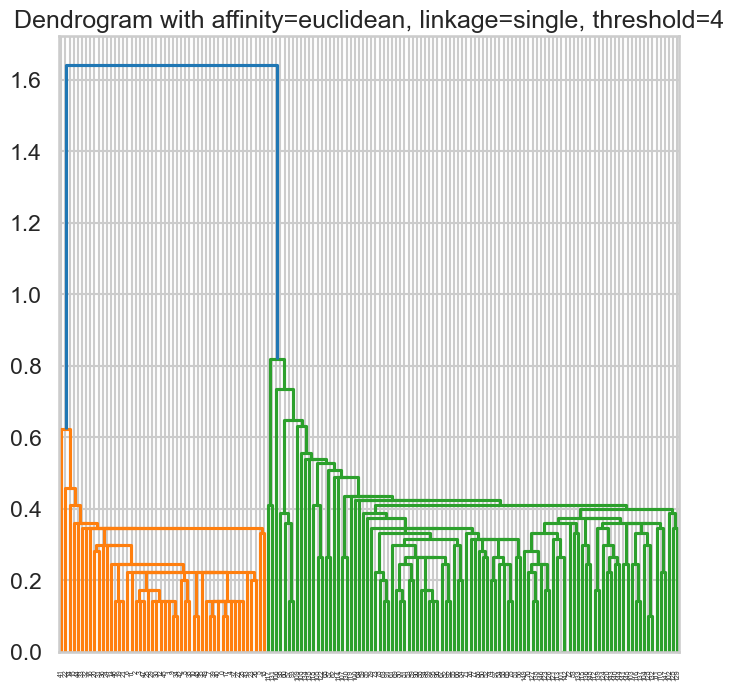

<Figure size 800x800 with 0 Axes>

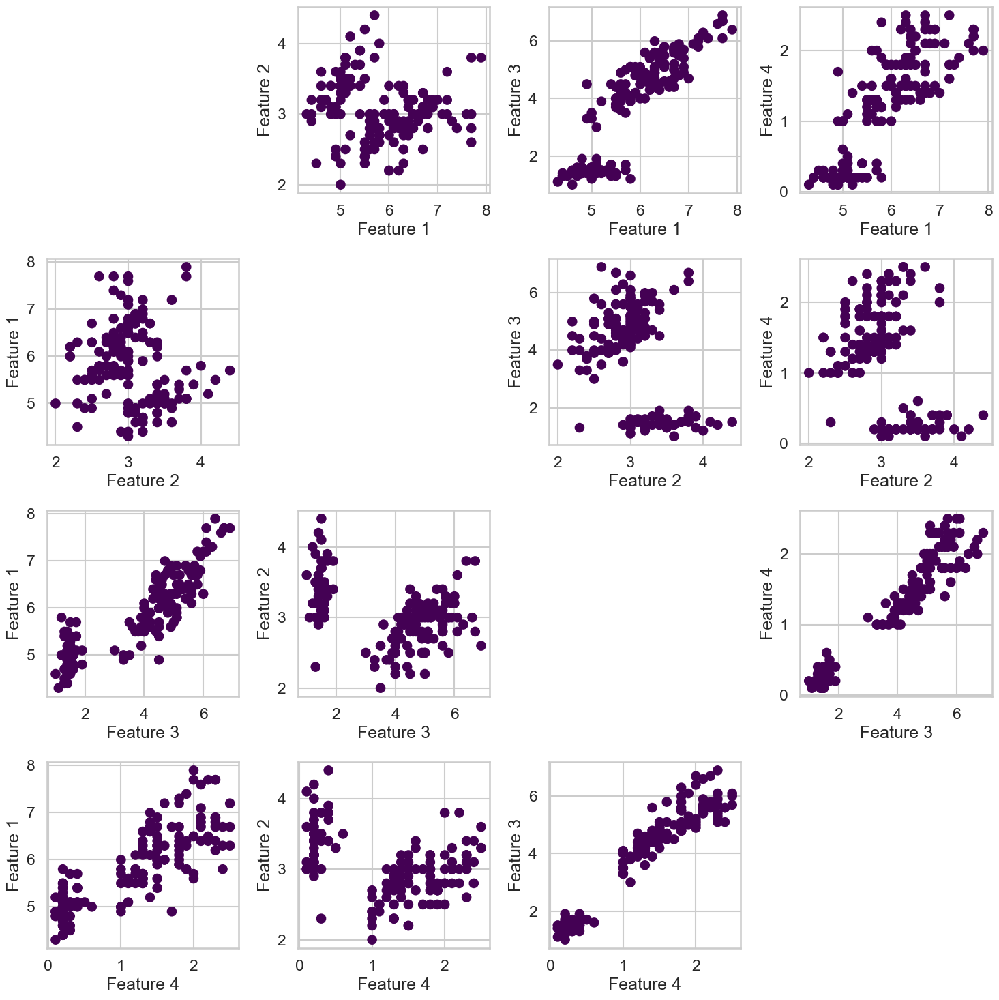

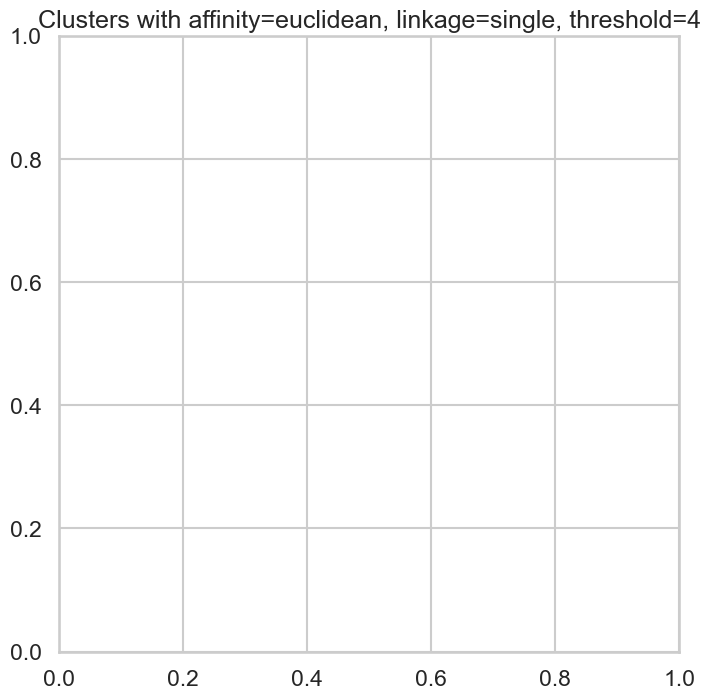

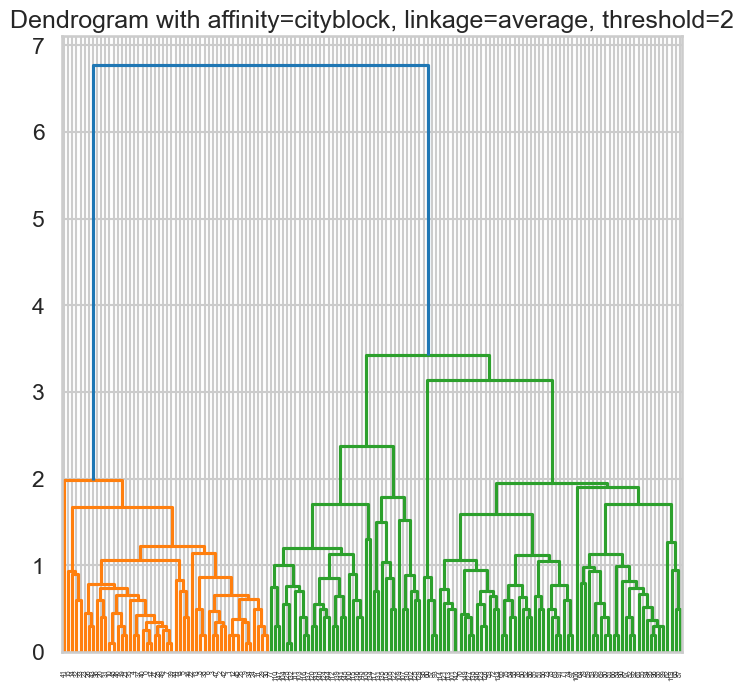

<Figure size 800x800 with 0 Axes>

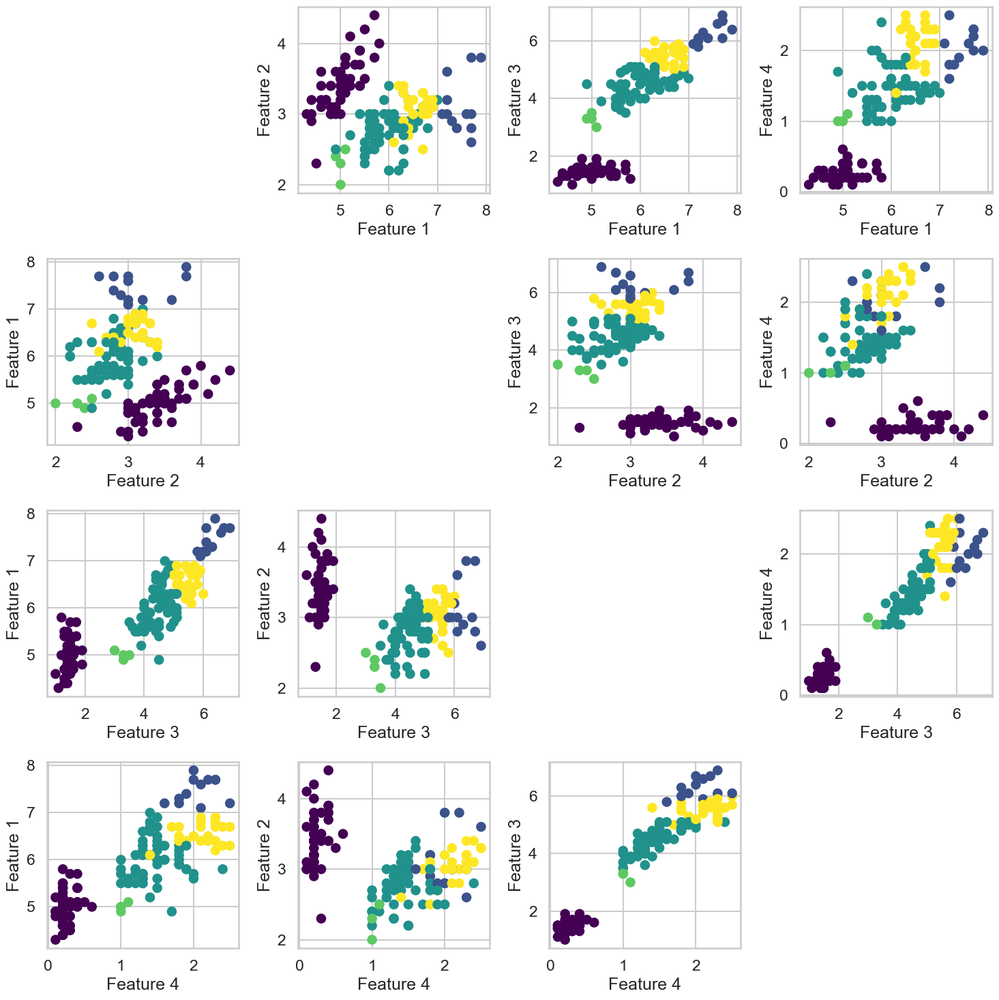

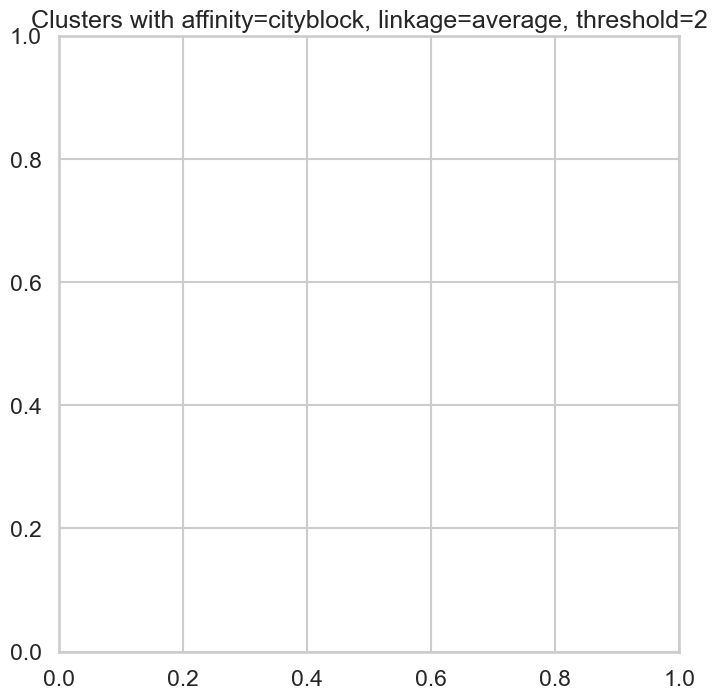

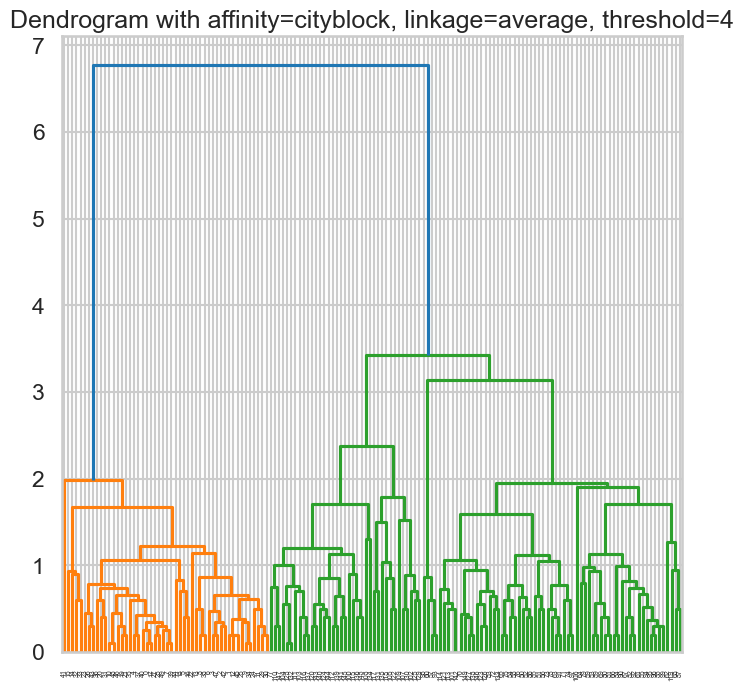

<Figure size 800x800 with 0 Axes>

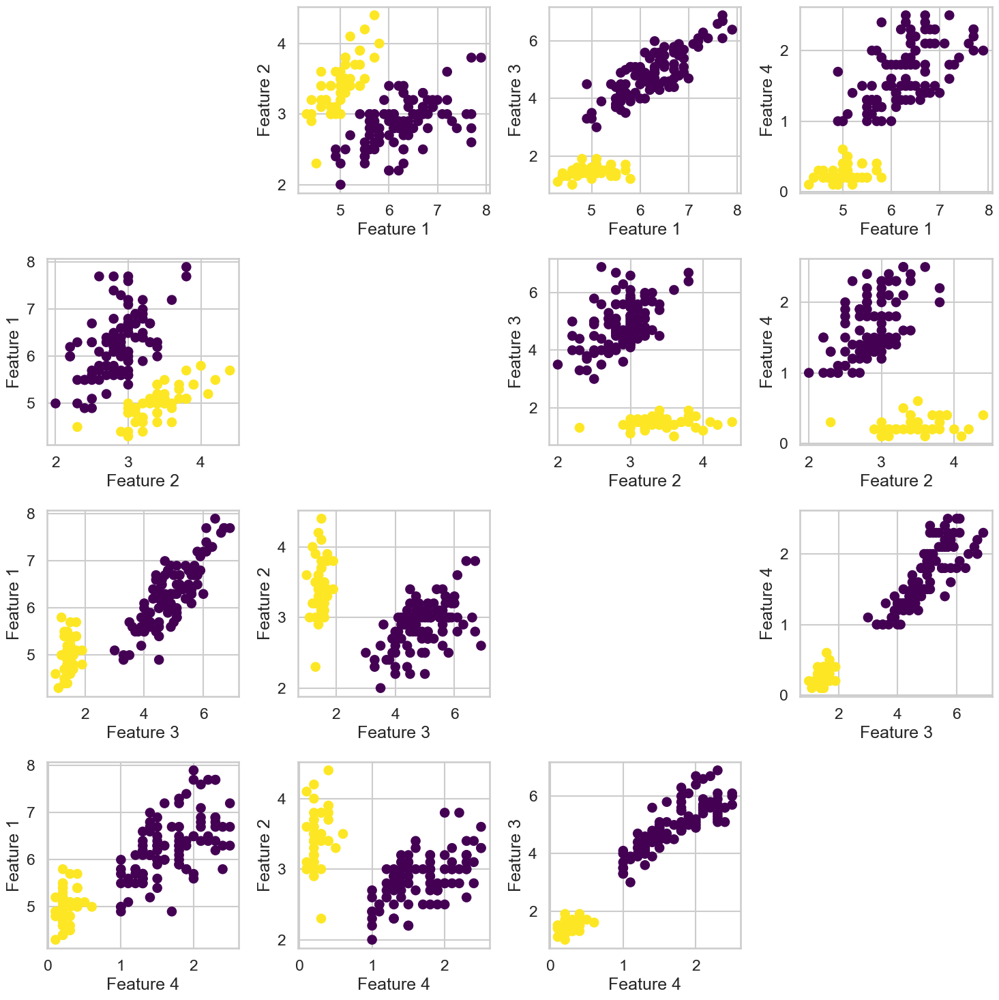

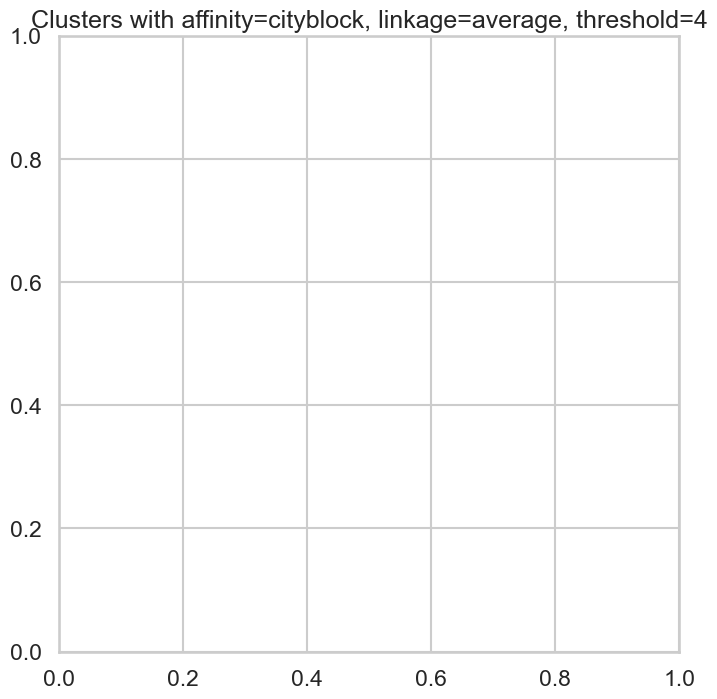

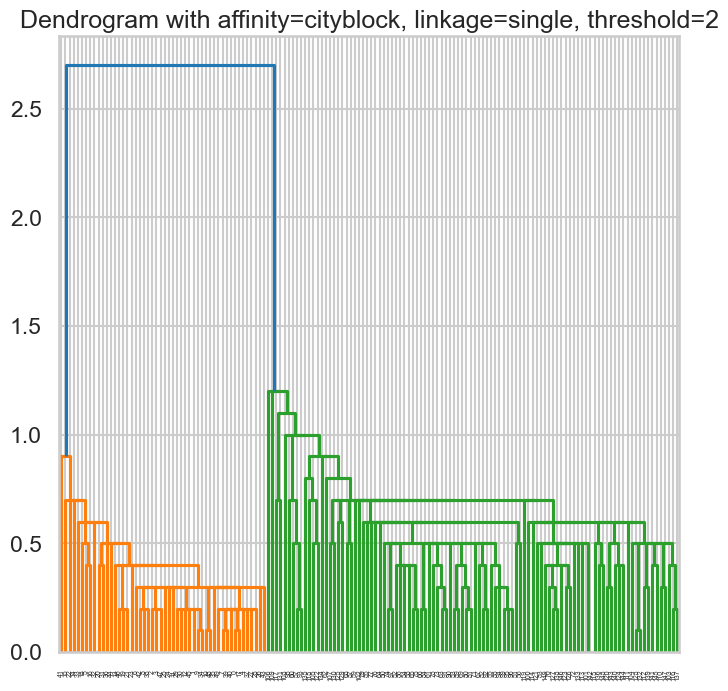

<Figure size 800x800 with 0 Axes>

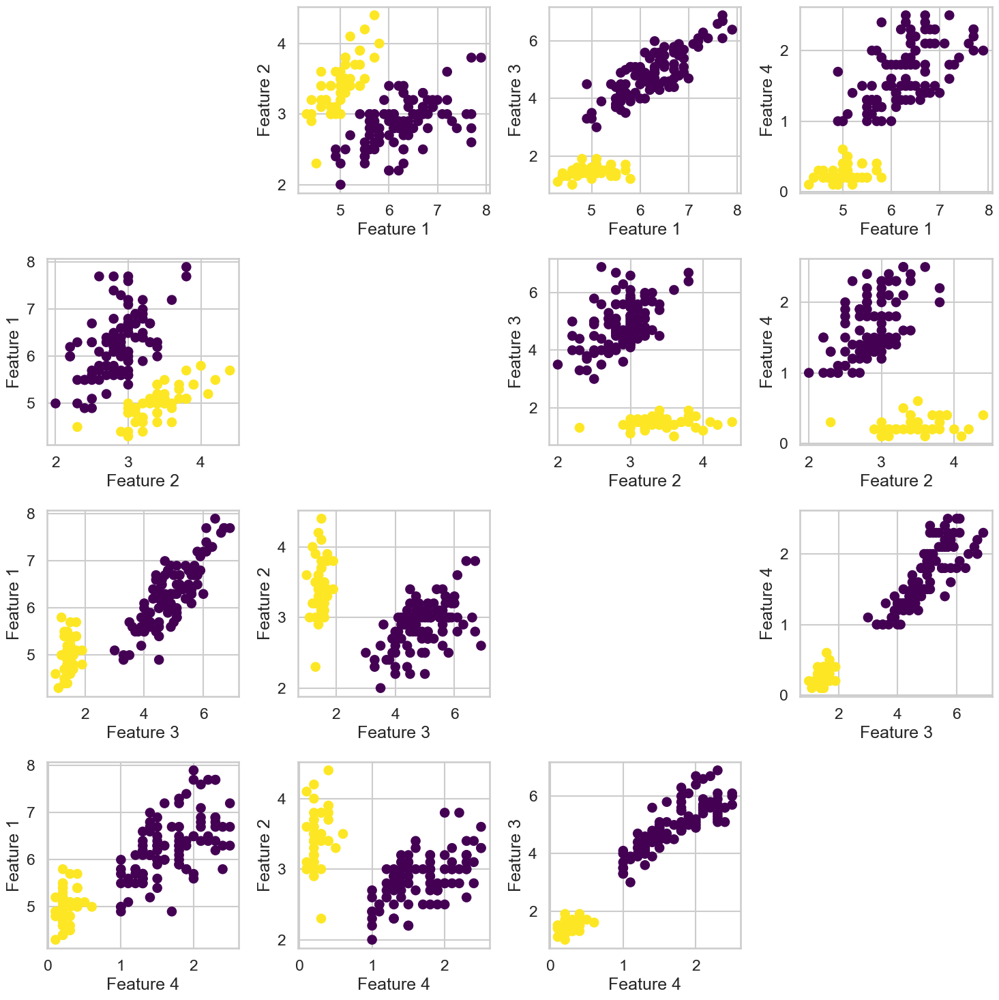

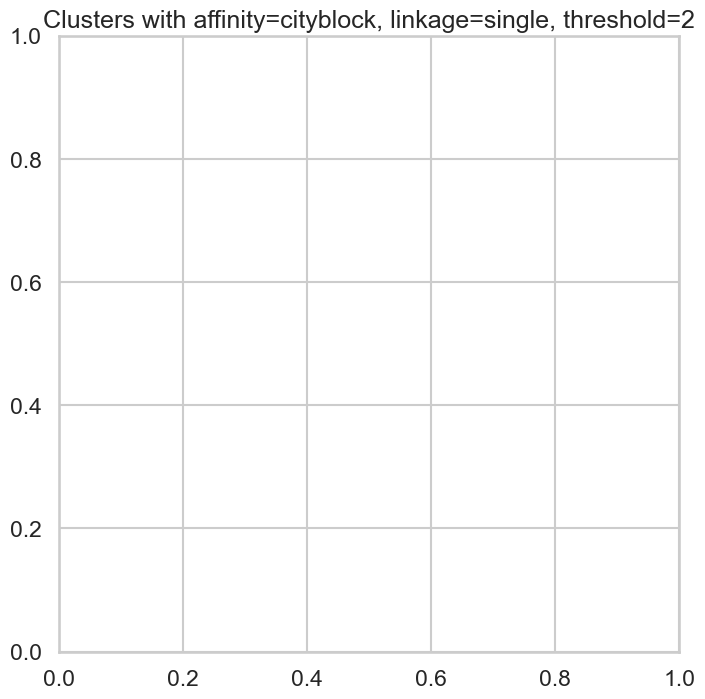

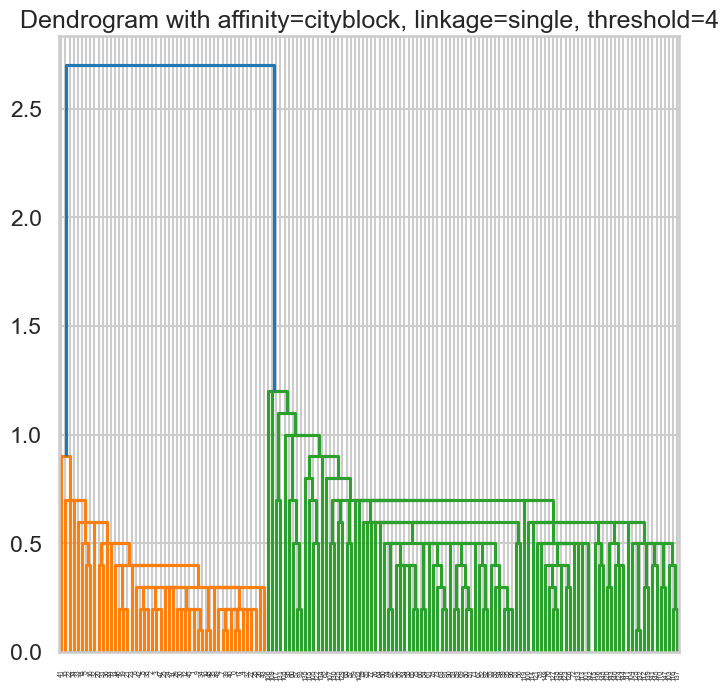

<Figure size 800x800 with 0 Axes>

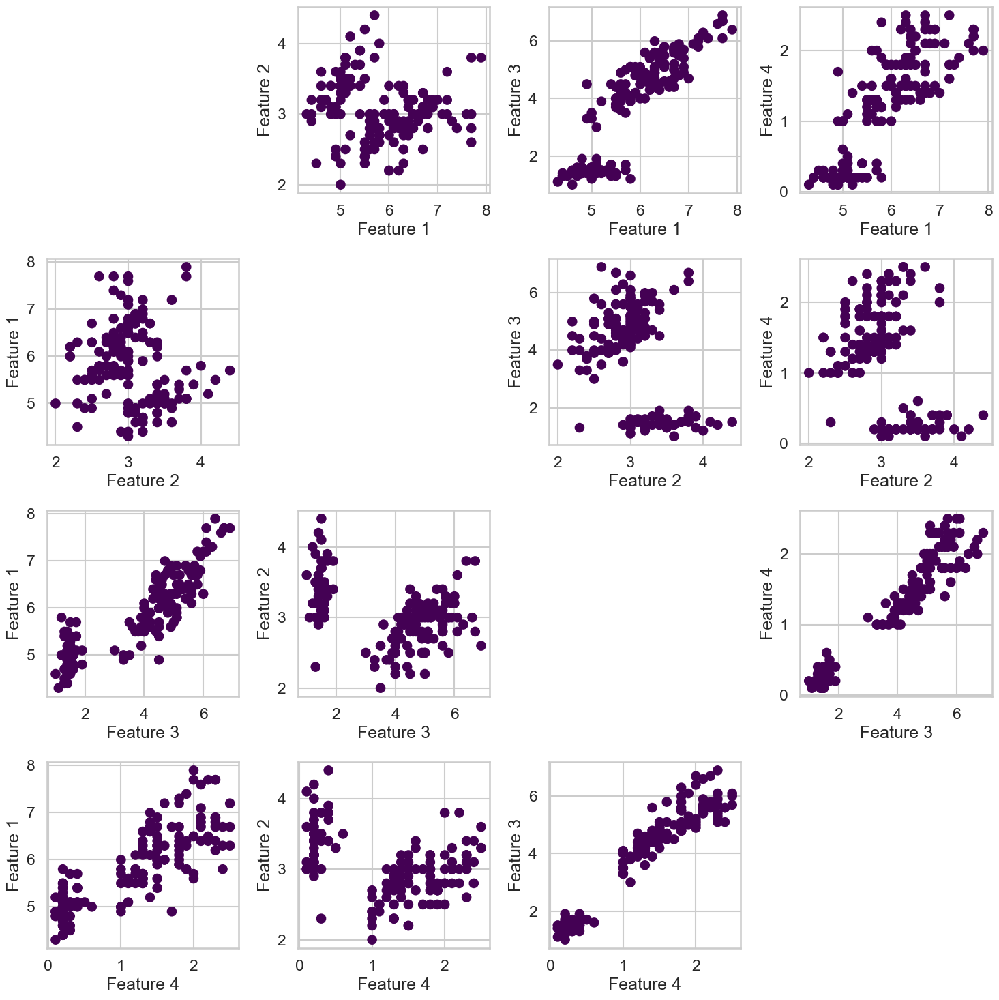

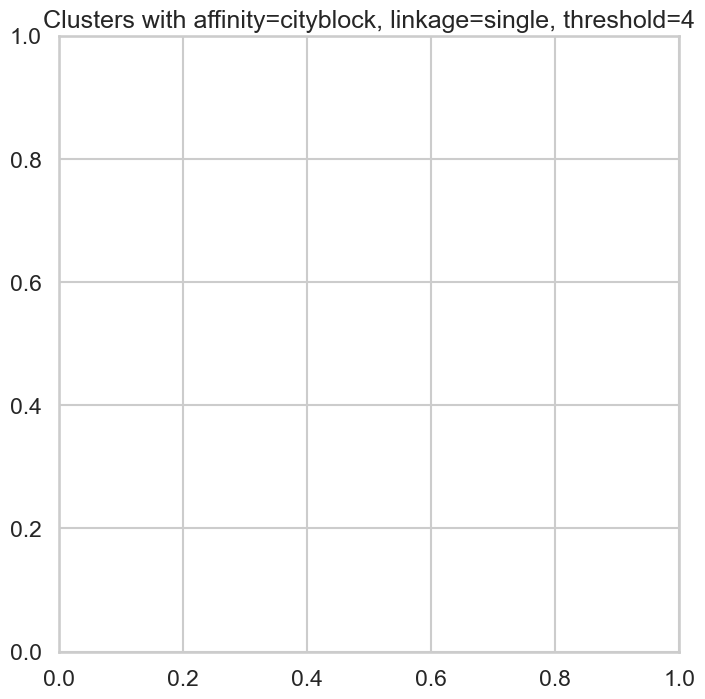

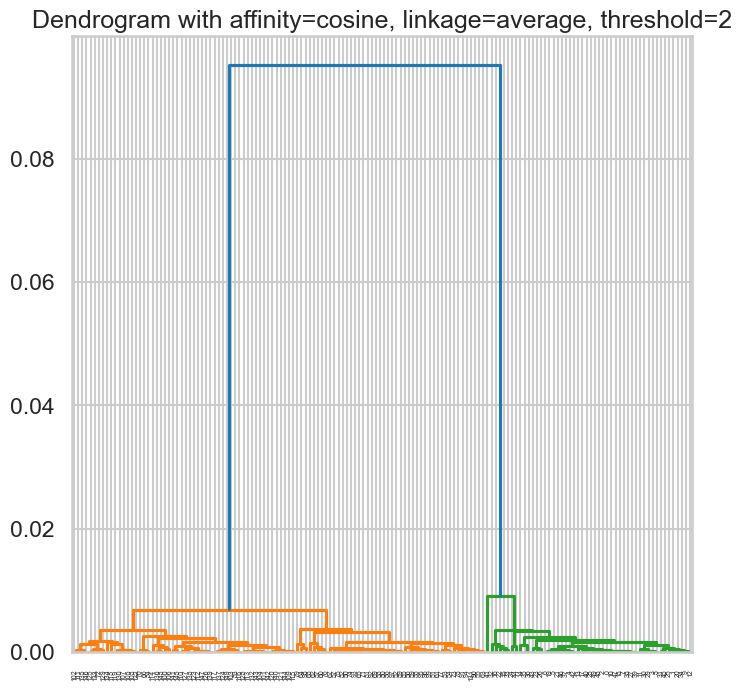

<Figure size 800x800 with 0 Axes>

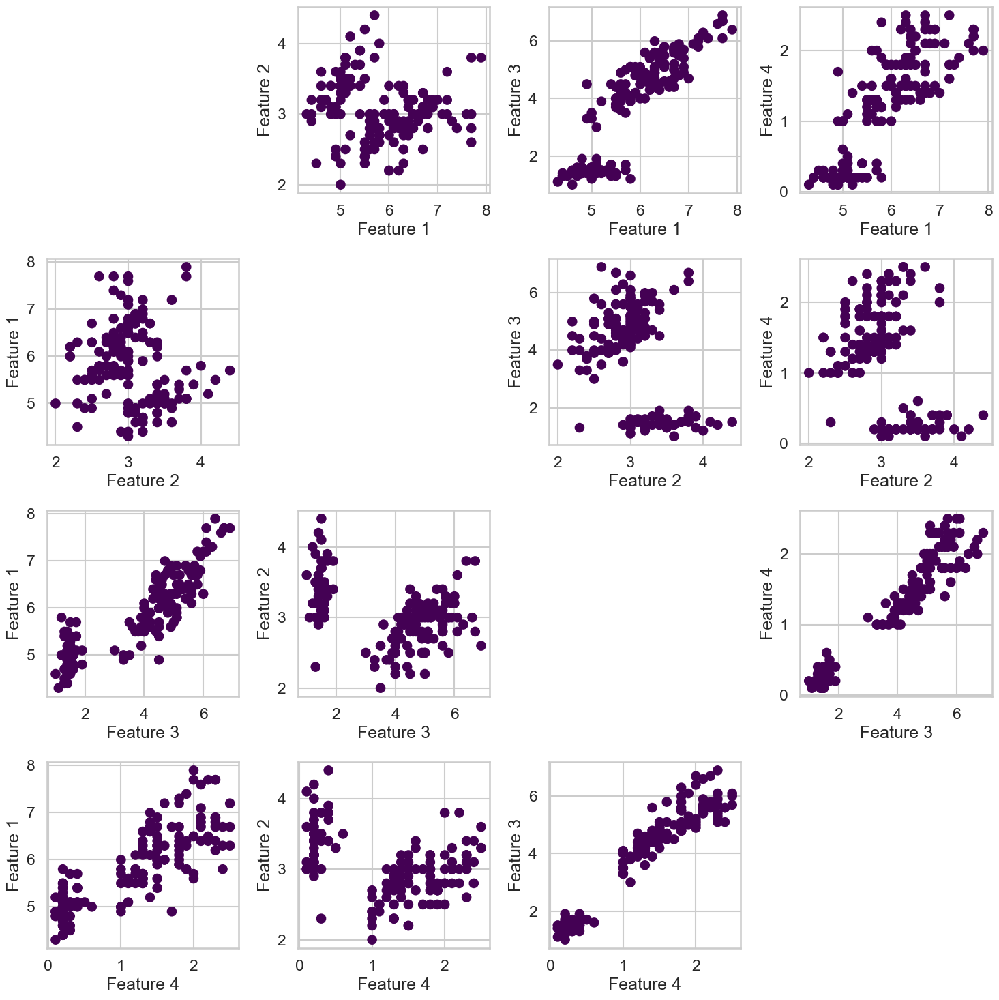

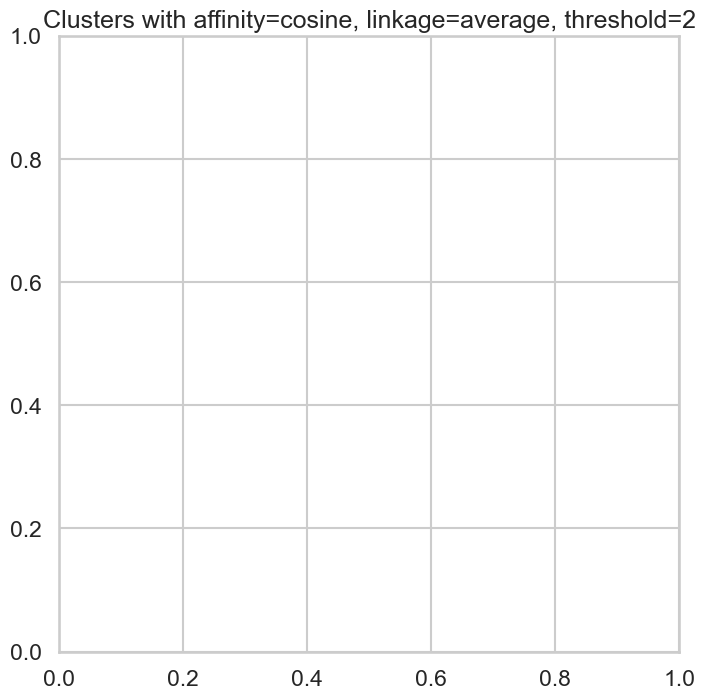

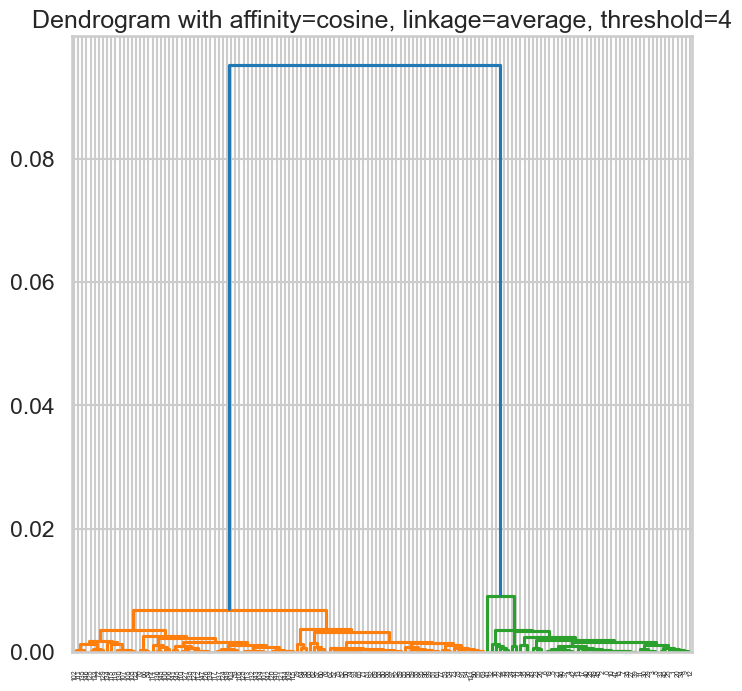

<Figure size 800x800 with 0 Axes>

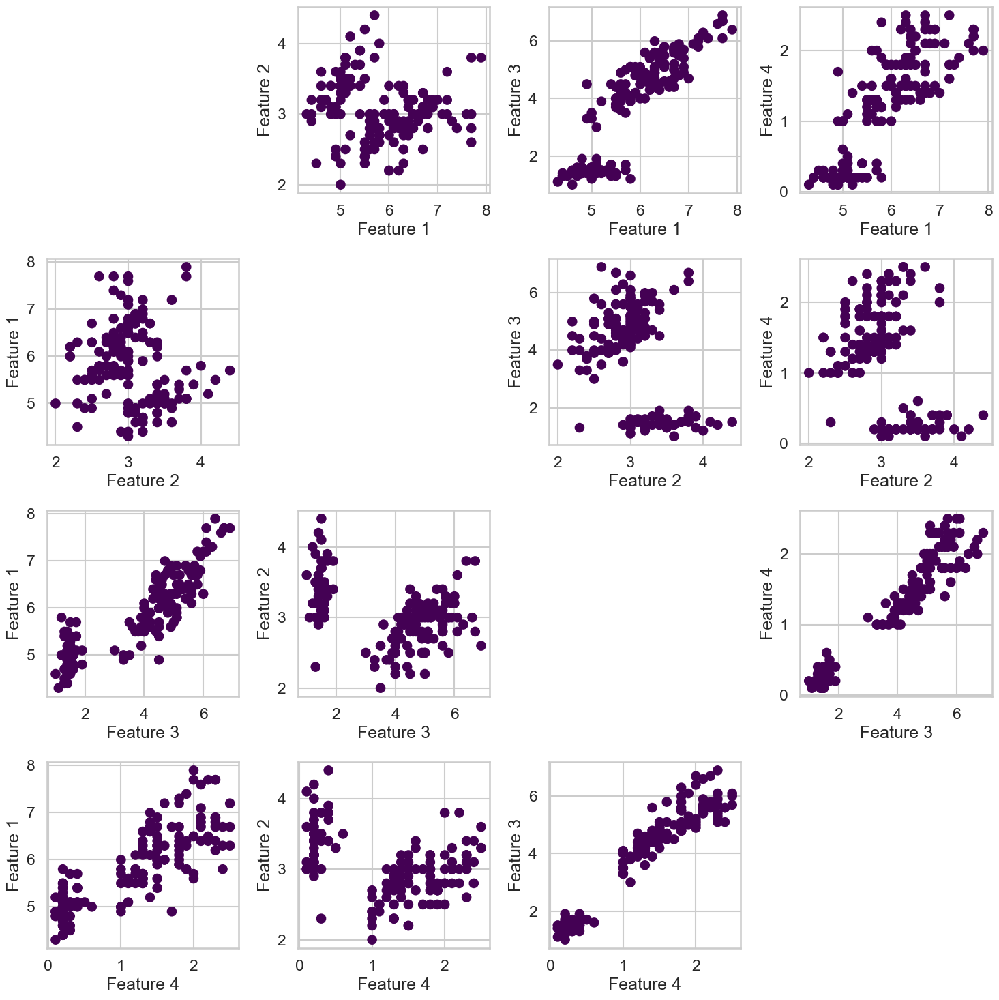

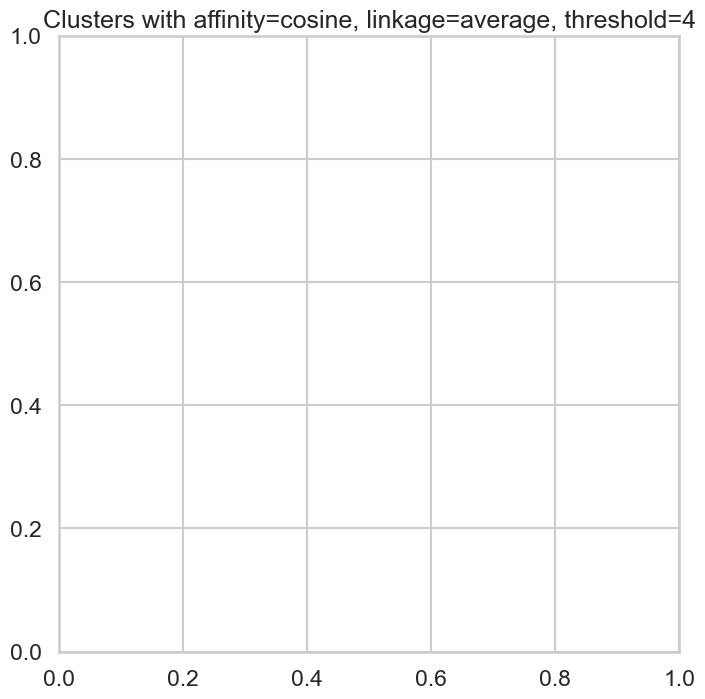

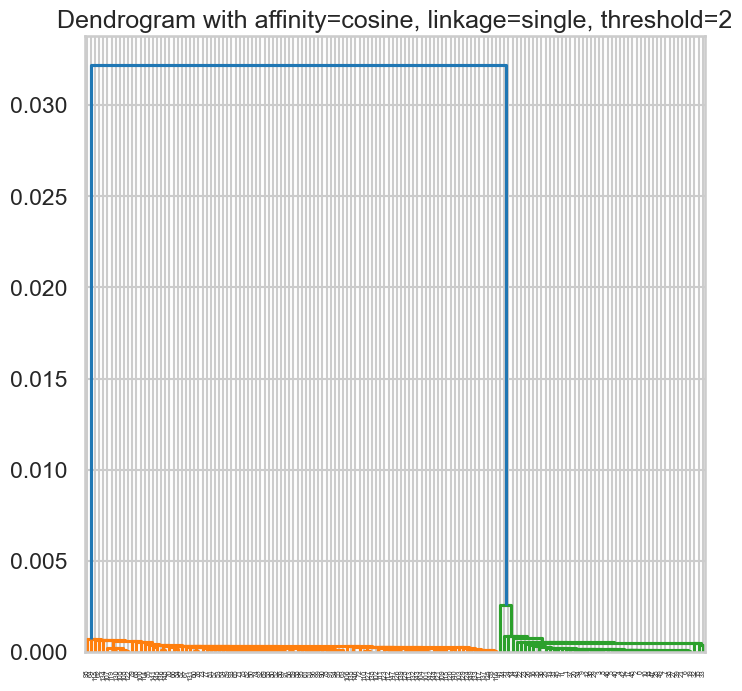

<Figure size 800x800 with 0 Axes>

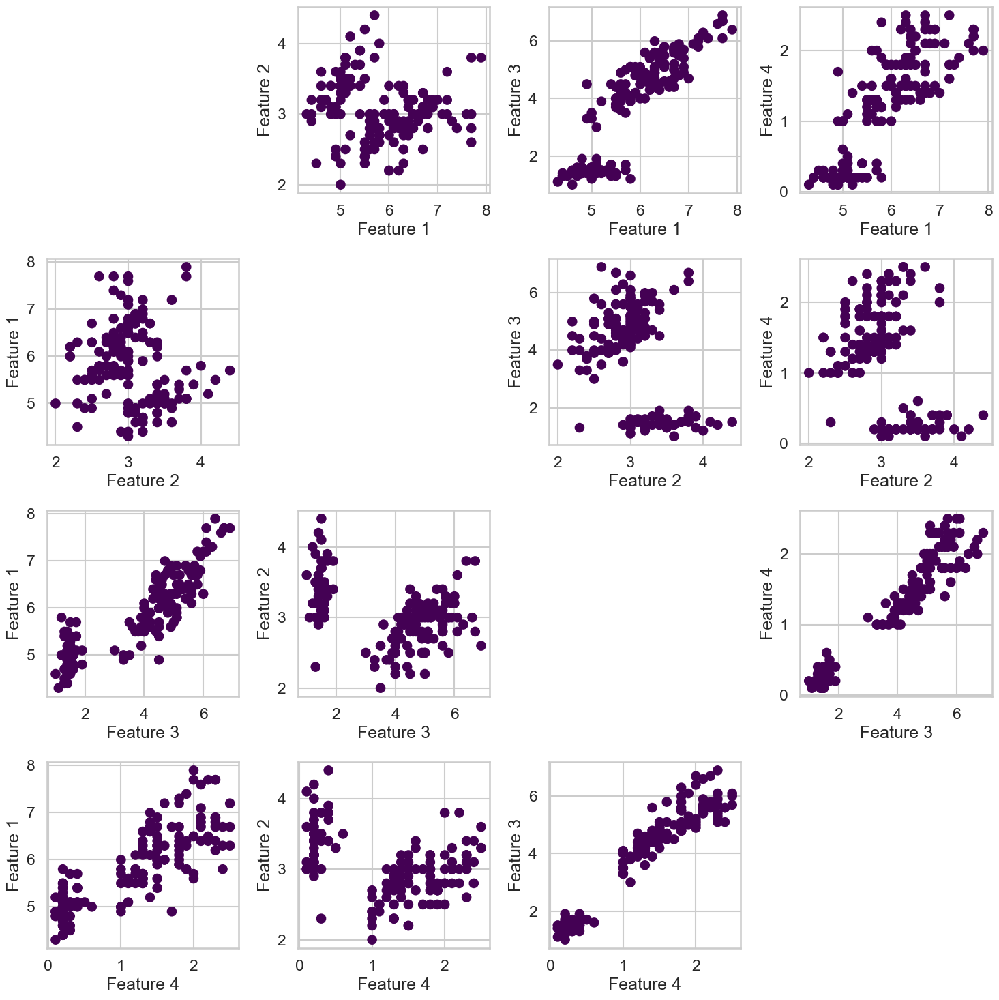

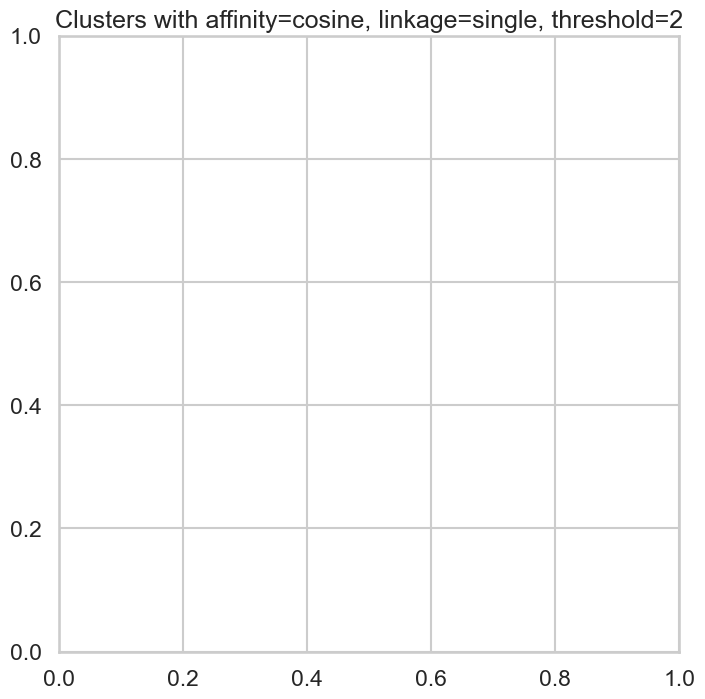

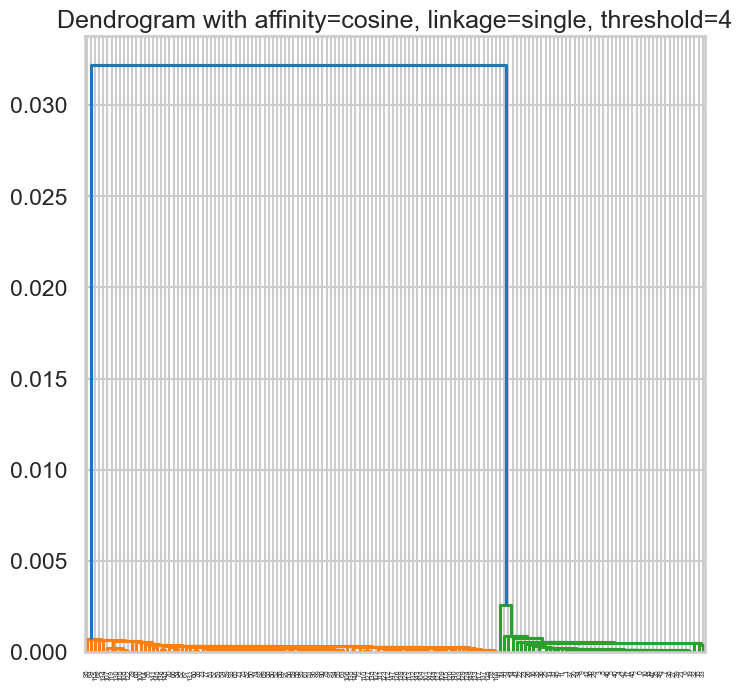

<Figure size 800x800 with 0 Axes>

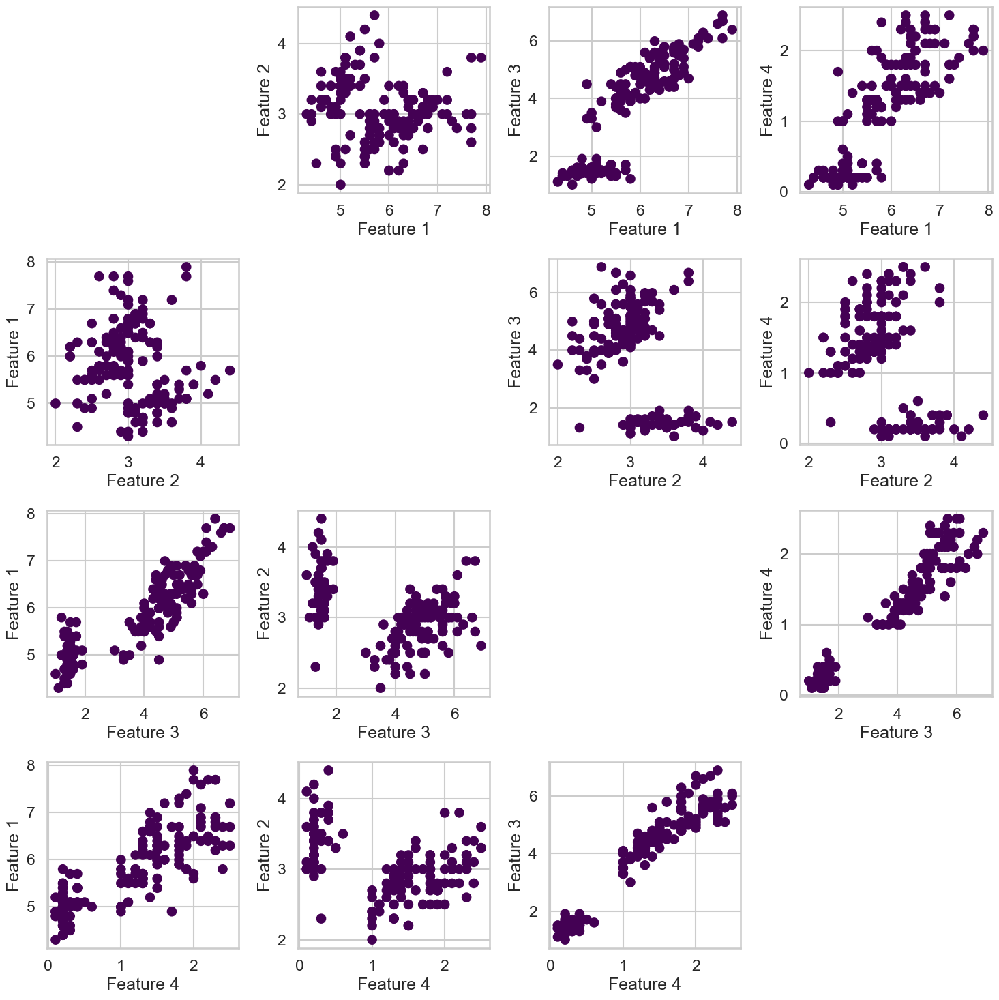

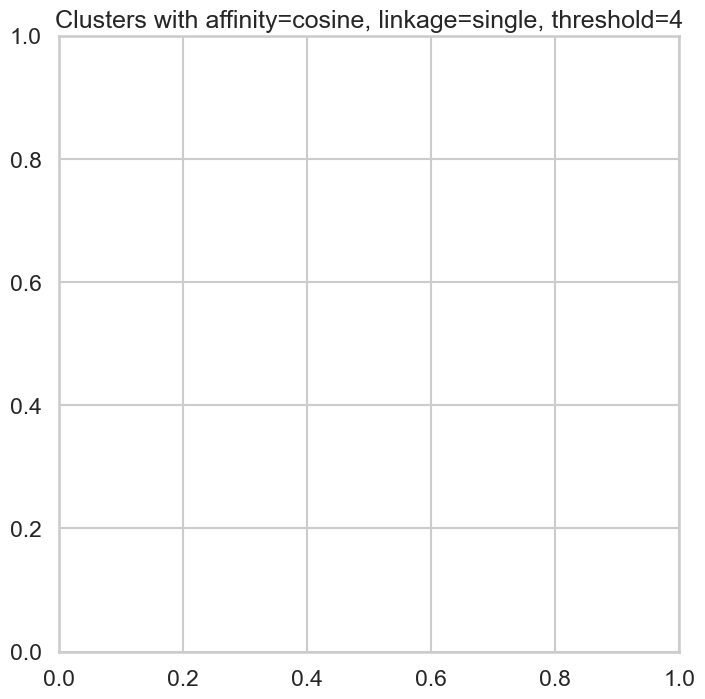

Best silhouette score: 0.6867350732769777 with params: ('euclidean', 'average', 2)


In [14]:
from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.metrics import silhouette_score
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.datasets import load_iris

def display_cluster_new(data, model):
    num_features = data.shape[1]
    fig, axs = plt.subplots(num_features, num_features, figsize=(15, 15))
    for i in range(num_features):
        for j in range(num_features):
            if i != j:
                axs[i, j].scatter(data[:, i], data[:, j], c=model.labels_, cmap='viridis')
                axs[i, j].set_xlabel(f'Feature {i+1}')
                axs[i, j].set_ylabel(f'Feature {j+1}')
            else:
                axs[i, j].axis('off')
    plt.tight_layout()
    plt.show()


plt.rcParams['figure.figsize'] = [8, 8]
sns.set_style("whitegrid")
sns.set_context("talk")

iris_data = load_iris()
X = iris_data.data

affinities = ['euclidean', 'cityblock', 'cosine']
linkages = ['average', 'single']
distance_thresholds = [2, 4]

best_silhouette_score = -1
best_params = None

for affinity in affinities:
    for linkage_method in linkages:
        for threshold in distance_thresholds:
            model = AgglomerativeClustering(n_clusters=None, affinity=affinity, linkage=linkage_method, distance_threshold=threshold)
            cluster_labels = model.fit_predict(X)
            if len(set(cluster_labels)) > 1:  # Check if there is more than one cluster
                silhouette_avg = silhouette_score(X, cluster_labels)
                if silhouette_avg > best_silhouette_score:
                    best_silhouette_score = silhouette_avg
                    best_params = (affinity, linkage_method, threshold)

            plt.figure()
            dendrogram(linkage(X, method=linkage_method, metric=affinity))
            plt.title(f"Dendrogram with affinity={affinity}, linkage={linkage_method}, threshold={threshold}")

            plt.figure()
            display_cluster_new(X, model)
            plt.title(f"Clusters with affinity={affinity}, linkage={linkage_method}, threshold={threshold}")
            plt.show()

print(f"Best silhouette score: {best_silhouette_score} with params: {best_params}")


<h1>DBscan</h1>

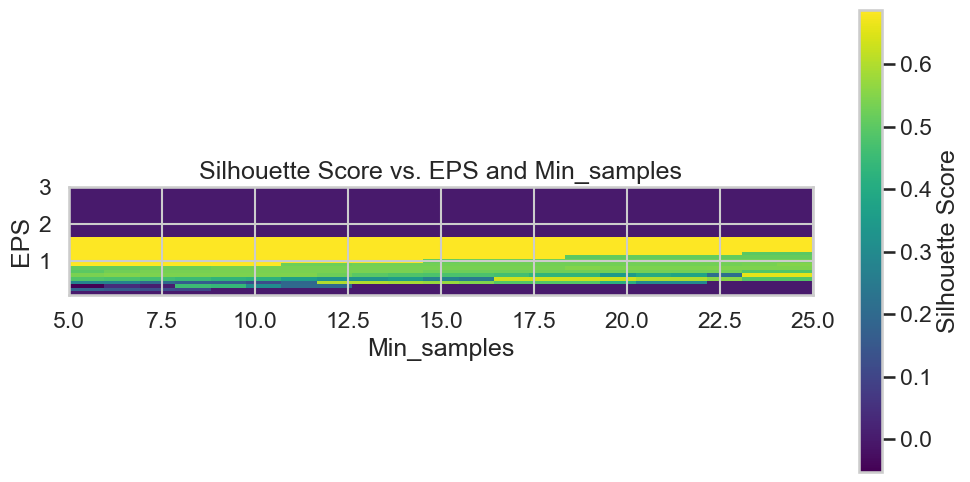

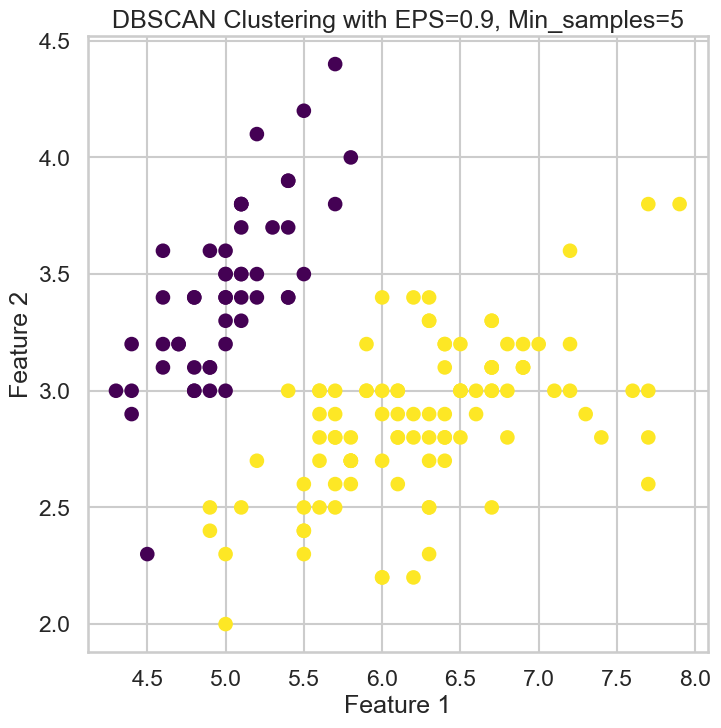

Best Silhouette Score: 0.6867350732769777
Best EPS: 0.9, Best Min_samples: 5


In [14]:
iris_data = load_iris()
X = iris_data.data

eps_range = np.arange(0.1, 3.1, 0.1)
min_samples_range = range(5, 26)
silhouette_scores = np.zeros((len(eps_range), len(min_samples_range)))

for i, eps in enumerate(eps_range):
    for j, min_samples in enumerate(min_samples_range):
        dbscan = DBSCAN(eps=eps, min_samples=min_samples)
        cluster_labels = dbscan.fit_predict(X)
        if len(np.unique(cluster_labels)) > 1:  # Check if more than one cluster (excluding noise) is found
            silhouette_scores[i, j] = silhouette_score(X, cluster_labels)

plt.figure(figsize=(12, 6))
plt.imshow(silhouette_scores, cmap='viridis', origin='lower', extent=[5, 25, 0.1, 3])
plt.colorbar(label='Silhouette Score')
plt.xlabel('Min_samples')
plt.ylabel('EPS')
plt.title('Silhouette Score vs. EPS and Min_samples')
plt.show()

best_eps, best_min_samples = np.unravel_index(np.argmax(silhouette_scores), silhouette_scores.shape)
best_dbscan = DBSCAN(eps=eps_range[best_eps], min_samples=min_samples_range[best_min_samples])
best_cluster_labels = best_dbscan.fit_predict(X)

plt.figure(figsize=(8, 8))
plt.scatter(X[:, 0], X[:, 1], c=best_cluster_labels, cmap='viridis')
plt.xlabel('Feature 1')
plt.ylabel('Feature 2')
plt.title(f'DBSCAN Clustering with EPS={eps_range[best_eps]}, Min_samples={min_samples_range[best_min_samples]}')
plt.show()

best_score = silhouette_scores[best_eps, best_min_samples]
print(f"Best Silhouette Score: {best_score}")
print(f"Best EPS: {eps_range[best_eps]}, Best Min_samples: {min_samples_range[best_min_samples]}")


<h1>All pairs using DBscan</h1>

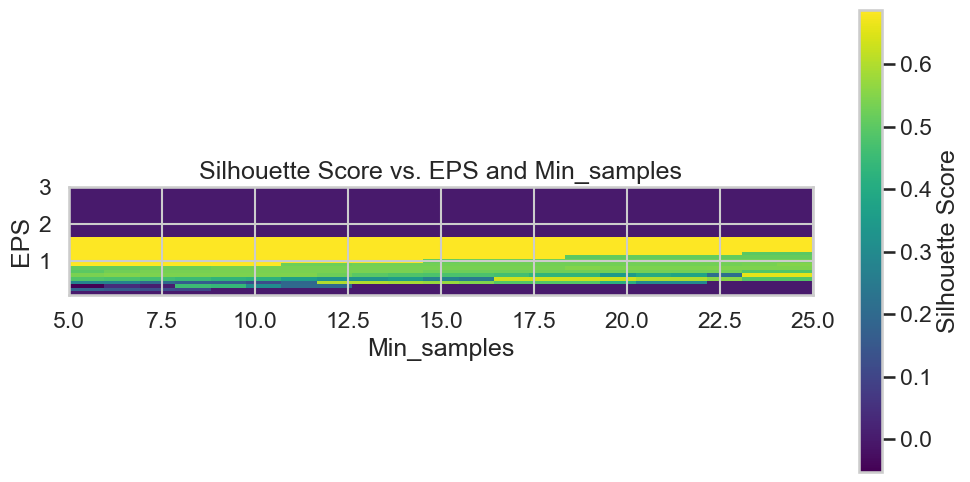

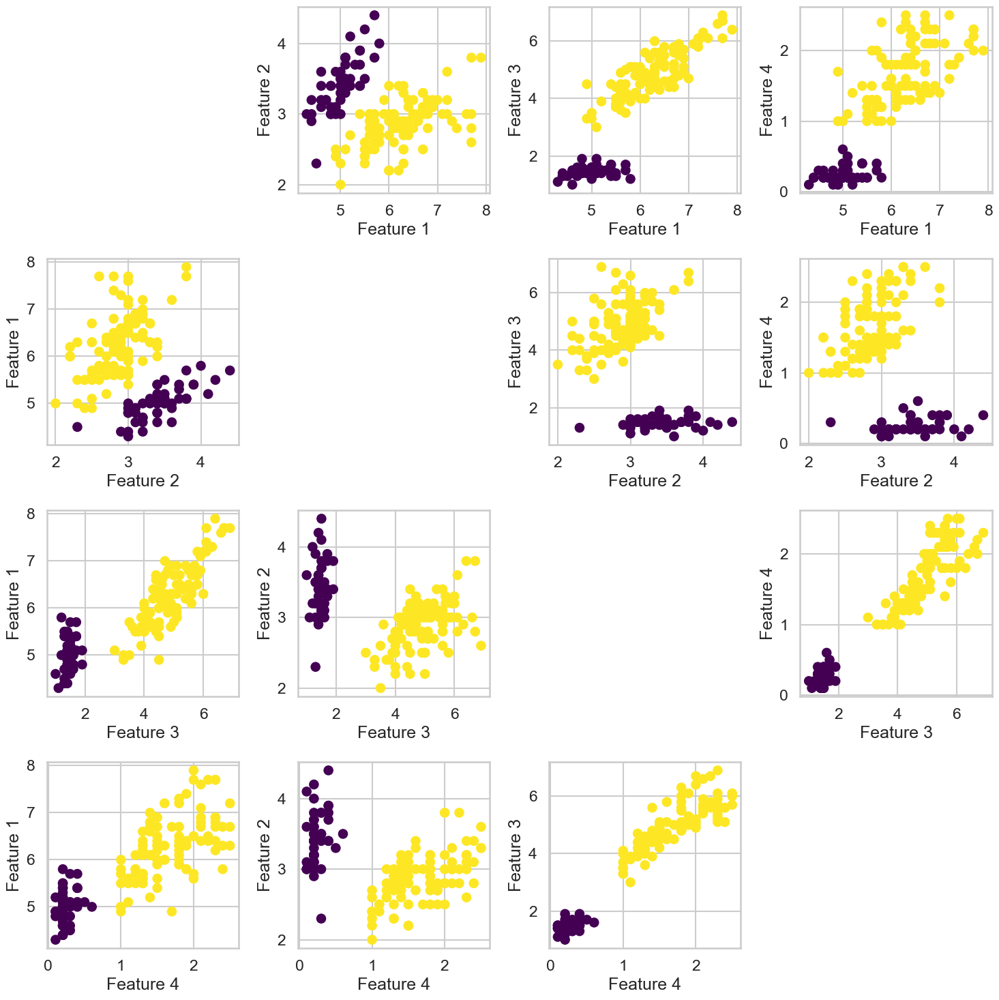

Best Silhouette Score: 0.6867350732769777
Best EPS: 0.9, Best Min_samples: 5


In [18]:
from sklearn.cluster import DBSCAN
from sklearn.metrics import silhouette_score
import matplotlib.pyplot as plt
from sklearn.datasets import load_iris
import numpy as np

iris_data = load_iris()
X = iris_data.data

eps_range = np.arange(0.1, 3.1, 0.1)
min_samples_range = range(5, 26)
silhouette_scores = np.zeros((len(eps_range), len(min_samples_range)))

for i, eps in enumerate(eps_range):
    for j, min_samples in enumerate(min_samples_range):
        dbscan = DBSCAN(eps=eps, min_samples=min_samples)
        cluster_labels = dbscan.fit_predict(X)
        if len(np.unique(cluster_labels)) > 1:  # Check if more than one cluster (excluding noise) is found
            silhouette_scores[i, j] = silhouette_score(X, cluster_labels)

plt.figure(figsize=(12, 6))
plt.imshow(silhouette_scores, cmap='viridis', origin='lower', extent=[5, 25, 0.1, 3])
plt.colorbar(label='Silhouette Score')
plt.xlabel('Min_samples')
plt.ylabel('EPS')
plt.title('Silhouette Score vs. EPS and Min_samples')
plt.show()

best_eps, best_min_samples = np.unravel_index(np.argmax(silhouette_scores), silhouette_scores.shape)
best_dbscan = DBSCAN(eps=eps_range[best_eps], min_samples=min_samples_range[best_min_samples])
best_cluster_labels = best_dbscan.fit_predict(X)

# Plot all pairs of features
num_features = X.shape[1]
fig, axs = plt.subplots(num_features, num_features, figsize=(15, 15))
for i in range(num_features):
    for j in range(num_features):
        if i != j:
            axs[i, j].scatter(X[:, i], X[:, j], c=best_cluster_labels, cmap='viridis')
            axs[i, j].set_xlabel(f'Feature {i+1}')
            axs[i, j].set_ylabel(f'Feature {j+1}')
        else:
            axs[i, j].axis('off')
plt.tight_layout()
plt.show()

best_score = silhouette_scores[best_eps, best_min_samples]
print(f"Best Silhouette Score: {best_score}")
print(f"Best EPS: {eps_range[best_eps]}, Best Min_samples: {min_samples_range[best_min_samples]}")


<h1>Gaussian</h1>

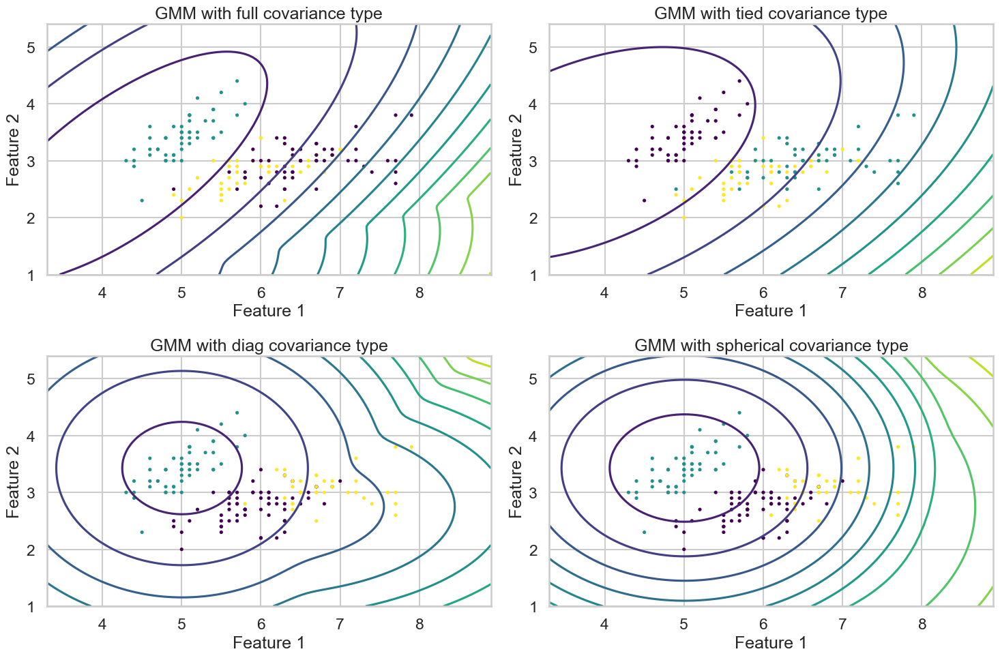

In [16]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.mixture import GaussianMixture
from sklearn.datasets import load_iris


iris_data = load_iris()
X = iris_data.data


n_components = 3  # Assuming 3 clusters for Iris dataset
covariance_types = ['full', 'tied', 'diag', 'spherical']
plt.figure(figsize=(15, 10))
for i, covariance_type in enumerate(covariance_types):
    gmm = GaussianMixture(n_components=n_components, covariance_type=covariance_type)
    gmm.fit(X)
    
    # Create a meshgrid to plot the distributions
    x_min, x_max = X[:, 0].min() - 1, X[:, 0].max() + 1
    y_min, y_max = X[:, 1].min() - 1, X[:, 1].max() + 1
    x = np.linspace(x_min, x_max, 100)
    y = np.linspace(y_min, y_max, 100)
    X_mesh, Y_mesh = np.meshgrid(x, y)
    XX = np.array([X_mesh.ravel(), Y_mesh.ravel(), np.zeros_like(X_mesh.ravel()), np.zeros_like(X_mesh.ravel())]).T
    Z = -gmm.score_samples(XX)
    Z = Z.reshape(X_mesh.shape)
    
    
    plt.subplot(2, 2, i+1)
    plt.scatter(X[:, 0], X[:, 1], c=gmm.predict(X), cmap='viridis', s=5)
    plt.contour(X_mesh, Y_mesh, Z, levels=10, cmap='viridis')
    plt.title(f'GMM with {covariance_type} covariance type')
    plt.xlabel('Feature 1')
    plt.ylabel('Feature 2')

plt.tight_layout()
plt.show()



<h1>All features with Gaussian</h1>

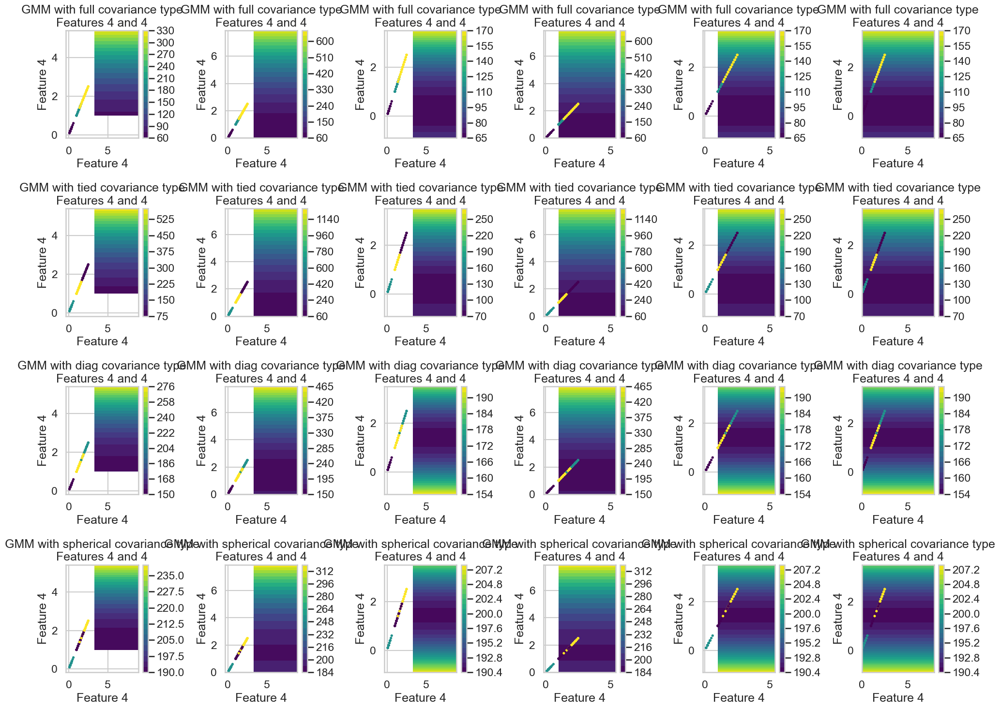

In [118]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.mixture import GaussianMixture

iris_data = load_iris()
X = iris_data.data

# Assuming 3 clusters for the dataset
n_components = 3  
covariance_types = ['full', 'tied', 'diag', 'spherical']
plt.figure(figsize=(20, 15))


for i, covariance_type in enumerate(covariance_types):
    gmm = GaussianMixture(n_components=n_components, covariance_type=covariance_type)
    gmm.fit(X)
    
    # Creating meshgrids for all combinations of features to plot contour maps
    meshgrids = []
    for j in range(X.shape[1]):
        for k in range(j+1, X.shape[1]):
            x_min, x_max = X[:, j].min() - 1, X[:, j].max() + 1
            y_min, y_max = X[:, k].min() - 1, X[:, k].max() + 1
            x = np.linspace(x_min, x_max, 100)
            y = np.linspace(y_min, y_max, 100)
            X_mesh, Y_mesh = np.meshgrid(x, y)
            meshgrids.append((X_mesh, Y_mesh))


    for idx, (X_mesh, Y_mesh) in enumerate(meshgrids):
        plt.subplot(len(covariance_types), len(meshgrids), i*len(meshgrids) + idx + 1)
        if X.shape[1] > 1:
            XX = np.zeros((X_mesh.size, X.shape[1]))
            XX[:, j] = X_mesh.ravel()
            XX[:, k] = Y_mesh.ravel()
            Z = -gmm.score_samples(XX)
            Z = Z.reshape(X_mesh.shape)
            plt.contourf(X_mesh, Y_mesh, Z, levels=20, cmap='viridis')
            plt.colorbar()
            plt.scatter(X[:, j], X[:, k], c=gmm.predict(X), cmap='viridis', s=5)
            plt.title(f'GMM with {covariance_type} covariance type\nFeatures {j+1} and {k+1}')
            plt.xlabel(f'Feature {j+1}')
            plt.ylabel(f'Feature {k+1}')

plt.subplots_adjust(wspace=0.4, hspace=0.4)  # Adjust spacing between subplots
plt.tight_layout()
plt.show()


<h1>Observations on the 4 algorithms before clustering</h1>

**Both the DBscan and the Agglomerative Clustering gave the same silhouette score.**

**However, None of them has actually divided the data into 3 clusters although we have 3 clusters.**

#
<h1>After Normalization</h1>

<h1> KMeans</h>

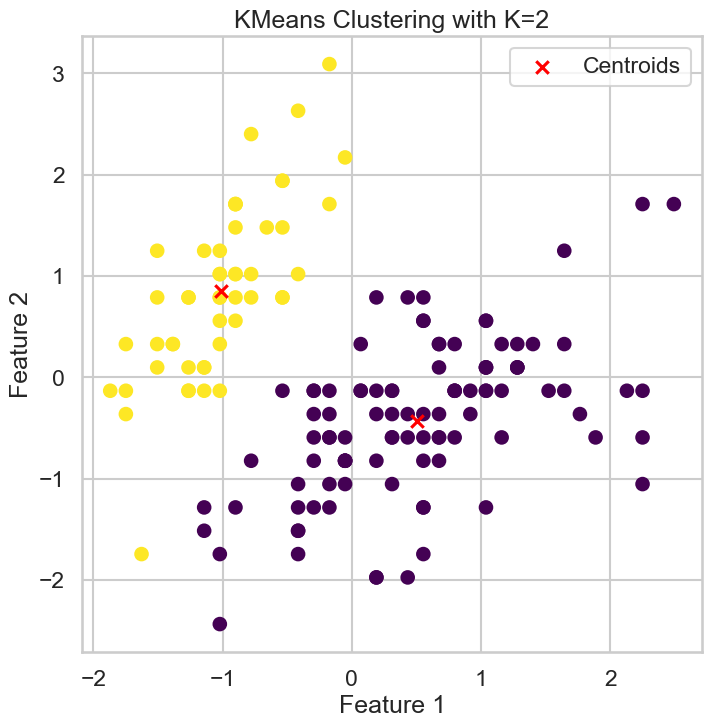

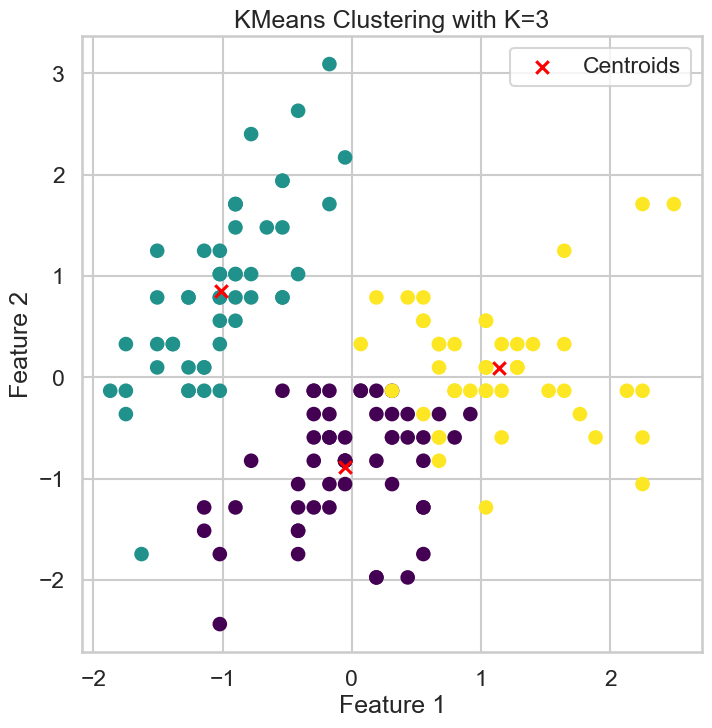

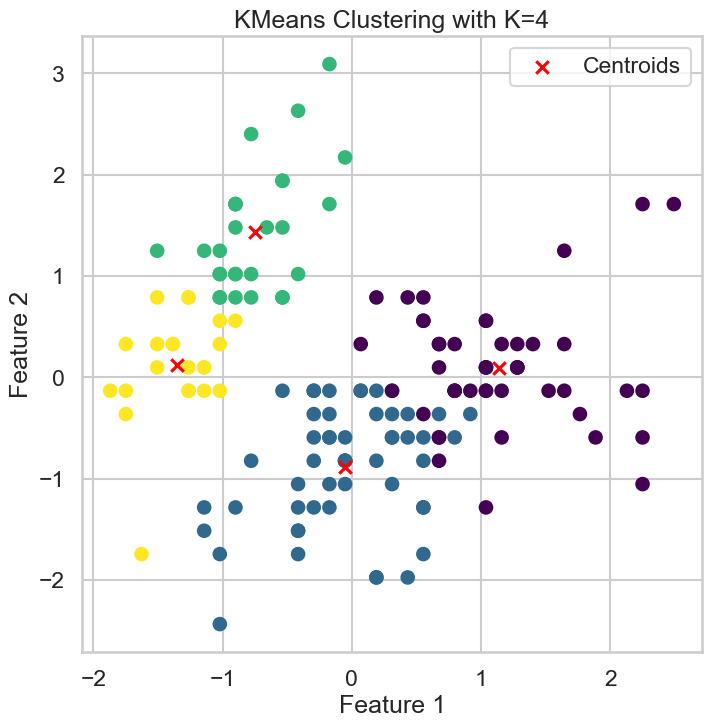

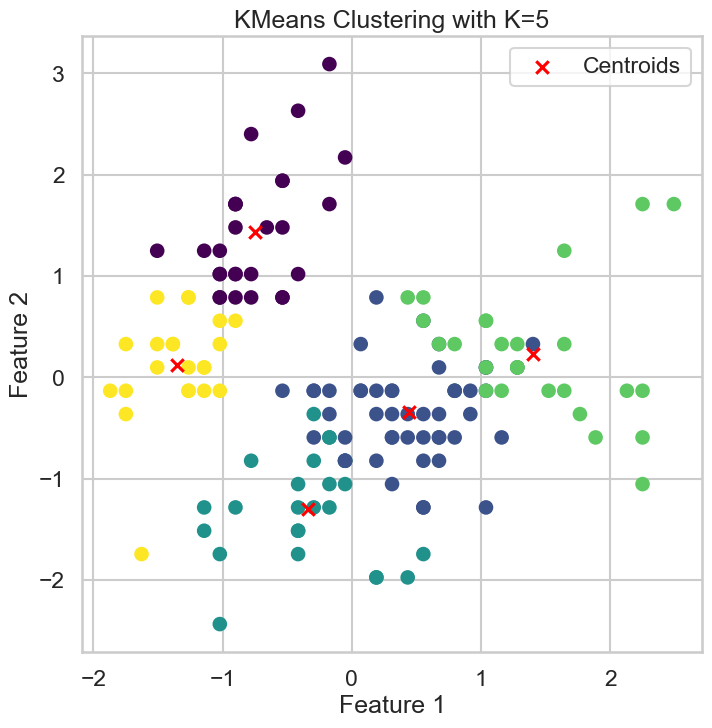

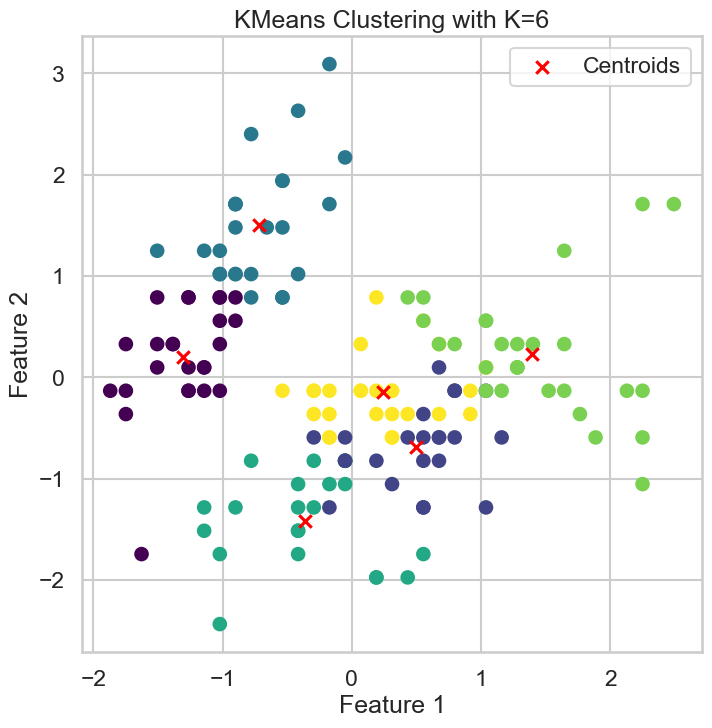

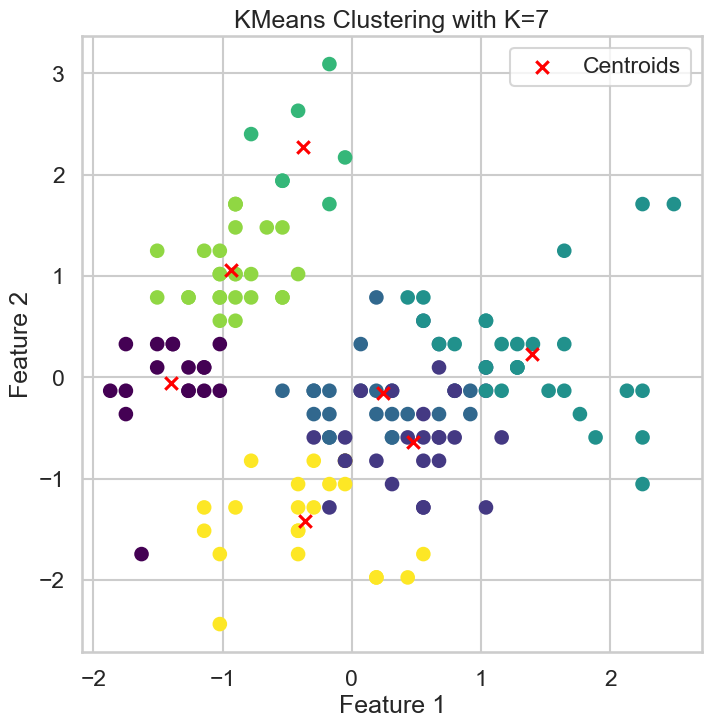

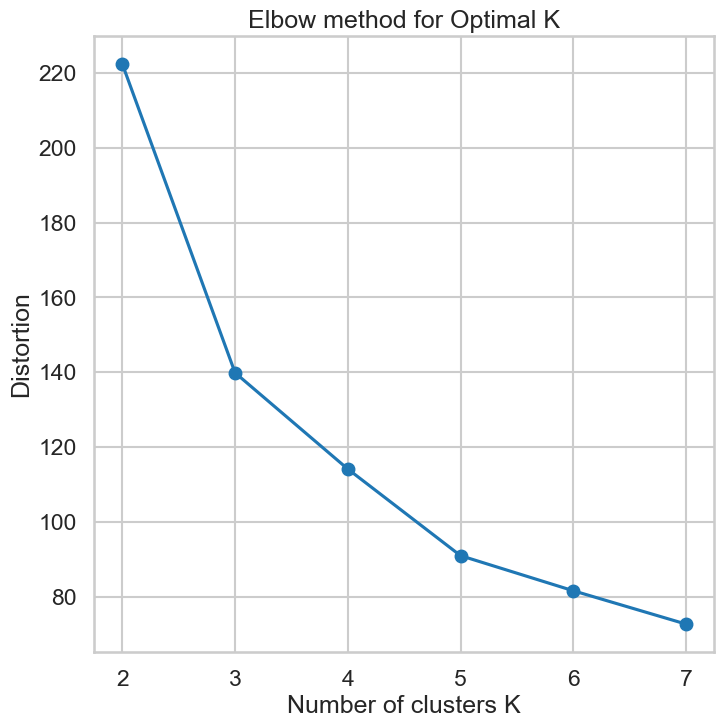

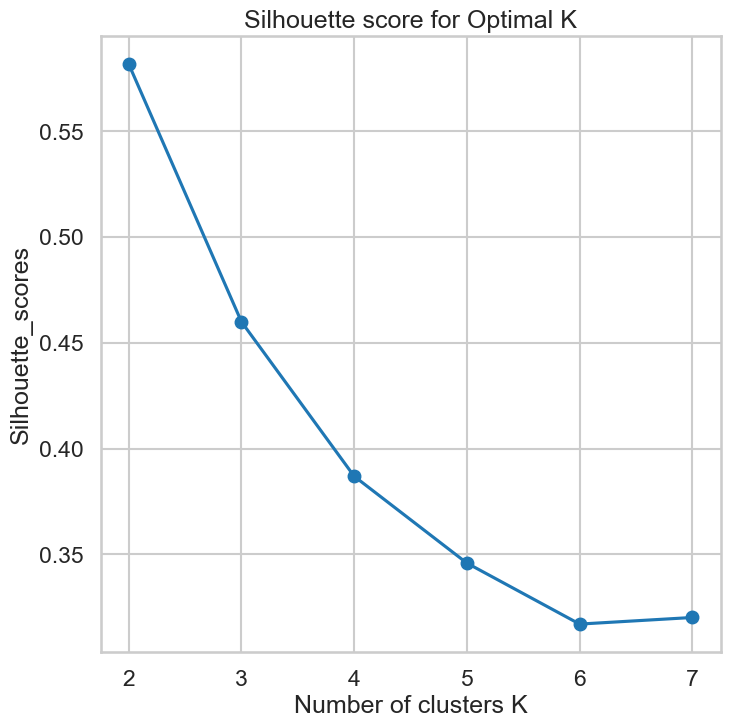

Best K: 2, Best silhouette score: 0.5817500491982808


In [42]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import matplotlib.pyplot as plt
from sklearn.datasets import load_iris
from sklearn.preprocessing import StandardScaler

# Load the Iris dataset
iris_data = load_iris()
X = iris_data.data
scaler = StandardScaler()
X_normalized = scaler.fit_transform(X)

# Fit KMeans with different values of K
k_values = [2, 3, 4, 5, 6, 7]
for k in k_values:
    km = KMeans(n_clusters=k, random_state=42)
    km.fit(X_normalized)
    plt.figure()
    plt.scatter(X_normalized[:, 0], X_normalized[:, 1], c=km.labels_, cmap='viridis')
    plt.scatter(km.cluster_centers_[:, 0], km.cluster_centers_[:, 1], marker='x', color='red', label='Centroids')
    plt.xlabel('Feature 1')
    plt.ylabel('Feature 2')
    plt.title(f"KMeans Clustering with K={k}")
    plt.legend()
    plt.show()

# Elbow method for optimal K
distortions = []
for k in k_values:
    km = KMeans(n_clusters=k, random_state=42)
    km.fit(X_normalized)
    distortions.append(km.inertia_)

plt.plot(k_values, distortions, marker='o')
plt.xlabel('Number of clusters K')
plt.ylabel('Distortion')
plt.title("Elbow method for Optimal K")
plt.show()

# Silhouette score for optimal K
silhouette_scores = []
for k in k_values:
    km = KMeans(n_clusters=k, random_state=42)
    km.fit(X_normalized)
    silhouette_scores.append(silhouette_score(X_normalized, km.labels_))

plt.plot(k_values, silhouette_scores, marker='o')
plt.xlabel('Number of clusters K')
plt.ylabel('Silhouette_scores')
plt.title("Silhouette score for Optimal K")
plt.show()

# Find the best K and its silhouette score
best_k = k_values[silhouette_scores.index(max(silhouette_scores))]
print(f'Best K: {best_k}, Best silhouette score: {max(silhouette_scores)}')


<h1>AgglomerativeClustering </h1>

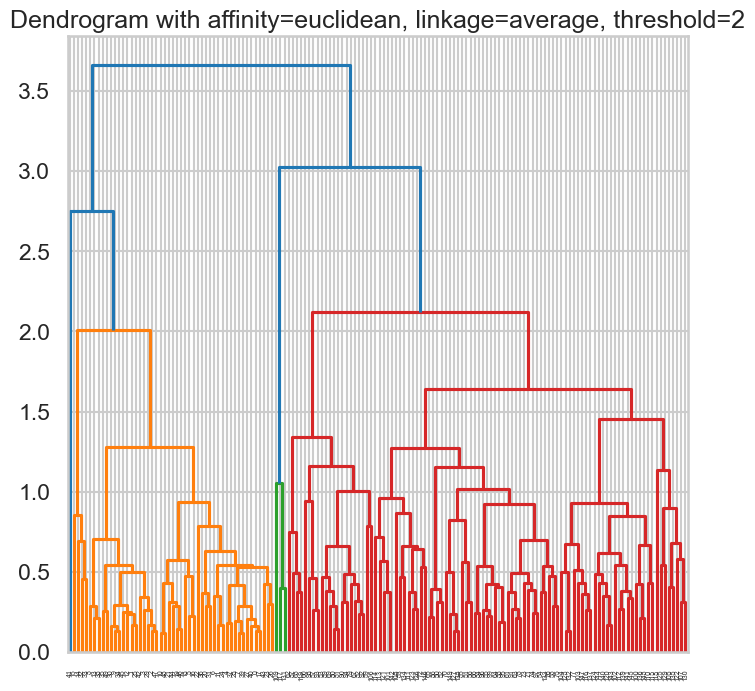

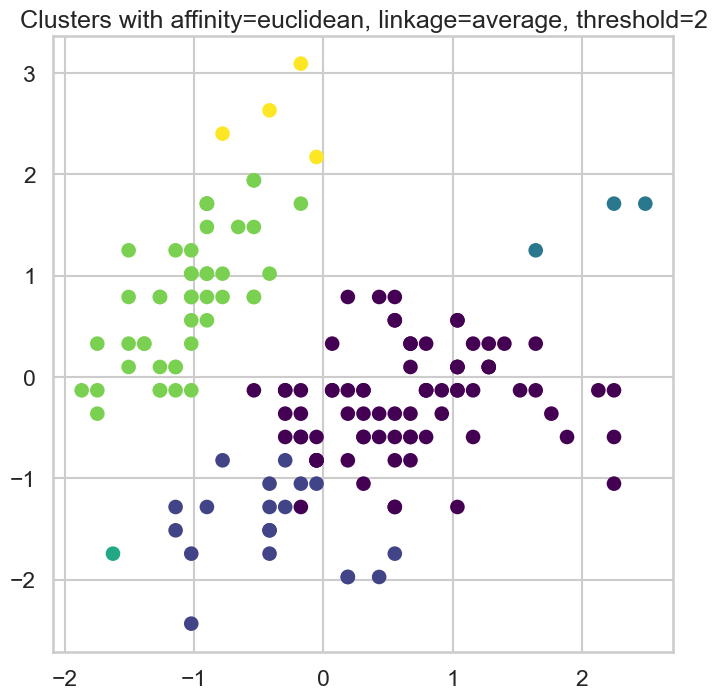

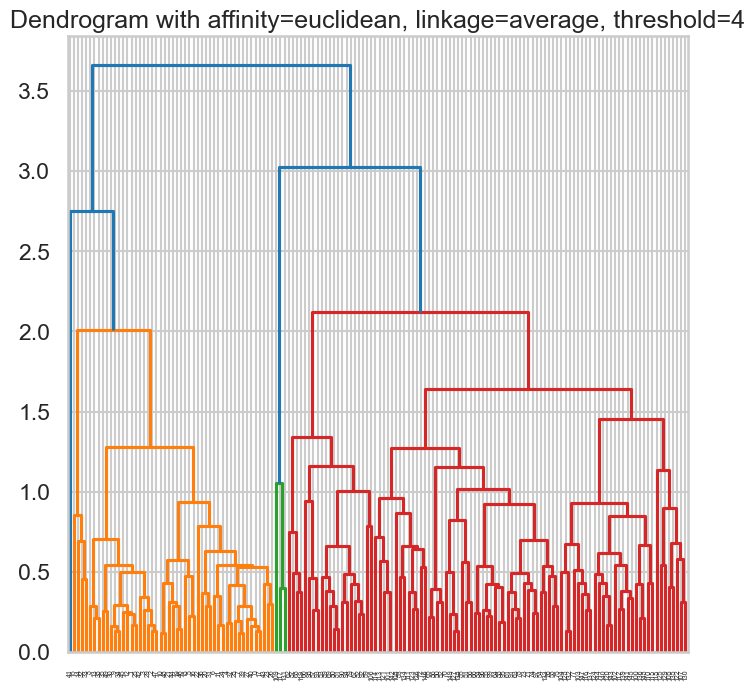

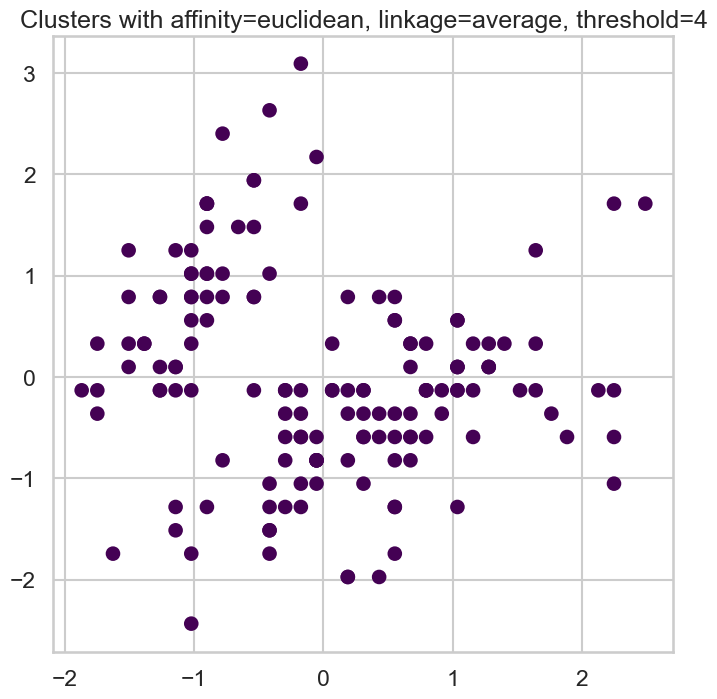

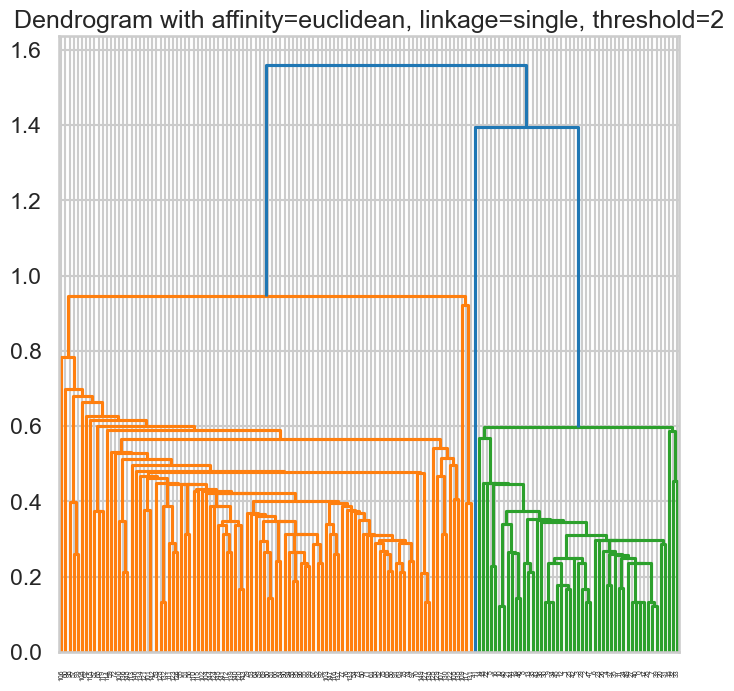

...

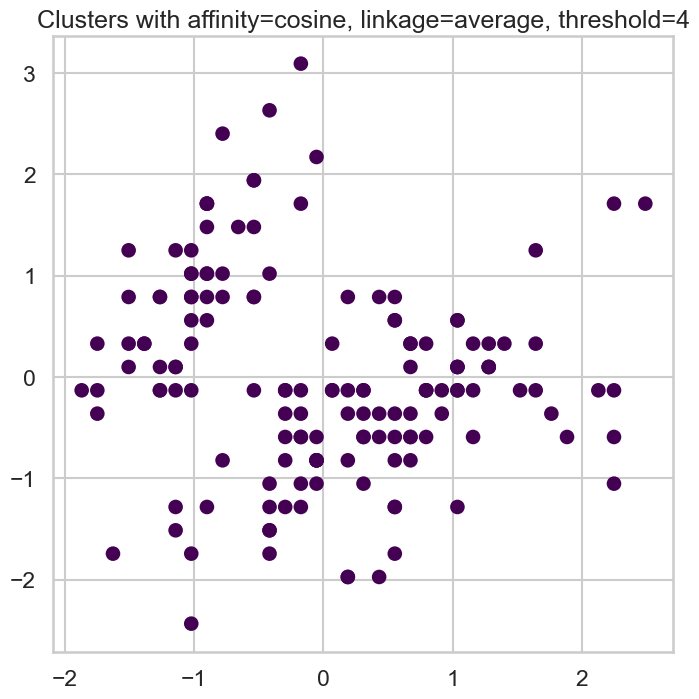

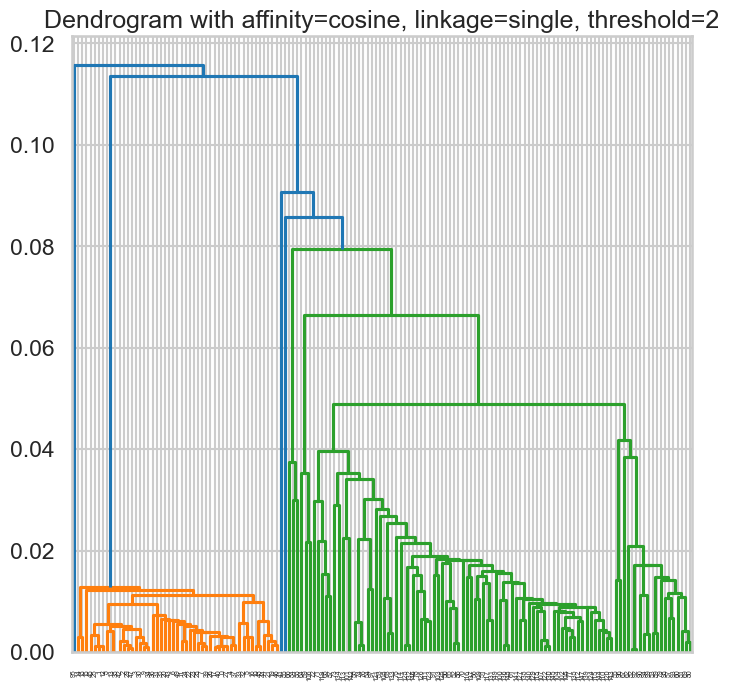

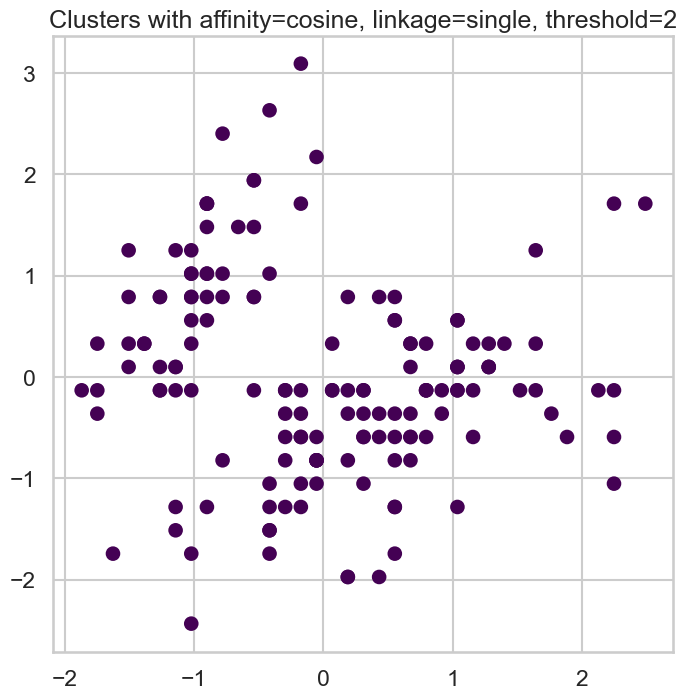

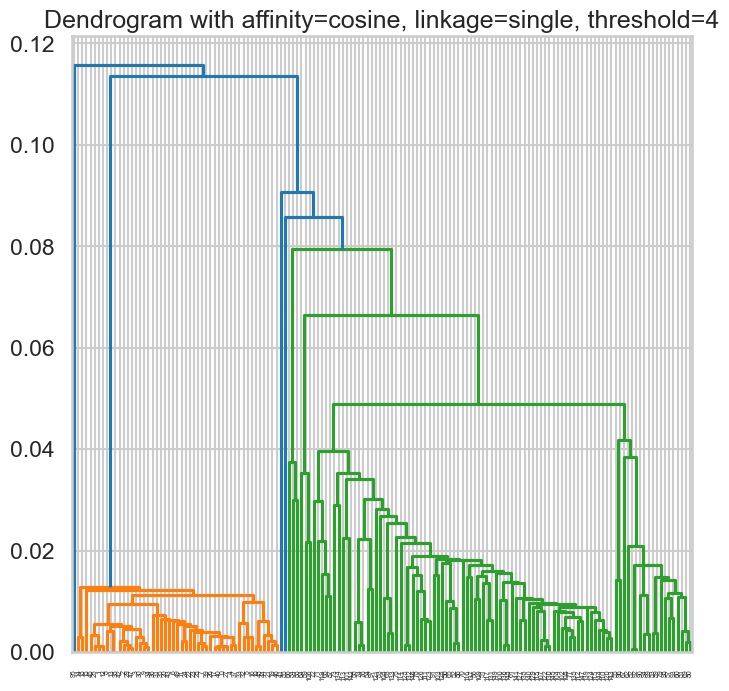

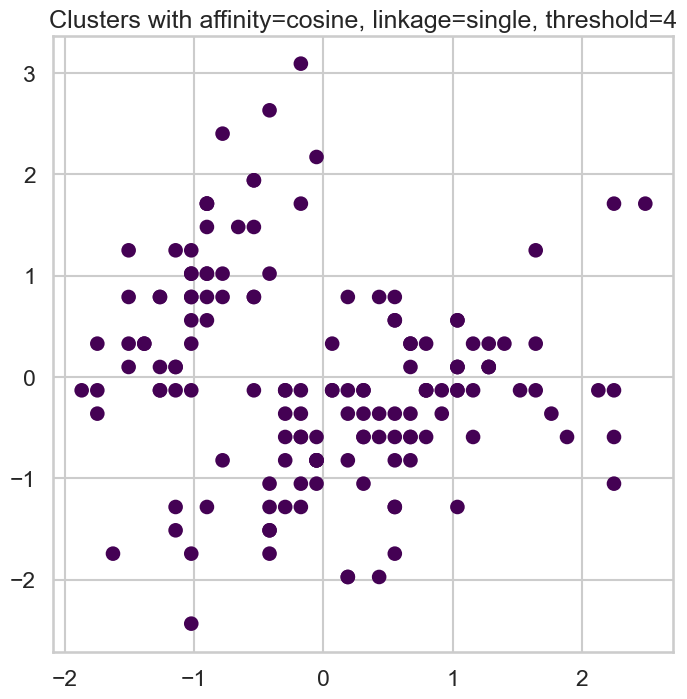

Best silhouette score: 0.5817500491982808 with params: ('cityblock', 'average', 4)


In [6]:
from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.metrics import silhouette_score
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.datasets import load_iris
from sklearn.preprocessing import StandardScaler


def display_cluster_new(data, model):
    plt.scatter(data[:, 0], data[:, 1], c=model.labels_, cmap='viridis')

plt.rcParams['figure.figsize'] = [8, 8]
sns.set_style("whitegrid")
sns.set_context("talk")

iris_data = load_iris()
X = iris_data.data
scaler = StandardScaler()
X_normalized = scaler.fit_transform(X)

affinities = ['euclidean', 'cityblock', 'cosine']
linkages = ['average', 'single']
distance_thresholds = [2, 4]

best_silhouette_score = -1
best_params = None

for affinity in affinities:
    for linkage_method in linkages:
        for threshold in distance_thresholds:
            model = AgglomerativeClustering(n_clusters=None, affinity=affinity, linkage=linkage_method, distance_threshold=threshold)
            cluster_labels = model.fit_predict(X_normalized)
            if len(set(cluster_labels)) > 1:  # Check if there is more than one cluster
                silhouette_avg = silhouette_score(X_normalized, cluster_labels)
                if silhouette_avg > best_silhouette_score:
                    best_silhouette_score = silhouette_avg
                    best_params = (affinity, linkage_method, threshold)

            plt.figure()
            dendrogram(linkage(X_normalized, method=linkage_method, metric=affinity))
            plt.title(f"Dendrogram with affinity={affinity}, linkage={linkage_method}, threshold={threshold}")

            plt.figure()
            display_cluster_new(X_normalized, model)
            plt.title(f"Clusters with affinity={affinity}, linkage={linkage_method}, threshold={threshold}")
            plt.show()

print(f"Best silhouette score: {best_silhouette_score} with params: {best_params}")



<h1>DBscan</h1>

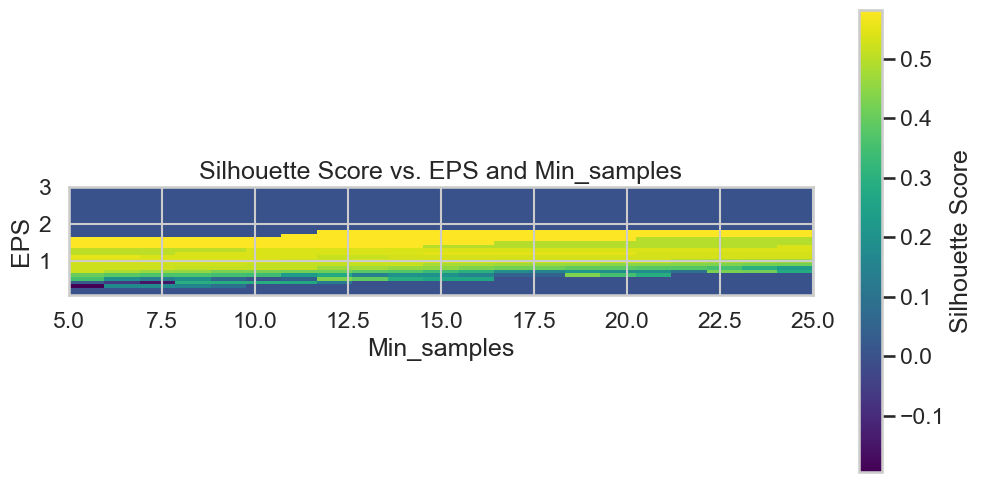

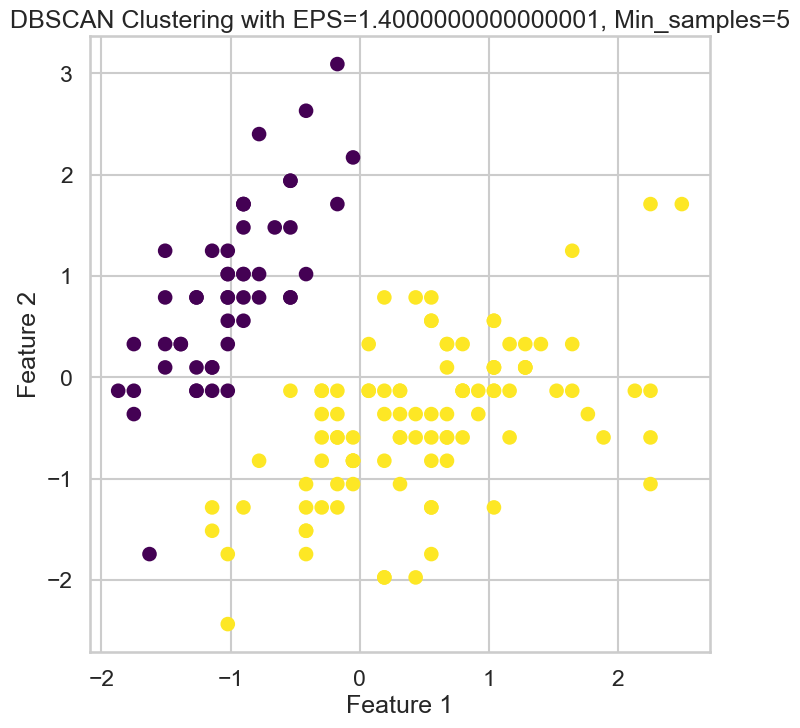

Best Silhouette Score: 0.5817500491982808
Best EPS: 1.4000000000000001, Best Min_samples: 5


In [24]:
iris_data = load_iris()
X = iris_data.data
scaler = StandardScaler()
X_normalized = scaler.fit_transform(X)

eps_range = np.arange(0.1, 3.1, 0.1)
min_samples_range = range(5, 26)
silhouette_scores = np.zeros((len(eps_range), len(min_samples_range)))

for i, eps in enumerate(eps_range):
    for j, min_samples in enumerate(min_samples_range):
        dbscan = DBSCAN(eps=eps, min_samples=min_samples)
        cluster_labels = dbscan.fit_predict(X_normalized)
        if len(np.unique(cluster_labels)) > 1:  # Check if more than one cluster (excluding noise) is found
            silhouette_scores[i, j] = silhouette_score(X_normalized, cluster_labels)

plt.figure(figsize=(12, 6))
plt.imshow(silhouette_scores, cmap='viridis', origin='lower', extent=[5, 25, 0.1, 3])
plt.colorbar(label='Silhouette Score')
plt.xlabel('Min_samples')
plt.ylabel('EPS')
plt.title('Silhouette Score vs. EPS and Min_samples')
plt.show()

best_eps, best_min_samples = np.unravel_index(np.argmax(silhouette_scores), silhouette_scores.shape)
best_dbscan = DBSCAN(eps=eps_range[best_eps], min_samples=min_samples_range[best_min_samples])
best_cluster_labels = best_dbscan.fit_predict(X_normalized)

plt.figure(figsize=(8, 8))
plt.scatter(X_normalized[:, 0], X_normalized[:, 1], c=best_cluster_labels, cmap='viridis')
plt.xlabel('Feature 1')
plt.ylabel('Feature 2')
plt.title(f'DBSCAN Clustering with EPS={eps_range[best_eps]}, Min_samples={min_samples_range[best_min_samples]}')
plt.show()

best_score = silhouette_scores[best_eps, best_min_samples]
print(f"Best Silhouette Score: {best_score}")
print(f"Best EPS: {eps_range[best_eps]}, Best Min_samples: {min_samples_range[best_min_samples]}")


<h1>Observations on the 4 algorithms after normalization </h1>

**First, We didn't normalize the data again with the gaussian, since it already assumes each cluster is normalized.**

**The rest of the algorithms gave exactly the same silhouette score, yet unfortunately they gave us 2 clusters only as well.**

**Apparently, the normalization wasn't up to our expectations.**

**--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------**

## Customer dataset
Repeat all the above on the customer data set 

<h1> Helper method for displaying nD data</h1>

In [42]:
def display_cluster_ND(X, cluster_assignments=[], centroids=[], num_clusters=0):
    color = 'brgcmyk'
    alpha = 0.5
    s = 20

    num_dimensions = X.shape[1]
    num_plots = num_dimensions * (num_dimensions - 1) // 2

    fig, axs = plt.subplots(num_plots // 2 + num_plots % 2, 2, figsize=(12, 6 * (num_plots // 2 + num_plots % 2)))

    plot_index = 0
    for i in range(num_dimensions):
        for j in range(i + 1, num_dimensions):
            ax = axs[plot_index // 2, plot_index % 2] if num_plots > 1 else axs
            plot_index += 1
            ax.set_title(f'Dimensions {i + 1} vs {j + 1}')

            if num_clusters == 0:
                ax.scatter(X[:, i], X[:, j], c=color[0], alpha=alpha, s=s)
            else:
                for k in range(num_clusters):
                    ax.scatter(X[cluster_assignments == k, i], X[cluster_assignments == k, j], c=color[k], alpha=alpha, s=s)
                    ax.scatter(centroids[k][i], centroids[k][j], c=color[k], marker='x', s=100)

    plt.tight_layout()
    plt.show()


<h1> Displaying all features with KMeans</h1>

<Figure size 800x800 with 0 Axes>

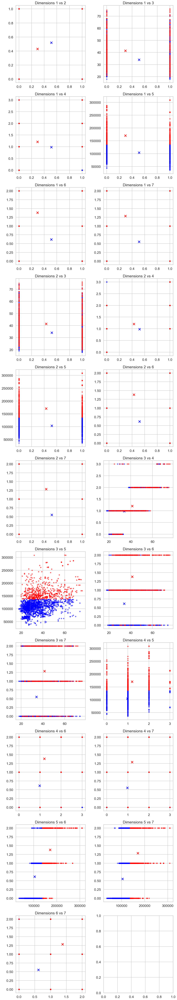

<Figure size 800x800 with 0 Axes>

<Figure size 800x800 with 0 Axes>

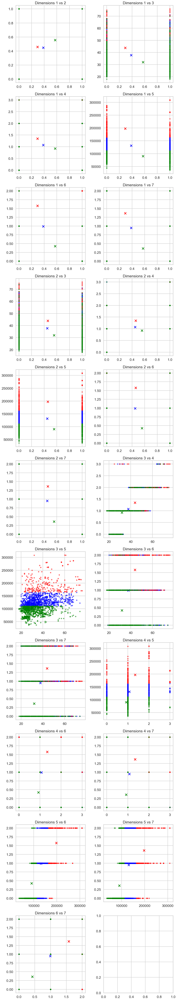

<Figure size 800x800 with 0 Axes>

<Figure size 800x800 with 0 Axes>

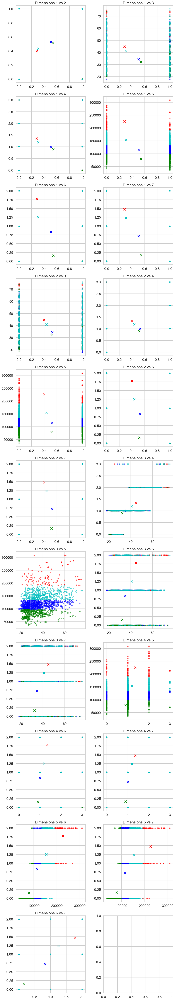

<Figure size 800x800 with 0 Axes>

<Figure size 800x800 with 0 Axes>

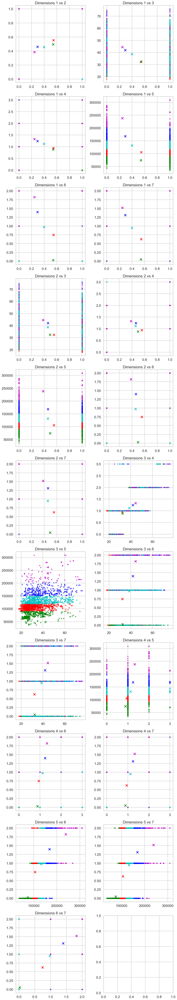

<Figure size 800x800 with 0 Axes>

<Figure size 800x800 with 0 Axes>

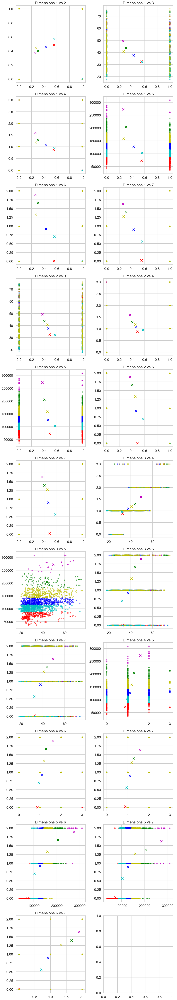

<Figure size 800x800 with 0 Axes>

<Figure size 800x800 with 0 Axes>

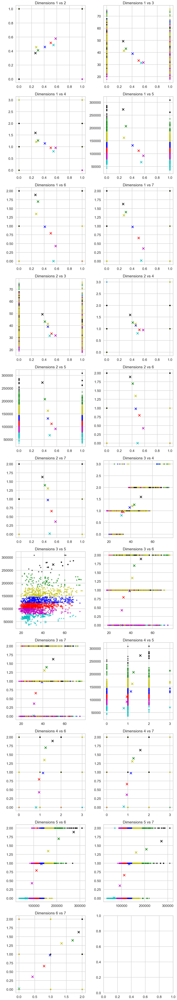

<Figure size 800x800 with 0 Axes>

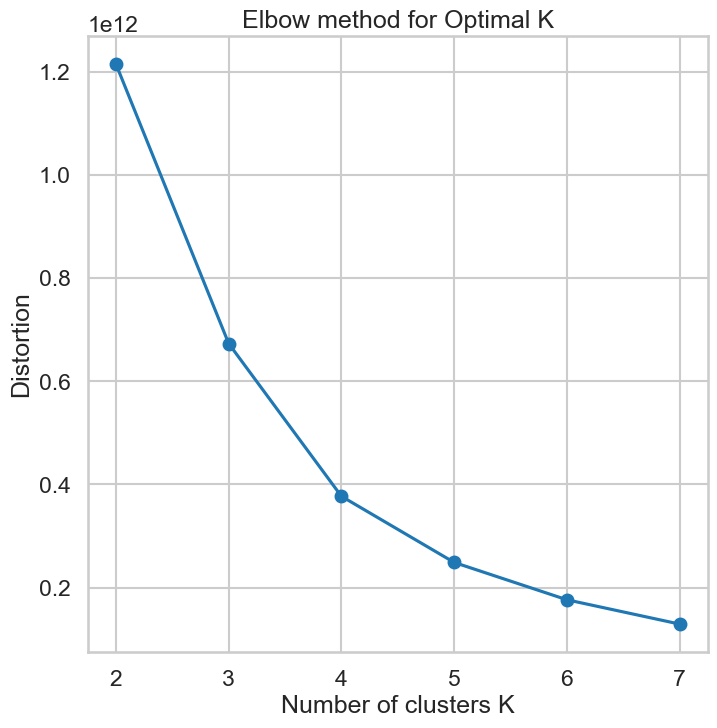

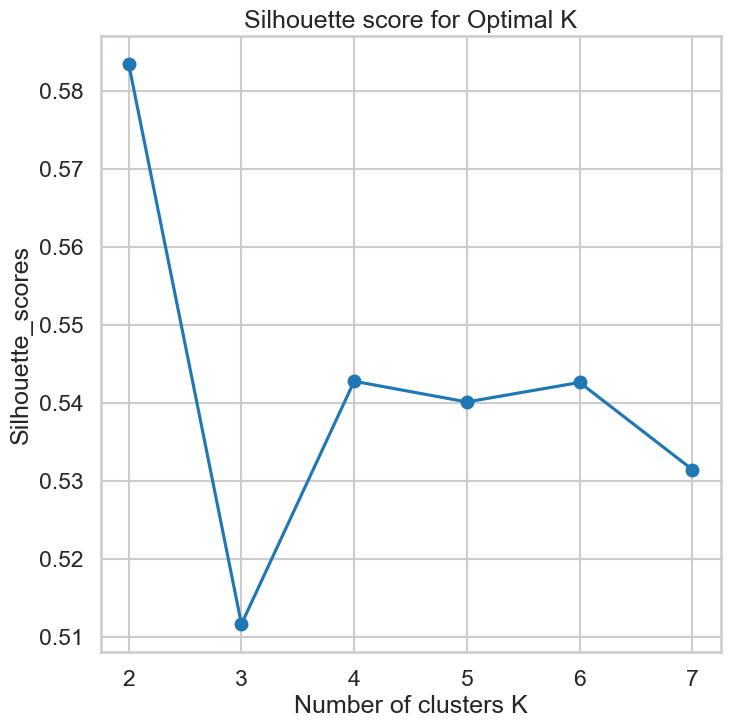

Best K: 2, Best silhouette score: 0.5834469001696239


In [55]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# Load the data
df = pd.read_csv(r'D:\Sems10\ML\Customer data.csv')

# Select all features except 'id'
X = df.drop(columns=['ID'])

# Fit KMeans with different values of K
k_values = [2, 3, 4, 5, 6, 7]
for k in k_values:
    km = KMeans(n_clusters=k, random_state=42)
    km.fit(X)
    centroids = km.cluster_centers_
    plt.figure()
    display_cluster_ND(X.values, km.labels_, centroids, k)
    plt.suptitle(f"KMeans Clustering with K={k}", y=1.02)
    plt.show()

# Elbow method for optimal K
distortions = []
for k in k_values:
    km = KMeans(n_clusters=k, random_state=42)
    km.fit(X)
    distortions.append(km.inertia_)

plt.plot(k_values, distortions, marker='o')
plt.xlabel('Number of clusters K')
plt.ylabel('Distortion')
plt.title("Elbow method for Optimal K")
plt.show()

# Silhouette score for optimal K
silhouette_scores = []
for k in k_values:
    km = KMeans(n_clusters=k, random_state=42)
    km.fit(X)
    silhouette_scores.append(silhouette_score(X, km.labels_))

plt.plot(k_values, silhouette_scores, marker='o')
plt.xlabel('Number of clusters K')
plt.ylabel('Silhouette_scores')
plt.title("Silhouette score for Optimal K")
plt.show()

# Find the best K and its silhouette score
best_k = k_values[silhouette_scores.index(max(silhouette_scores))]
print(f'Best K: {best_k}, Best silhouette score: {max(silhouette_scores)}')


<h1>Agglomerative Clustering</h1>

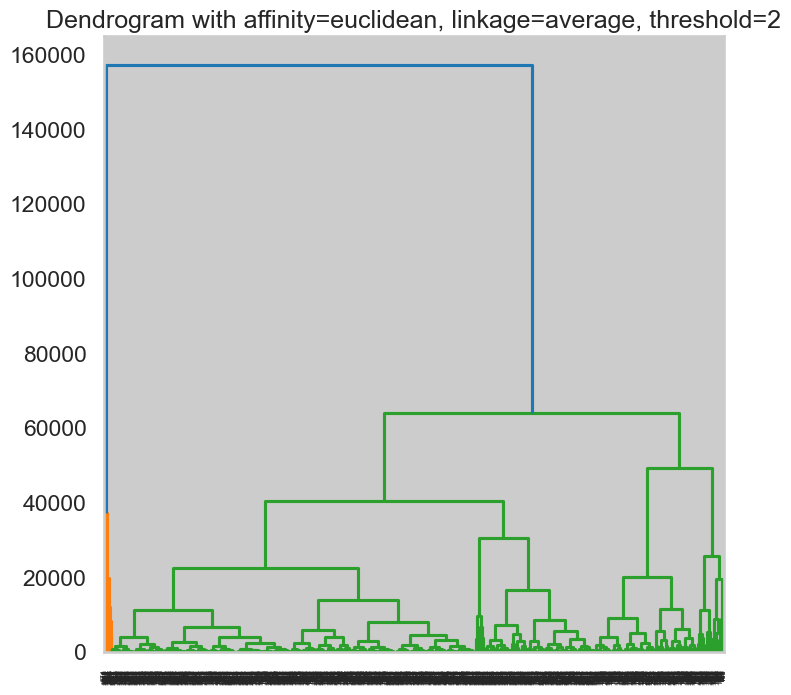

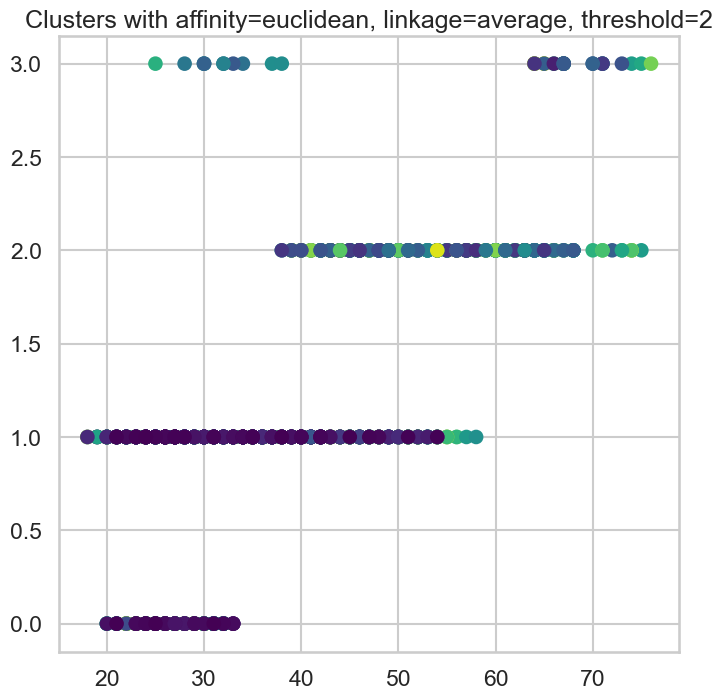

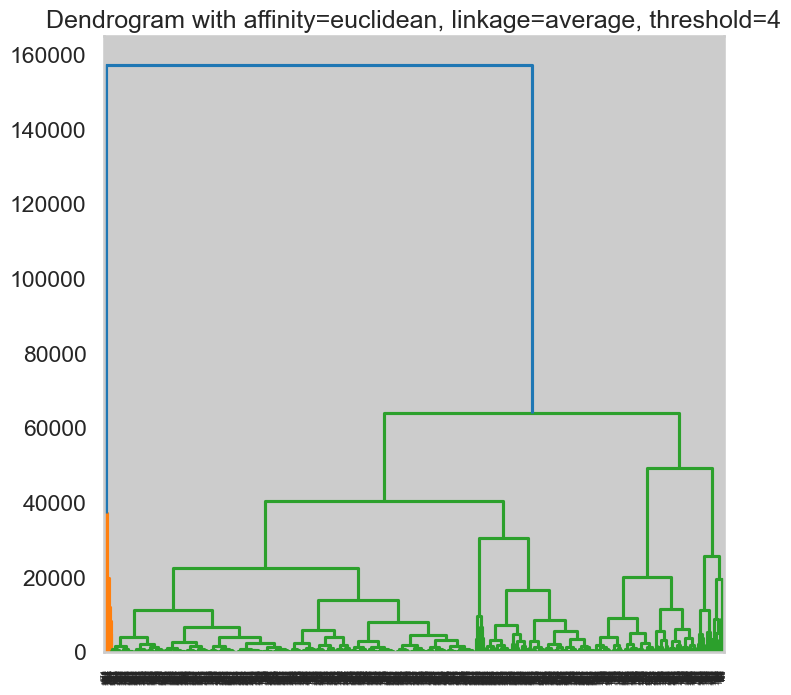

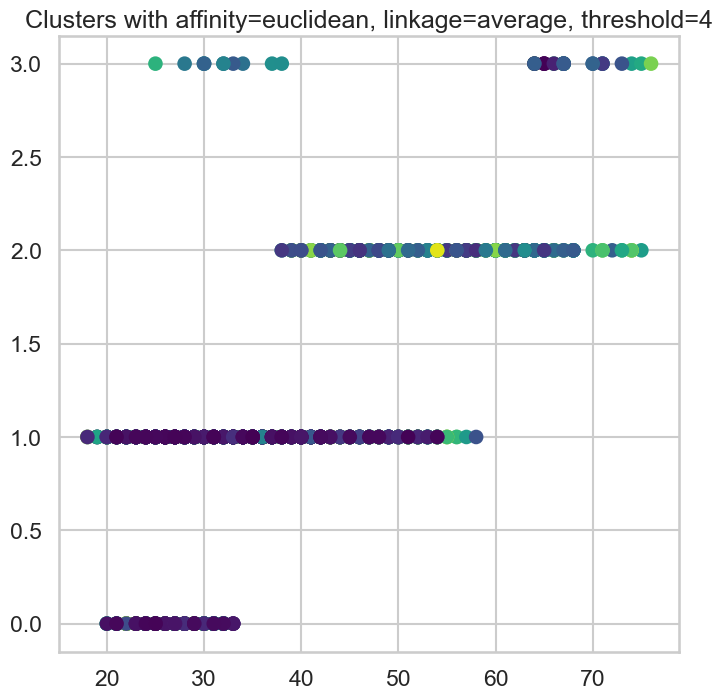

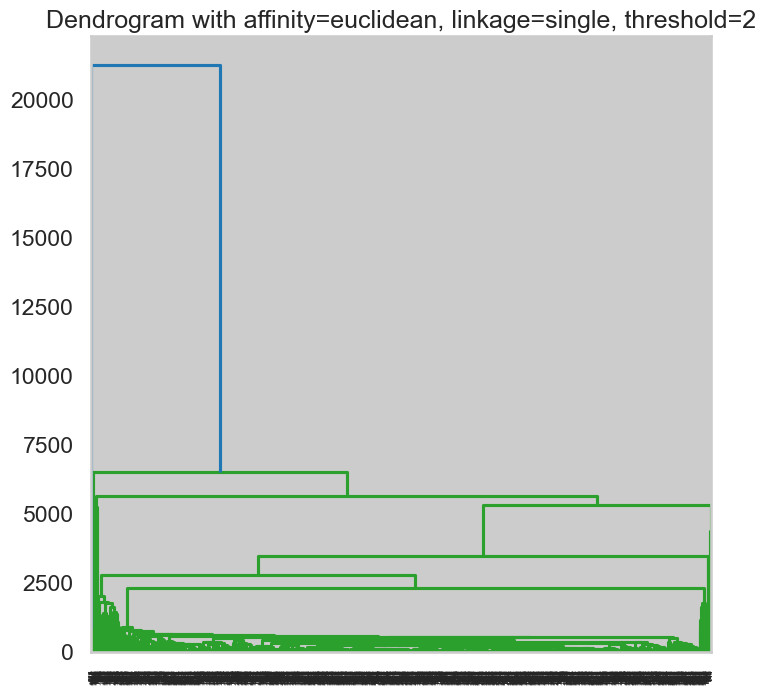

...

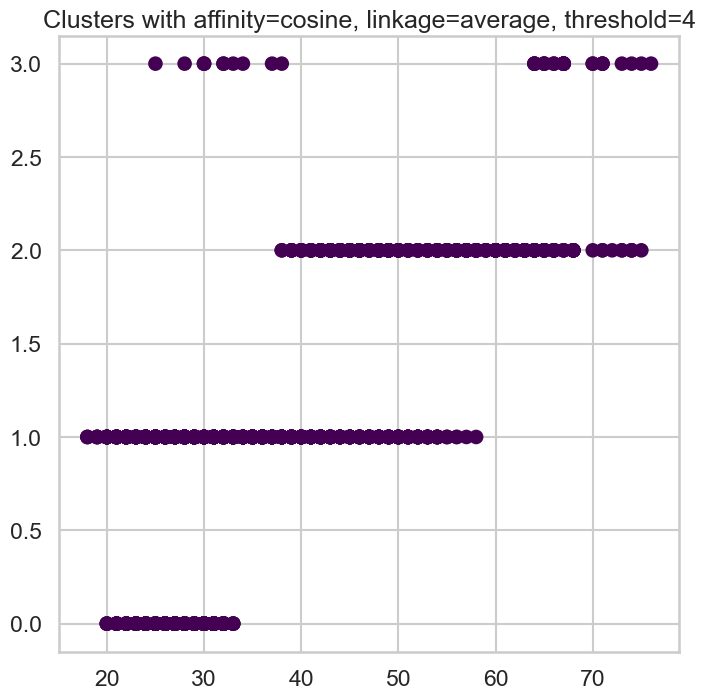

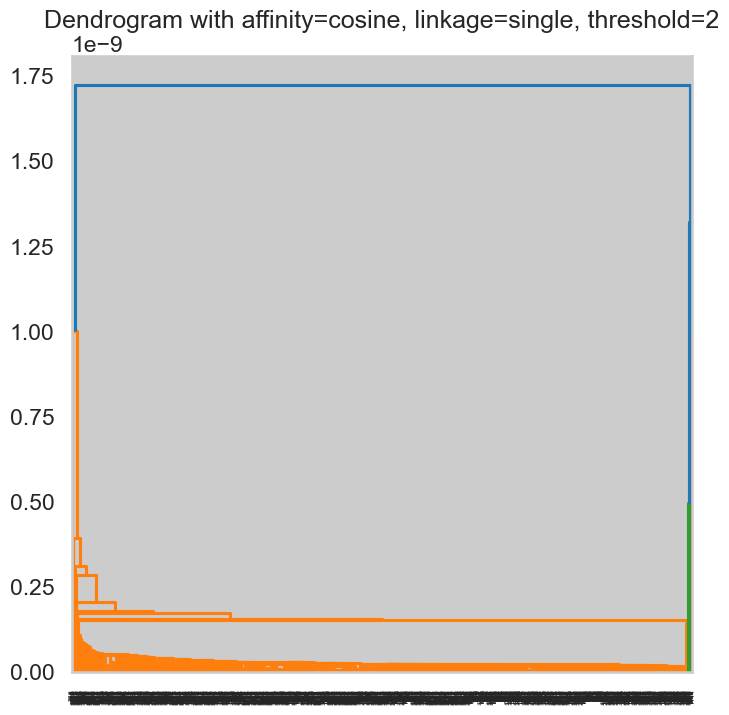

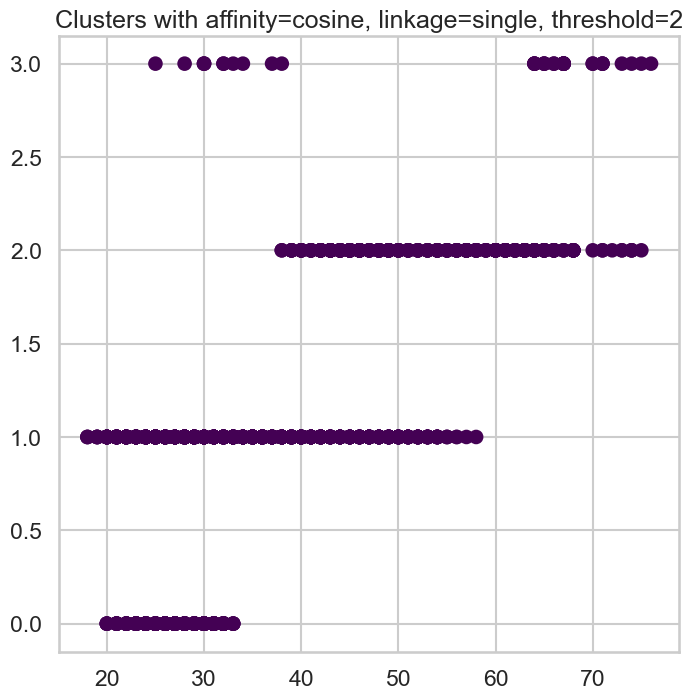

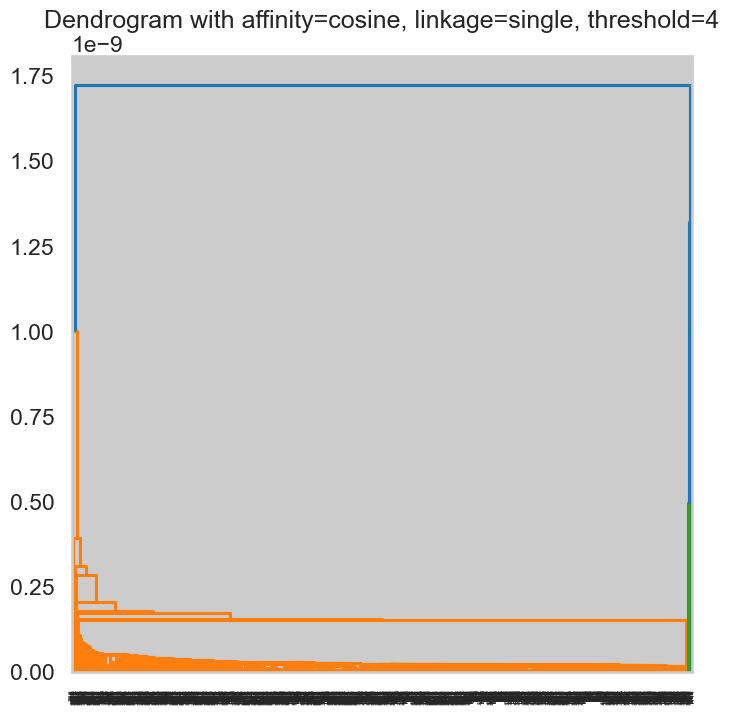

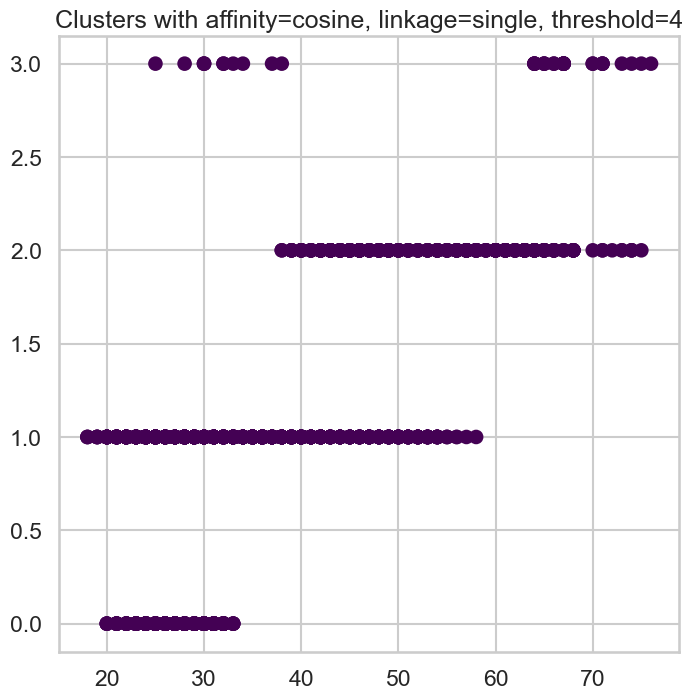

Best silhouette score: 0.017897881052075376 with params: ('euclidean', 'average', 4)


In [123]:
#Age,Education features
from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.metrics import silhouette_score
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

def display_cluster_new(data, model):
    plt.scatter(data[:, 2], data[:, 3], c=model.labels_, cmap='viridis')

plt.rcParams['figure.figsize'] = [8, 8]
sns.set_style("whitegrid")
sns.set_context("talk")

df = pd.read_csv(r'D:\Sems10\ML\Customer data.csv')

# Select all features except 'id'
X = df.drop(columns=['ID'])

affinities = ['euclidean', 'cityblock', 'cosine']
linkages = ['average', 'single']
distance_thresholds = [2, 4]

best_silhouette_score = -1
best_params = None

for affinity in affinities:
    for linkage_method in linkages:
        for threshold in distance_thresholds:
            model = AgglomerativeClustering(n_clusters=None, affinity=affinity, linkage=linkage_method, distance_threshold=threshold)
            cluster_labels = model.fit_predict(X.values)
            if len(set(cluster_labels)) > 1:  # Check if there is more than one cluster
                silhouette_avg = silhouette_score(X.values, cluster_labels)
                if silhouette_avg > best_silhouette_score:
                    best_silhouette_score = silhouette_avg
                    best_params = (affinity, linkage_method, threshold)

            plt.figure()
            dendrogram(linkage(X.values, method=linkage_method, metric=affinity))
            plt.title(f"Dendrogram with affinity={affinity}, linkage={linkage_method}, threshold={threshold}")

            plt.figure()
            display_cluster_new(X.values, model)
            plt.title(f"Clusters with affinity={affinity}, linkage={linkage_method}, threshold={threshold}")
            plt.show()

print(f"Best silhouette score: {best_silhouette_score} with params: {best_params}")


<h1> All Features with Agglomerative Clustering</h1>

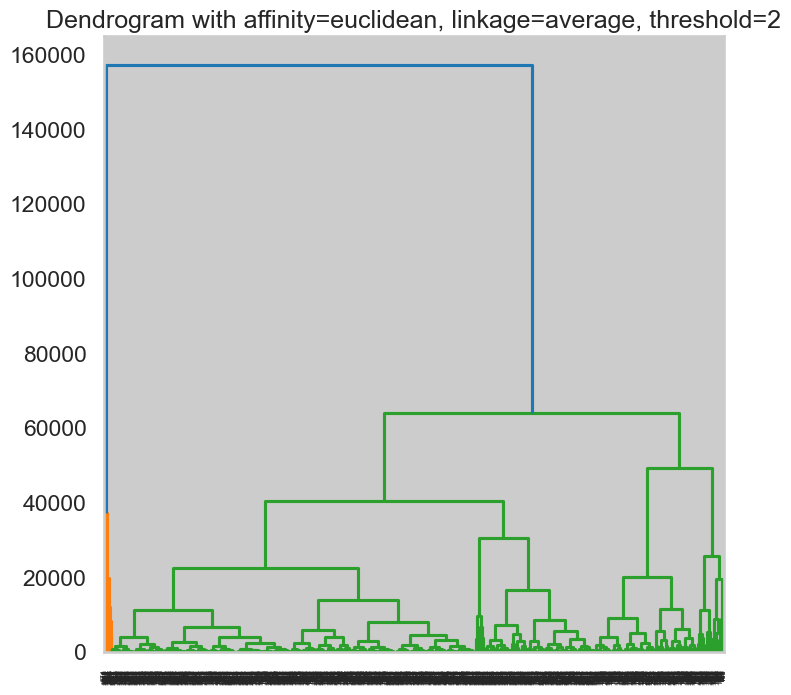

<Figure size 800x800 with 0 Axes>

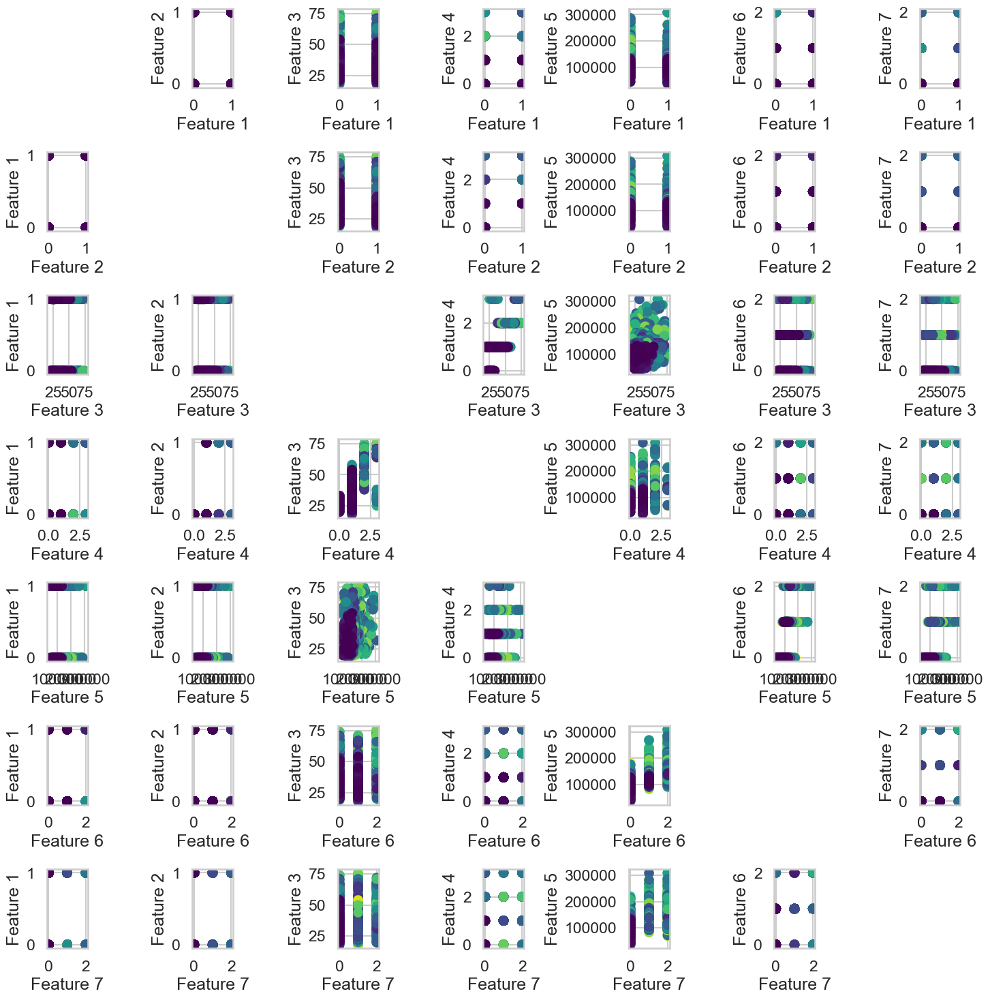

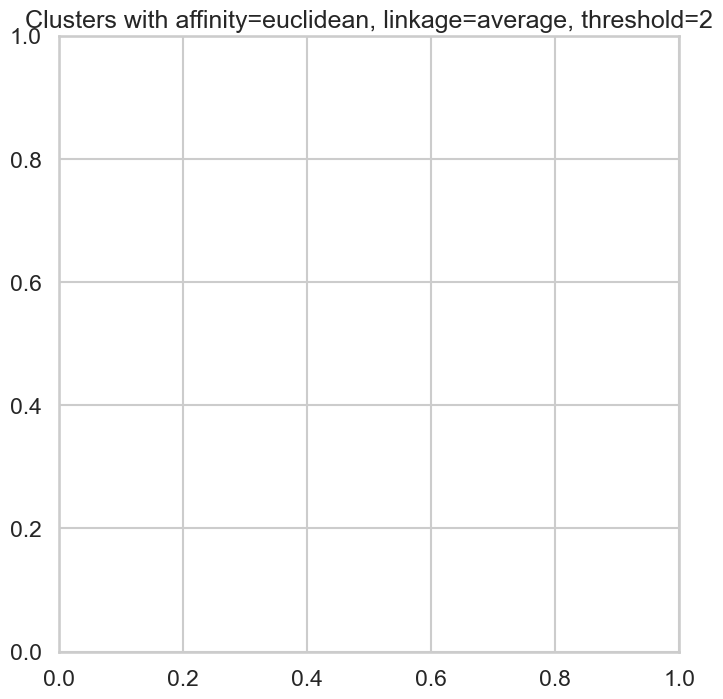

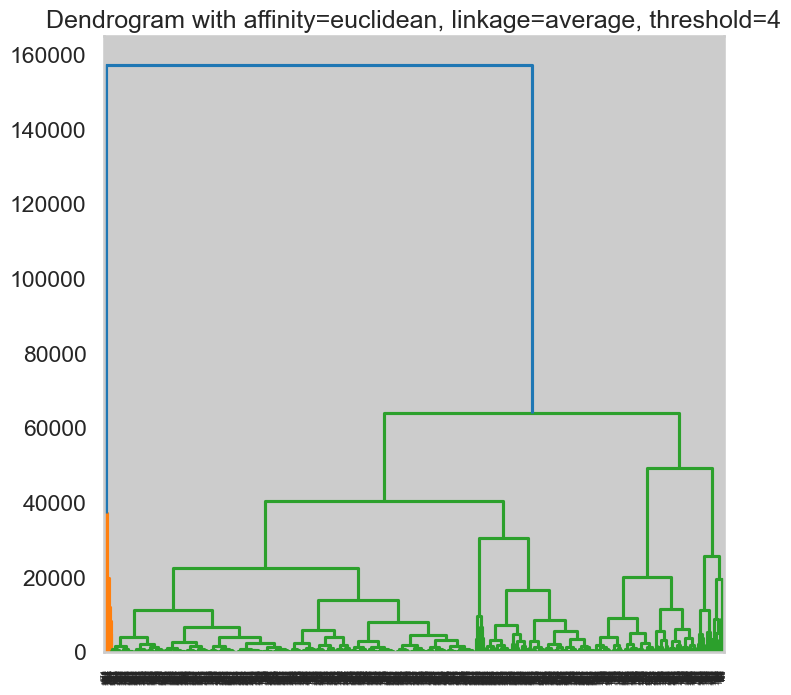

<Figure size 800x800 with 0 Axes>

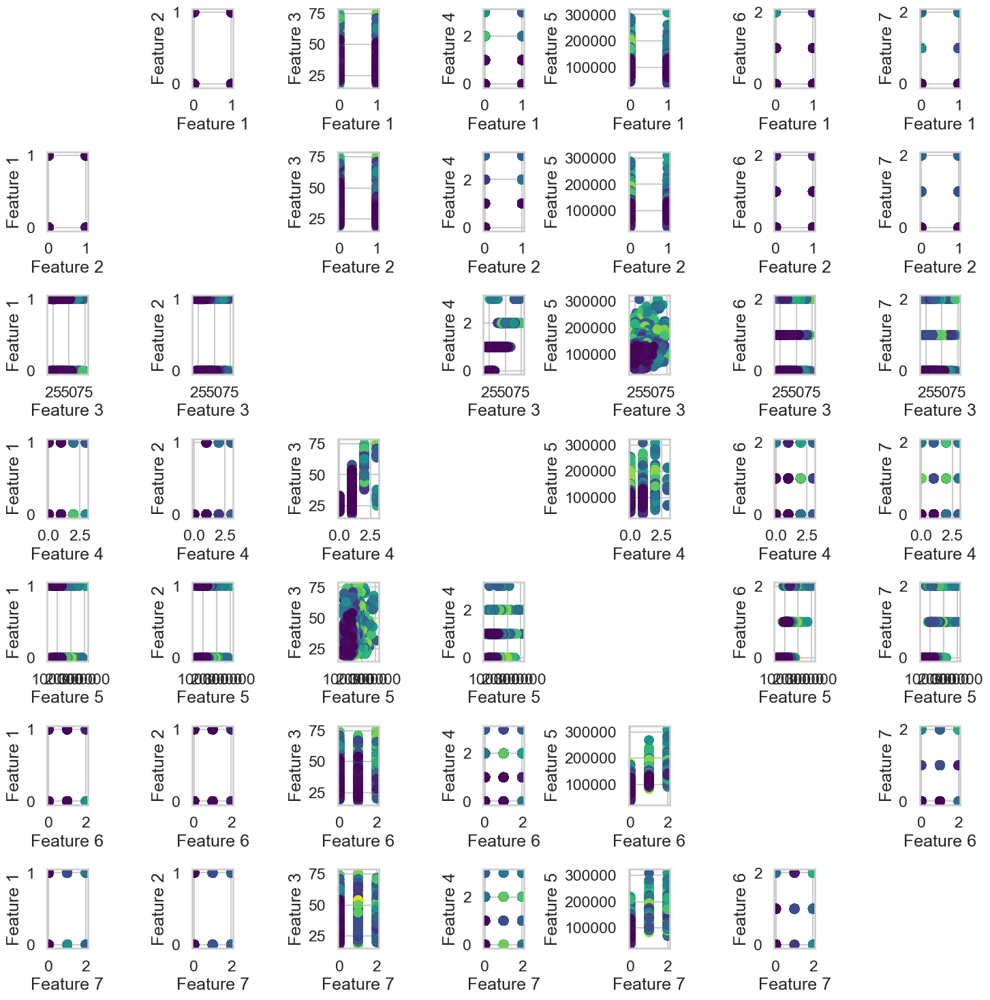

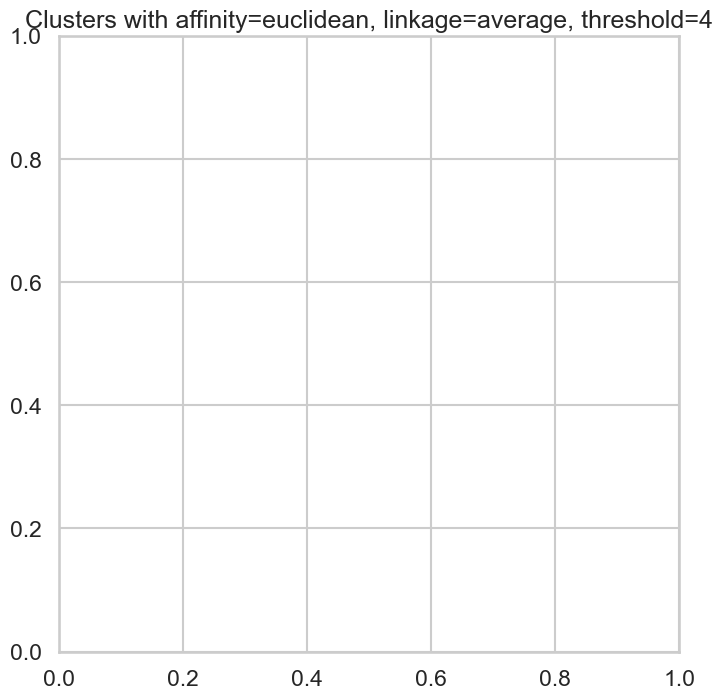

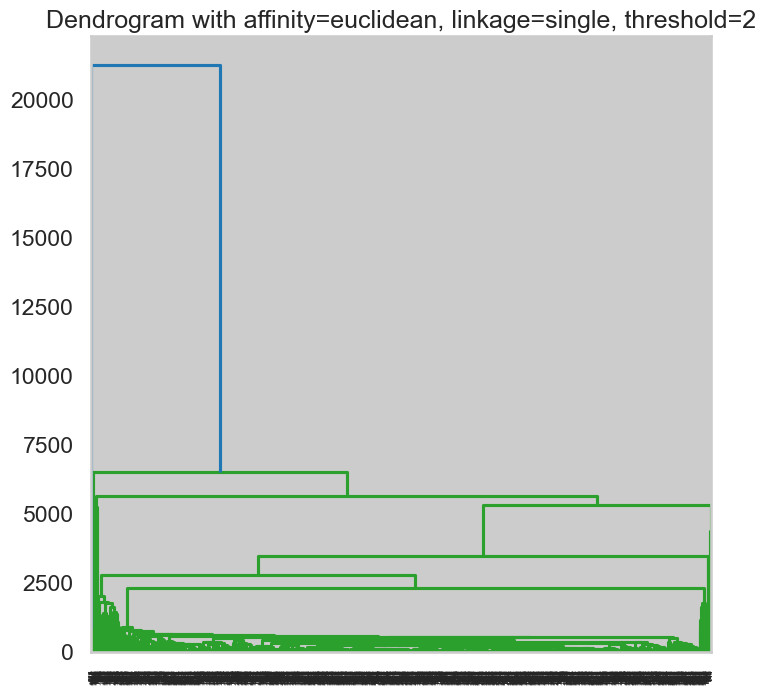

<Figure size 800x800 with 0 Axes>

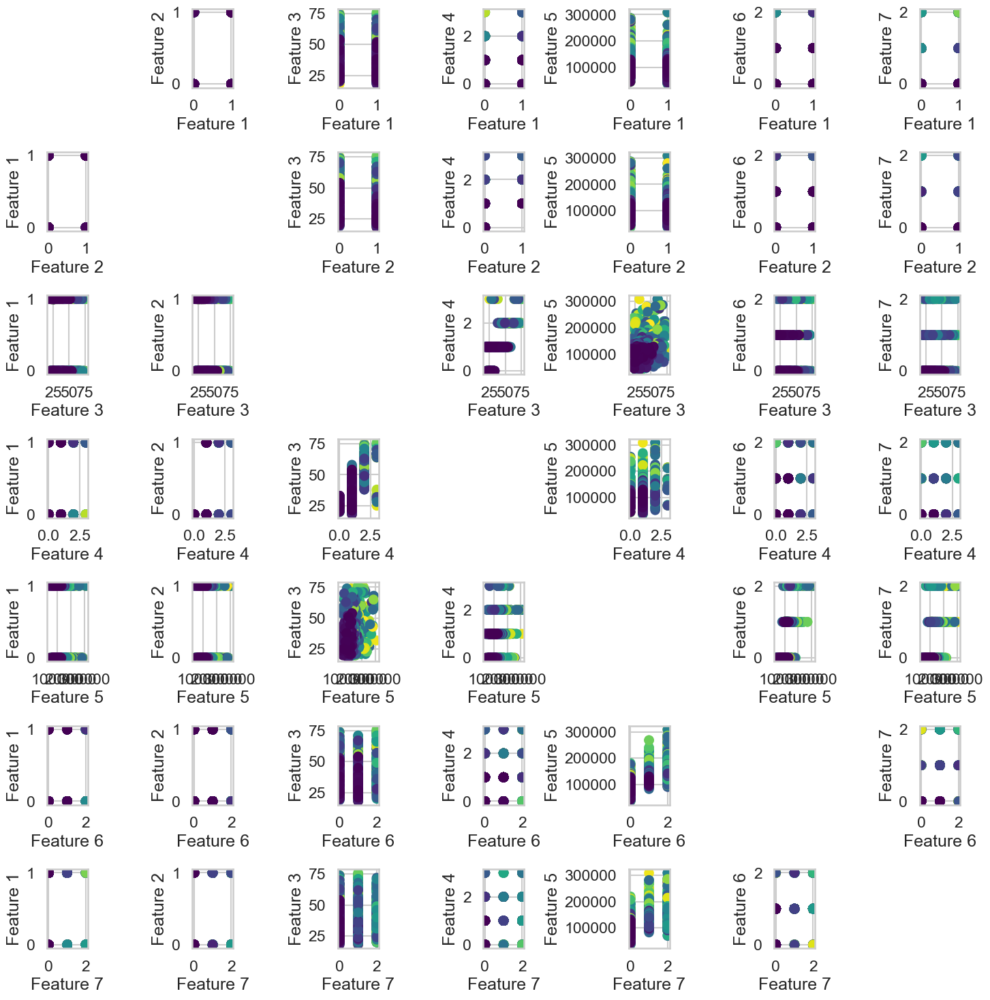

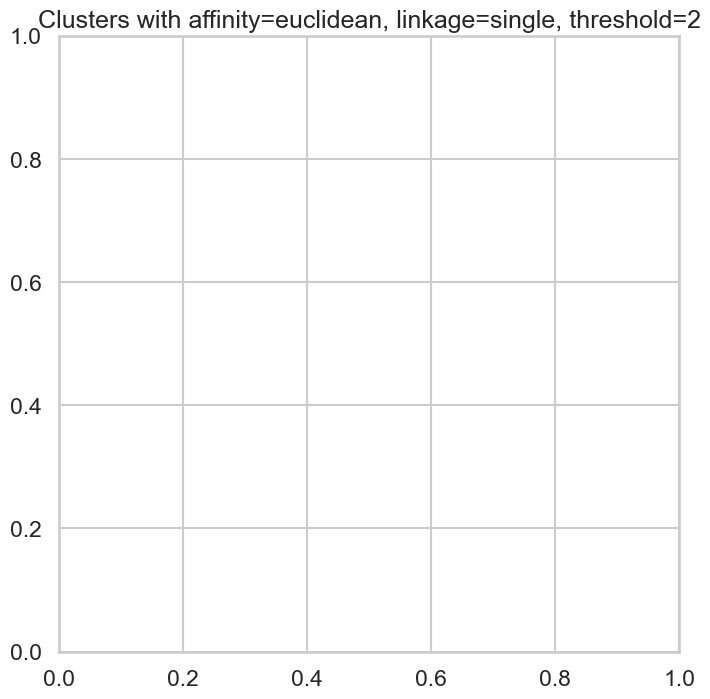

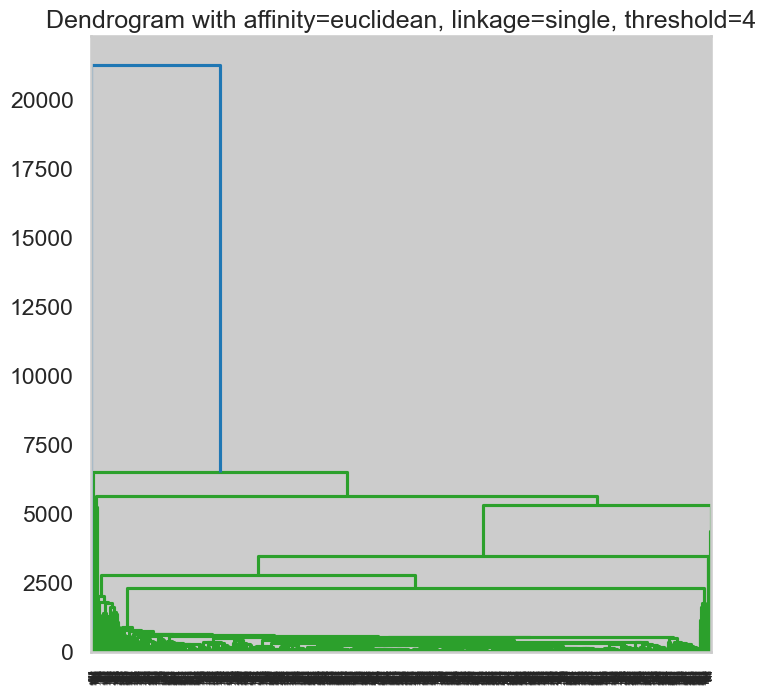

<Figure size 800x800 with 0 Axes>

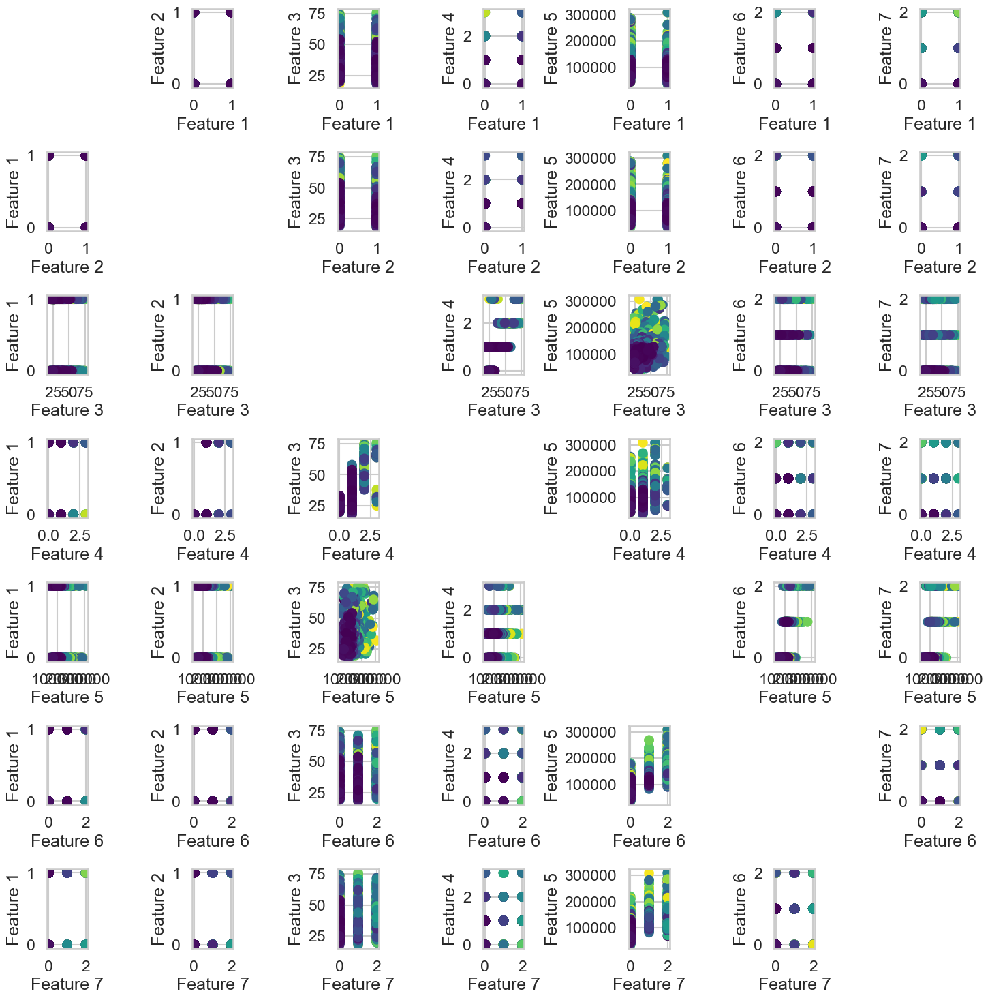

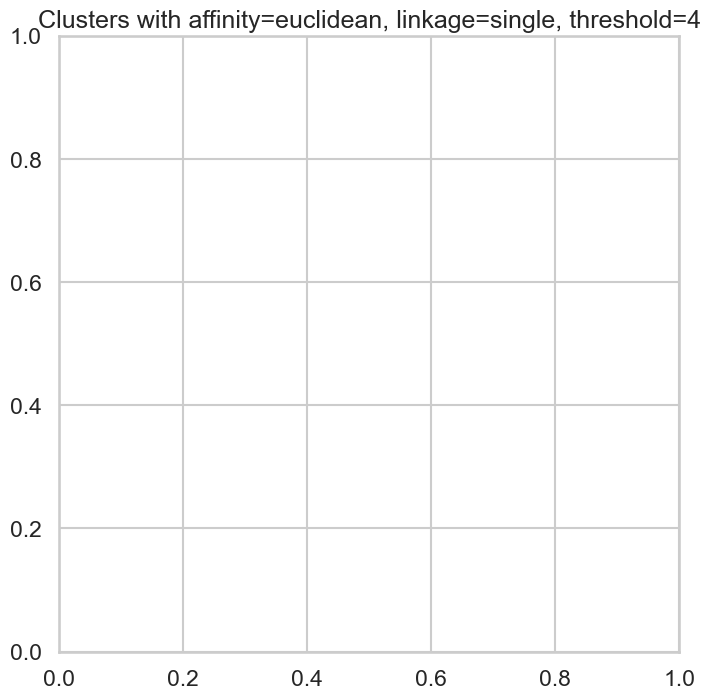

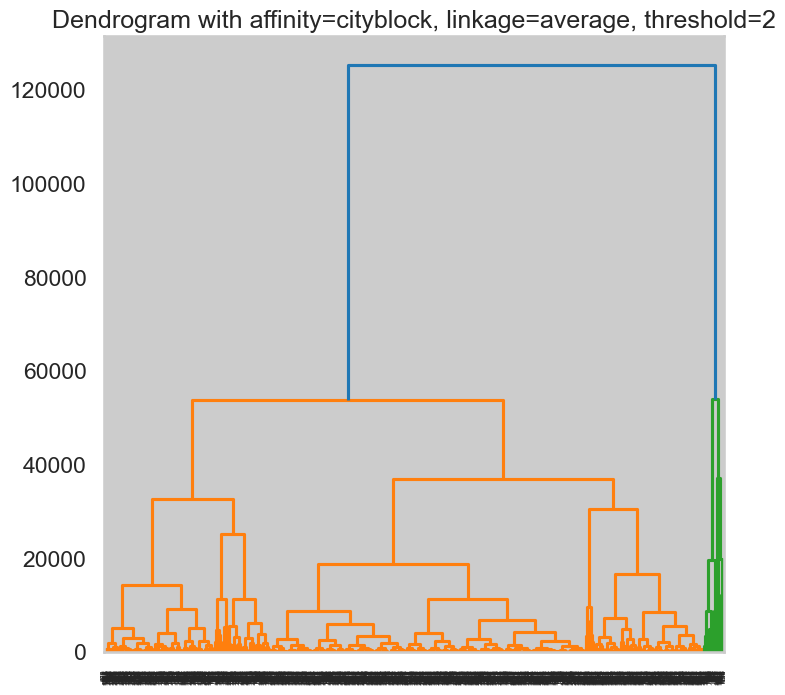

<Figure size 800x800 with 0 Axes>

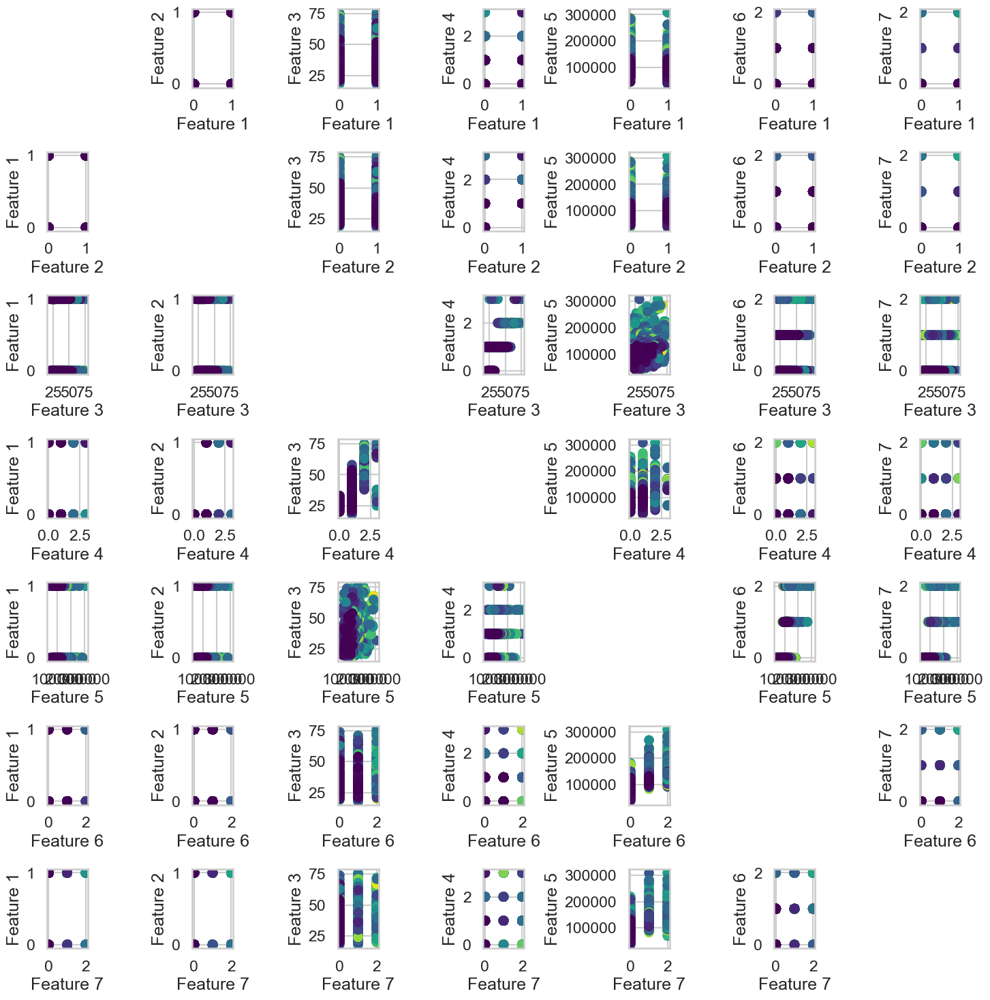

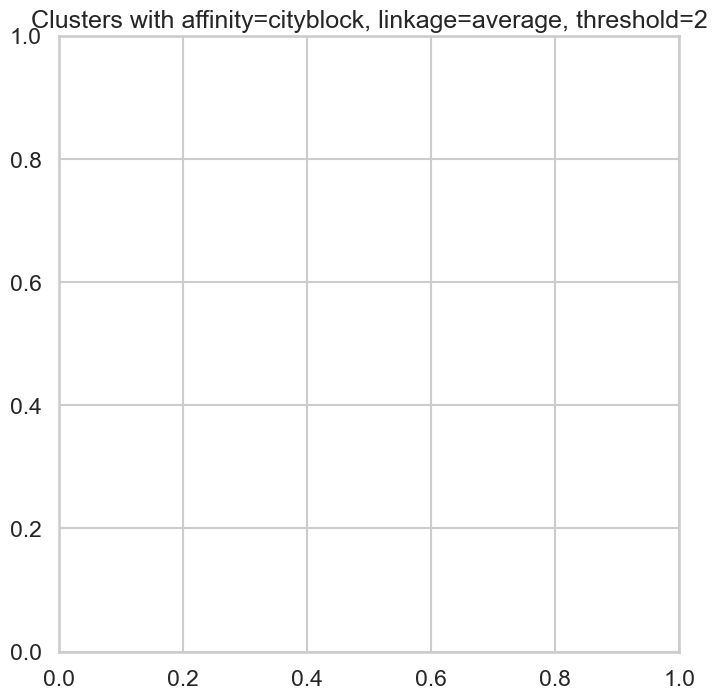

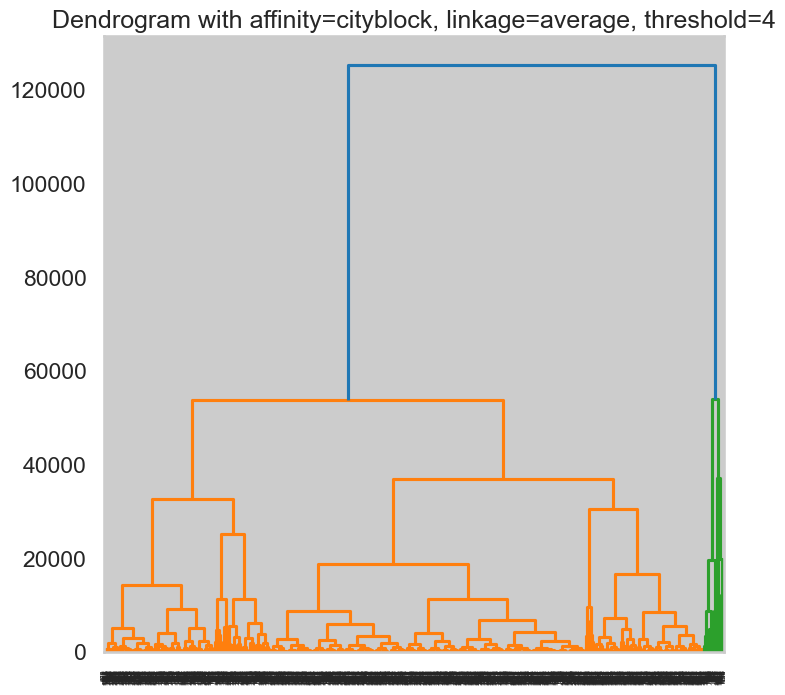

<Figure size 800x800 with 0 Axes>

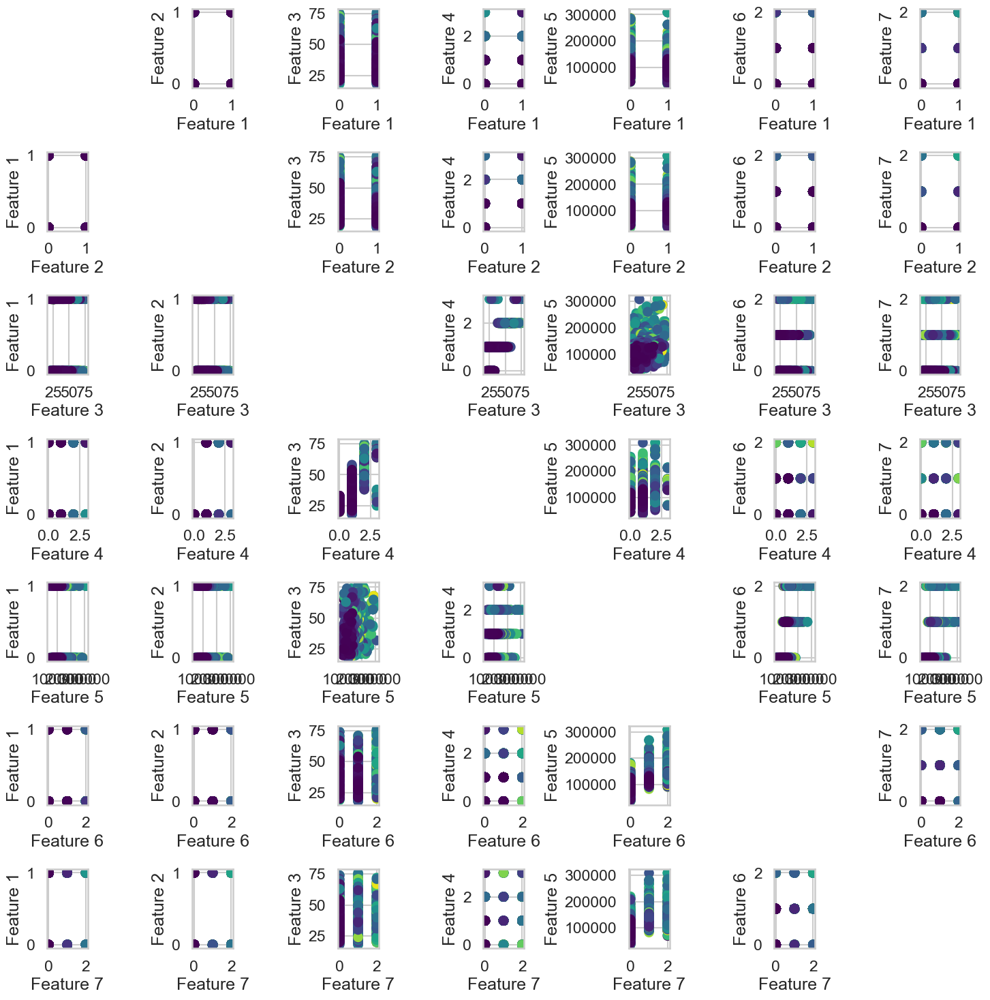

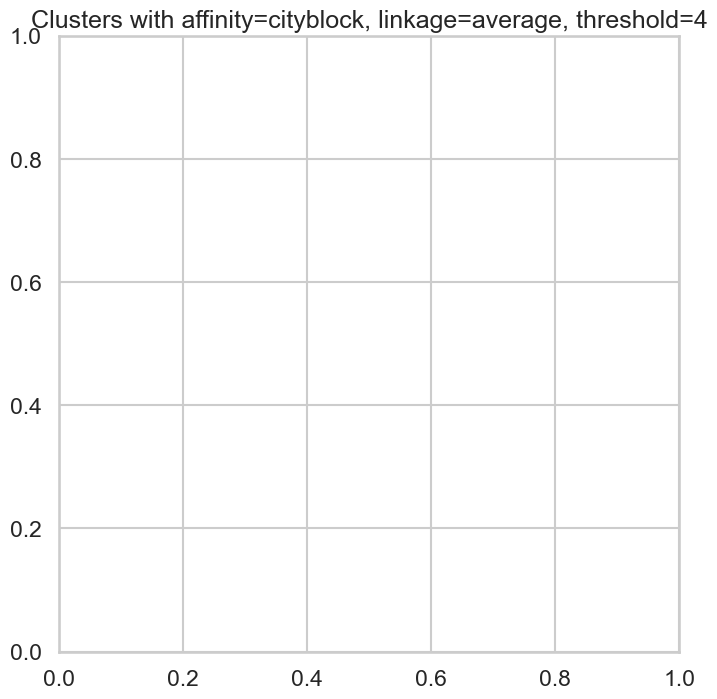

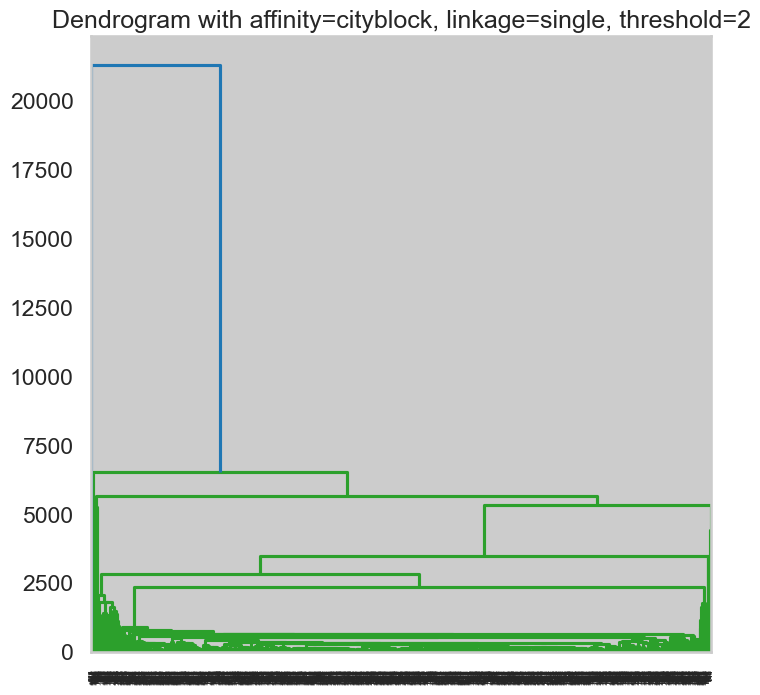

<Figure size 800x800 with 0 Axes>

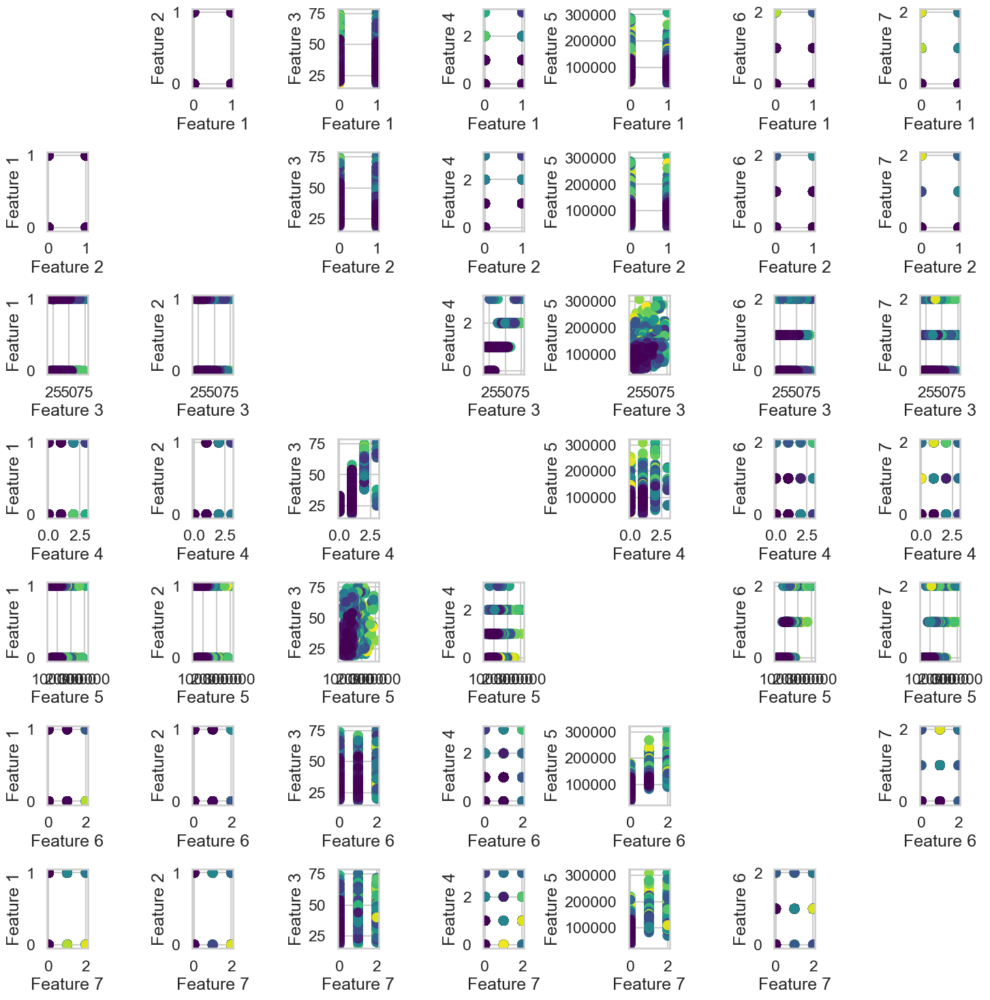

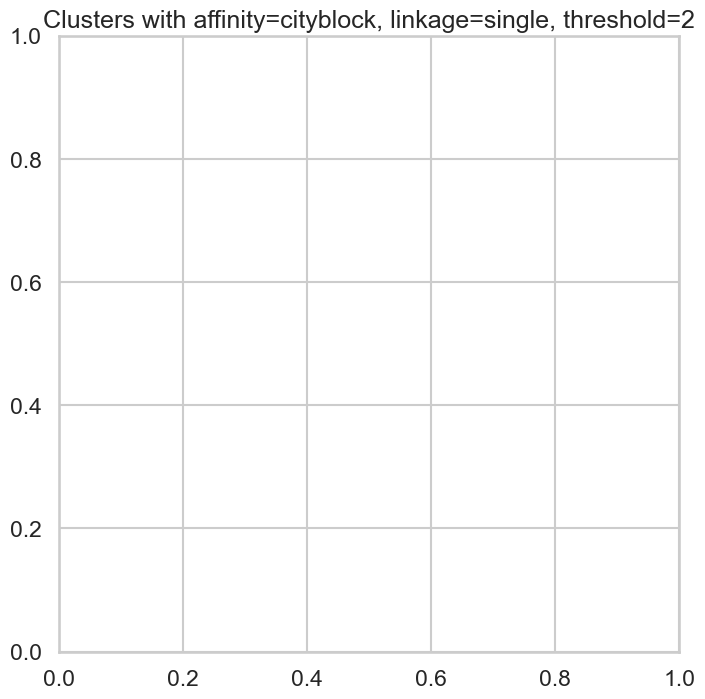

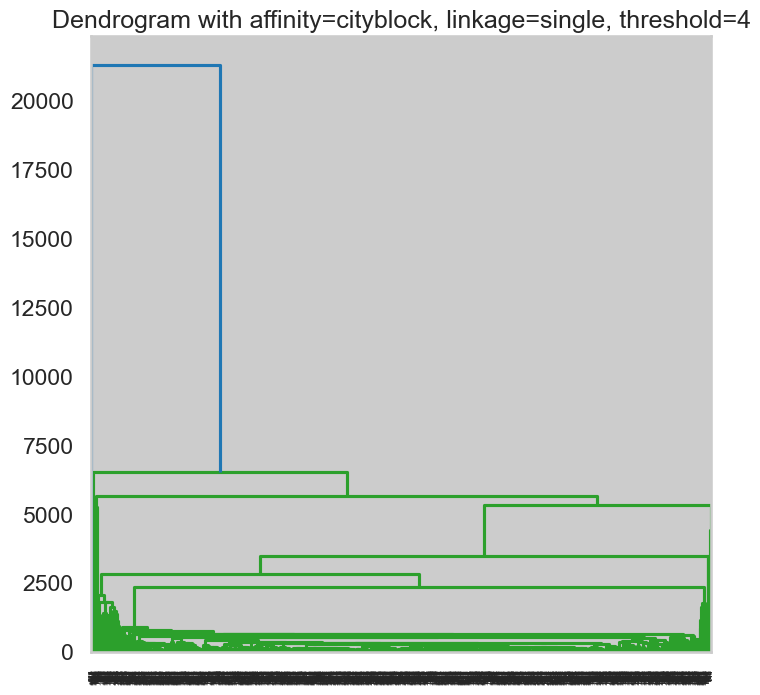

<Figure size 800x800 with 0 Axes>

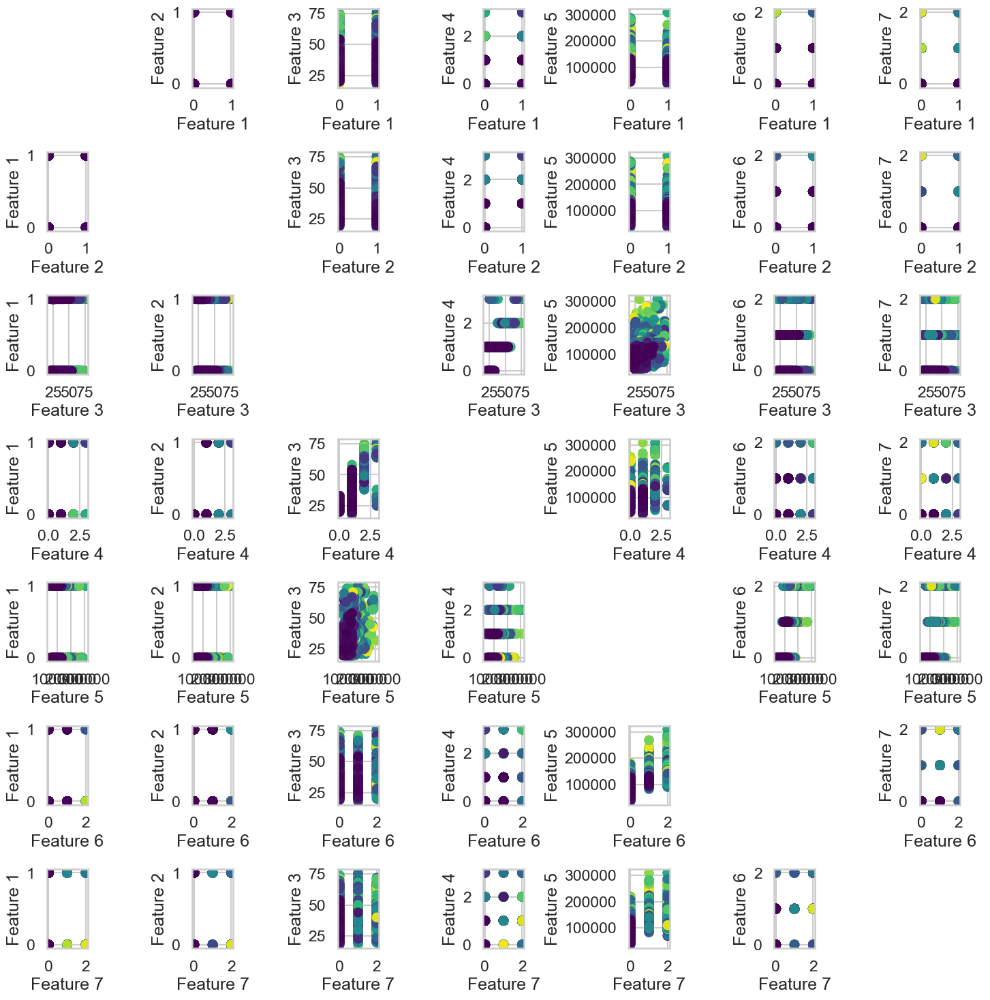

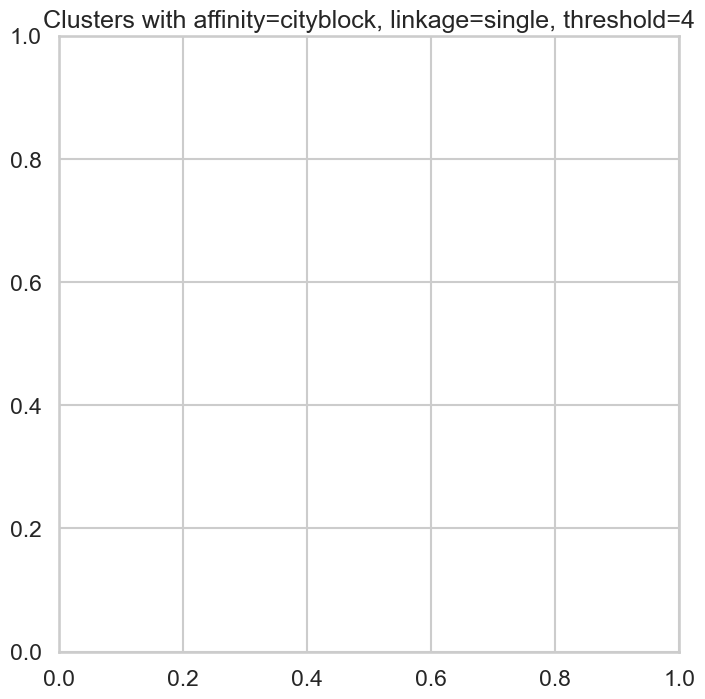

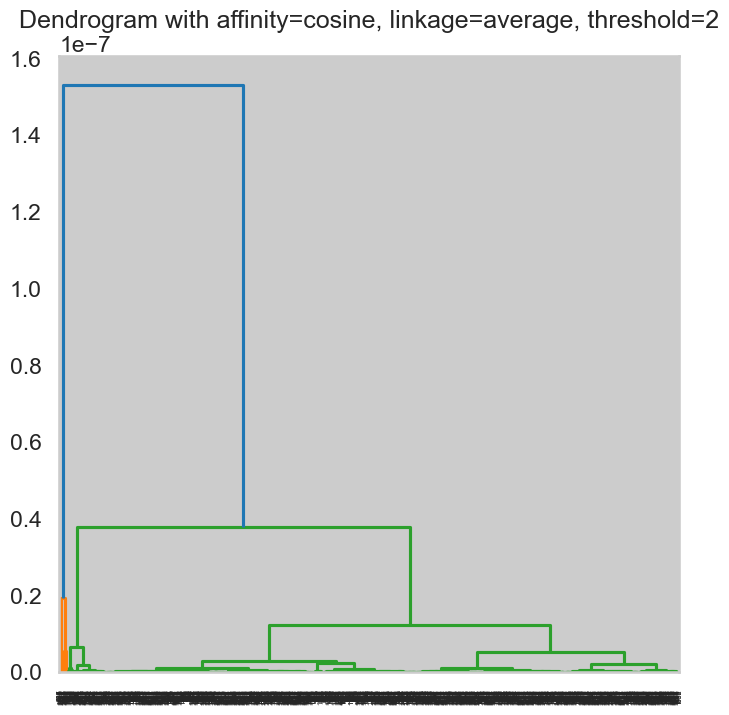

<Figure size 800x800 with 0 Axes>

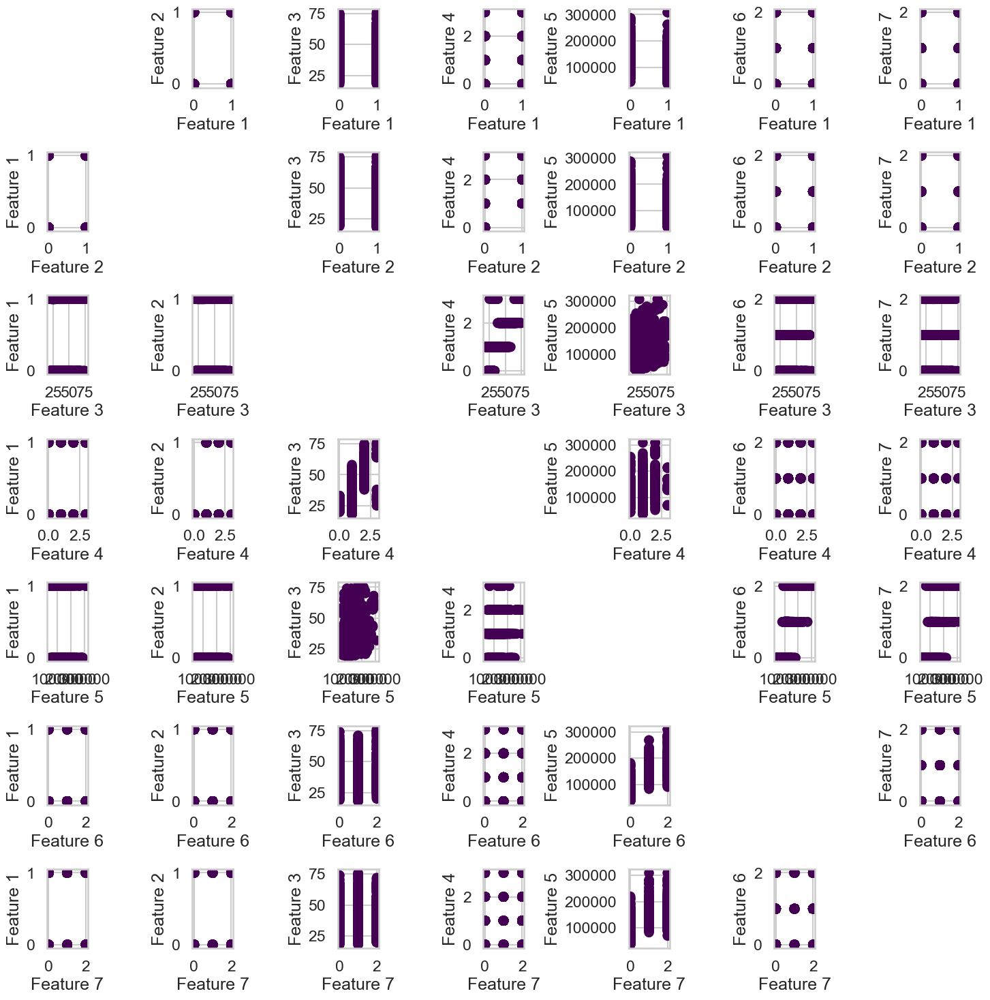

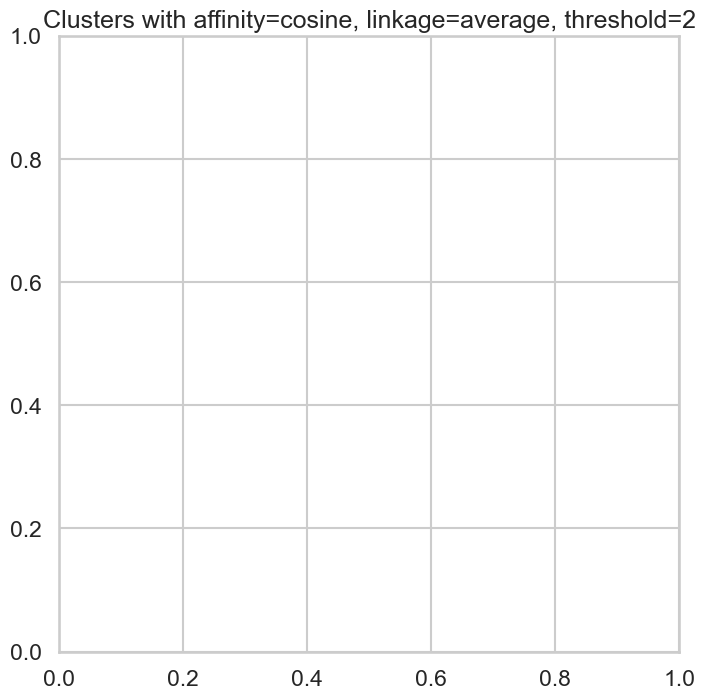

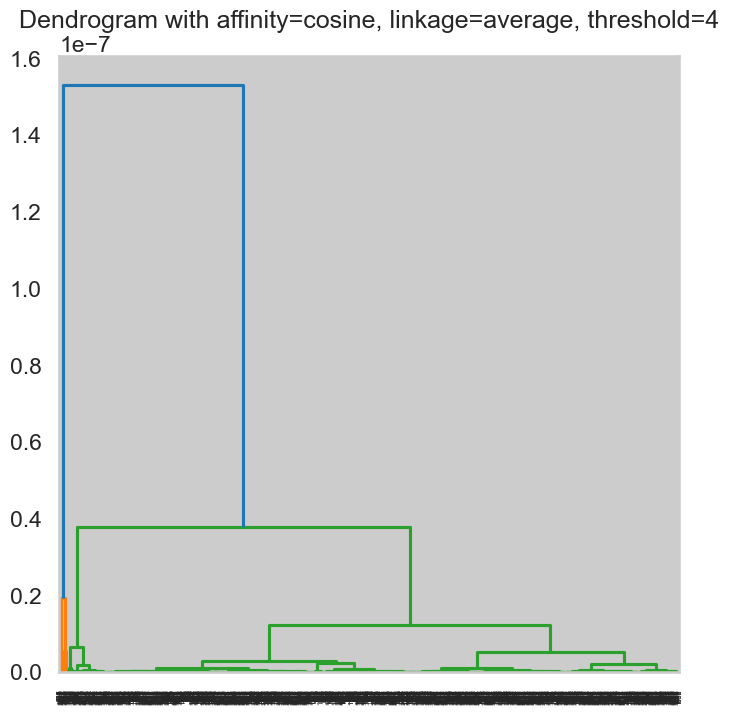

<Figure size 800x800 with 0 Axes>

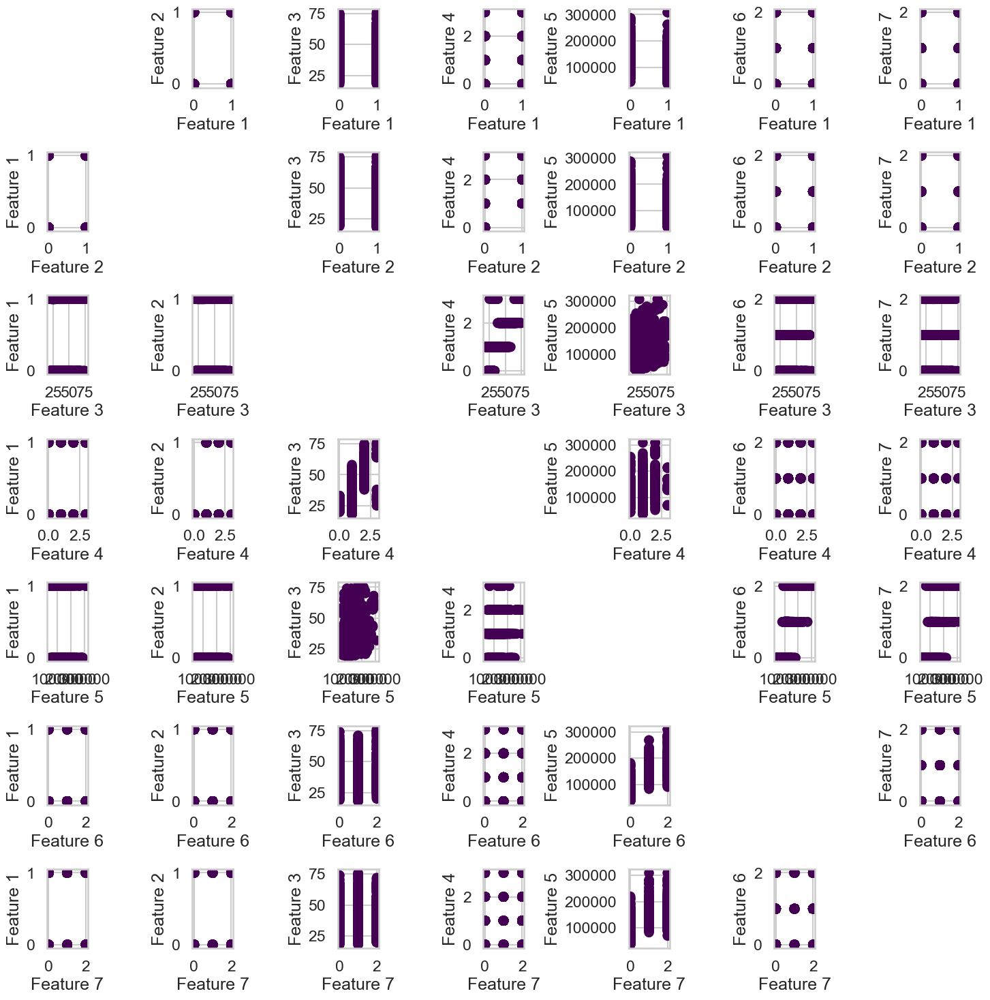

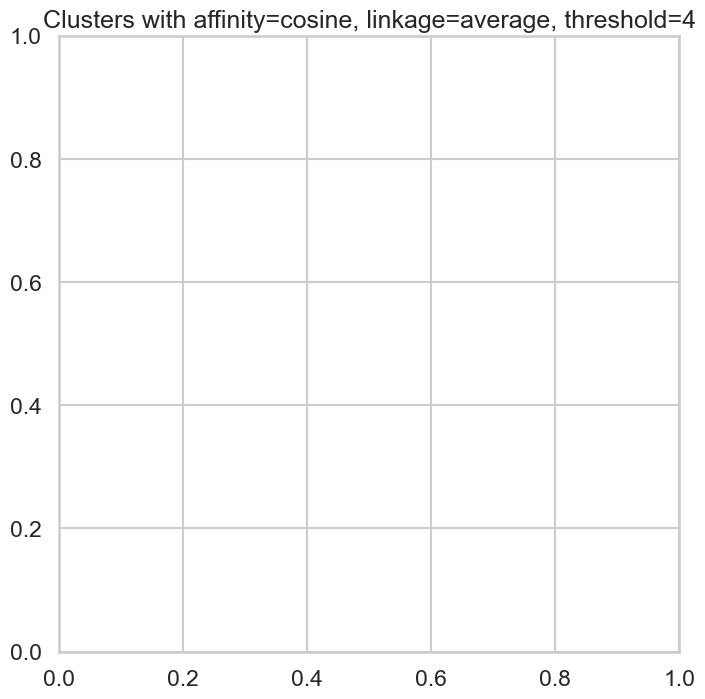

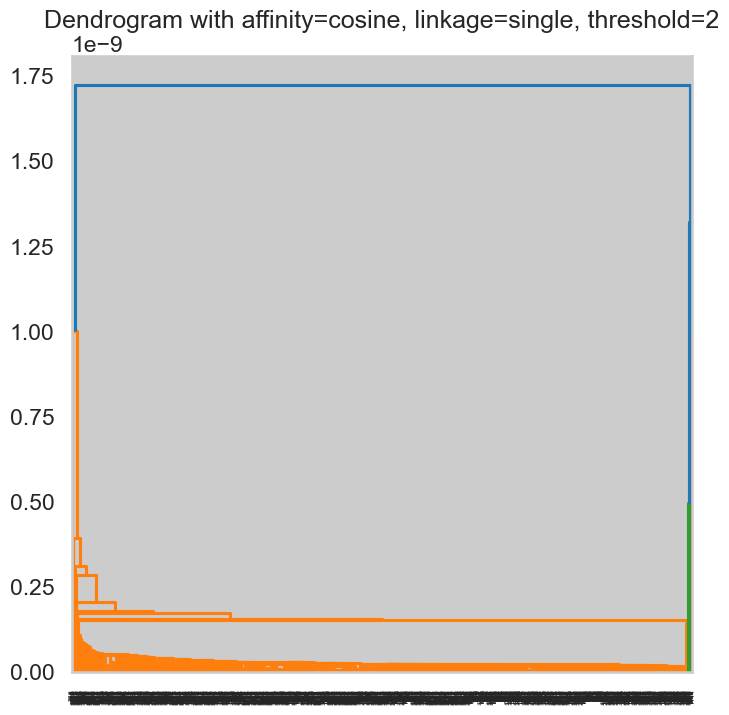

<Figure size 800x800 with 0 Axes>

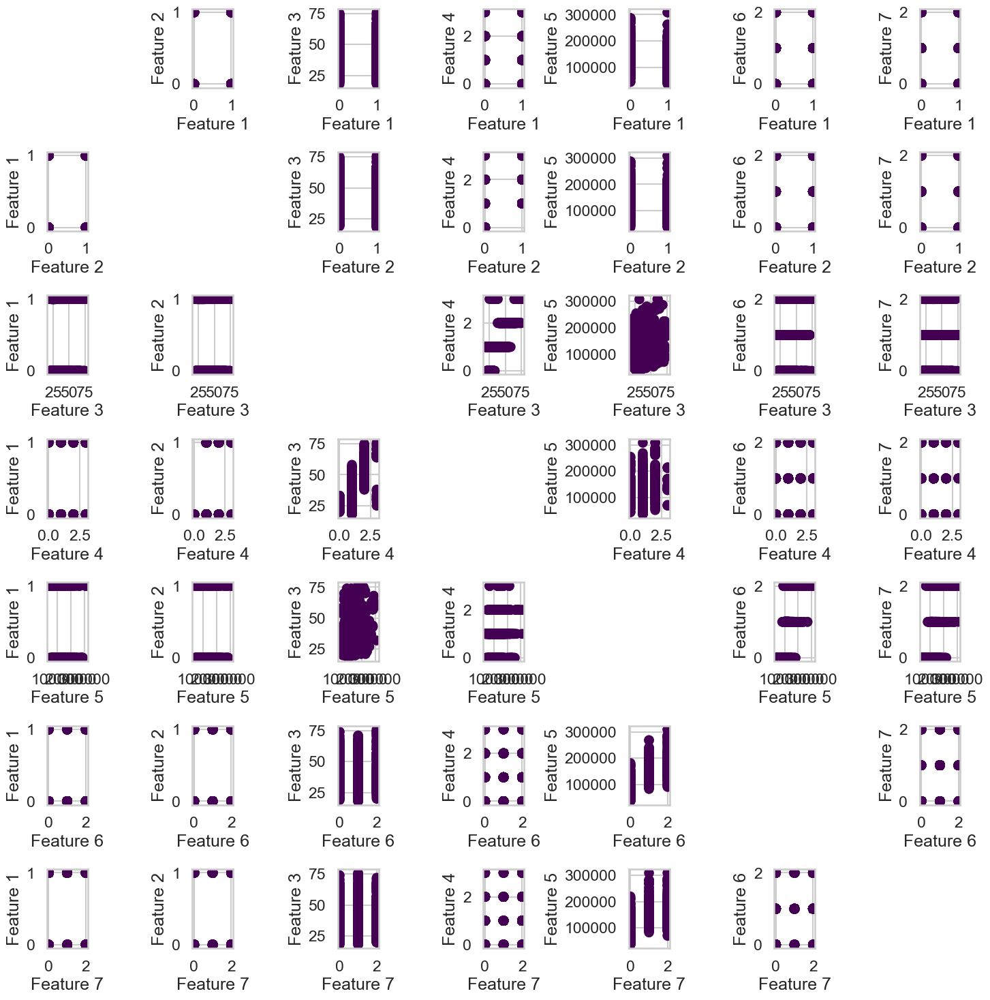

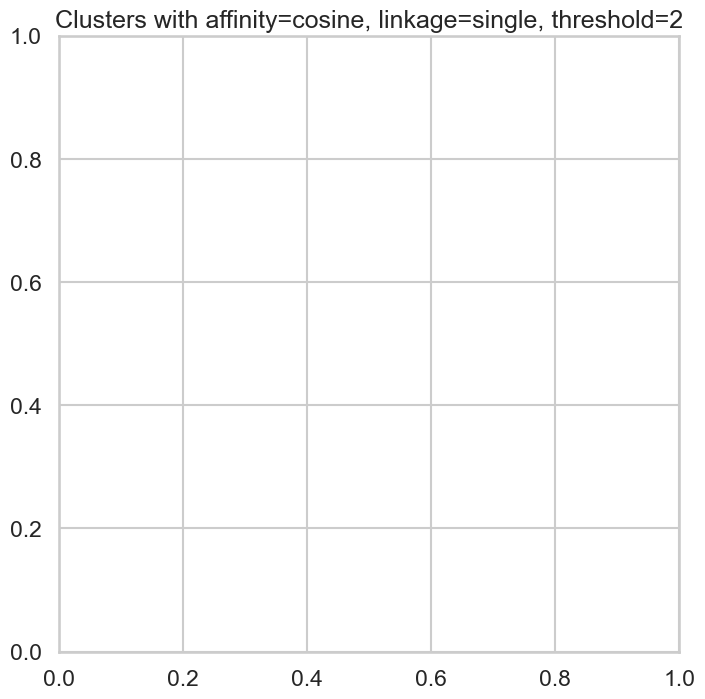

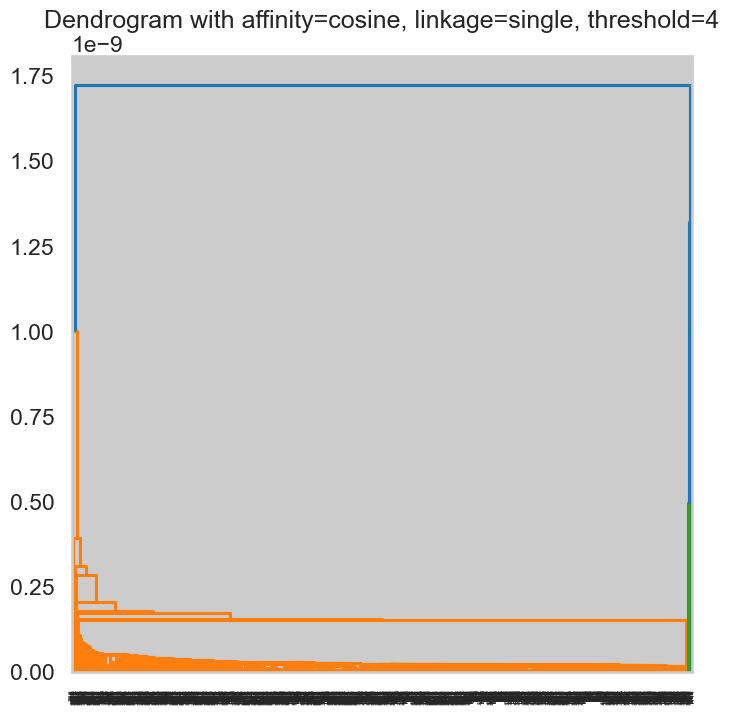

<Figure size 800x800 with 0 Axes>

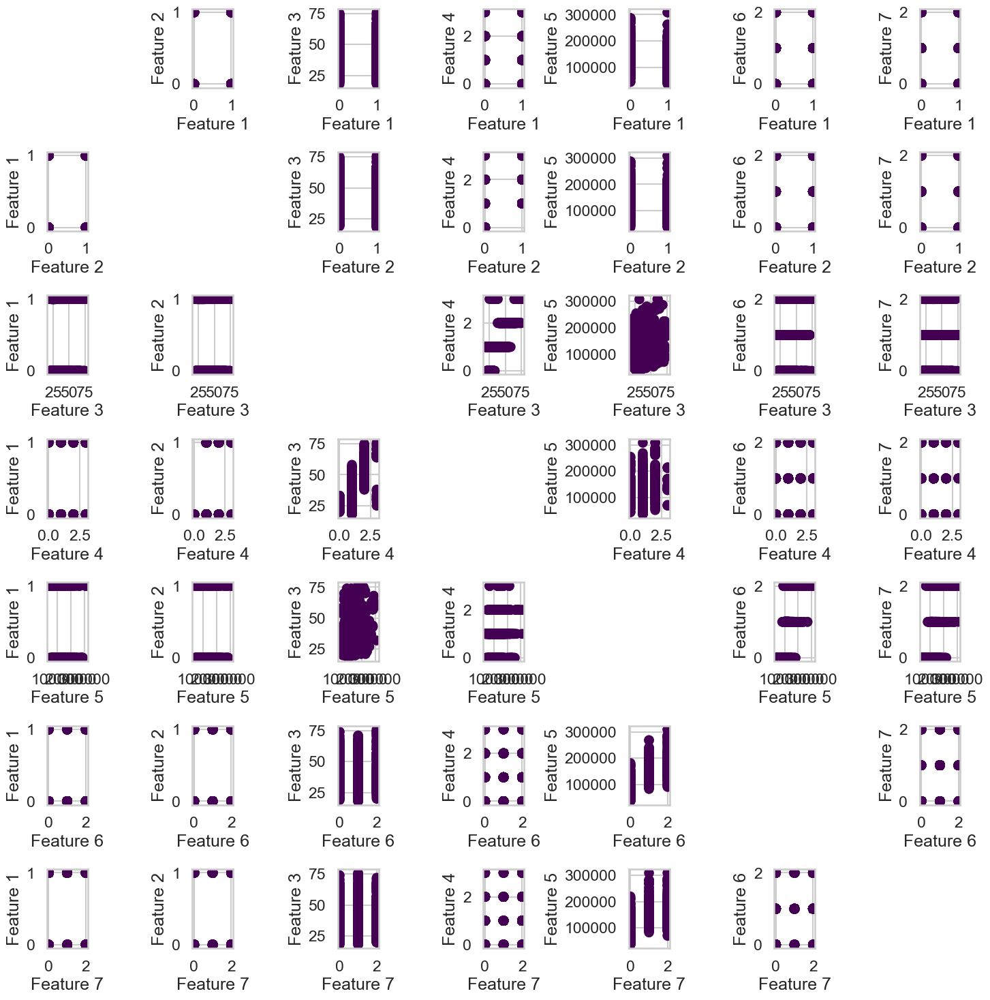

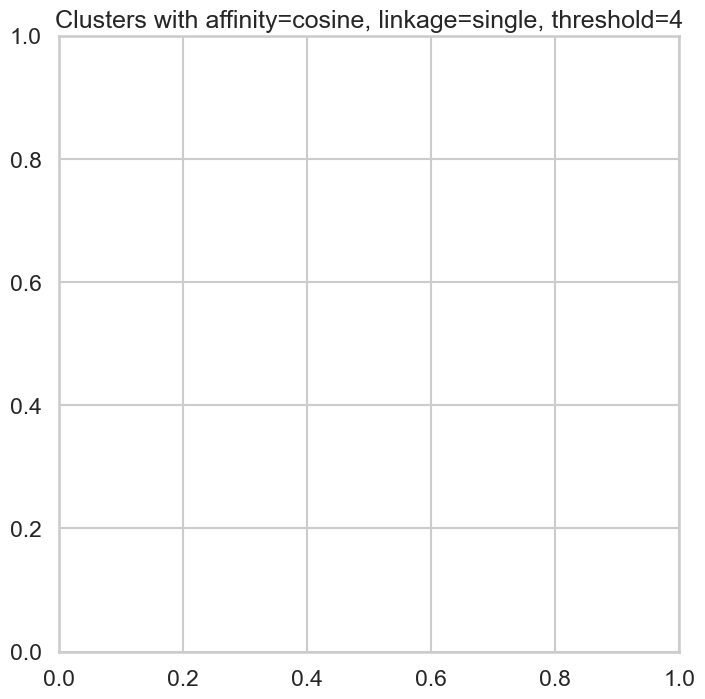

Best silhouette score: 0.017897881052075376 with params: ('euclidean', 'average', 4)


In [17]:
def display_cluster_new(data, model):
    num_features = data.shape[1]
    if num_features == 2:
        plt.scatter(data[:, 0], data[:, 1], c=model.labels_, cmap='viridis')
    else:
        fig, axs = plt.subplots(num_features, num_features, figsize=(15, 15))
        for i in range(num_features):
            for j in range(num_features):
                if i != j:
                    axs[i, j].scatter(data[:, i], data[:, j], c=model.labels_, cmap='viridis')
                    axs[i, j].set_xlabel(f'Feature {i+1}')
                    axs[i, j].set_ylabel(f'Feature {j+1}')
                else:
                    axs[i, j].axis('off')
        plt.tight_layout()
    plt.show()


plt.rcParams['figure.figsize'] = [8, 8]
sns.set_style("whitegrid")
sns.set_context("talk")

df = pd.read_csv(r'D:\Sems10\ML\Customer data.csv')

# Select all features except 'id'
X = df.drop(columns=['ID']).values  # Convert DataFrame to NumPy array
affinities = ['euclidean', 'cityblock', 'cosine']
linkages = ['average', 'single']
distance_thresholds = [2, 4]

best_silhouette_score = -1
best_params = None

for affinity in affinities:
    for linkage_method in linkages:
        for threshold in distance_thresholds:
            model = AgglomerativeClustering(n_clusters=None, affinity=affinity, linkage=linkage_method, distance_threshold=threshold)
            cluster_labels = model.fit_predict(X)
            if len(set(cluster_labels)) > 1:  # Check if there is more than one cluster
                silhouette_avg = silhouette_score(X, cluster_labels)
                if silhouette_avg > best_silhouette_score:
                    best_silhouette_score = silhouette_avg
                    best_params = (affinity, linkage_method, threshold)

            plt.figure()
            dendrogram(linkage(X, method=linkage_method, metric=affinity))
            plt.title(f"Dendrogram with affinity={affinity}, linkage={linkage_method}, threshold={threshold}")

            plt.figure()
            display_cluster_new(X, model)
            plt.title(f"Clusters with affinity={affinity}, linkage={linkage_method}, threshold={threshold}")
            plt.show()

print(f"Best silhouette score: {best_silhouette_score} with params: {best_params}")


<h1>DBscan</h1>

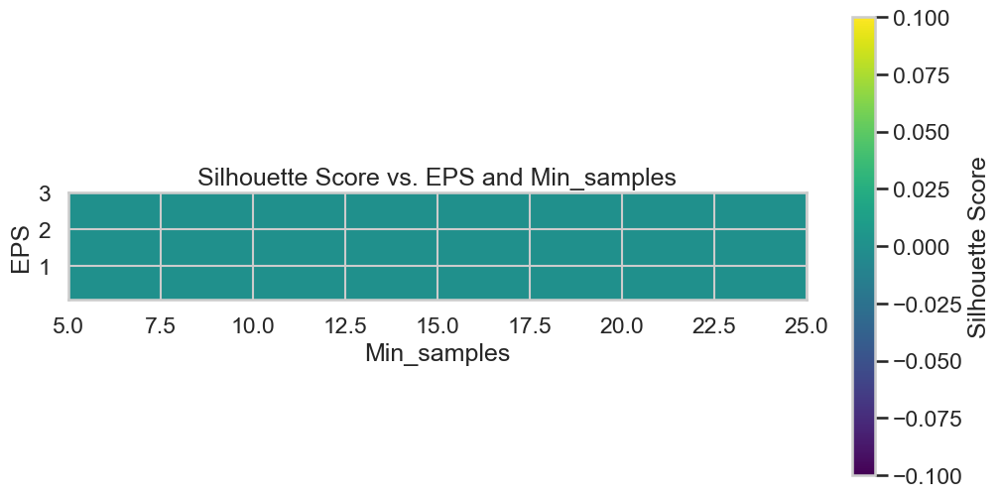

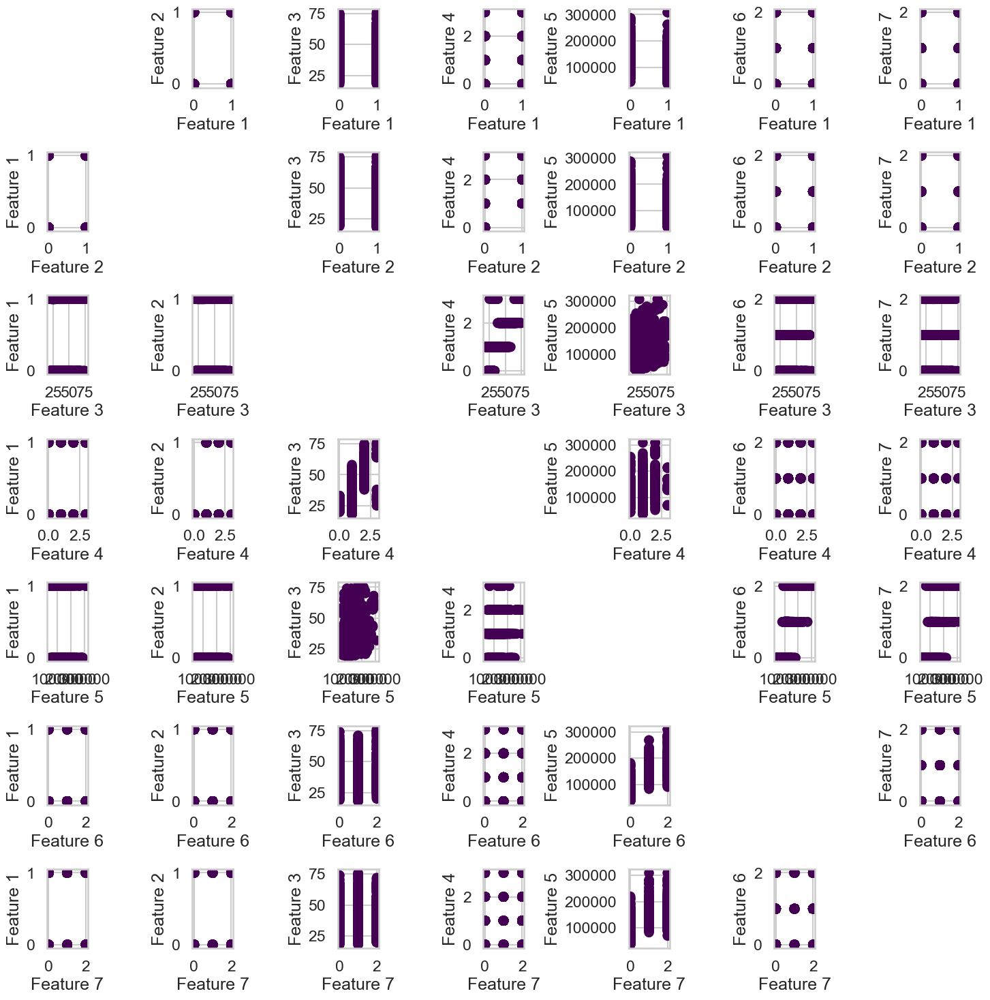

Best Silhouette Score: 0.0
Best EPS: 0.1, Best Min_samples: 5


In [19]:
from sklearn.cluster import DBSCAN
from sklearn.metrics import silhouette_score
import matplotlib.pyplot as plt
from sklearn.datasets import load_iris
import numpy as np

df = pd.read_csv(r'D:\Sems10\ML\Customer data.csv')

# Select all features except 'id'
X = df.drop(columns=['ID']).values  # Convert DataFrame to NumPy array

eps_range = np.arange(0.1, 3.1, 0.1)
min_samples_range = range(5, 26)
silhouette_scores = np.zeros((len(eps_range), len(min_samples_range)))

for i, eps in enumerate(eps_range):
    for j, min_samples in enumerate(min_samples_range):
        dbscan = DBSCAN(eps=eps, min_samples=min_samples)
        cluster_labels = dbscan.fit_predict(X)
        if len(np.unique(cluster_labels)) > 1:  # Check if more than one cluster (excluding noise) is found
            silhouette_scores[i, j] = silhouette_score(X, cluster_labels)

plt.figure(figsize=(12, 6))
plt.imshow(silhouette_scores, cmap='viridis', origin='lower', extent=[5, 25, 0.1, 3])
plt.colorbar(label='Silhouette Score')
plt.xlabel('Min_samples')
plt.ylabel('EPS')
plt.title('Silhouette Score vs. EPS and Min_samples')
plt.show()

best_eps, best_min_samples = np.unravel_index(np.argmax(silhouette_scores), silhouette_scores.shape)
best_dbscan = DBSCAN(eps=eps_range[best_eps], min_samples=min_samples_range[best_min_samples])
best_cluster_labels = best_dbscan.fit_predict(X)

# Plot all pairs of features
num_features = X.shape[1]
fig, axs = plt.subplots(num_features, num_features, figsize=(15, 15))
for i in range(num_features):
    for j in range(num_features):
        if i != j:
            axs[i, j].scatter(X[:, i], X[:, j], c=best_cluster_labels, cmap='viridis')
            axs[i, j].set_xlabel(f'Feature {i+1}')
            axs[i, j].set_ylabel(f'Feature {j+1}')
        else:
            axs[i, j].axis('off')
plt.tight_layout()
plt.show()

best_score = silhouette_scores[best_eps, best_min_samples]
print(f"Best Silhouette Score: {best_score}")
print(f"Best EPS: {eps_range[best_eps]}, Best Min_samples: {min_samples_range[best_min_samples]}")


<h1>Gaussian</h1>

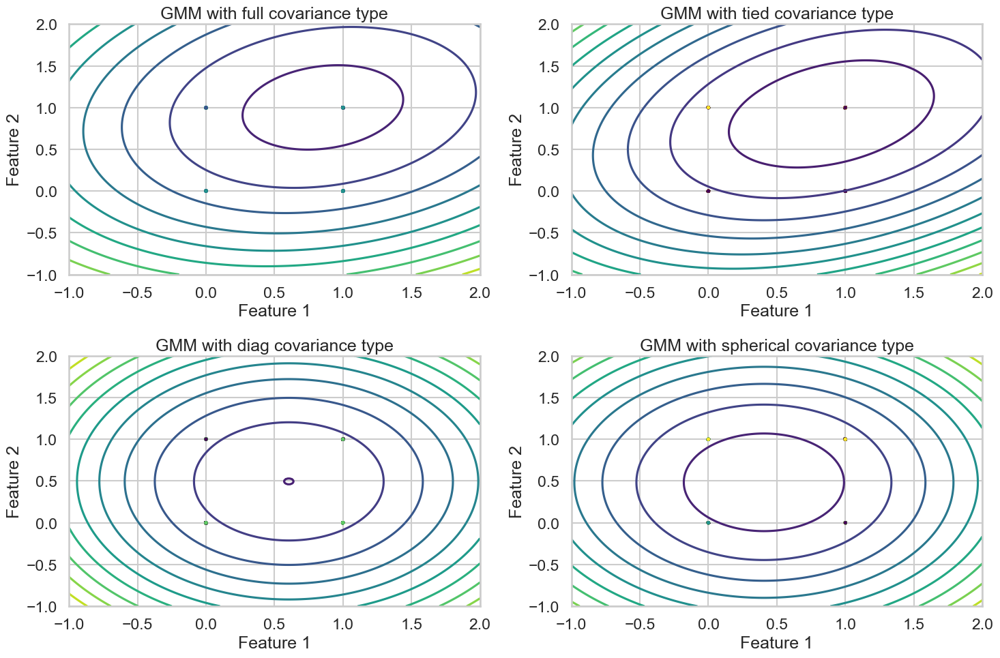

In [97]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.datasets import make_blobs
from sklearn.mixture import GaussianMixture
#Low Variability: The data points in that region may have very low variance, causing the Gaussian distribution to be narrow and have low density.
# Load the dataset
df = pd.read_csv(r'D:\Sems10\ML\Customer data.csv')

# Select all features except 'id'
X = df.drop(columns=['ID']).values  # Convert DataFrame to NumPy array

# Fit a Gaussian Mixture Model
n_components = 5  # Assuming 3 clusters for the dataset
covariance_types = ['full', 'tied', 'diag', 'spherical']
plt.figure(figsize=(15, 10))
for i, covariance_type in enumerate(covariance_types):
    gmm = GaussianMixture(n_components=n_components, covariance_type=covariance_type)
    gmm.fit(X)
    
    # Create a meshgrid to plot the distributions
    x_min, x_max = X[:, 0].min() - 1, X[:, 0].max() + 1
    y_min, y_max = X[:, 1].min() - 1, X[:, 1].max() + 1
    x = np.linspace(x_min, x_max, 200)
    y = np.linspace(y_min, y_max, 200)
    X_mesh, Y_mesh = np.meshgrid(x, y)
    XX = np.array([X_mesh.ravel(), Y_mesh.ravel(), np.zeros_like(X_mesh.ravel()), np.zeros_like(X_mesh.ravel()),
                   np.zeros_like(X_mesh.ravel()), np.zeros_like(X_mesh.ravel()), np.zeros_like(X_mesh.ravel())]).T
    Z = -gmm.score_samples(XX)
    Z = Z.reshape(X_mesh.shape)
    
    # Plot the contour plot
    plt.subplot(2, 2, i+1)
    plt.scatter(X[:, 0], X[:, 1], c=gmm.predict(X), cmap='viridis', s=5)
    plt.contour(X_mesh, Y_mesh, Z, levels=10, cmap='viridis')
    plt.title(f'GMM with {covariance_type} covariance type')
    plt.xlabel('Feature 1')
    plt.ylabel('Feature 2')

plt.tight_layout()
plt.show()



<h1>Gaussian with all features </h1>

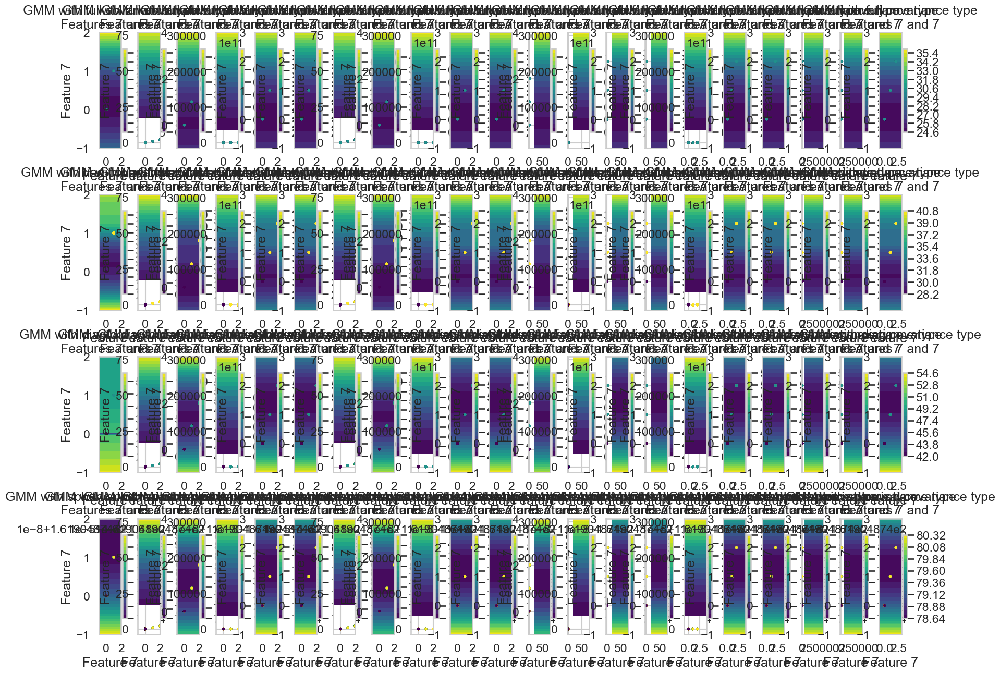

In [93]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.mixture import GaussianMixture

# Load the dataset
df = pd.read_csv(r'D:\Sems10\ML\Customer data.csv')

# Select all features except 'ID'
X = df.drop(columns=['ID']).values

# Assuming 3 clusters for the dataset
n_components = 3  
covariance_types = ['full', 'tied', 'diag', 'spherical']
plt.figure(figsize=(20, 15))

# Fit a Gaussian Mixture Model for each covariance type
for i, covariance_type in enumerate(covariance_types):
    gmm = GaussianMixture(n_components=n_components, covariance_type=covariance_type)
    gmm.fit(X)
    
    # Create meshgrids for all combinations of features to plot contour maps
    meshgrids = []
    for j in range(X.shape[1]):
        for k in range(j+1, X.shape[1]):
            x_min, x_max = X[:, j].min() - 1, X[:, j].max() + 1
            y_min, y_max = X[:, k].min() - 1, X[:, k].max() + 1
            x = np.linspace(x_min, x_max, 100)
            y = np.linspace(y_min, y_max, 100)
            X_mesh, Y_mesh = np.meshgrid(x, y)
            meshgrids.append((X_mesh, Y_mesh))

    # Plot the contour plots
    for idx, (X_mesh, Y_mesh) in enumerate(meshgrids):
        plt.subplot(len(covariance_types), len(meshgrids), i*len(meshgrids) + idx + 1)
        if X.shape[1] > 1:
            XX = np.zeros((X_mesh.size, X.shape[1]))
            XX[:, j] = X_mesh.ravel()
            XX[:, k] = Y_mesh.ravel()
            Z = -gmm.score_samples(XX)
            Z = Z.reshape(X_mesh.shape)
            plt.contourf(X_mesh, Y_mesh, Z, levels=20, cmap='viridis')
            plt.colorbar()
            plt.scatter(X[:, j], X[:, k], c=gmm.predict(X), cmap='viridis', s=5)
            plt.title(f'GMM with {covariance_type} covariance type\nFeatures {j+1} and {k+1}')
            plt.xlabel(f'Feature {j+1}')
            plt.ylabel(f'Feature {k+1}')

plt.subplots_adjust(wspace=0.4, hspace=0.4)  # Adjust spacing between subplots
plt.tight_layout()
plt.show()


<h1>Observations on the 4 algorithms before normalization </h1>

**Surprisingly, the DBscan couldn't cluster the data at all.**

**The KMeans is considered the best after achieving silhouette score 0.583.**

<h1>After Normalization</h1>

<h1>KMeans</h1>

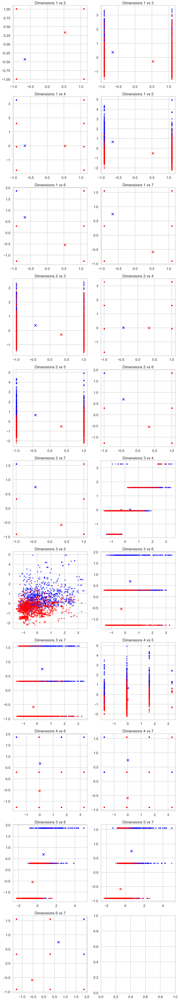

<Figure size 800x800 with 0 Axes>

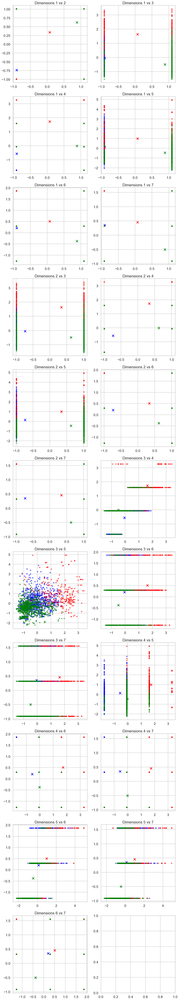

<Figure size 800x800 with 0 Axes>

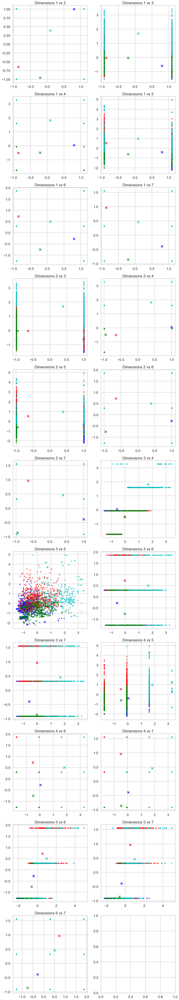

<Figure size 800x800 with 0 Axes>

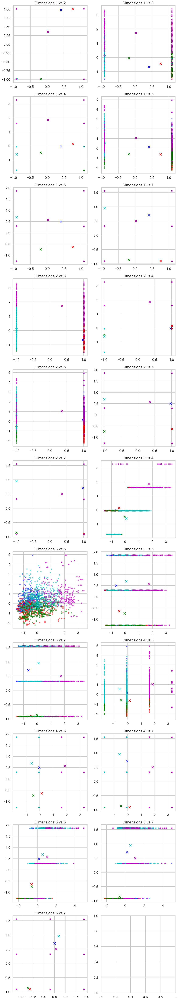

<Figure size 800x800 with 0 Axes>

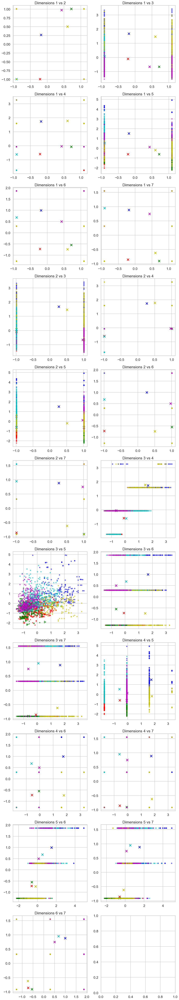

<Figure size 800x800 with 0 Axes>

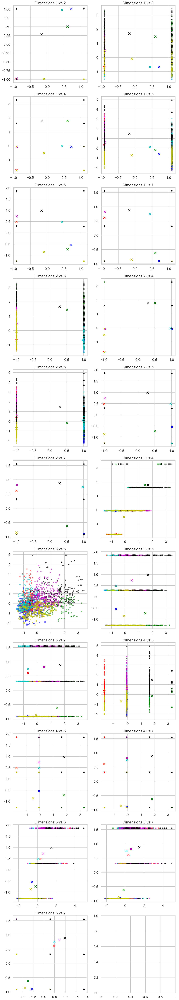

<Figure size 800x800 with 0 Axes>

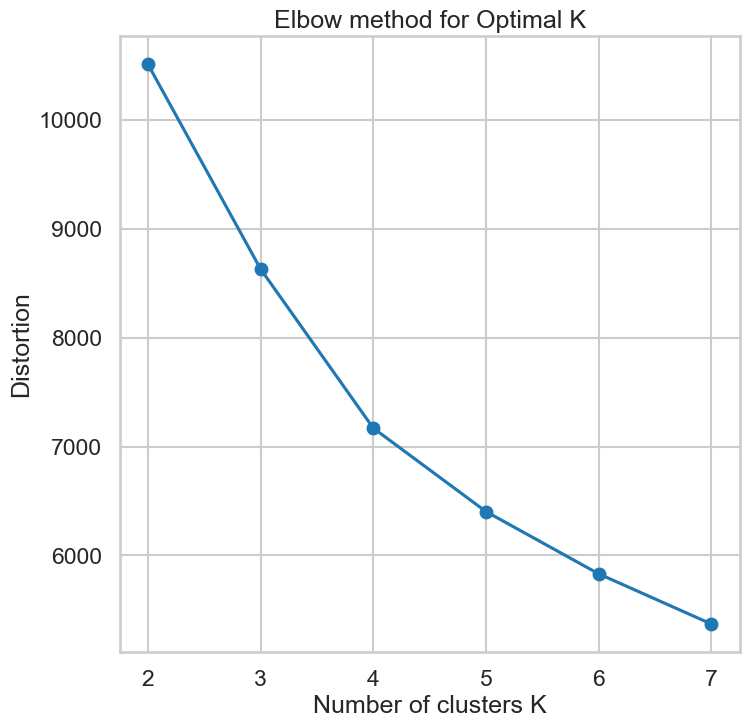

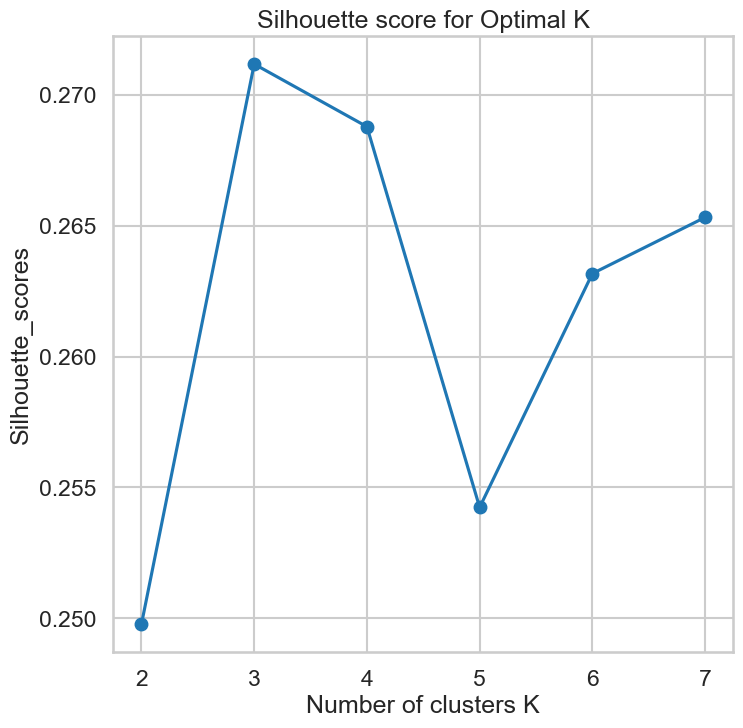

Best K: 3, Best silhouette score: 0.2711846855734802


In [44]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.preprocessing import StandardScaler
import pandas as pd
def display_cluster_ND(X, cluster_assignments=[], centroids=[], num_clusters=0):
    color = 'brgcmyk'
    alpha = 0.5
    s = 20

    num_dimensions = X.shape[1]
    num_plots = num_dimensions * (num_dimensions - 1) // 2

    fig, axs = plt.subplots(num_plots // 2 + num_plots % 2, 2, figsize=(12, 6 * (num_plots // 2 + num_plots % 2)))

    plot_index = 0
    for i in range(num_dimensions):
        for j in range(i + 1, num_dimensions):
            ax = axs[plot_index // 2, plot_index % 2] if num_plots > 1 else axs
            plot_index += 1
            ax.set_title(f'Dimensions {i + 1} vs {j + 1}')

            if num_clusters == 0:
                ax.scatter(X[:, i], X[:, j], c=color[0], alpha=alpha, s=s)
            else:
                for k in range(num_clusters):
                    ax.scatter(X[cluster_assignments == k, i], X[cluster_assignments == k, j], c=color[k], alpha=alpha, s=s)
                    ax.scatter(centroids[k][i], centroids[k][j], c=color[k], marker='x', s=100)

    plt.tight_layout()
    plt.show()


# Load the data
df = pd.read_csv(r'D:\Sems10\ML\Customer data.csv')

# Select all features except 'id'
df_new = df.drop(columns=['ID'])
scaler = StandardScaler()
X = scaler.fit_transform(df_new)

# Fit KMeans with different values of K
k_values = [2, 3, 4, 5, 6, 7]
for k in k_values:
    km = KMeans(n_clusters=k, random_state=42)
    km.fit(X)
    centroids = km.cluster_centers_
    display_cluster_ND(X, km.labels_, centroids, k)
    plt.suptitle(f"KMeans Clustering with K={k}", y=1.02)
    plt.show()

# Elbow method for optimal K
distortions = []
for k in k_values:
    km = KMeans(n_clusters=k, random_state=42)
    km.fit(X)
    distortions.append(km.inertia_)

plt.plot(k_values, distortions, marker='o')
plt.xlabel('Number of clusters K')
plt.ylabel('Distortion')
plt.title("Elbow method for Optimal K")
plt.show()

# Silhouette score for optimal K
silhouette_scores = []
for k in k_values:
    km = KMeans(n_clusters=k, random_state=42)
    km.fit(X)
    silhouette_scores.append(silhouette_score(X, km.labels_))

plt.plot(k_values, silhouette_scores, marker='o')
plt.xlabel('Number of clusters K')
plt.ylabel('Silhouette_scores')
plt.title("Silhouette score for Optimal K")
plt.show()

# Find the best K and its silhouette score
best_k = k_values[silhouette_scores.index(max(silhouette_scores))]
print(f'Best K: {best_k}, Best silhouette score: {max(silhouette_scores)}')


<h1>Agglomerative Clustering</h1>

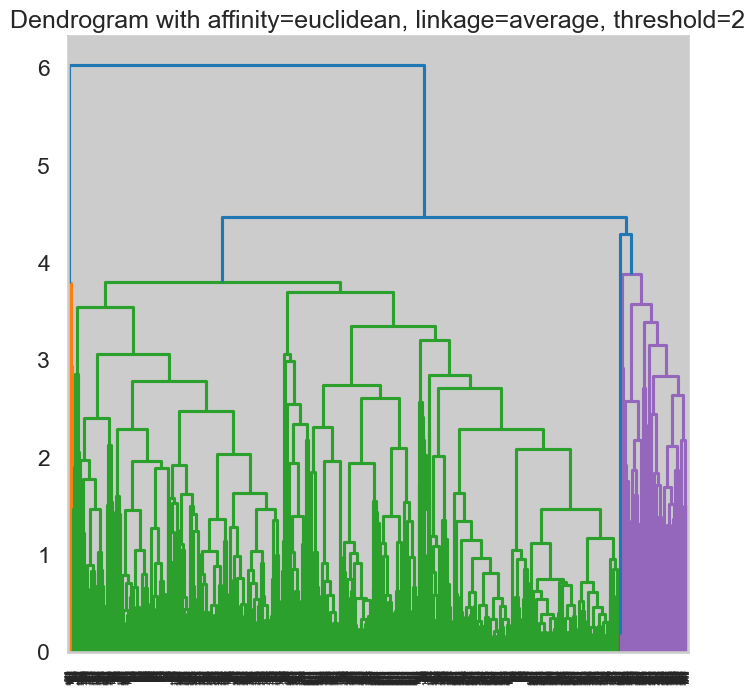

<Figure size 800x800 with 0 Axes>

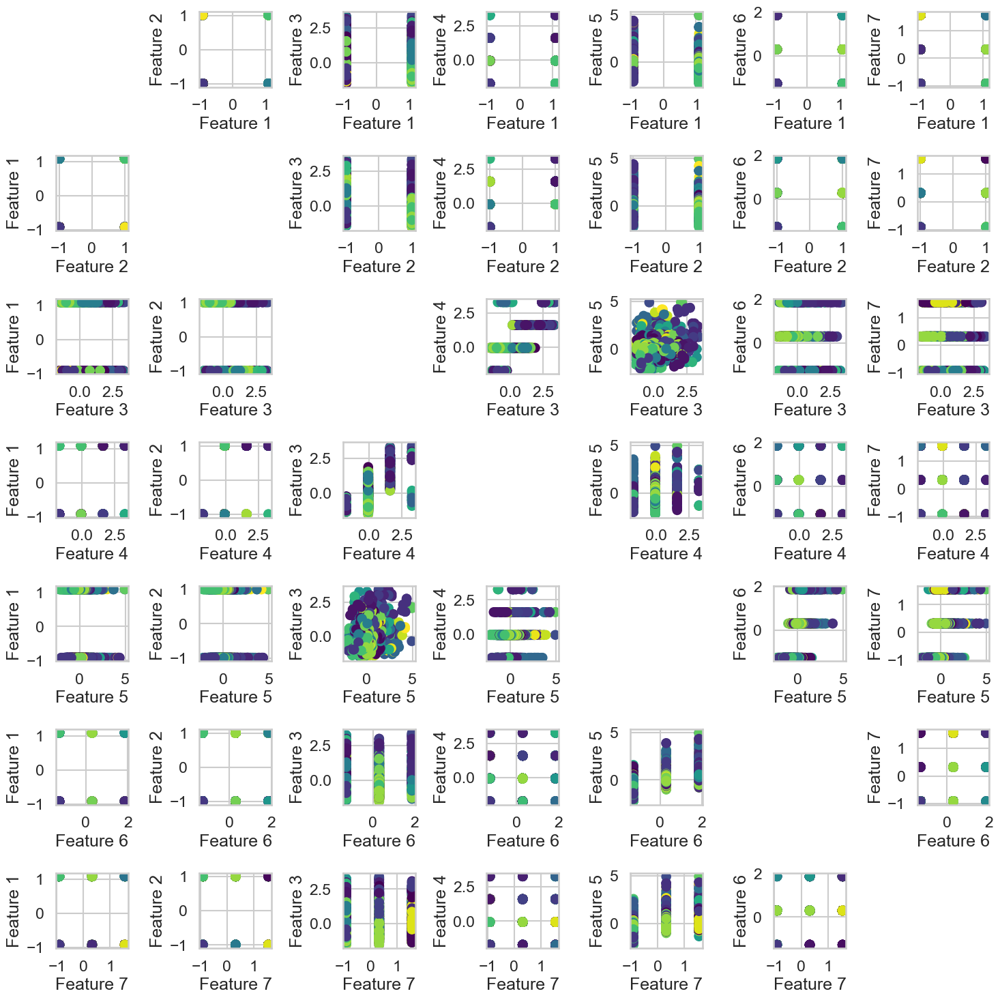

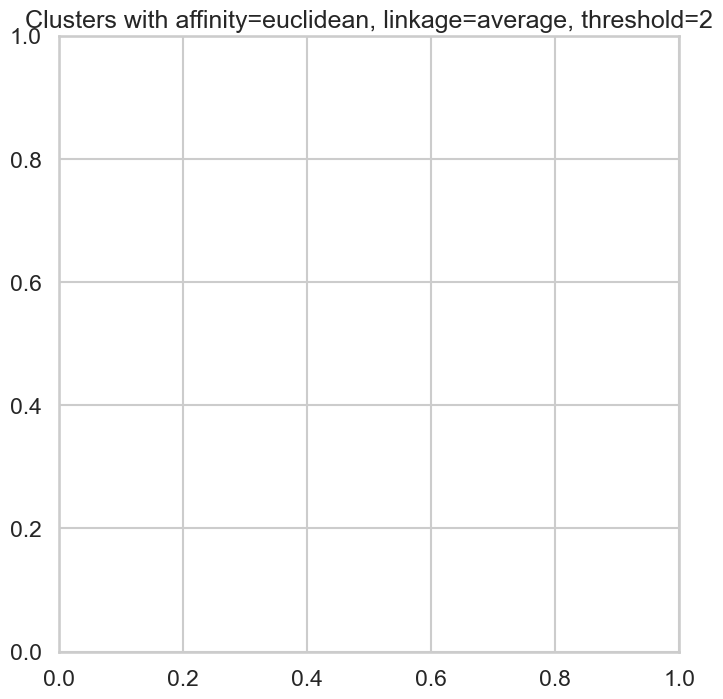

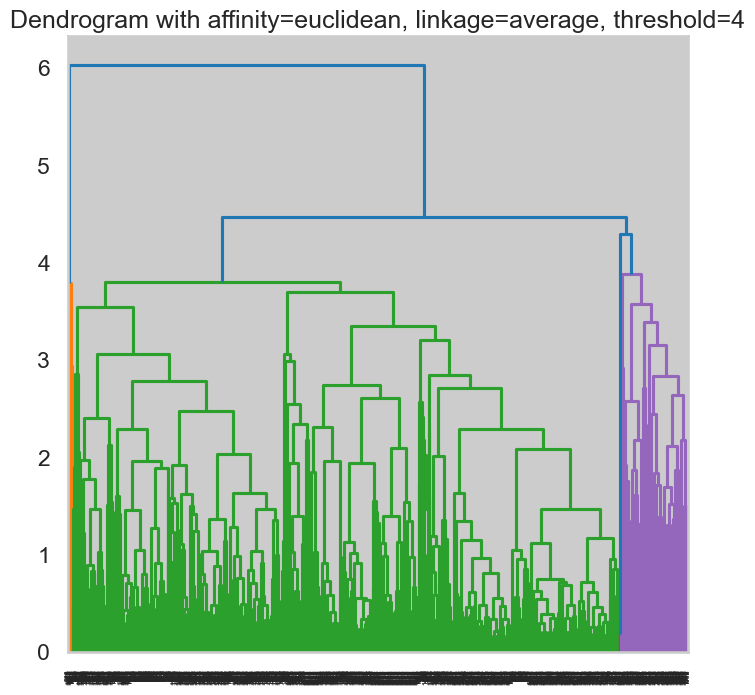

<Figure size 800x800 with 0 Axes>

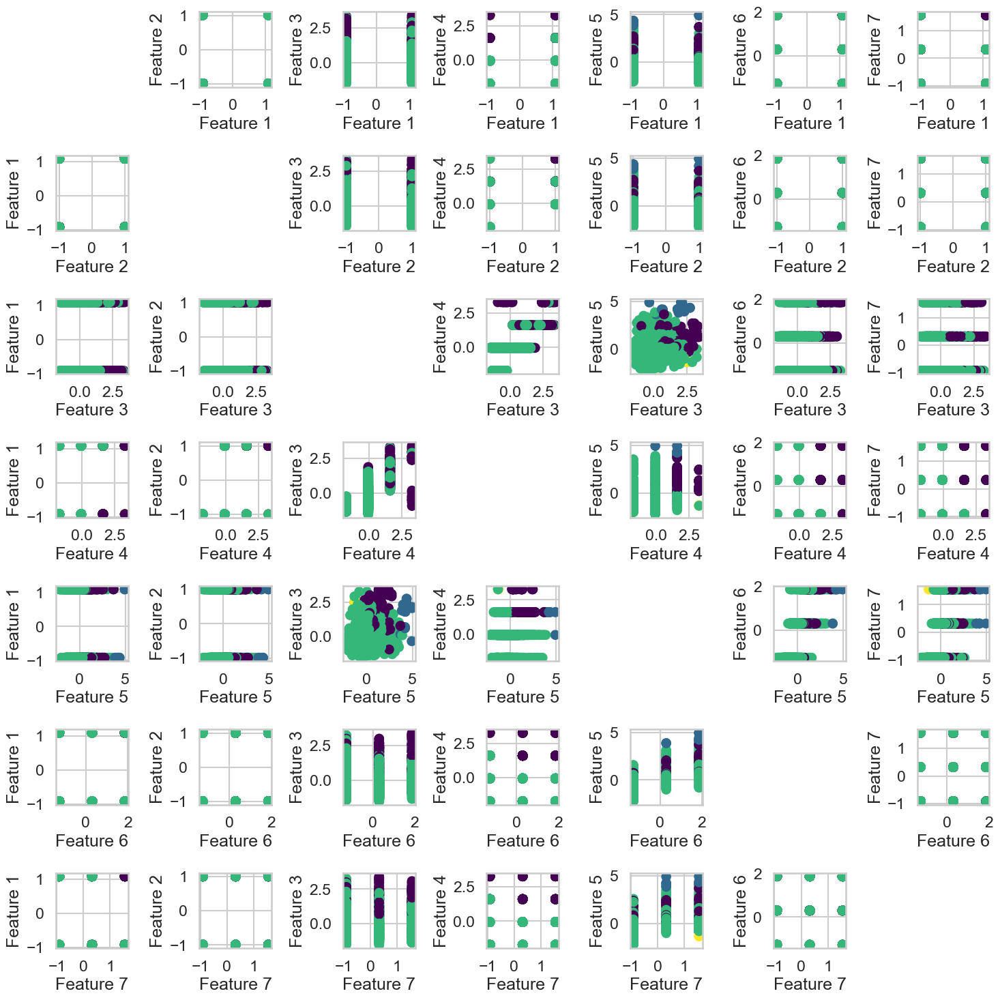

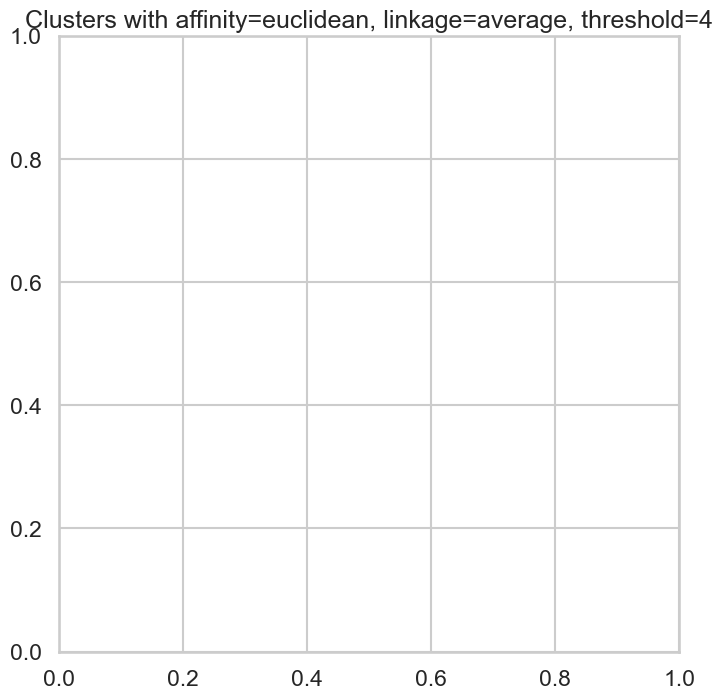

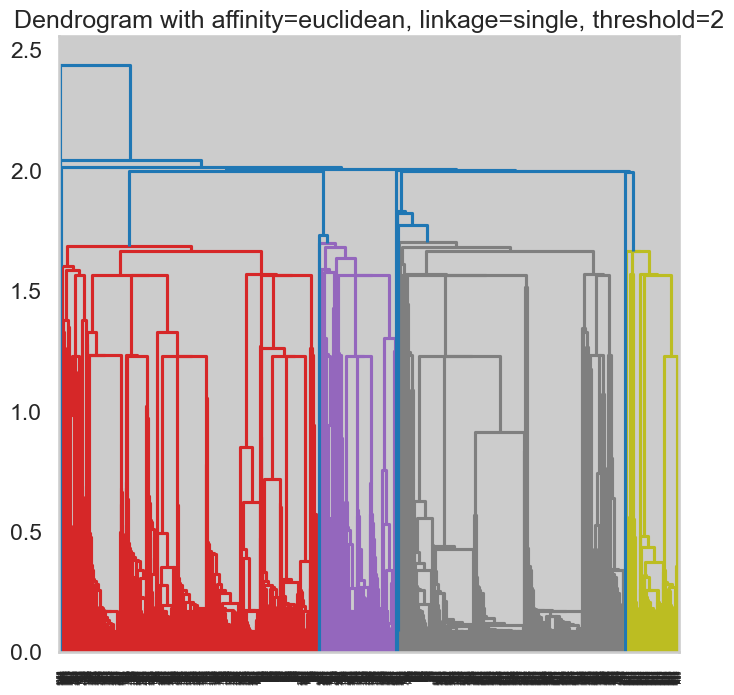

<Figure size 800x800 with 0 Axes>

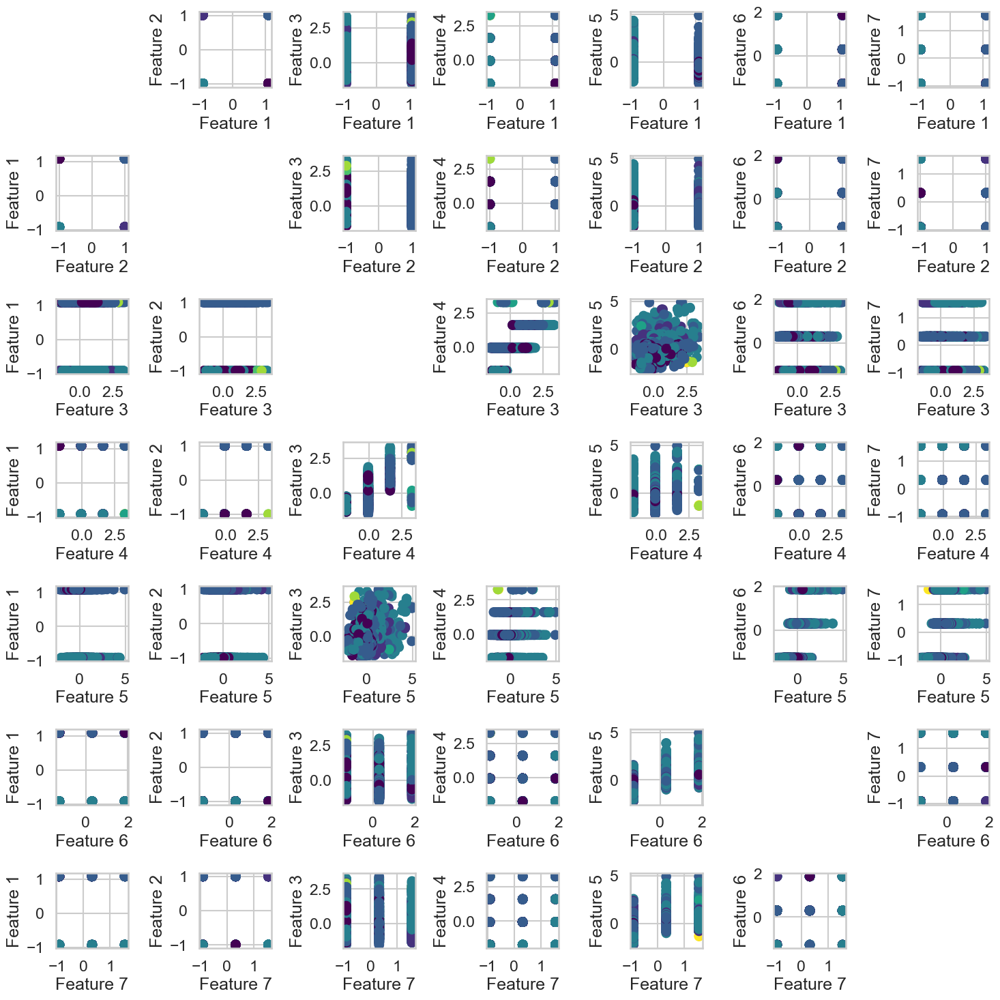

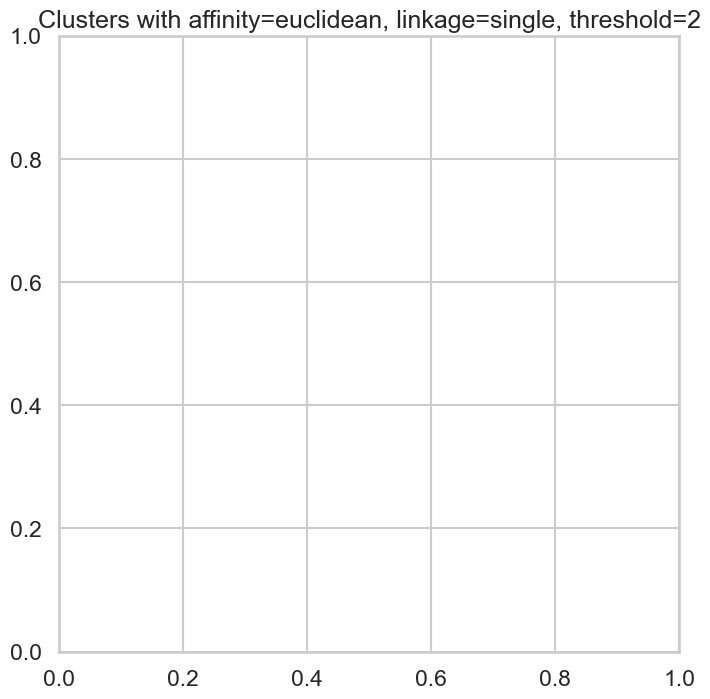

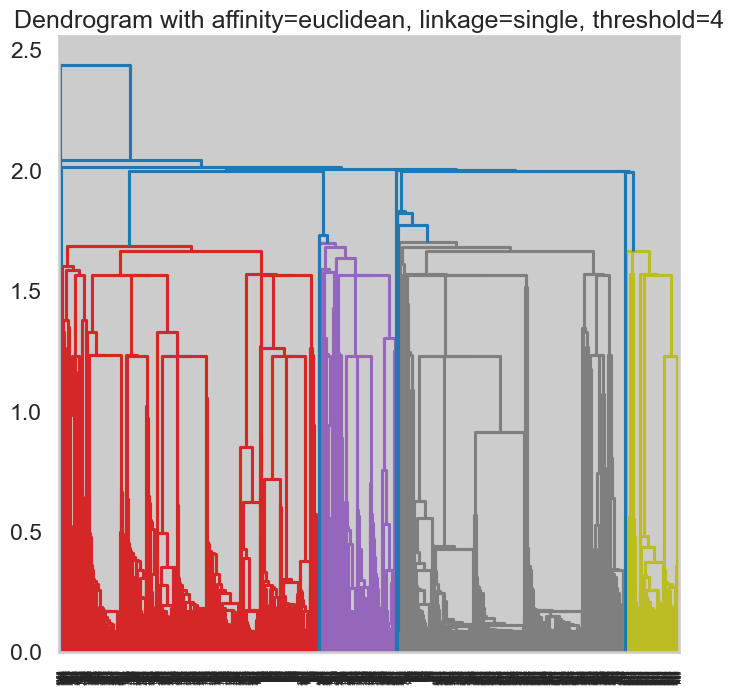

<Figure size 800x800 with 0 Axes>

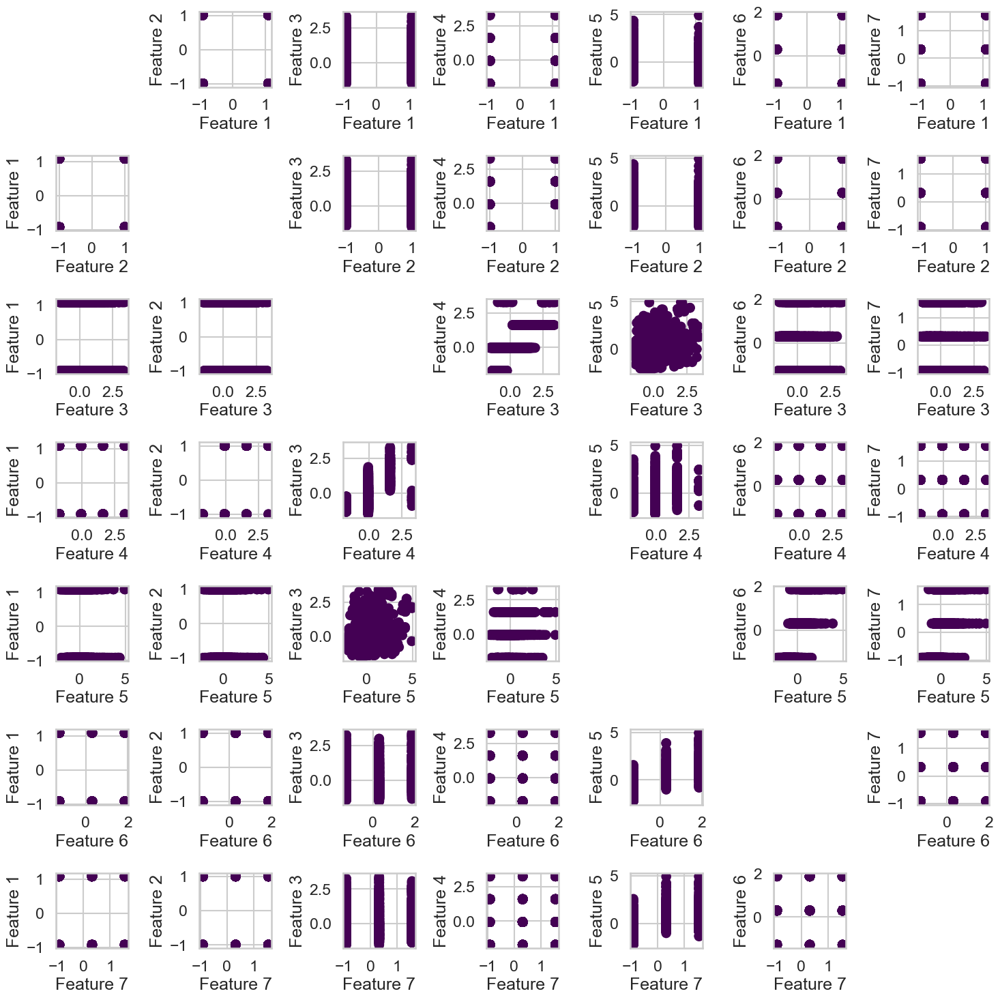

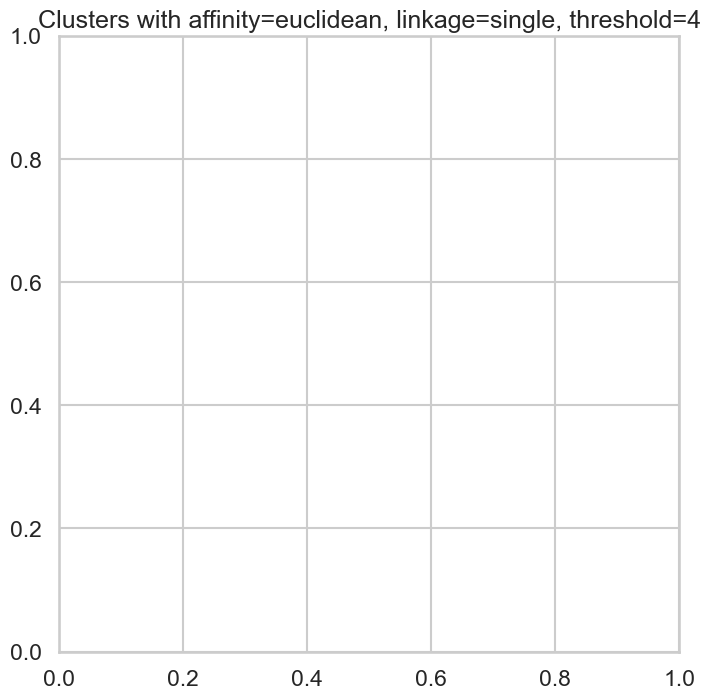

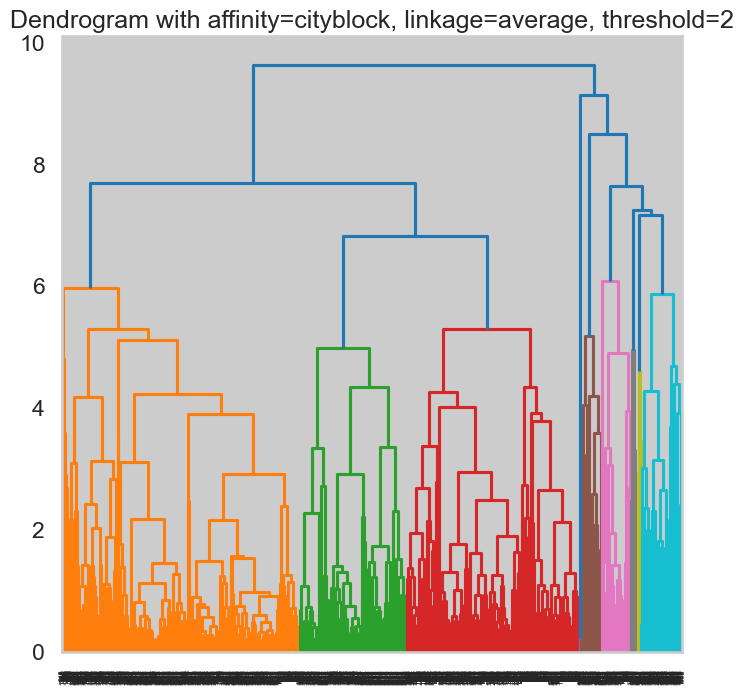

<Figure size 800x800 with 0 Axes>

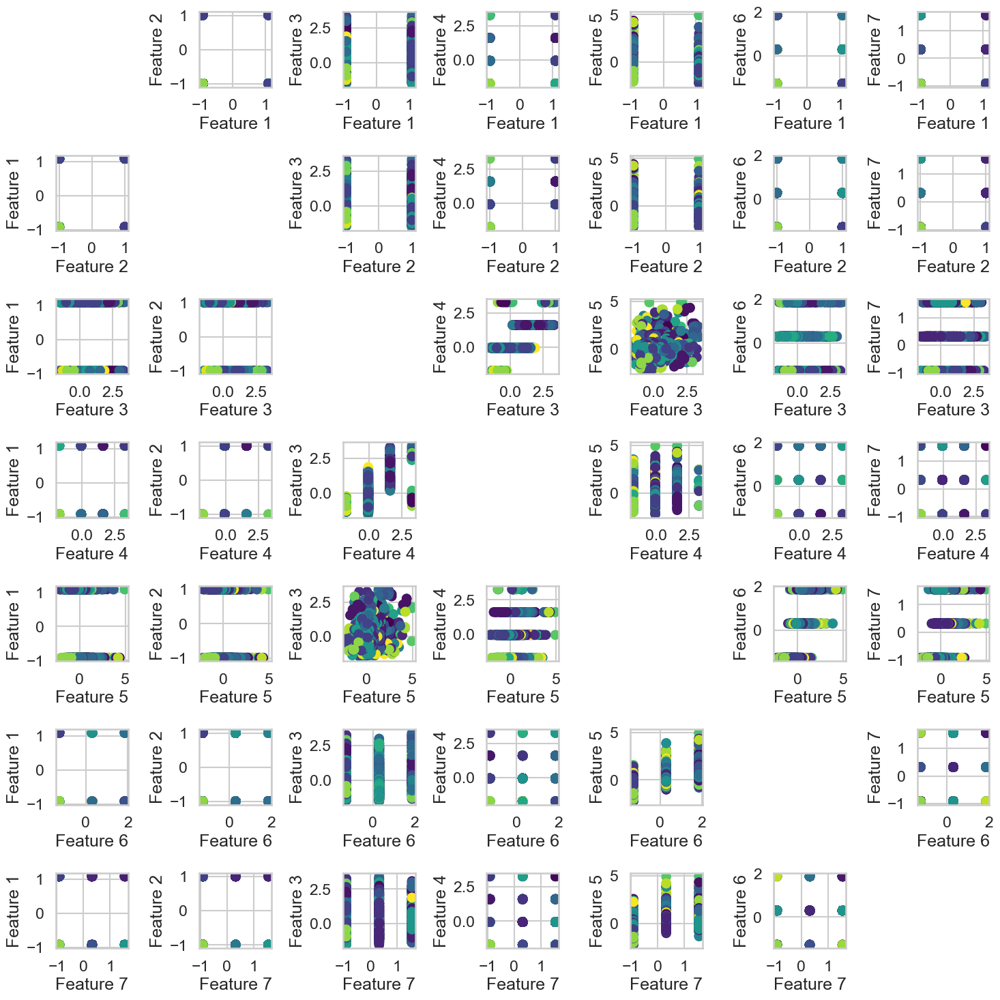

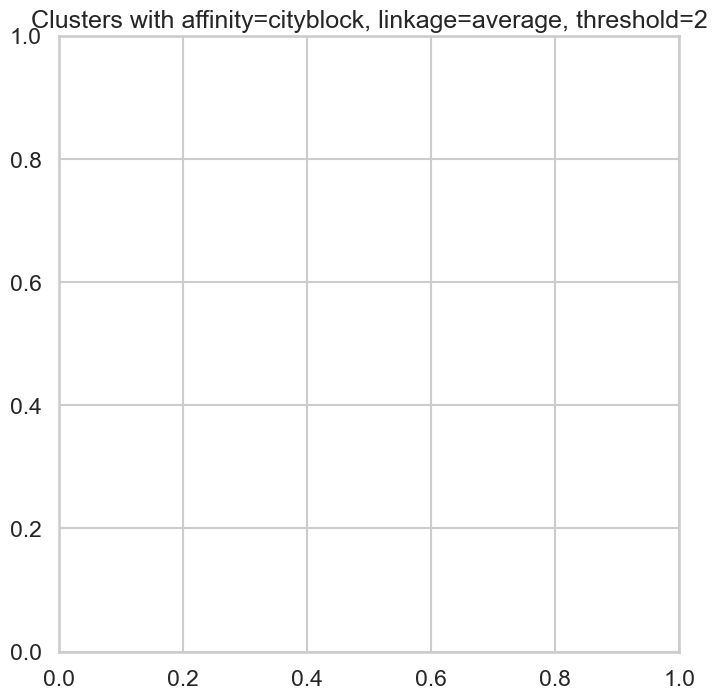

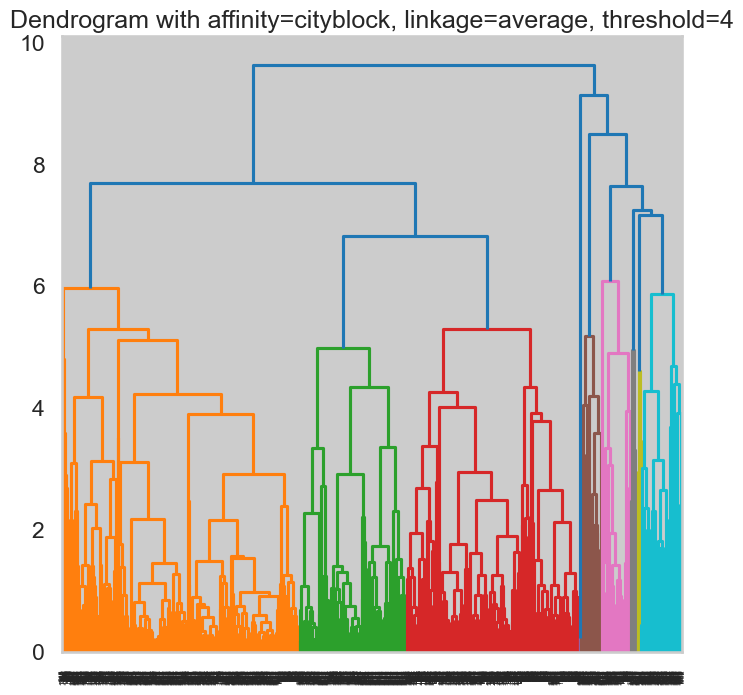

<Figure size 800x800 with 0 Axes>

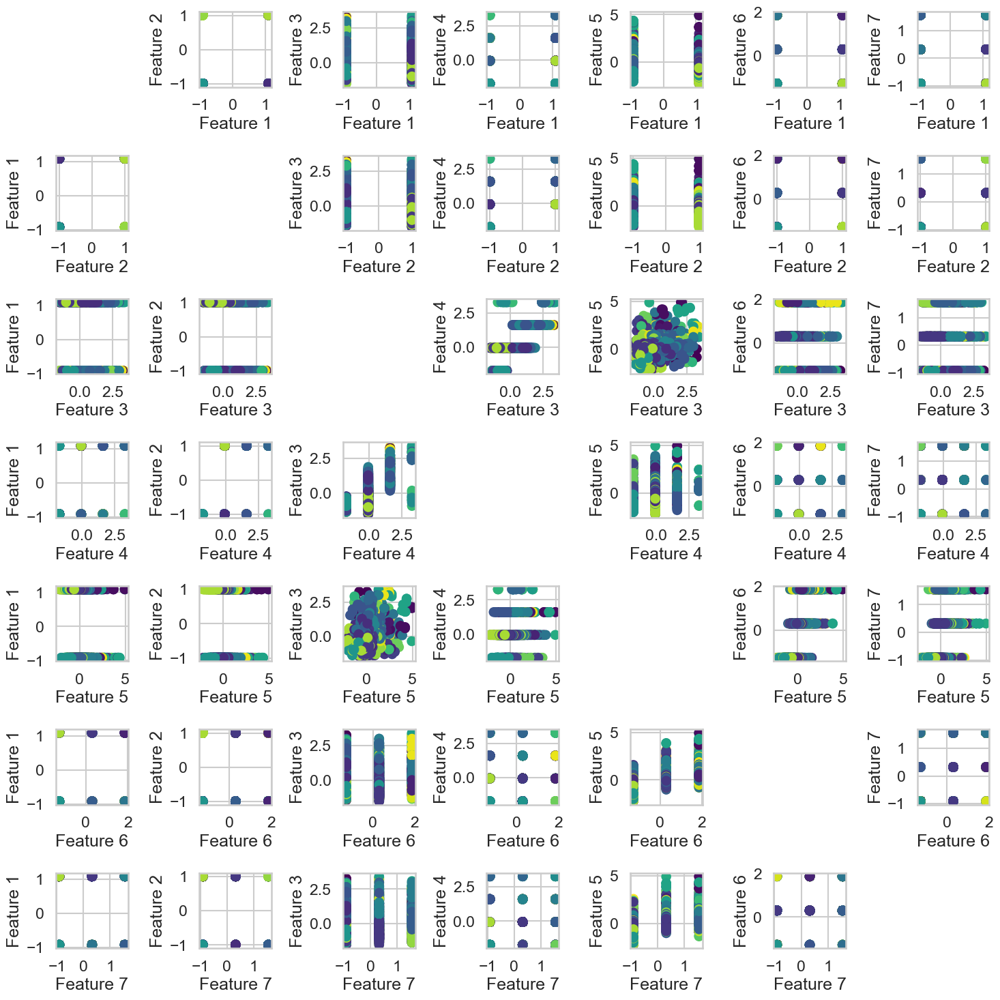

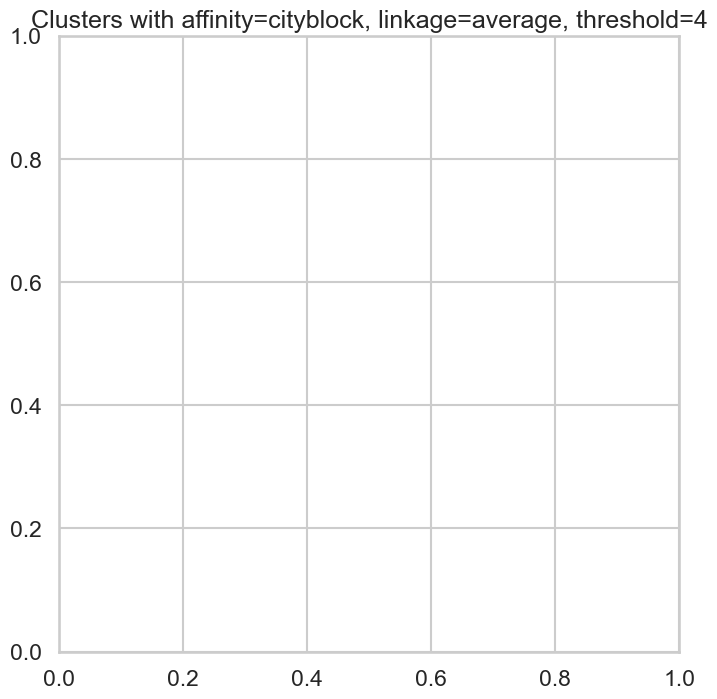

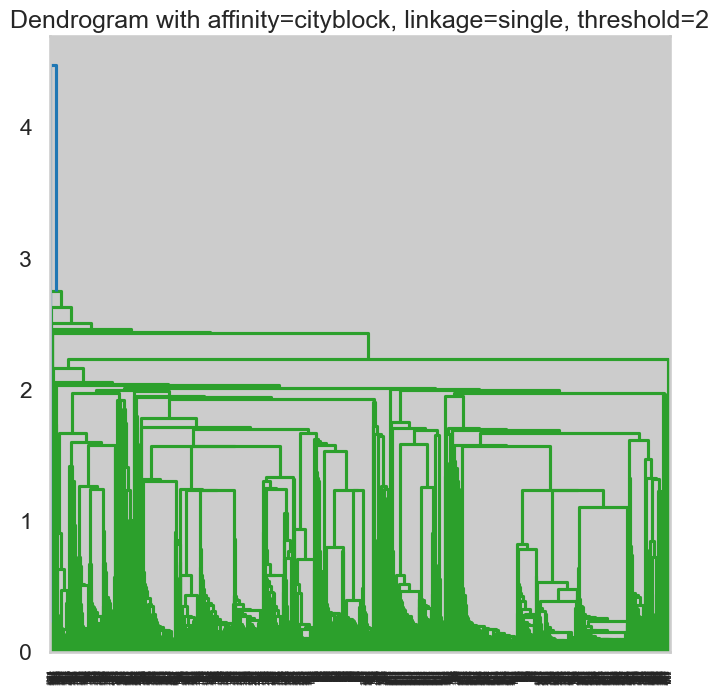

<Figure size 800x800 with 0 Axes>

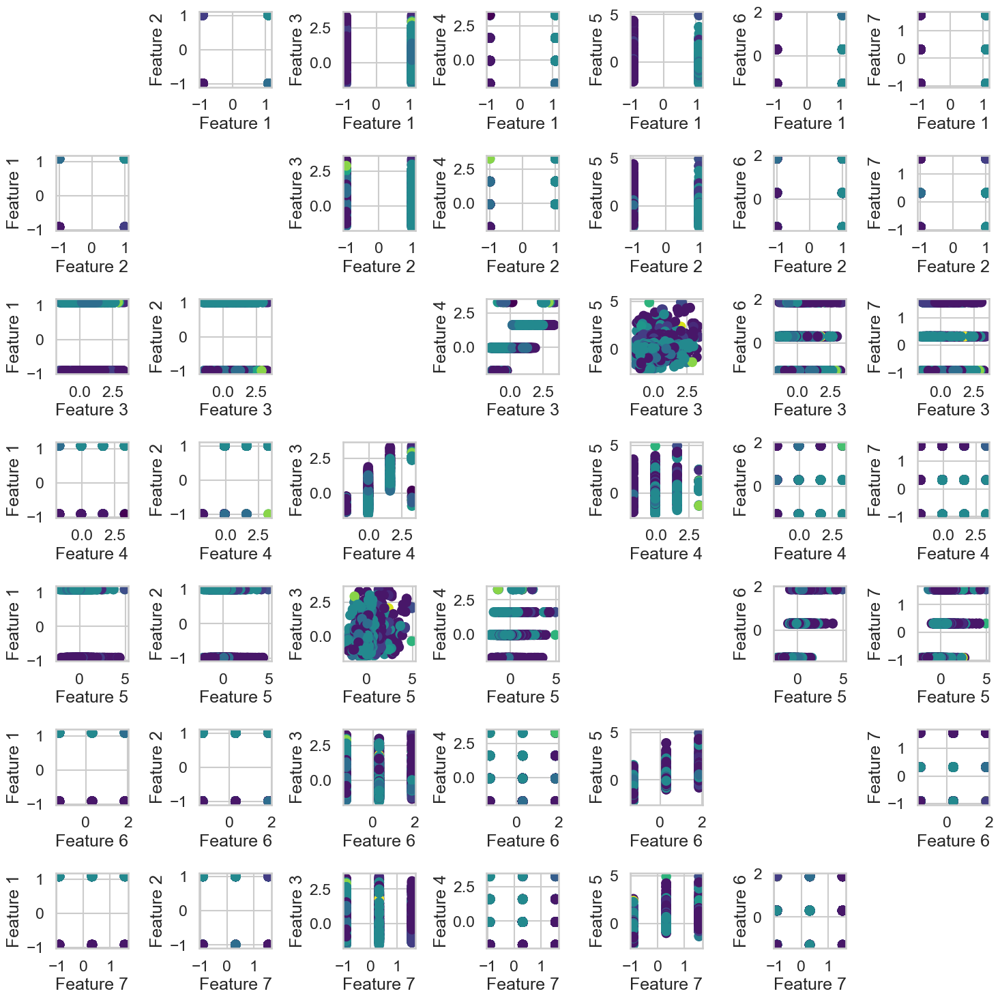

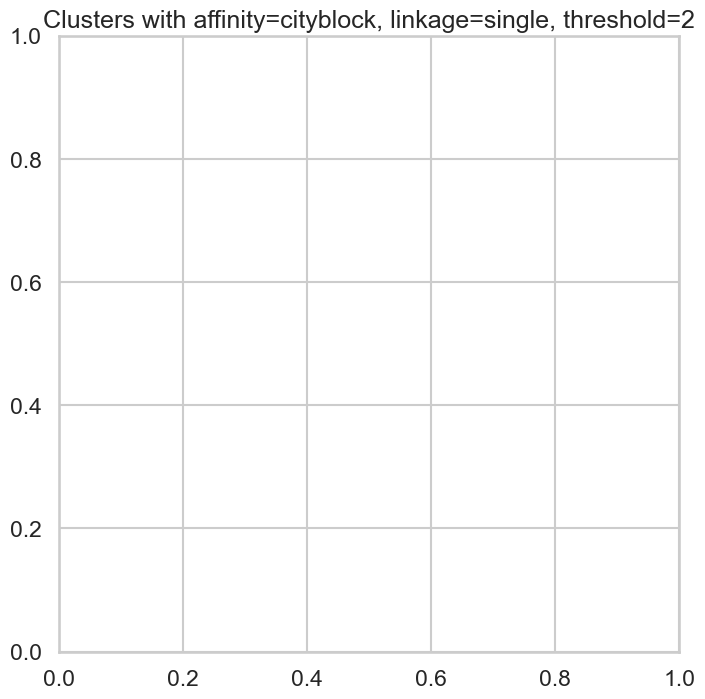

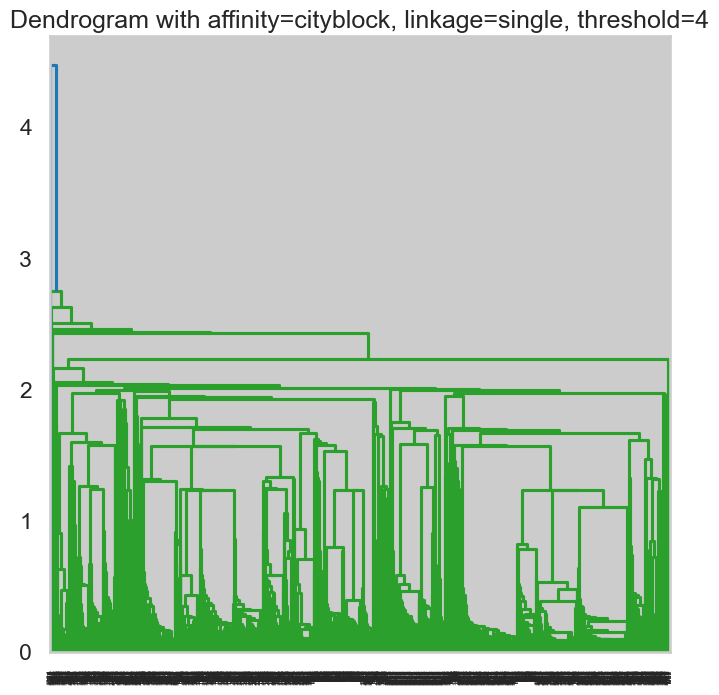

<Figure size 800x800 with 0 Axes>

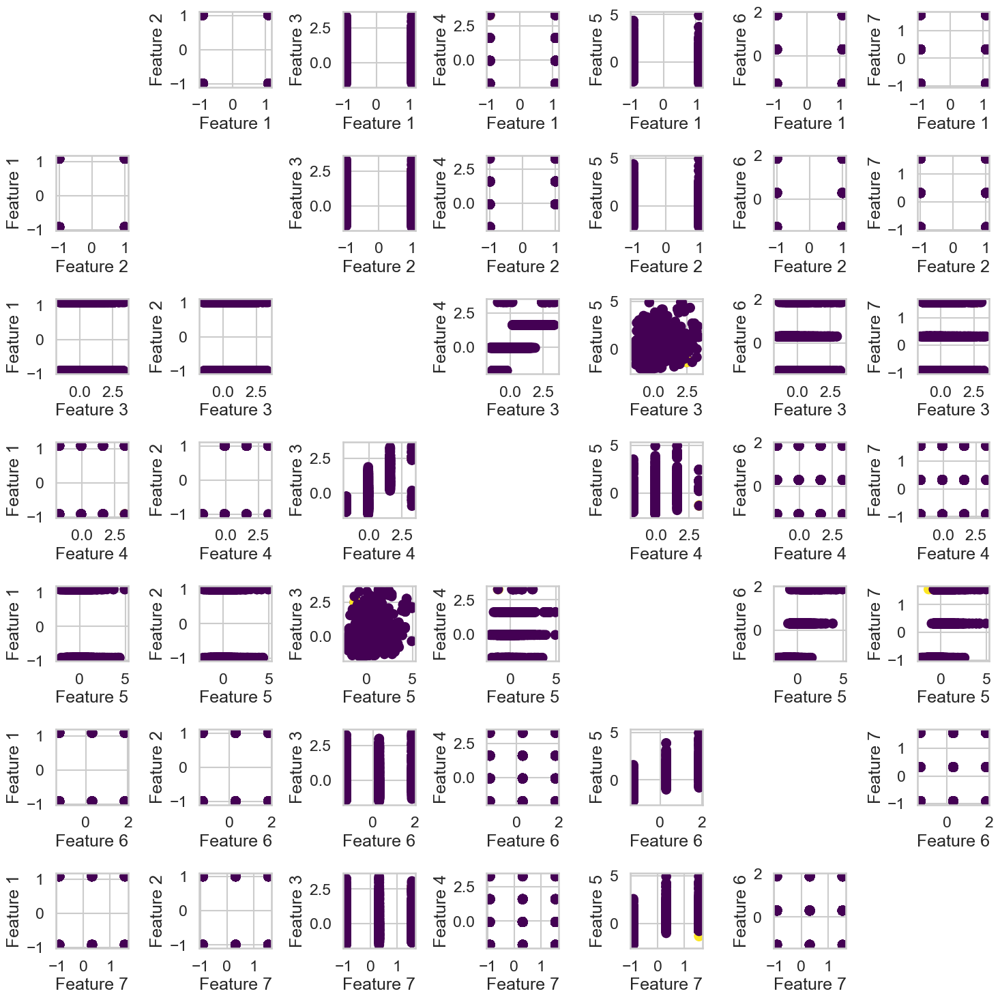

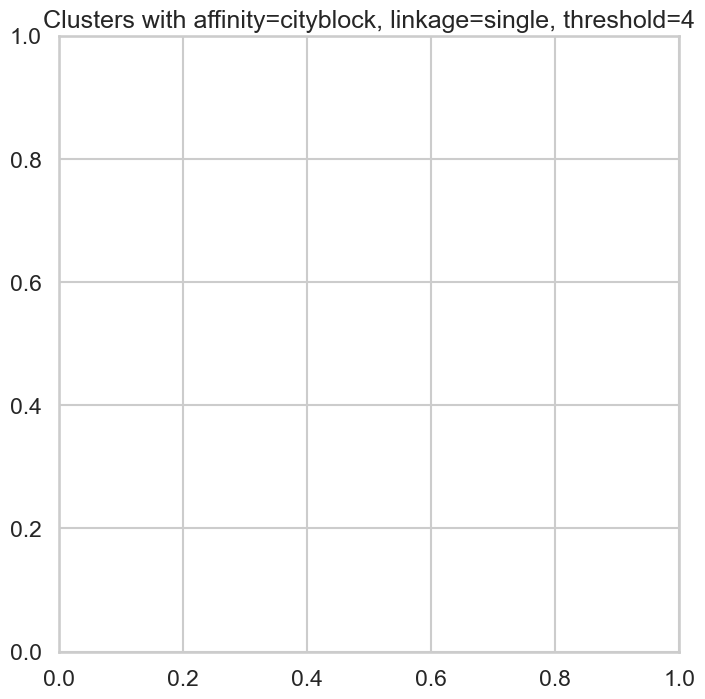

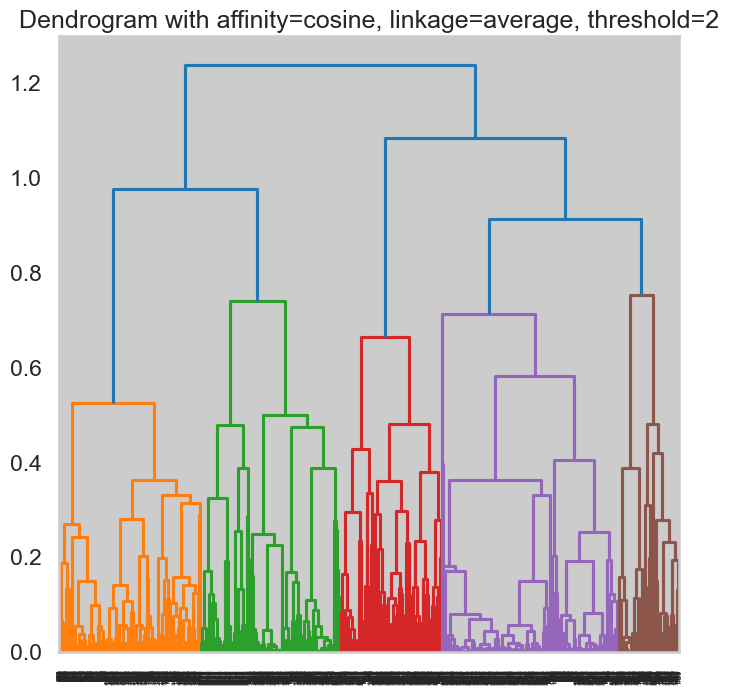

<Figure size 800x800 with 0 Axes>

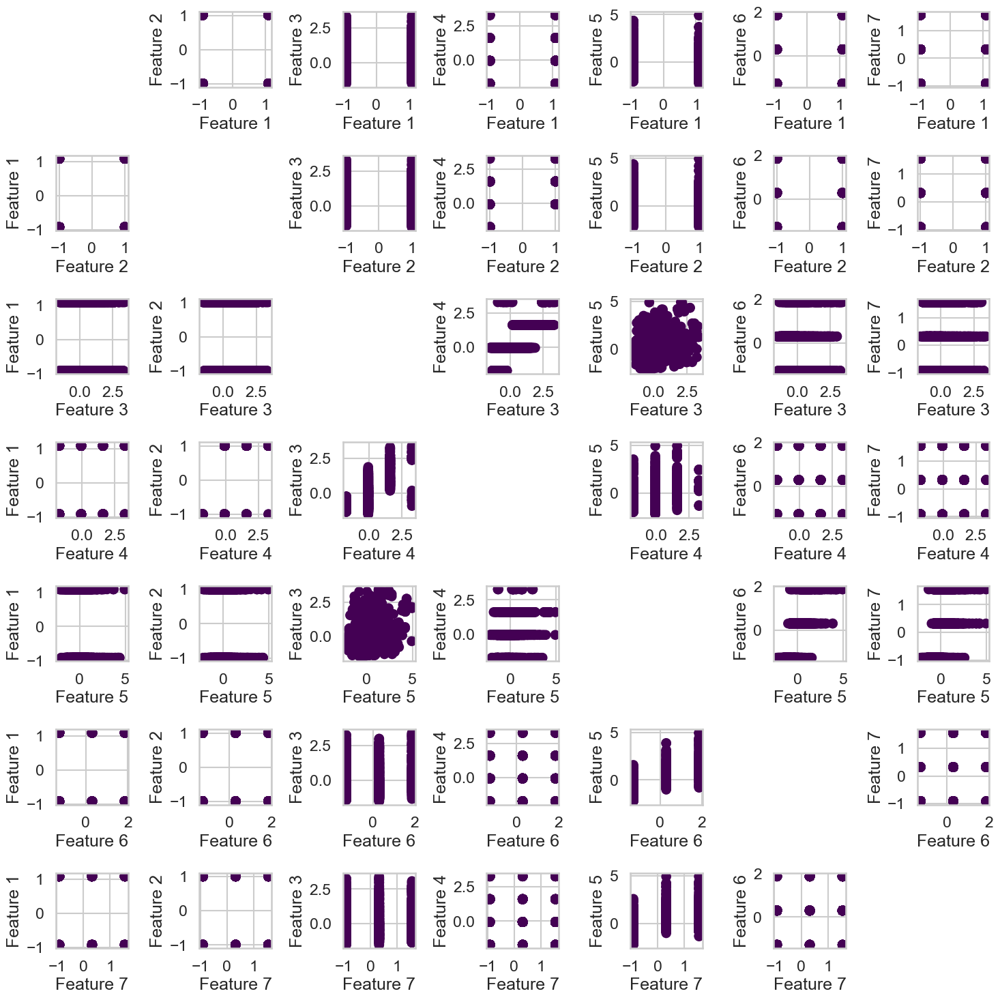

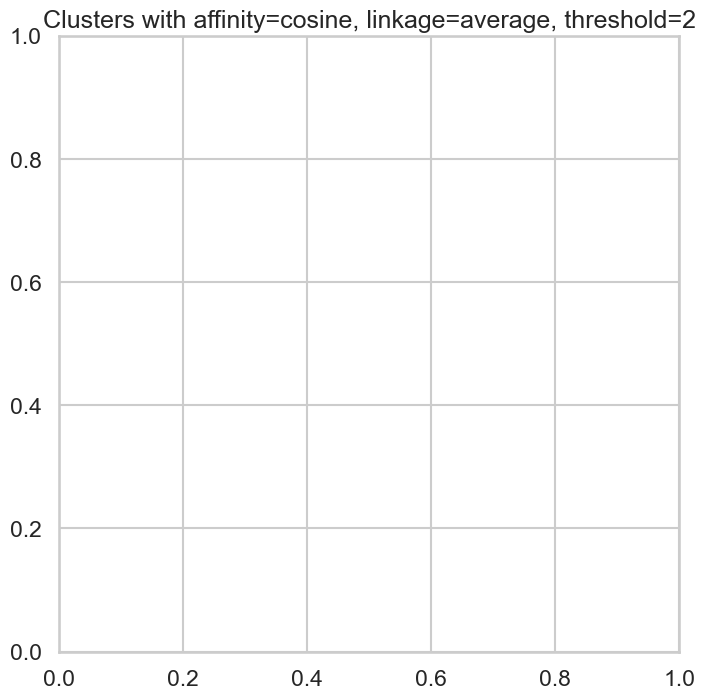

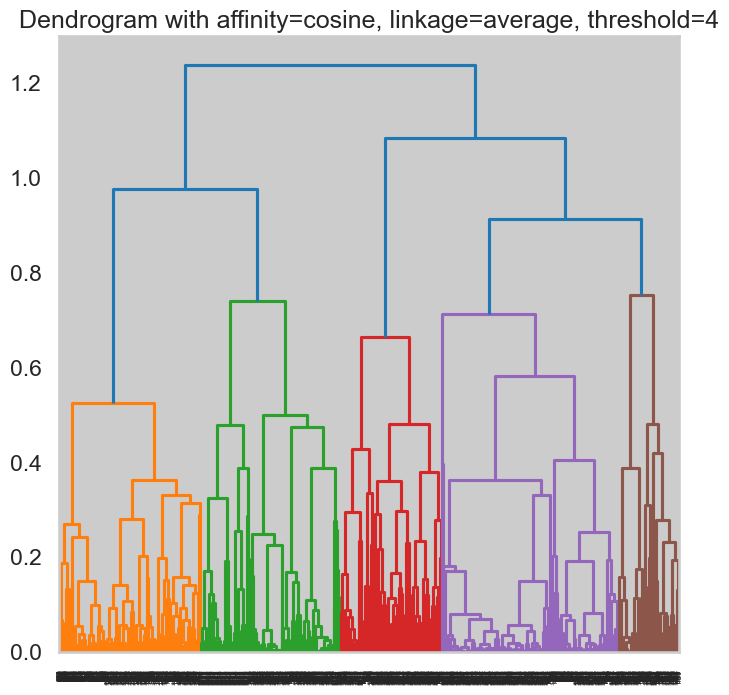

<Figure size 800x800 with 0 Axes>

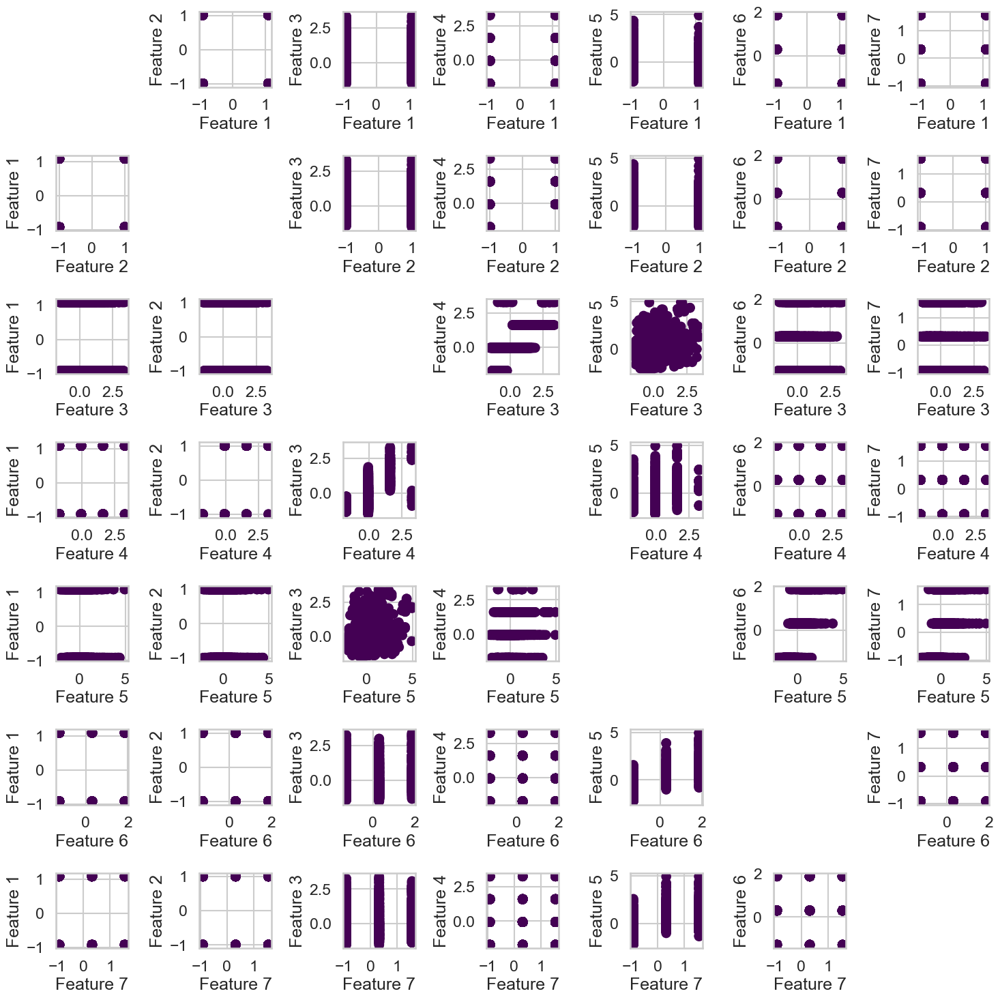

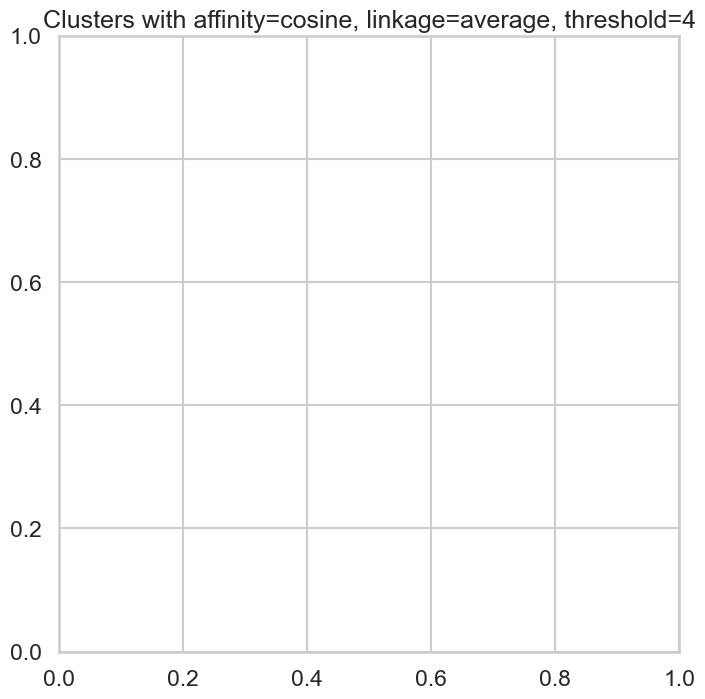

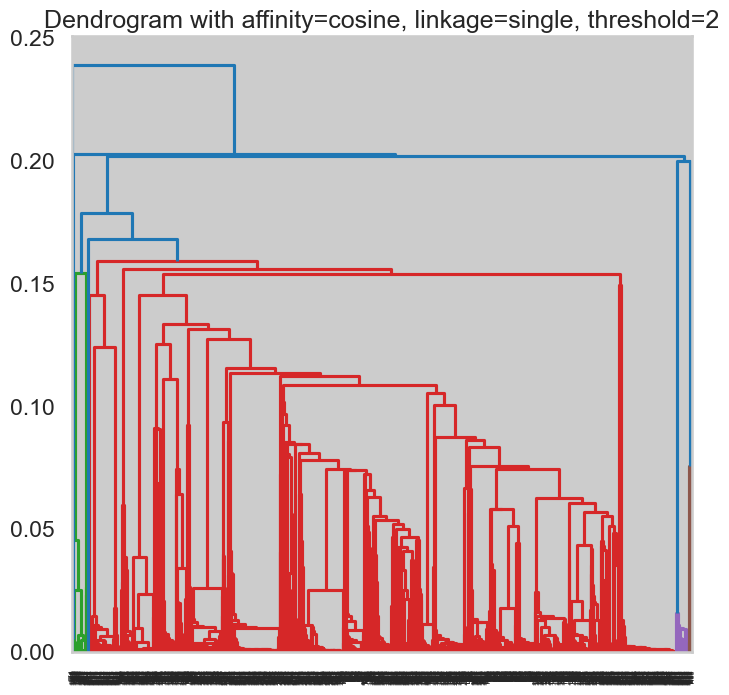

<Figure size 800x800 with 0 Axes>

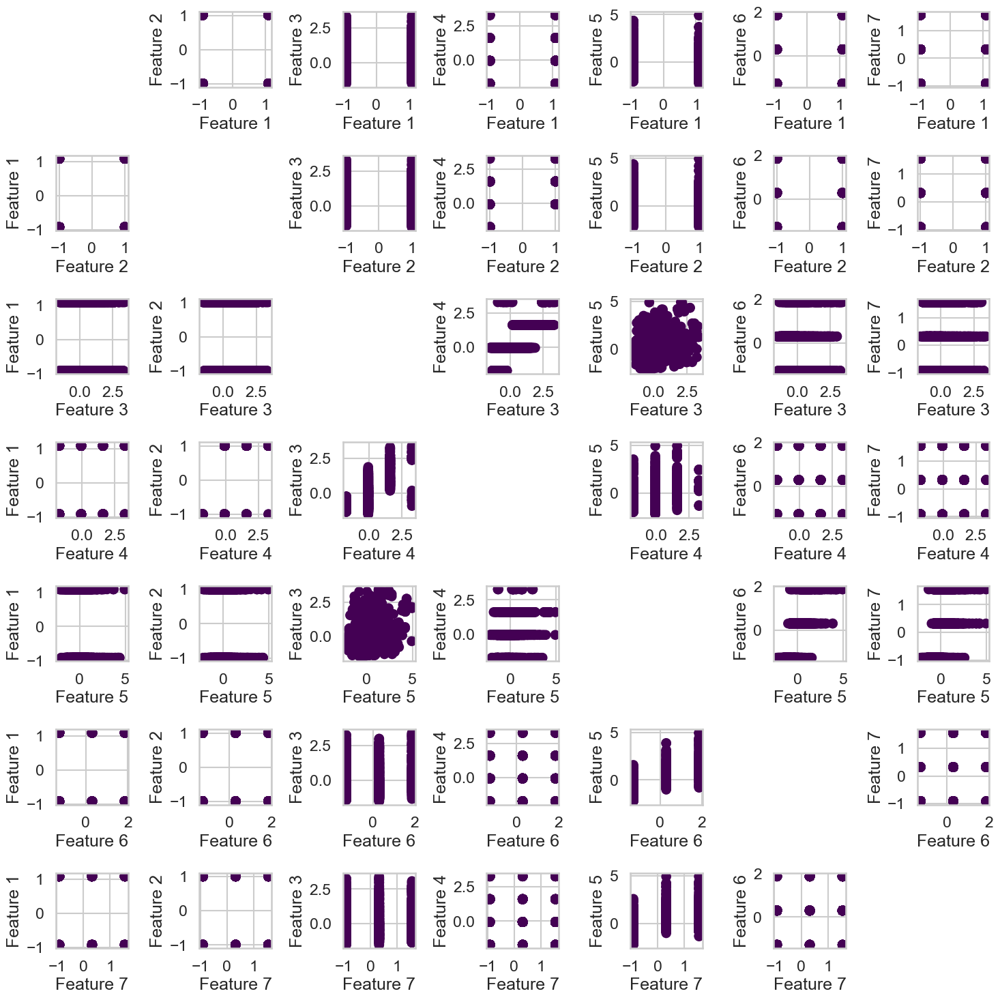

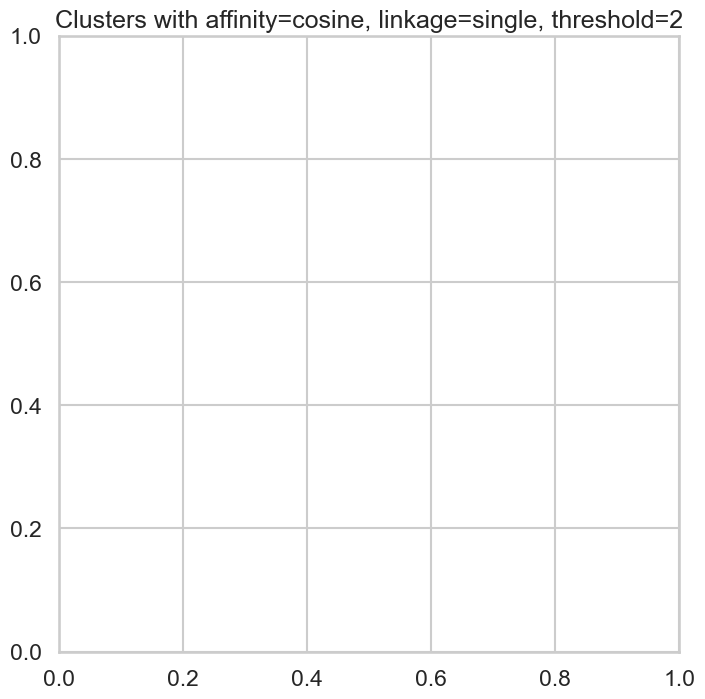

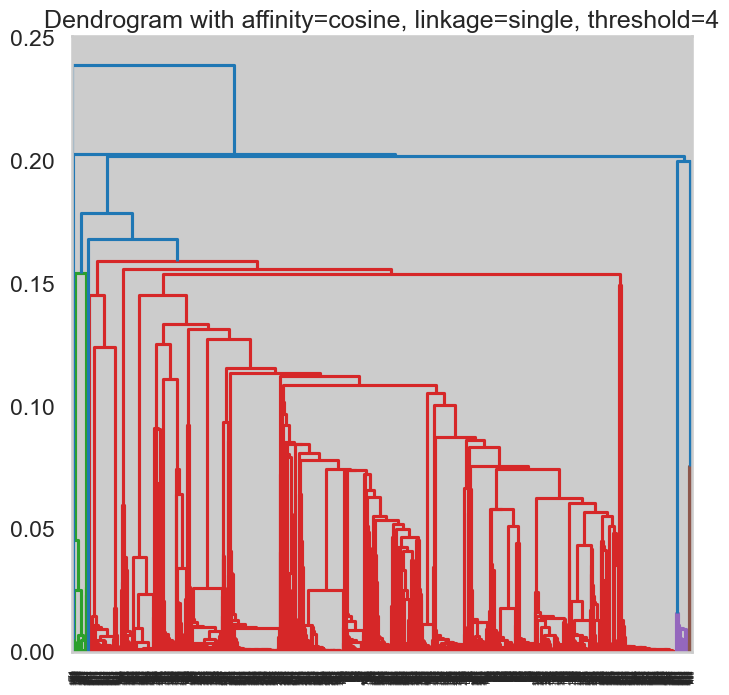

<Figure size 800x800 with 0 Axes>

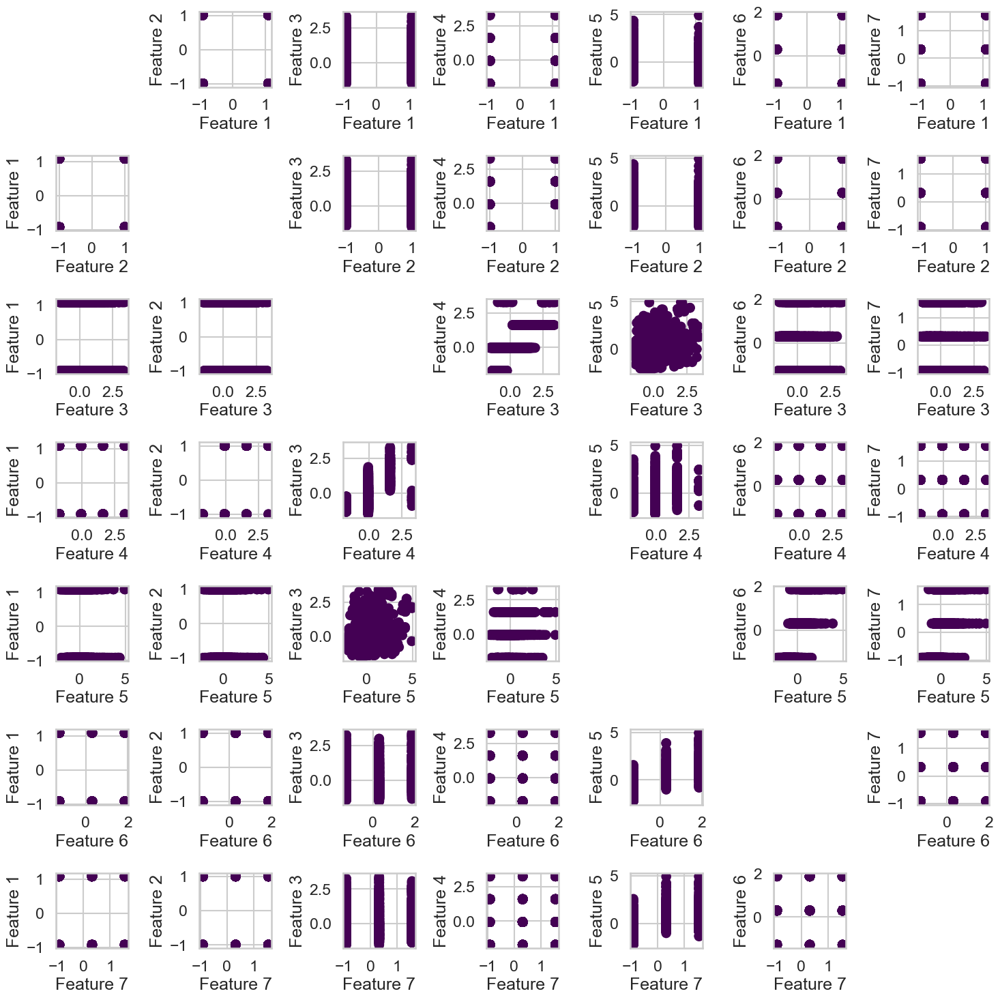

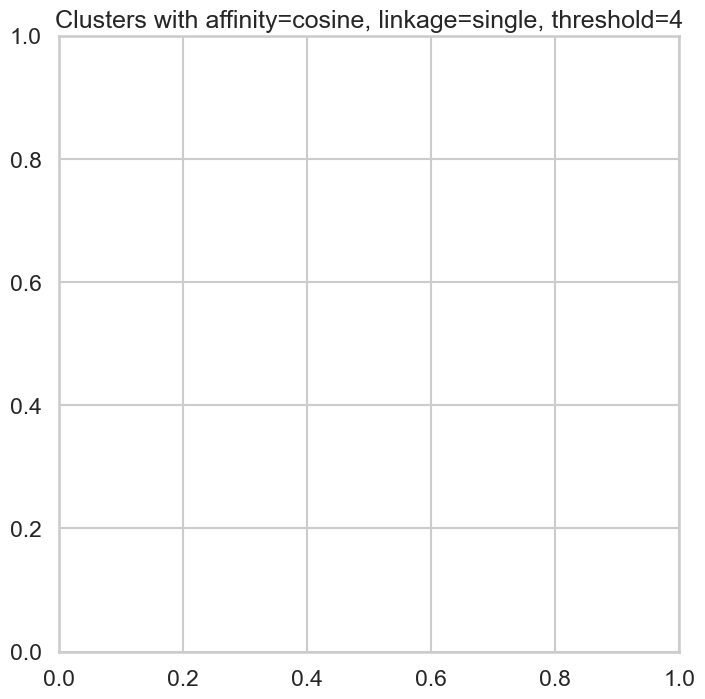

Best silhouette score: 0.464149275246062 with params: ('cityblock', 'average', 2)


In [45]:
def display_cluster_new(data, model):
    num_features = data.shape[1]
    if num_features == 2:
        plt.scatter(data[:, 0], data[:, 1], c=model.labels_, cmap='viridis')
    else:
        fig, axs = plt.subplots(num_features, num_features, figsize=(15, 15))
        for i in range(num_features):
            for j in range(num_features):
                if i != j:
                    axs[i, j].scatter(data[:, i], data[:, j], c=model.labels_, cmap='viridis')
                    axs[i, j].set_xlabel(f'Feature {i+1}')
                    axs[i, j].set_ylabel(f'Feature {j+1}')
                else:
                    axs[i, j].axis('off')
        plt.tight_layout()
    plt.show()


plt.rcParams['figure.figsize'] = [8, 8]
sns.set_style("whitegrid")
sns.set_context("talk")
# Load the data
df = pd.read_csv(r'D:\Sems10\ML\Customer data.csv')

# Select all features except 'id'
df_new = df.drop(columns=['ID'])
scaler = StandardScaler()
X = scaler.fit_transform(df_new)

affinities = ['euclidean', 'cityblock', 'cosine']
linkages = ['average', 'single']
distance_thresholds = [2, 4]

best_silhouette_score = -1
best_params = None

for affinity in affinities:
    for linkage_method in linkages:
        for threshold in distance_thresholds:
            model = AgglomerativeClustering(n_clusters=None, affinity=affinity, linkage=linkage_method, distance_threshold=threshold)
            cluster_labels = model.fit_predict(X)
            if len(set(cluster_labels)) > 1:  # Check if there is more than one cluster
                silhouette_avg = silhouette_score(X, cluster_labels)
                if silhouette_avg > best_silhouette_score:
                    best_silhouette_score = silhouette_avg
                    best_params = (affinity, linkage_method, threshold)

            plt.figure()
            dendrogram(linkage(X, method=linkage_method, metric=affinity))
            plt.title(f"Dendrogram with affinity={affinity}, linkage={linkage_method}, threshold={threshold}")

            plt.figure()
            display_cluster_new(X, model)
            plt.title(f"Clusters with affinity={affinity}, linkage={linkage_method}, threshold={threshold}")
            plt.show()

print(f"Best silhouette score: {best_silhouette_score} with params: {best_params}")


<h1>DBscan </h1>

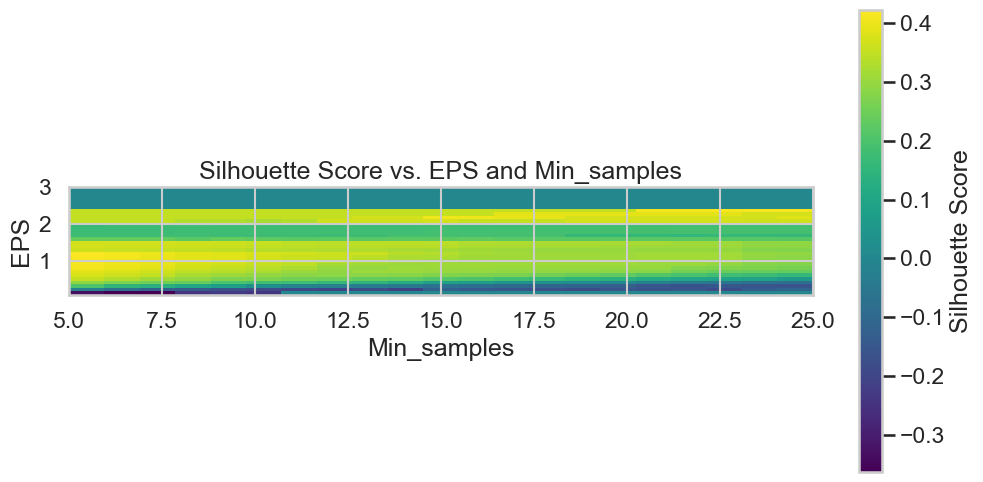

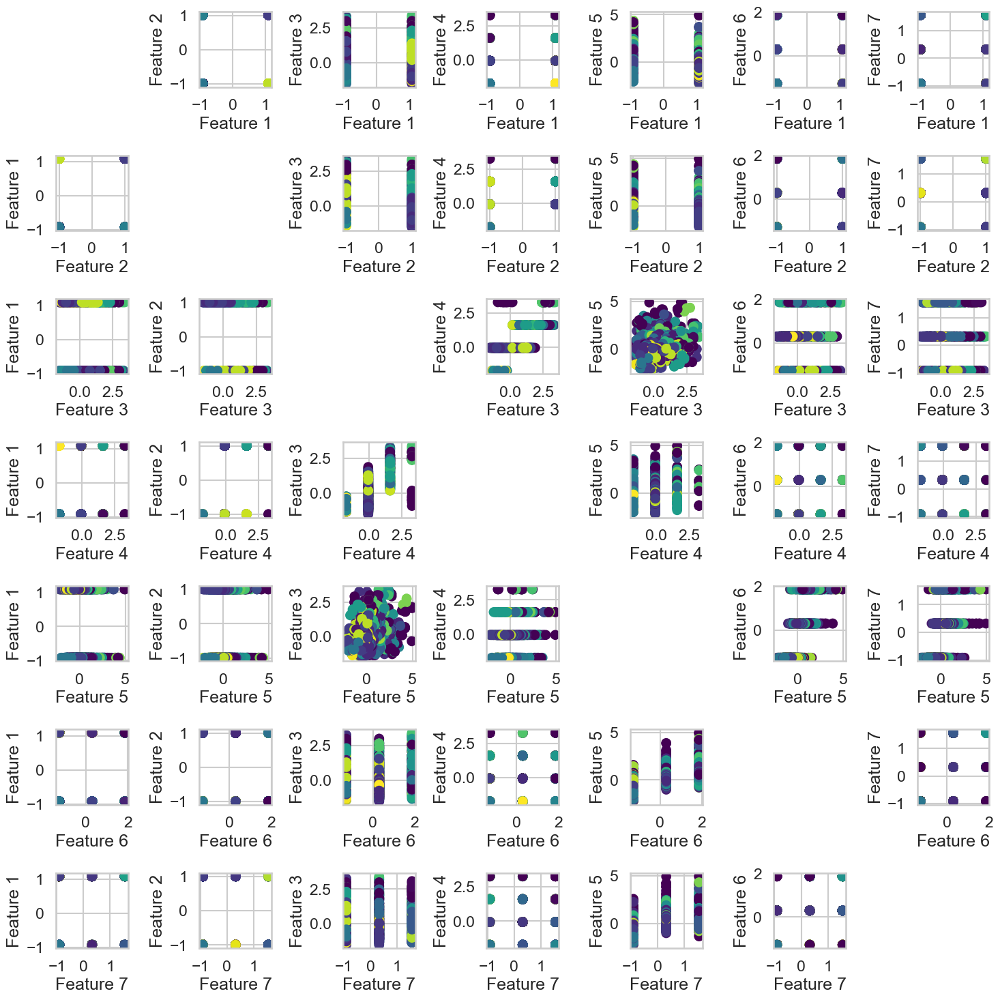

Best Silhouette Score: 0.4225606832617899
Best EPS: 1.2000000000000002, Best Min_samples: 5


In [46]:
from sklearn.cluster import DBSCAN
from sklearn.metrics import silhouette_score
import matplotlib.pyplot as plt
from sklearn.datasets import load_iris
import numpy as np

df = pd.read_csv(r'D:\Sems10\ML\Customer data.csv')

# Select all features except 'id'
df_new = df.drop(columns=['ID'])
scaler = StandardScaler()
X = scaler.fit_transform(df_new)

eps_range = np.arange(0.1, 3.1, 0.1)
min_samples_range = range(5, 26)
silhouette_scores = np.zeros((len(eps_range), len(min_samples_range)))

for i, eps in enumerate(eps_range):
    for j, min_samples in enumerate(min_samples_range):
        dbscan = DBSCAN(eps=eps, min_samples=min_samples)
        cluster_labels = dbscan.fit_predict(X)
        if len(np.unique(cluster_labels)) > 1:  # Check if more than one cluster (excluding noise) is found
            silhouette_scores[i, j] = silhouette_score(X, cluster_labels)

plt.figure(figsize=(12, 6))
plt.imshow(silhouette_scores, cmap='viridis', origin='lower', extent=[5, 25, 0.1, 3])
plt.colorbar(label='Silhouette Score')
plt.xlabel('Min_samples')
plt.ylabel('EPS')
plt.title('Silhouette Score vs. EPS and Min_samples')
plt.show()

best_eps, best_min_samples = np.unravel_index(np.argmax(silhouette_scores), silhouette_scores.shape)
best_dbscan = DBSCAN(eps=eps_range[best_eps], min_samples=min_samples_range[best_min_samples])
best_cluster_labels = best_dbscan.fit_predict(X)

# Plot all pairs of features
num_features = X.shape[1]
fig, axs = plt.subplots(num_features, num_features, figsize=(15, 15))
for i in range(num_features):
    for j in range(num_features):
        if i != j:
            axs[i, j].scatter(X[:, i], X[:, j], c=best_cluster_labels, cmap='viridis')
            axs[i, j].set_xlabel(f'Feature {i+1}')
            axs[i, j].set_ylabel(f'Feature {j+1}')
        else:
            axs[i, j].axis('off')
plt.tight_layout()
plt.show()

best_score = silhouette_scores[best_eps, best_min_samples]
print(f"Best Silhouette Score: {best_score}")
print(f"Best EPS: {eps_range[best_eps]}, Best Min_samples: {min_samples_range[best_min_samples]}")


<h1> Observations on all the algorithms after normalization </h1>

**The KMeans divided the data into 3 clusters after normalization, yet its silhouette score decreased from 0.583 to 0.2711.**

**The DBscan's performance has evidently enhanced after normalization.**

**The Agglomerative Clustering scored slightly higher than the DBscan.**

**The KMeans scored the least silhouette score after normalization although it has outperformed the rest of the algorithms before normalization.**